In [16]:
%load_ext autoreload
%autoreload 2

In [19]:
import matplotlib.pyplot as plt
import numpy as np
import kaepora as kpora
import kaepora_plot as kplot
import flux_calibration as fc
import composite
import numpy as np
import pysynphot
from astropy import units as u
from scipy.interpolate import interp2d
import glob
from mpl_toolkits.mplot3d import Axes3D
import gp2d_george as gp2d
import prep 
import pysynphot
import matplotlib
import spectral_analysis as sa

In [2]:
composites = kpora.create_composites_from_files()
kpora.set_min_num_spec(composites.values(),5)

In [3]:
queries_custom_highv = kpora.create_query_strings_for_sequence([-10,90], [.5,1.8], velocity_range=[-30, -12], phase_step = 1, phase_bin_size=3, phase_step_bin_scale = True)


SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase < -10 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -10 and phase < -7 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -9 and phase < -6 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -8 and phase < -5 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -7 and phase < 

In [4]:
composites_custom_highv, sn_arrays, og_SN_Arrays, boot_sn_arrays = kpora.make_composite(queries_custom_highv, db_file = '../data/kaepora_v1.2.db', shape_param='dm15', boot=False, make_corr=True, av_corr=True, medmean=1, 
                                                             verbose=False, gini_balance=True, combine=True, scale_region=[4000,9000], get_og_arr = True)

SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase < -10 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
24 Total Spectra found
0 flagged spectra removed 24 spectra left
0 spectra of peculiar Ias removed 24 spectra left
24 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
9 total SNe
removed spectra of SNe with A_V > 2.0
Using 22 spectra of 8 SNe
Gini balancing...
Balanced after 6 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -10 and phase < -7 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
ERROR:  2002bo_20020314_0_2_00.dat None
50 Total Spectra found
0 flagged spectra removed 50 spectra left
0 spectra of peculiar Ias removed 50 spectra left
46 spectra of SNe that have 

59 Total Spectra found
3 flagged spectra removed 56 spectra left
0 spectra of peculiar Ias removed 56 spectra left
46 spectra of SNe that have host reddening corrections
Arrays cleaned
46 spectra may have telluric contamination
23 total SNe
removed spectra of SNe with A_V > 2.0
Using 41 spectra of 22 SNe
Gini balancing...
Balanced after 10 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 2 and phase < 5 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
67 Total Spectra found
3 flagged spectra removed 64 spectra left
0 spectra of peculiar Ias removed 64 spectra left
52 spectra of SNe that have host reddening corrections
Arrays cleaned
52 spectra may have telluric contamination
23 total SNe
removed spectra of SNe with A_V > 2.0
Using 47 spectra of 21 SNe
Gini balancing...
Balanced after 6 iterations
SQL Query: SELECT * from Spectra inner join Events ON Sp

51 Total Spectra found
2 flagged spectra removed 49 spectra left
0 spectra of peculiar Ias removed 49 spectra left
44 spectra of SNe that have host reddening corrections
Arrays cleaned
44 spectra may have telluric contamination
25 total SNe
removed spectra of SNe with A_V > 2.0
Using 40 spectra of 23 SNe
Gini balancing...
Balanced after 4 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 15 and phase < 18 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
46 Total Spectra found
0 flagged spectra removed 46 spectra left
0 spectra of peculiar Ias removed 46 spectra left
42 spectra of SNe that have host reddening corrections
Arrays cleaned
42 spectra may have telluric contamination
23 total SNe
removed spectra of SNe with A_V > 2.0
Using 39 spectra of 22 SNe
Gini balancing...
Balanced after 10 iterations
SQL Query: SELECT * from Spectra inner join Events ON 

ERROR:  2002bo_20020421_0_2_00.dat None
28 Total Spectra found
0 flagged spectra removed 28 spectra left
0 spectra of peculiar Ias removed 28 spectra left
25 spectra of SNe that have host reddening corrections
Arrays cleaned
25 spectra may have telluric contamination
15 total SNe
removed spectra of SNe with A_V > 2.0
Using 22 spectra of 14 SNe
Gini balancing...
Balanced after 4 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 28 and phase < 31 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
ERROR:  2002bo_20020421_0_2_00.dat None
26 Total Spectra found
0 flagged spectra removed 26 spectra left
0 spectra of peculiar Ias removed 26 spectra left
24 spectra of SNe that have host reddening corrections
Arrays cleaned
24 spectra may have telluric contamination
18 total SNe
removed spectra of SNe with A_V > 2.0
Using 20 spectra of 17 SNe
Gini balancing...
Bal

36 Total Spectra found
0 flagged spectra removed 36 spectra left
0 spectra of peculiar Ias removed 36 spectra left
35 spectra of SNe that have host reddening corrections
Arrays cleaned
35 spectra may have telluric contamination
19 total SNe
removed spectra of SNe with A_V > 2.0
Using 30 spectra of 18 SNe
Gini balancing...
Balanced after 12 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 41 and phase < 48 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
35 Total Spectra found
0 flagged spectra removed 35 spectra left
0 spectra of peculiar Ias removed 35 spectra left
34 spectra of SNe that have host reddening corrections
Arrays cleaned
34 spectra may have telluric contamination
19 total SNe
removed spectra of SNe with A_V > 2.0
Using 29 spectra of 18 SNe
Gini balancing...
Balanced after 10 iterations
SQL Query: SELECT * from Spectra inner join Events ON

ERROR:  2002bo_20020518_0_2_00.dat None
22 Total Spectra found
0 flagged spectra removed 22 spectra left
0 spectra of peculiar Ias removed 22 spectra left
20 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
12 total SNe
removed spectra of SNe with A_V > 2.0
Using 17 spectra of 11 SNe
Gini balancing...
Balanced after 3 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 54 and phase < 61 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
ERROR:  2002bo_20020518_0_2_00.dat None
21 Total Spectra found
0 flagged spectra removed 21 spectra left
0 spectra of peculiar Ias removed 21 spectra left
20 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
11 total SNe
removed spectra of SNe with A_V > 2.0
Using 17 spectra of 10 SNe
Gini balancing...
Balan

22 Total Spectra found
0 flagged spectra removed 22 spectra left
0 spectra of peculiar Ias removed 22 spectra left
20 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
12 total SNe
removed spectra of SNe with A_V > 2.0
Using 17 spectra of 11 SNe
Gini balancing...
Balanced after 2 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 67 and phase < 81 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
21 Total Spectra found
0 flagged spectra removed 21 spectra left
0 spectra of peculiar Ias removed 21 spectra left
20 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
12 total SNe
removed spectra of SNe with A_V > 2.0
Using 17 spectra of 11 SNe
Gini balancing...
Balanced after 2 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spe

14 Total Spectra found
2 flagged spectra removed 12 spectra left
0 spectra of peculiar Ias removed 12 spectra left
11 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
7 total SNe
removed spectra of SNe with A_V > 2.0
Using 10 spectra of 6 SNe
Gini balancing...
Balanced after 4 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 80 and phase < 94 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -30 and -12
14 Total Spectra found
2 flagged spectra removed 12 spectra left
0 spectra of peculiar Ias removed 12 spectra left
11 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
8 total SNe
removed spectra of SNe with A_V > 2.0
Using 10 spectra of 7 SNe
Gini balancing...
Balanced after 4 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra

In [5]:
dm15s = []
composites_custom_dict_highv = {}
for comp in composites_custom_highv:
    phase = np.average(comp.phase_array[comp.x1:comp.x2])
    dm15s.append(np.average(comp.dm15_array[comp.x1:comp.x2]))
    composites_custom_dict_highv[phase] = comp
print (np.median(dm15s))
dm15_med = np.median(dm15s)
x_1 = sa.calc_x1_from_dm15(dm15_med)
print (x_1)

1.1098970660367038
-0.5799825870790912


In [6]:
phot_salt = fc.create_salt_phot(x_1)
phot_hsiao = fc.create_hsiao_phot()
min_phase = -20
max_phase = 90
del_phases = []
for phase in composites_custom_dict_highv.keys():
    composites_custom_dict_highv[phase].event_data = {}
    composites_custom_dict_highv[phase].event_data['Homogenized_Photometry'] = phot_hsiao #assign template here
    if phase < min_phase or phase > max_phase:
        del_phases.append(phase)
for p in del_phases:
    print ("spectrum outside phase range")
    del composites_custom_dict_highv[p]

Warning, 353 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 353 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 47 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

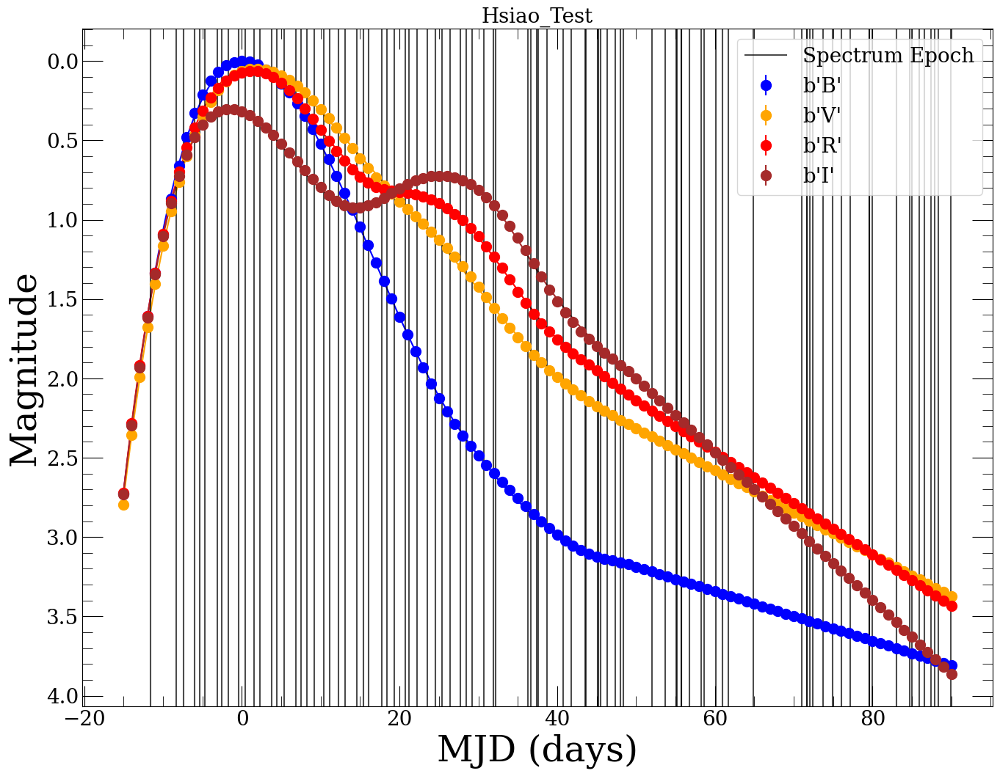

In [7]:
fc.plot_light_curves(phot_hsiao, 'Hsiao_Test', spec_dates = composites_custom_dict_highv.keys(), fit=True)

In [8]:
#MW correction?

In [9]:
calibrated_spec_array_highv = fc.scale_composites_to_photometry(composites_custom_dict_highv, verbose=True)

Warning, 176 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 176 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 176 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 78 of 4207 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 78 of 4207 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 78 of 4207 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined b

Warning, 123 of 4281 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 123 of 4281 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 123 of 4281 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 123 of 4281 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a d

Warning, 120 of 4281 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 120 of 4281 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 120 of 4281 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 119 of 4268 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 119 of 4268 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 119 of 4268 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 152 of 4182 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 152 of 4182 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 152 of 4182 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 162 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 162 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 162 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 162 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 162 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 162 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 162 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 88 of 4221 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 88 of 4221 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 88 of 4221 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 91 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 91 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 91 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 91 of 4234 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 83 of 4266 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 83 of 4266 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 83 of 4266 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 83 of 4266 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 83 of 4266 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 83 of 4266 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 2 of 4399 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4399 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4399 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 2 of 4305 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4305 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4305 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4305 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

Warning, 2 of 4407 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4407 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4407 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 4407 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

Warning, 69 of 4279 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 69 of 4279 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 69 of 4279 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 69 of 4279 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 87 of 4343 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 87 of 4343 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 87 of 4343 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 81 of 4343 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4343 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 81 of 4343 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4343 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 139 of 4335 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 139 of 4335 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 139 of 4335 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 71 of 4179 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 71 of 4179 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 71 of 4179 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 71 of 4179 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 71 of 4179 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 71 of 4179 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 71 of 4179 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 110 of 4243 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 110 of 4243 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a d

Warning, 143 of 4243 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 143 of 4243 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 143 of 4243 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 81 of 4236 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4236 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 81 of 4236 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4236 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 81 of 4224 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4224 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4224 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 81 of 4224 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4224 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4224 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 81 of 4224 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 13 of 3723 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3723 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3723 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3723 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 16 of 3630 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3630 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 16 of 3630 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3630 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 25 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 25 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 25 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 25 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 117 of 4229 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 117 of 4229 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 117 of 4229 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 117 of 4229 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 117 of 4229 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 117 of 4229 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 117 of 4229 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 117 of 4352 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 117 of 4352 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 117 of 4352 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 2 of 3950 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3950 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3950 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 13 of 3978 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3978 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3978 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 12 of 3978 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 12 of 3978 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 12 of 3978 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 12 of 3978 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 24 of 3616 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 24 of 3616 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 24 of 3616 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 45 of 3642 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 45 of 3642 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 45 of 3642 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 46 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 54 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 54 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 54 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 54 of 3670 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 16 of 3716 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3716 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 16 of 3716 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3716 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 11 of 3731 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3731 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3731 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3731 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 11 of 3731 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3731 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3731 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined b

Warning, 4 of 3696 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 4 of 3696 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 4 of 3696 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 4 of 3696 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 4 of 3696 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 4 of 3696 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 4 of 3696 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 10 of 3659 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 10 of 3659 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 10 of 3659 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 5 of 4382 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4382 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4382 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4370 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 14 of 3650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 3650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 3650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 3650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 28 of 3565 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 28 of 3565 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 28 of 3565 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 42 of 3600 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 42 of 3600 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 42 of 3600 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 185 of 3527 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 185 of 3527 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 185 of 3527 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 185 of 3527 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a d

Warning, 197 of 3593 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 197 of 3593 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 197 of 3593 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 197 of 3593 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a d

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 2 of 3623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

Warning, 13 of 3620 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3620 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3620 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 30 of 3573 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 30 of 3573 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 30 of 3573 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 21 of 3545 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 3545 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 3545 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 8 of 3359 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 8 of 3359 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 8 of 3359 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 8 of 3359 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

Warning, 16 of 3386 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3386 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 16 of 3386 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3386 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 20 of 3739 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 42 of 3790 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 42 of 3790 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 46 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 46 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 46 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 41 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 41 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 41 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 41 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 37 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 37 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 37 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 37 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3835 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 7 of 3165 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 7 of 3165 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 7 of 3165 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 7 of 3165 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

In [114]:
#apply reddening corrections?

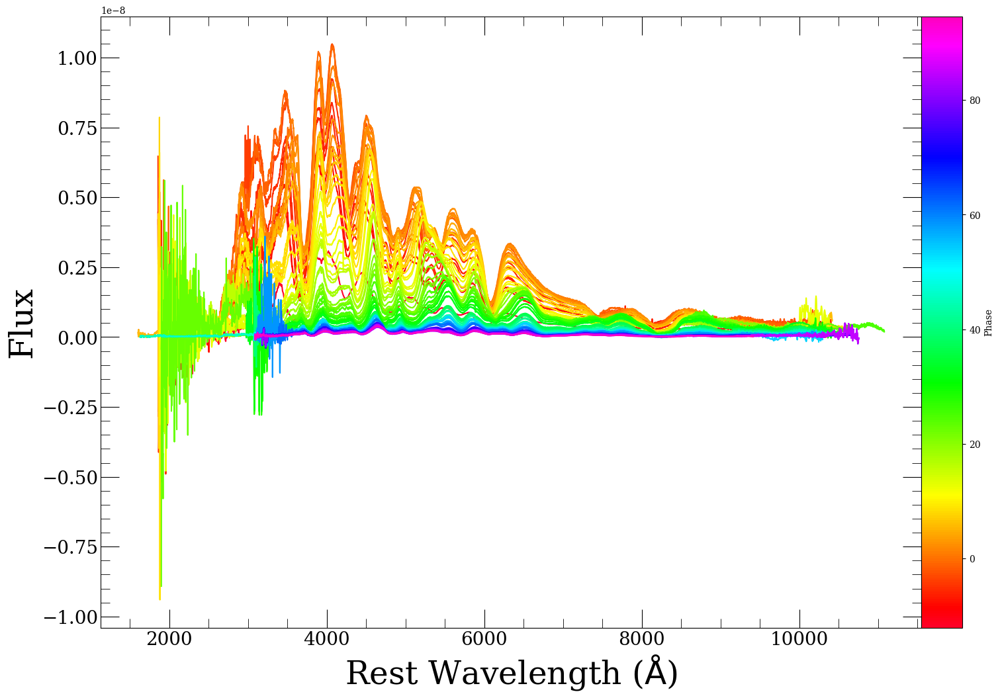

In [10]:
fc.plot_spectra(calibrated_spec_array_highv)

[3426.0, 9418.0]
-1.750185381334145e-10
1.066779674565892e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


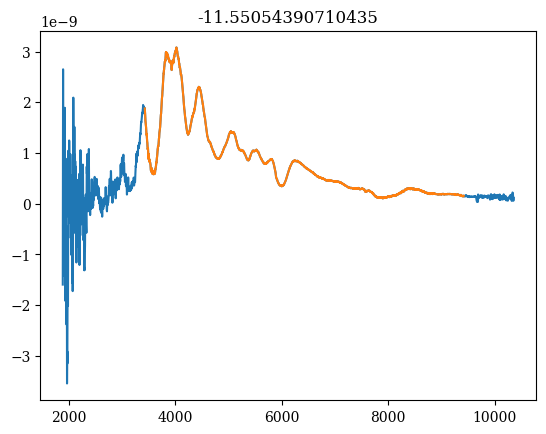

-1.3547121918504731e-09
1.9704397494748546e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


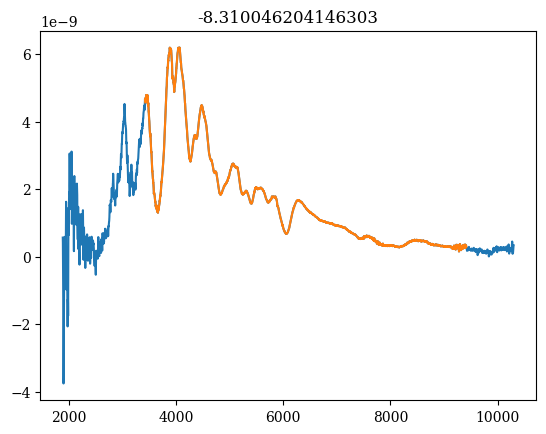

2.1912442407823564e-09
3.077631289242088e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


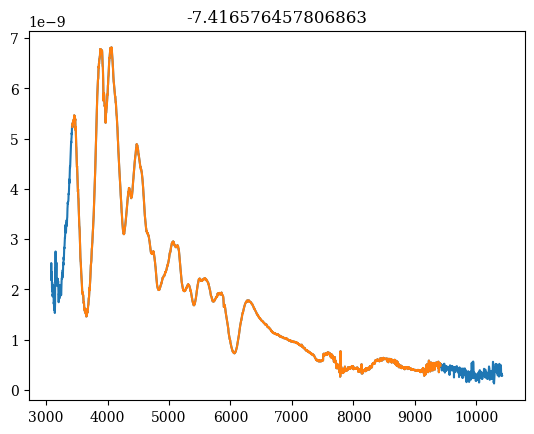

4.720073019883489e-10
3.7107847721066227e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


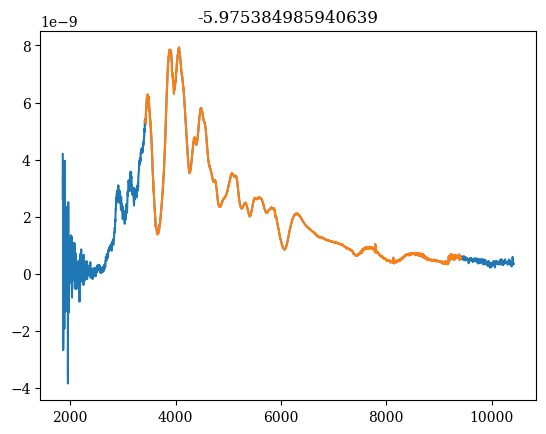

5.027139706282557e-10
3.9221892845388984e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


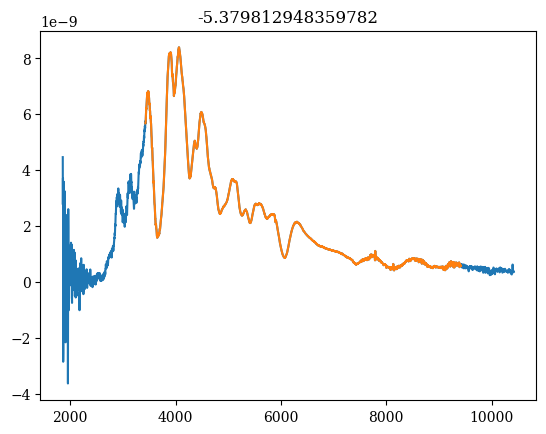

7.278321755535758e-10
3.311439570722313e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


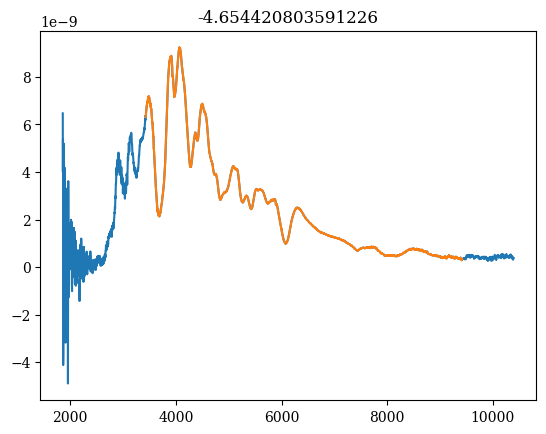

2.640814570476349e-10
7.250122264216952e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


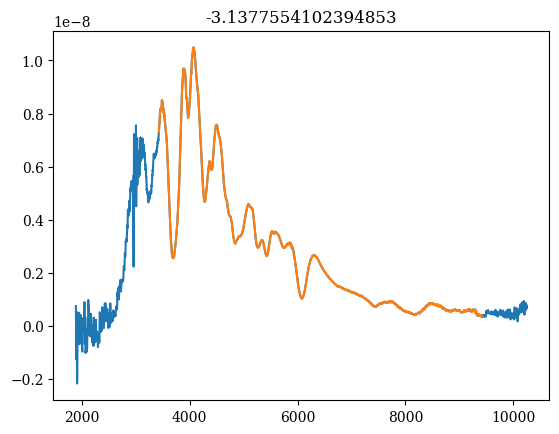

4.42432576813475e-10
3.111703878088224e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


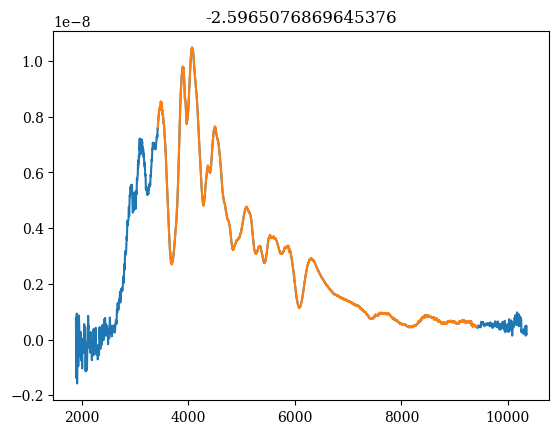

4.389030208191723e-10
2.8549940869187523e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


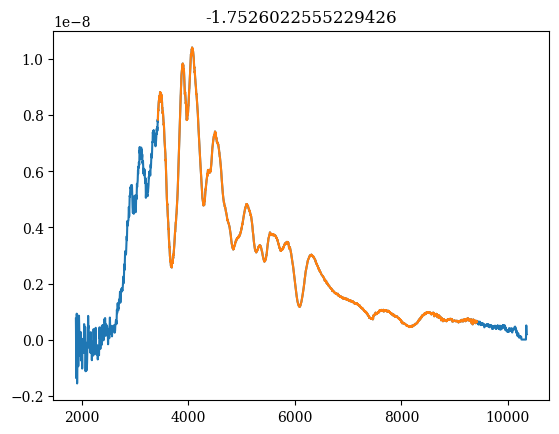

2.2599335768229272e-10
3.013727218593234e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


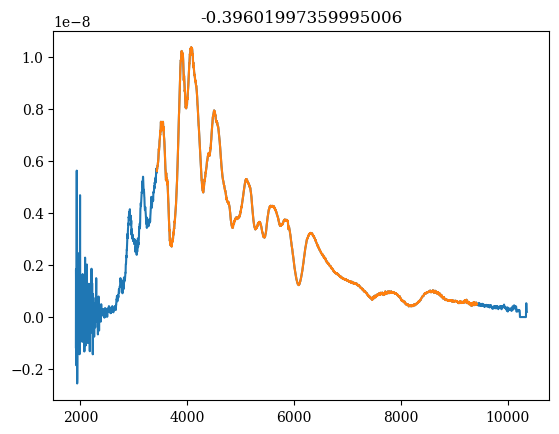

7.395879733424553e-10
1.8365799913362415e-34
[3428. 3430. 3432. ... 9412. 9414. 9416.]


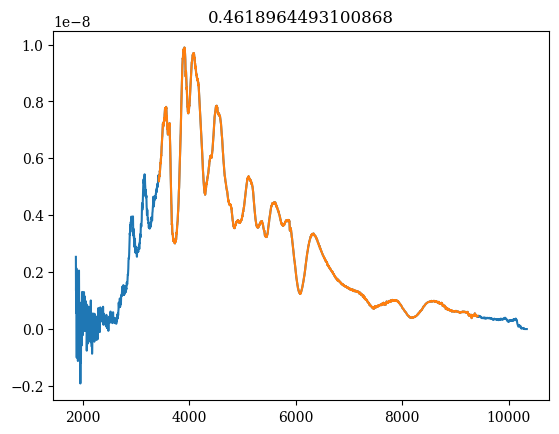

1.4401161677080226e-09
4.541592919416931e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


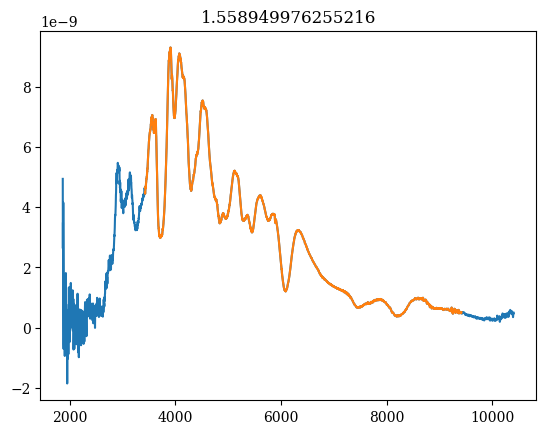

1.3898663953430914e-09
4.40738324669424e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


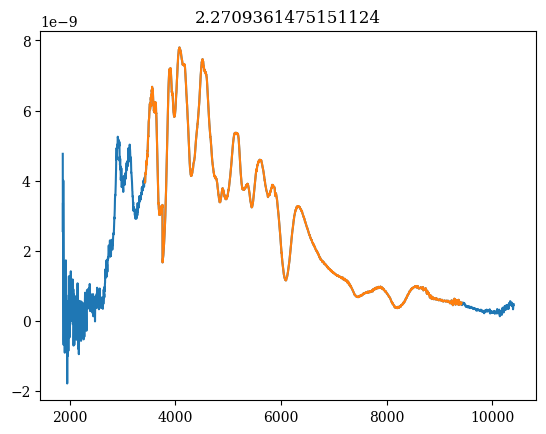

1.0536975491629678e-10
4.2460909954093613e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


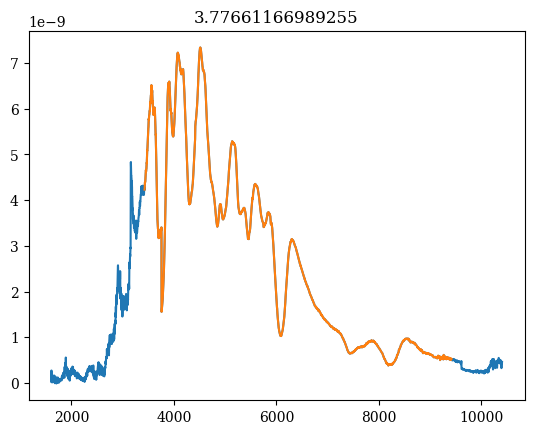

9.958460398140422e-11
8.294041718498661e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


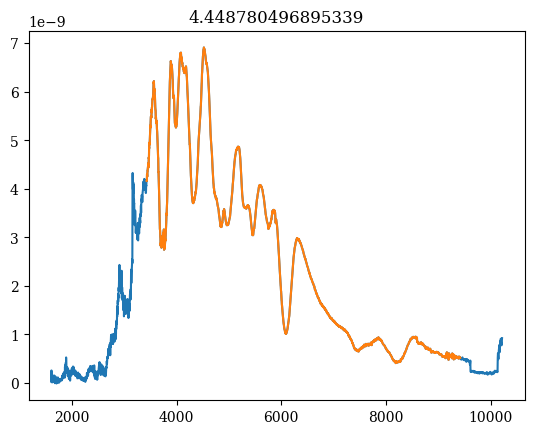

9.685914840213581e-11
7.607030891800141e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


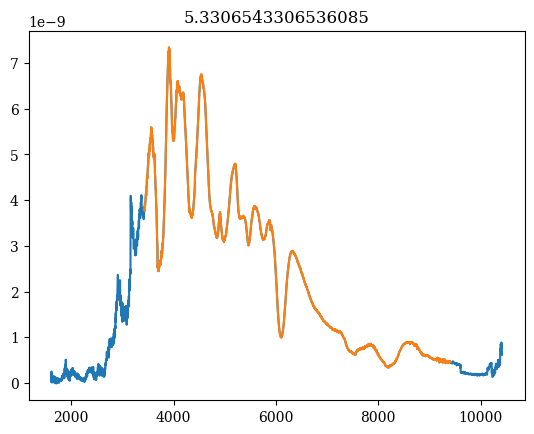

6.109454529571855e-10
7.16426740455044e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


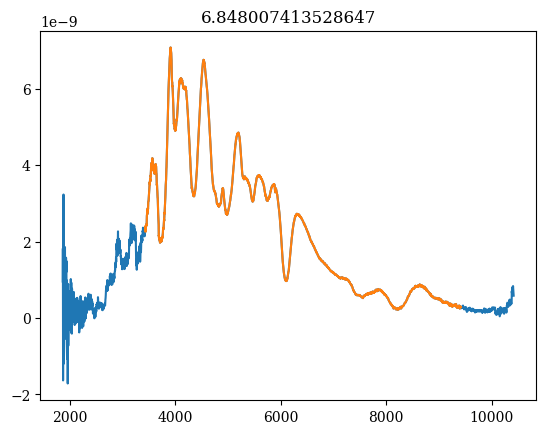

1.4875125528165545e-09
3.7186044724802835e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


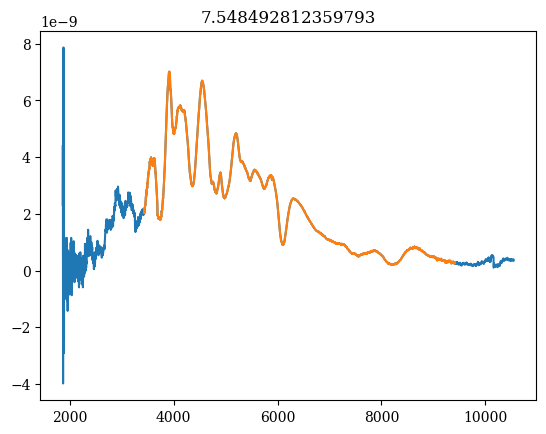

1.0784176257147338e-09
3.6507743095981703e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


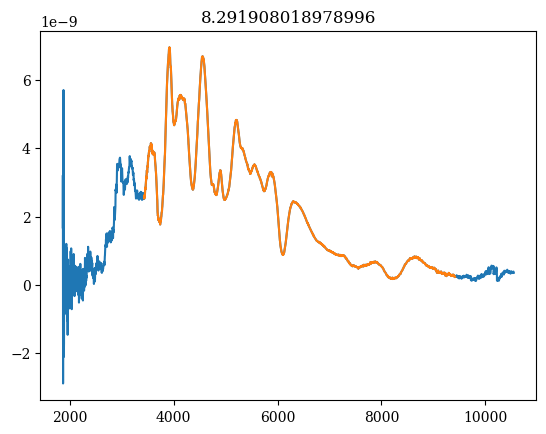

4.1161896406639196e-11
3.386656587132559e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


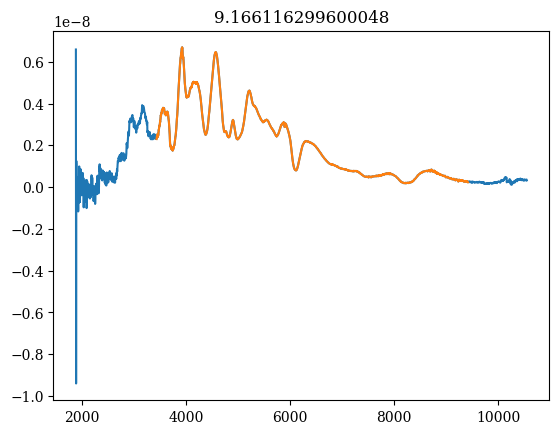

1.3393712937148113e-09
4.778690293622606e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


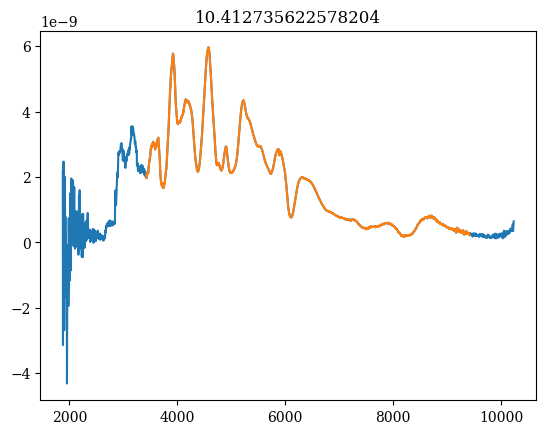

1.998091329274352e-10
4.550622235881645e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


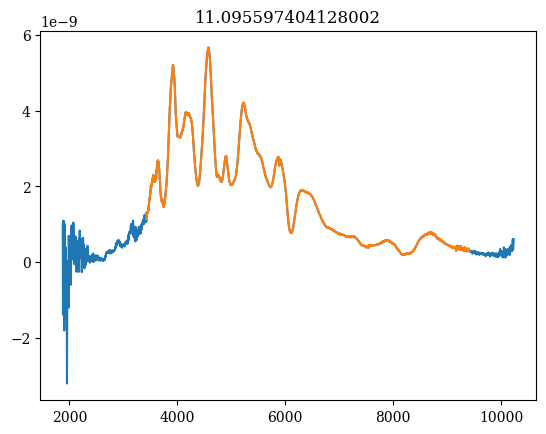

-4.078273906484691e-10
5.657501688476815e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


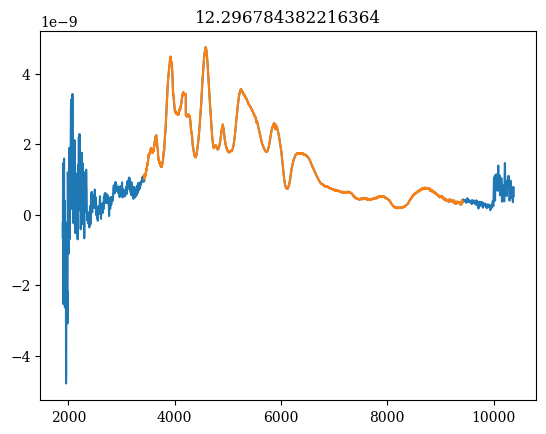

-1.3012135841957474e-09
5.377031700676207e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


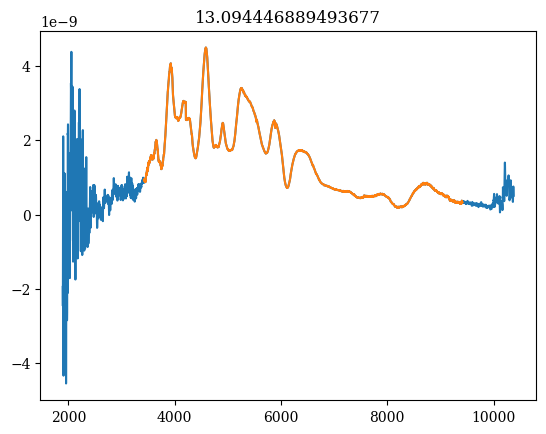

1.2144925698101883e-12
4.977490995414589e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


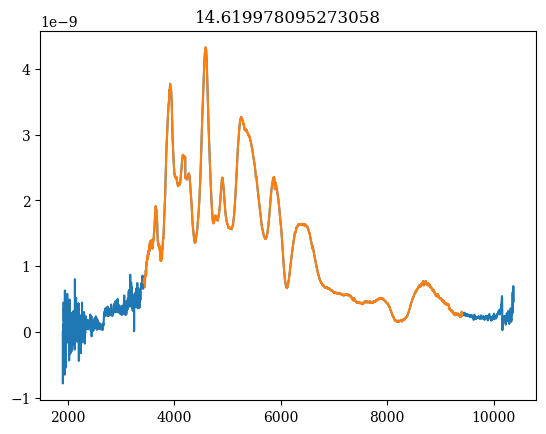

6.461704833150212e-12
2.2934102190478545e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


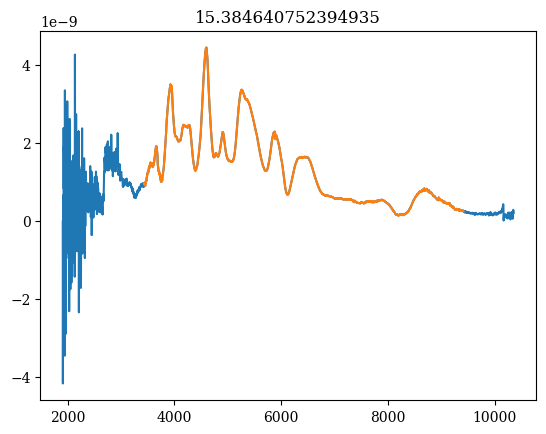

6.3377508084057615e-12
2.3091870459384994e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


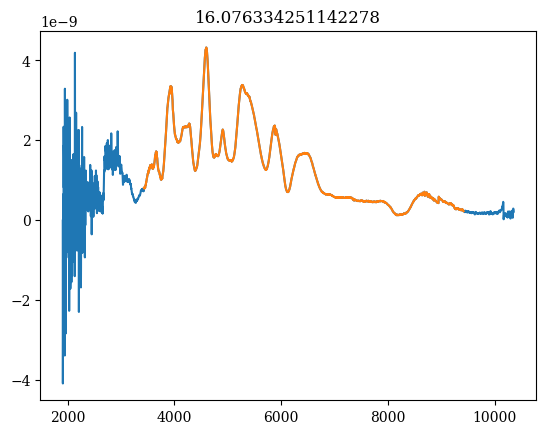

8.748486456018645e-10
6.598199237867659e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


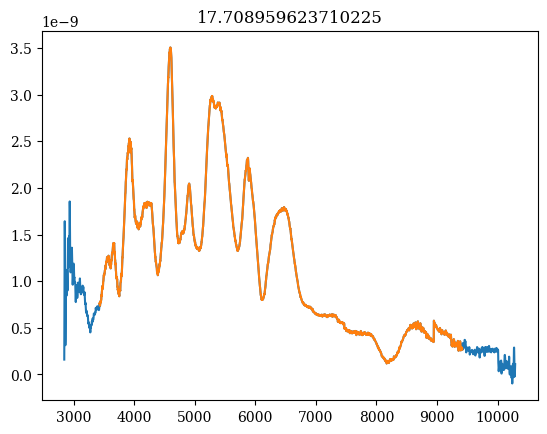

1.9598077897087243e-10
6.423996010560716e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


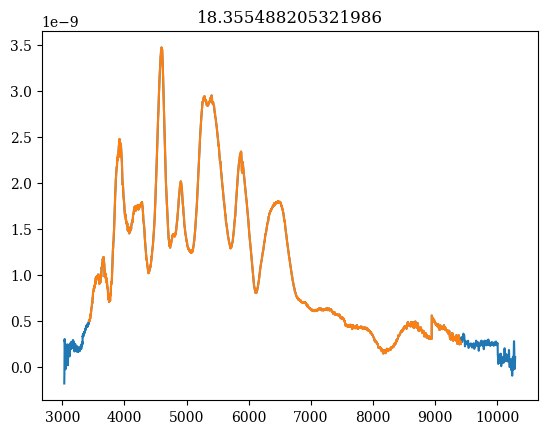

1.356557800051948e-11
2.7262735976811165e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


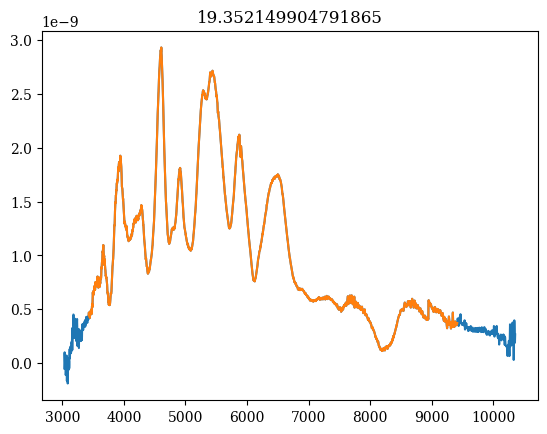

-8.217319862435822e-11
2.417639922044376e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


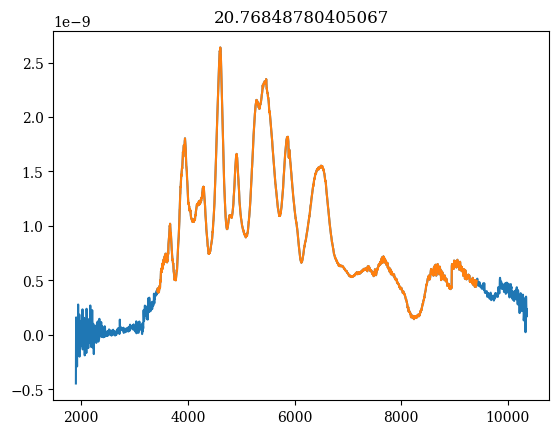

-7.717296184604893e-11
2.329291776857351e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


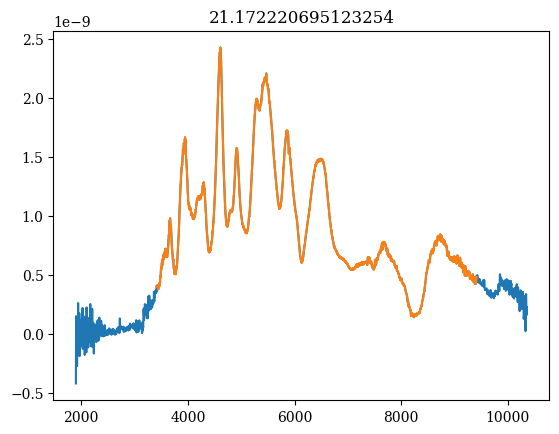

-1.646785697046177e-09
2.6755621007060036e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


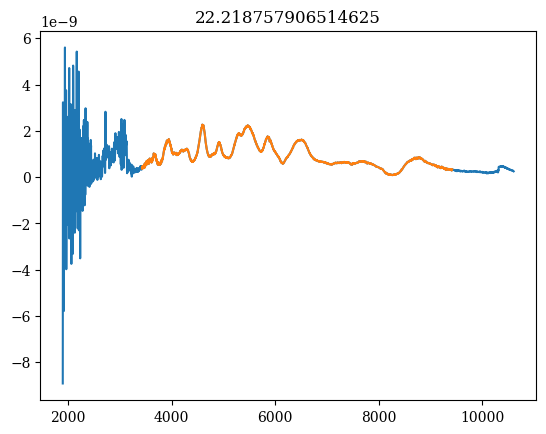

3.715925240759778e-11
2.5007138564610397e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


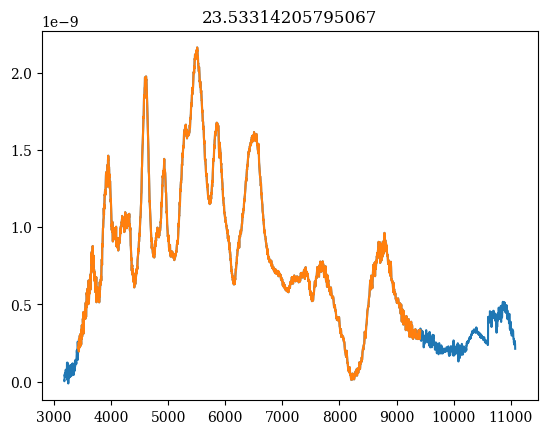

1.399248002571456e-10
2.3910287953480307e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


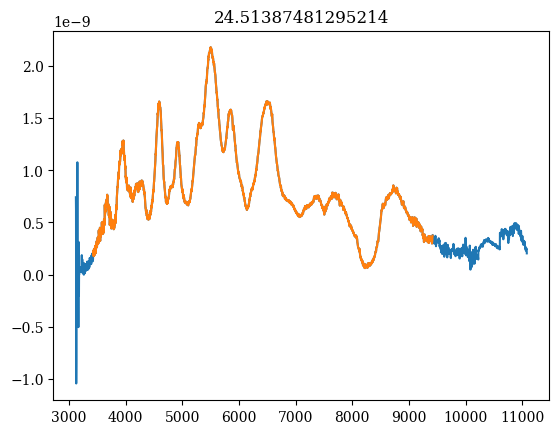

1.2943407657511486e-10
2.1948903603839376e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


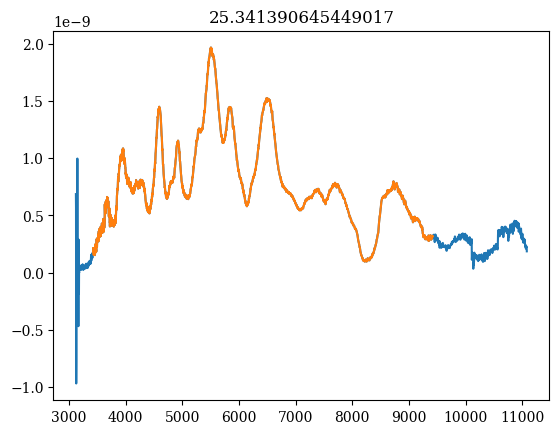

1.279967263628488e-10
2.2578190261405866e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


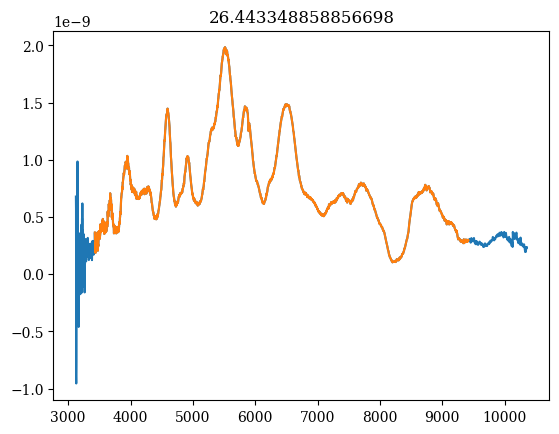

-2.0886725170706716e-10
2.0868058514241888e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


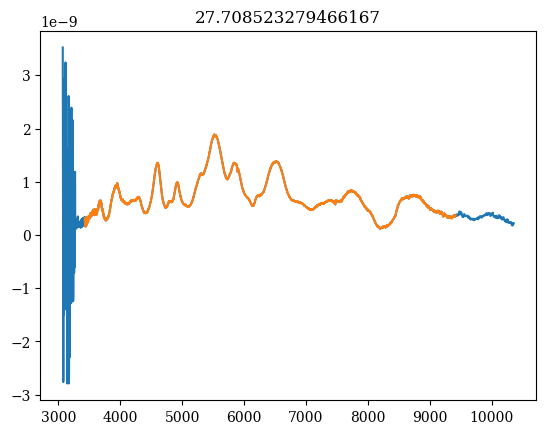

-2.0109546795212677e-10
1.1513226058163441e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


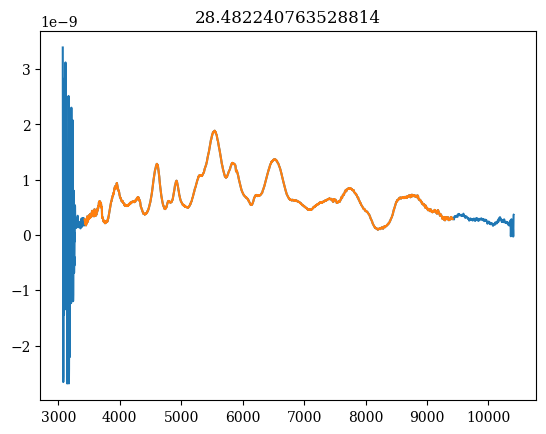

-1.98181049044024e-10
1.1319247529350006e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


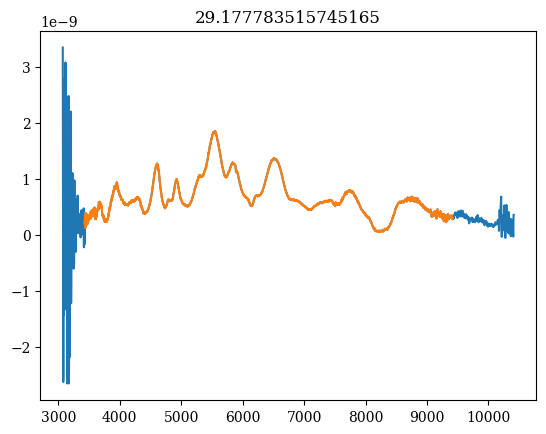

4.52944722663016e-10
1.0252333353239389e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


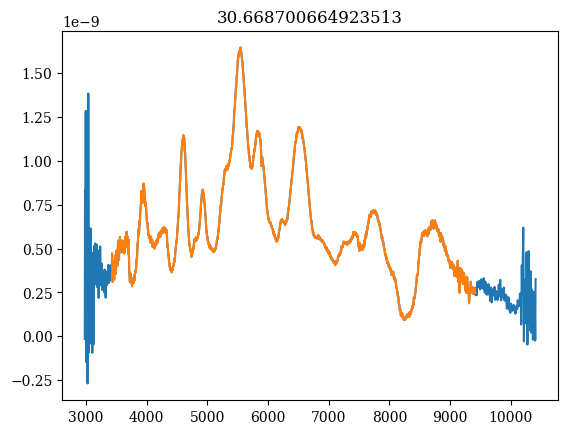

4.1333333713591887e-10
2.3118458166007953e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


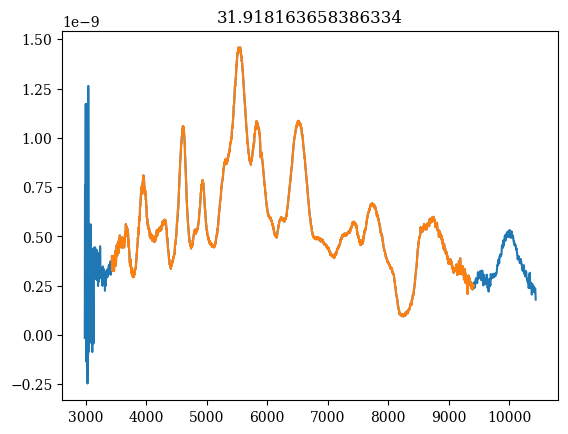

4.136206214412394e-10
2.2695908181467275e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


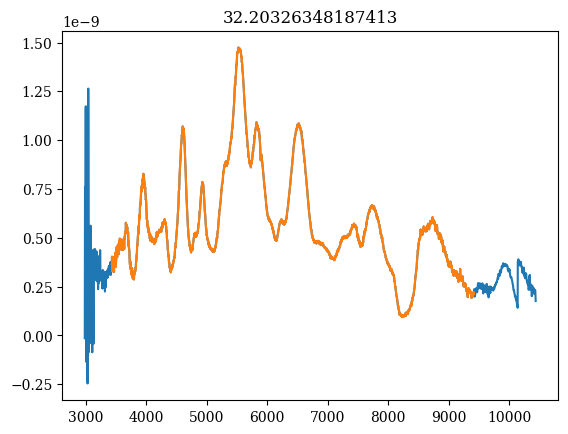

2.9723025108487425e-10
1.0041199758781093e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


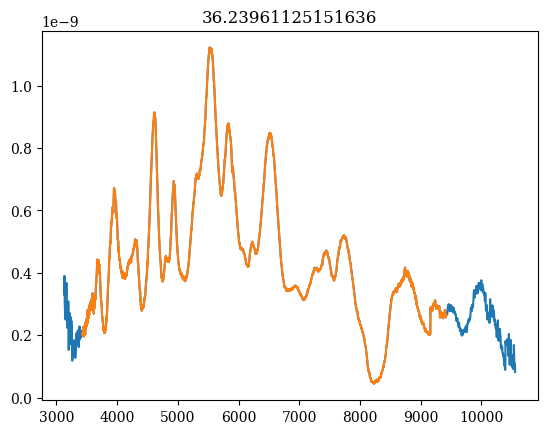

1.3364156425217941e-10
9.932565803687226e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


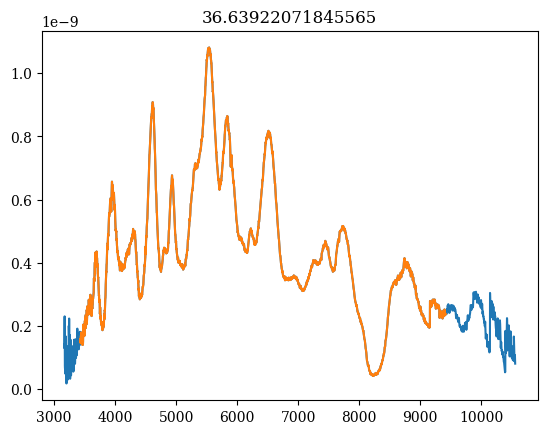

1.2610141348195036e-10
9.362731762896509e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


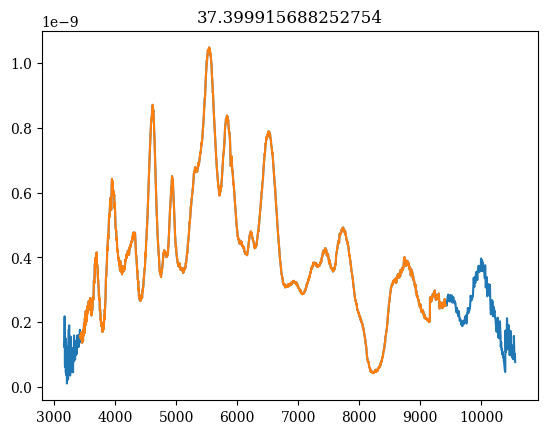

1.250824638820527e-10
9.298317073623741e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


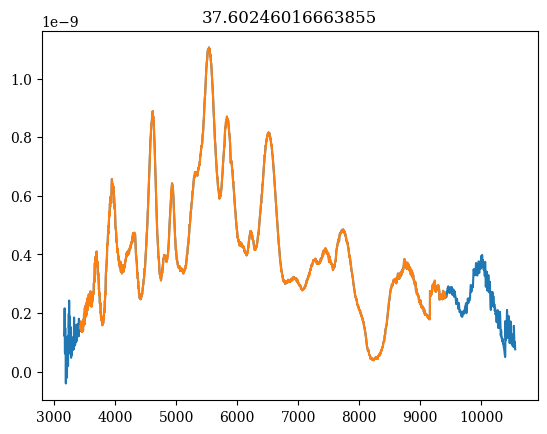

1.1807547131762562e-10
8.585755916337714e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


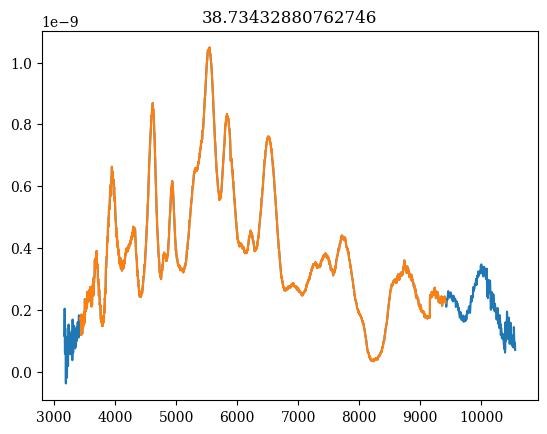

6.007477493945058e-10
4.346483670016934e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


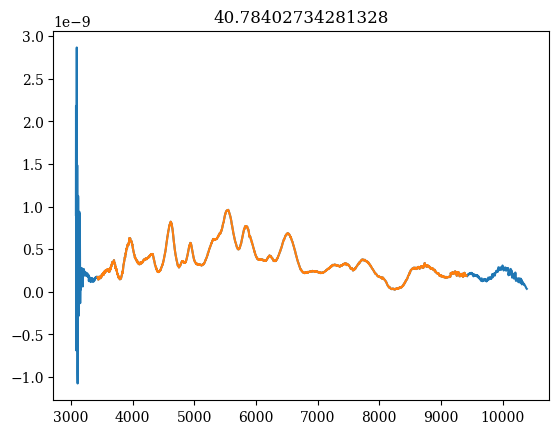

1.923344009755376e-11
4.174998773919099e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


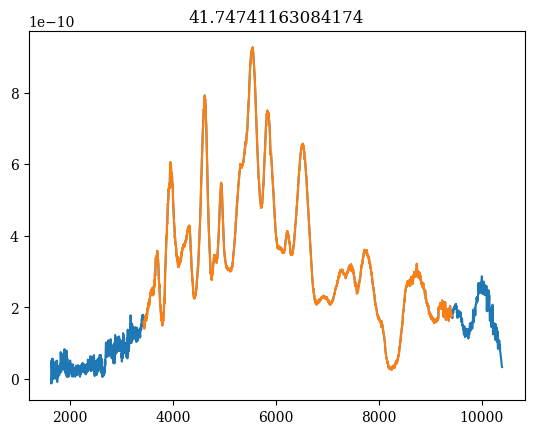

1.803269149940009e-11
1.2972481141998582e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


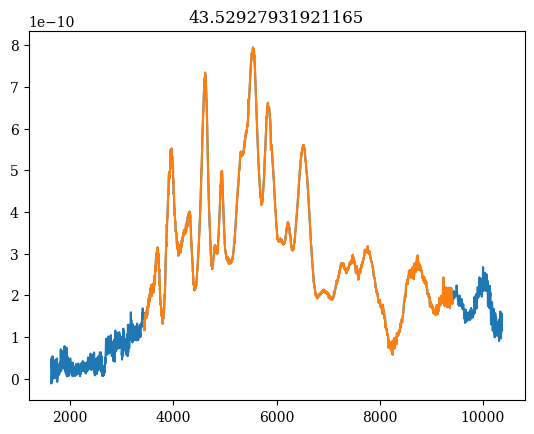

1.8617932424092235e-11
1.3139529378514435e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


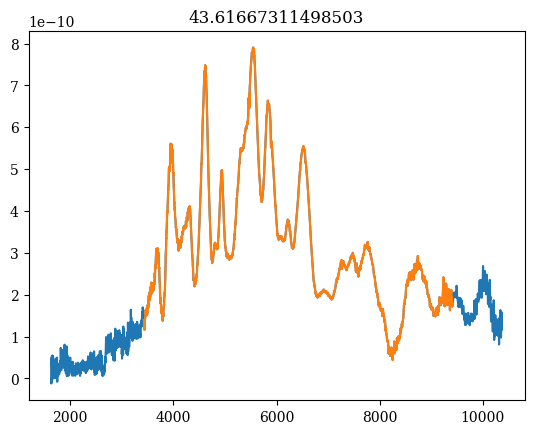

1.9230421985690776e-11
1.2766208085889052e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


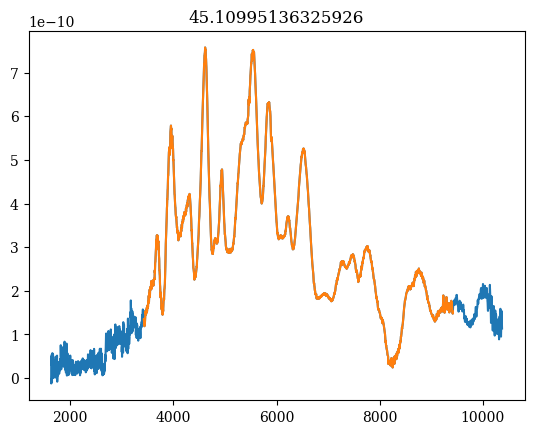

1.950668086089049e-11
1.287115678748409e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


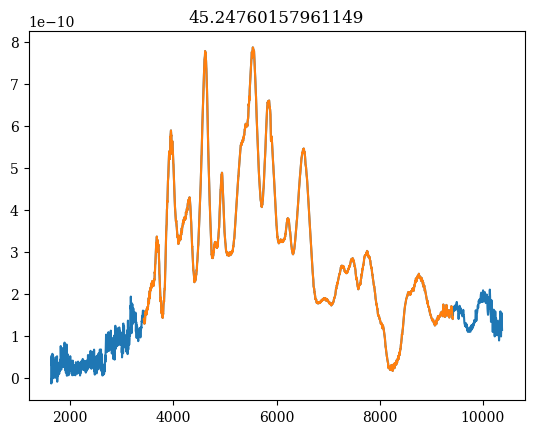

1.9076825846997184e-11
1.262112706297605e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


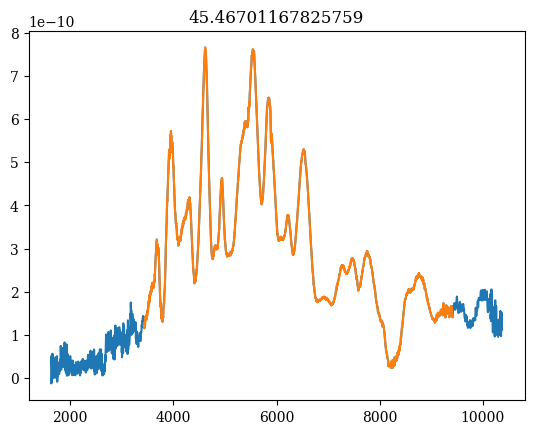

1.912011434817945e-11
1.2318740601225171e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


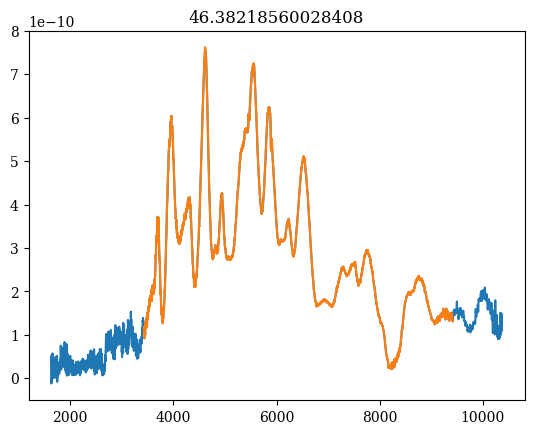

6.304854376115114e-11
1.192050784495884e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


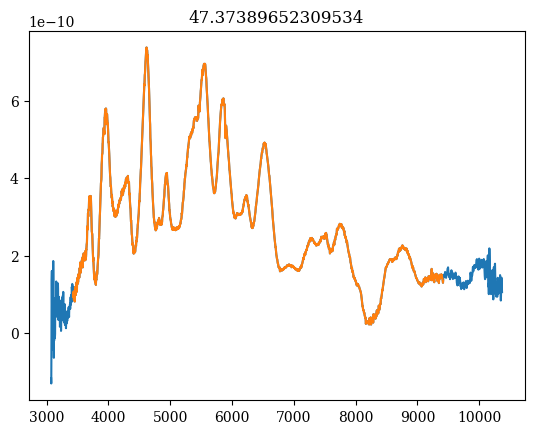

6.348492216170761e-11
7.961873528988007e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


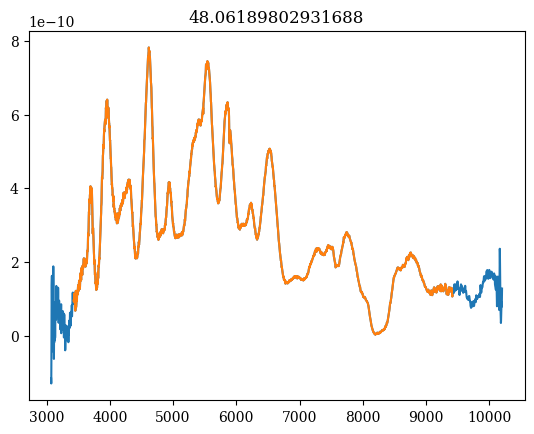

6.404083910595688e-11
-1.6902805854349054e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


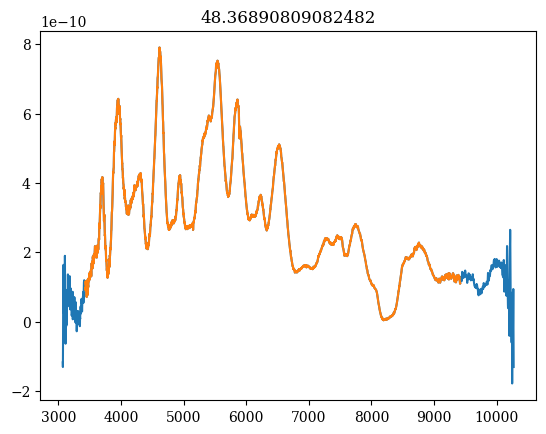

1.5906833485924444e-10
2.7371228420916706e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


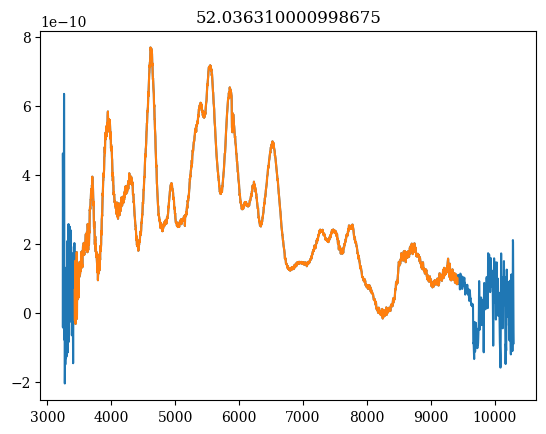

1.5036115757146789e-10
2.633881824390186e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


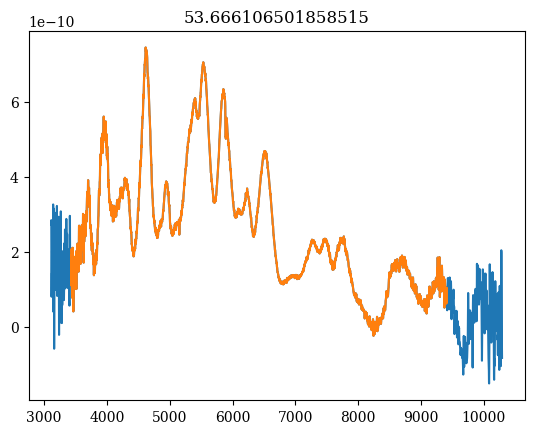

1.6589562379899586e-10
5.5114949714315784e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


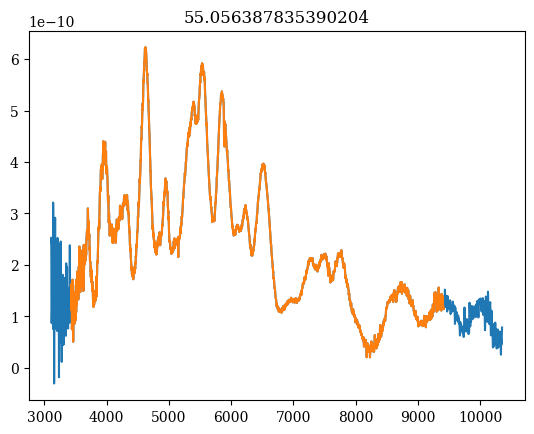

1.6225275274714507e-10
5.379182237701049e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


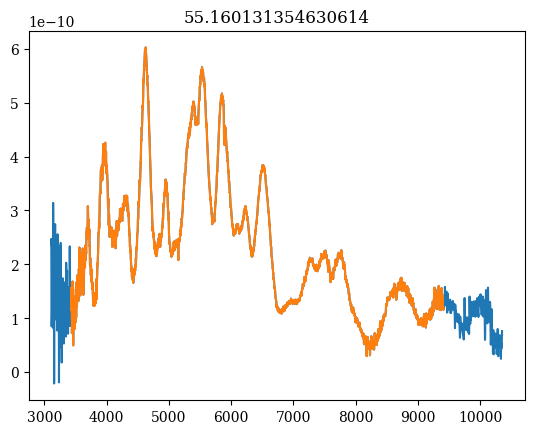

1.6136794634167447e-10
5.308187437374076e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


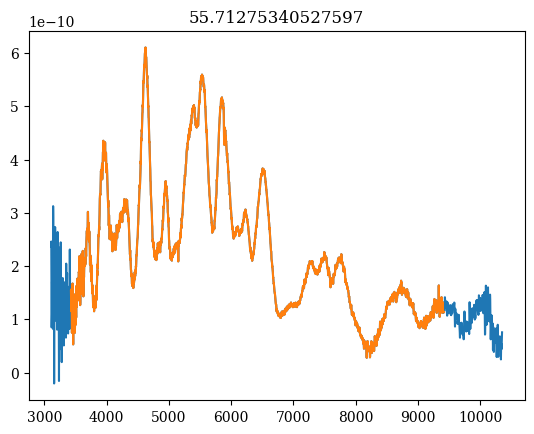

1.6024548746924576e-10
5.271118816012673e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


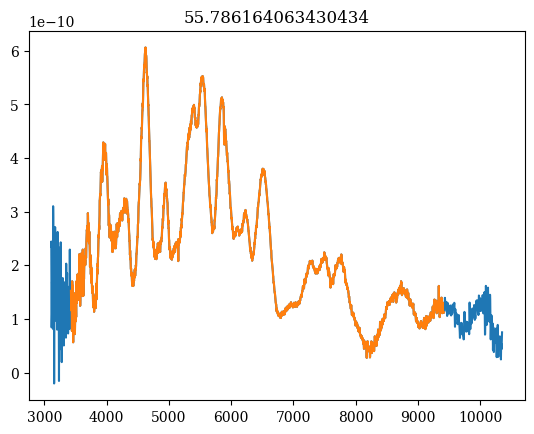

1.5653039317497216e-10
5.1488269896831066e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


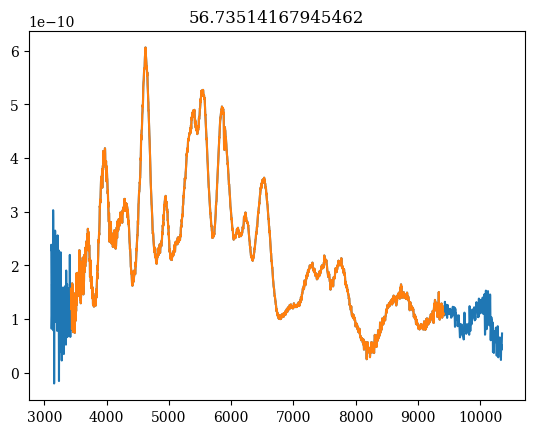

1.5533407456424257e-10
5.1680298274752726e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


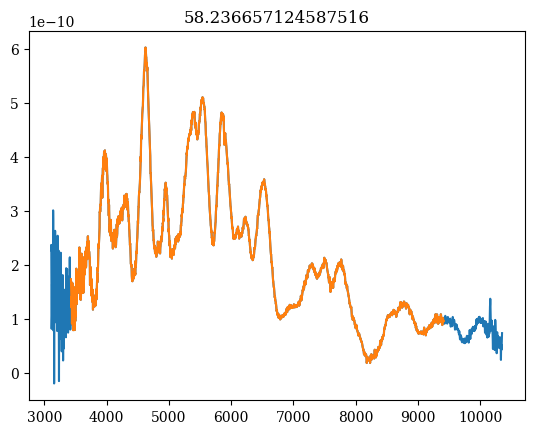

1.2297558541903287e-10
5.1145852054059835e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


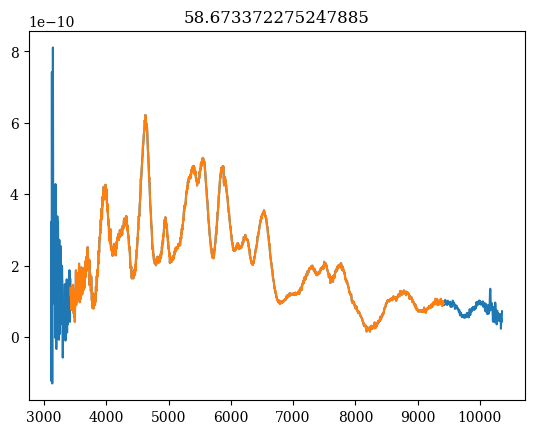

4.828539361323225e-10
1.1517860208941625e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


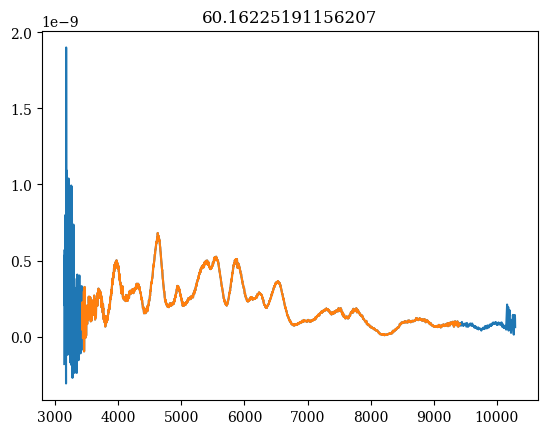

2.3795214651163263e-09
1.1292273878928633e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


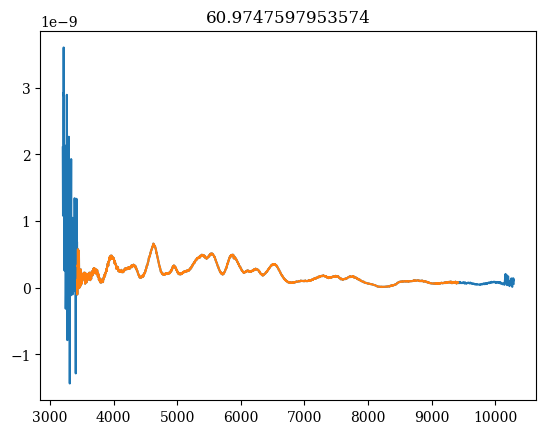

2.6311891552735436e-10
5.706032843677591e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


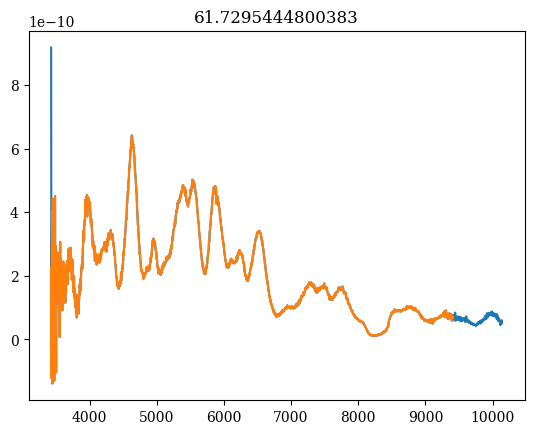

-1.3351598301924393e-10
5.3677484086549275e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


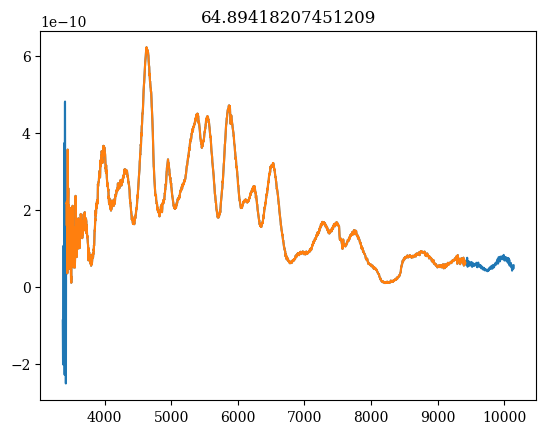

6.607386745977798e-11
6.759111231265645e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


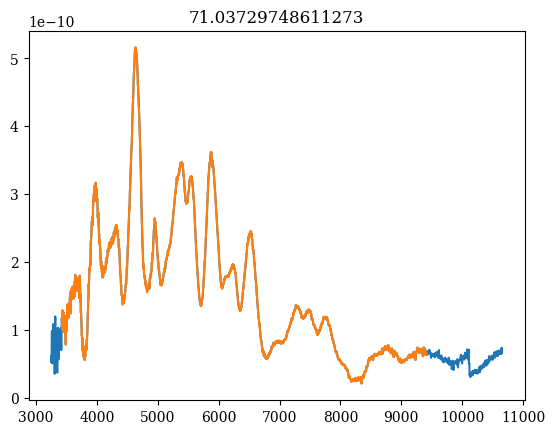

-7.545263506930102e-11
6.650948009468245e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


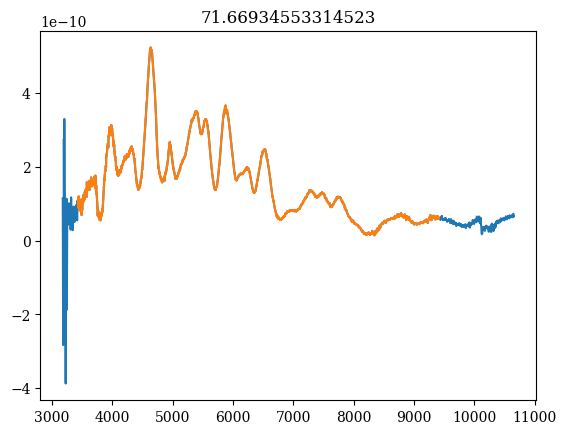

-7.653772834834961e-11
1.1613773169998523e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


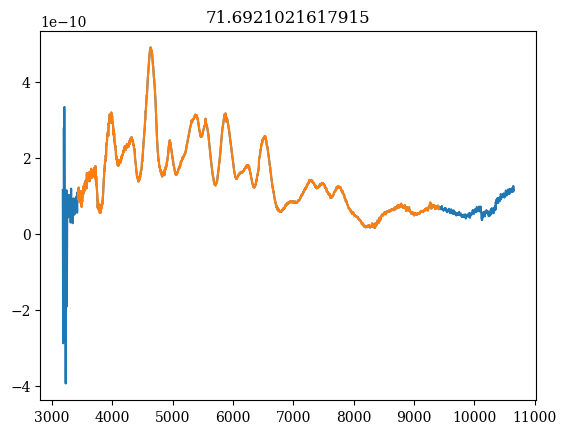

-7.59330057817862e-11
1.1485883007907096e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


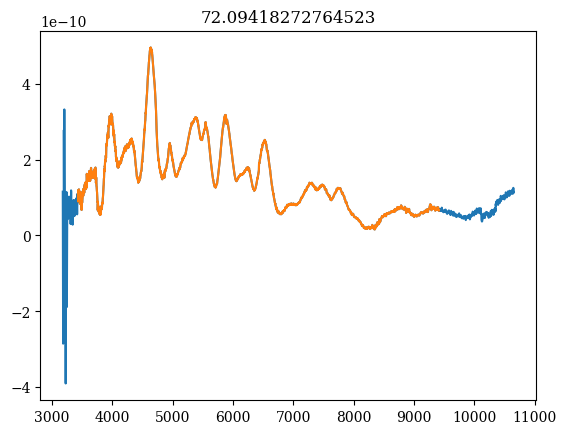

-7.470711135007191e-11
1.1481913358678606e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


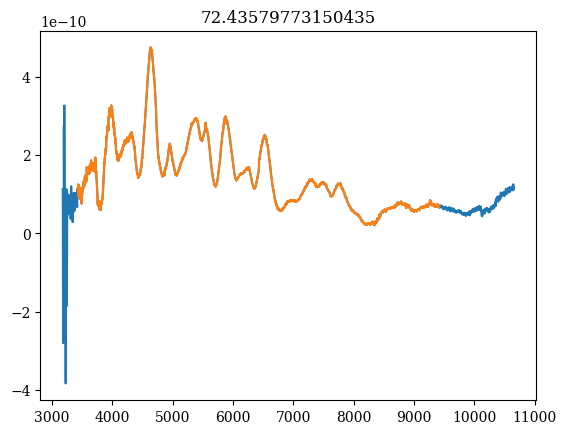

-7.245528633843811e-11
1.1131928594448795e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


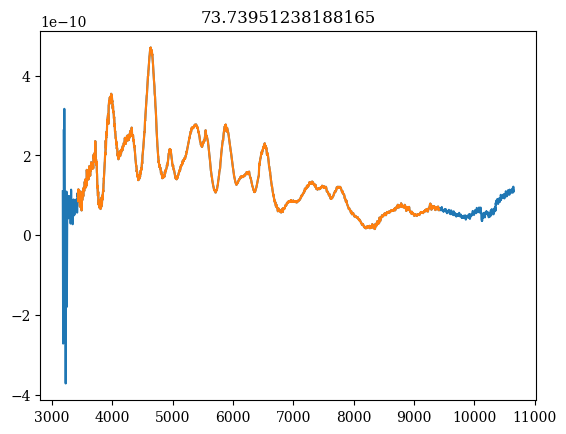

-7.475472519227004e-11
1.1426072670728185e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


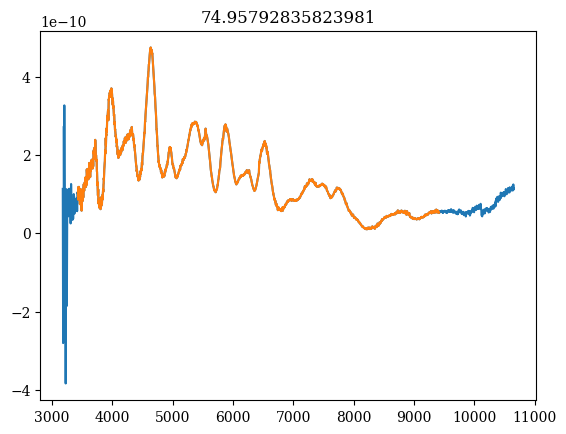

-7.073010894258104e-11
1.0709324347469148e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


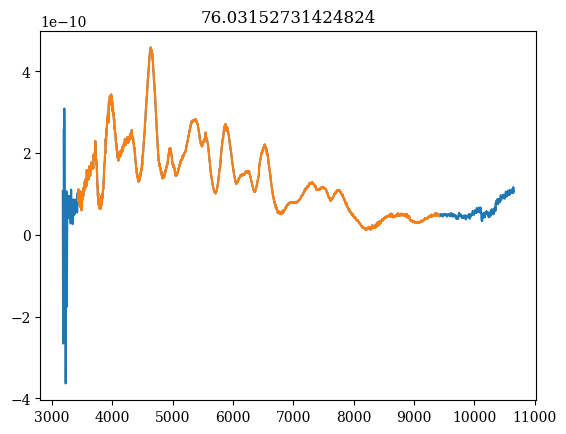

-6.934576067907982e-11
-1.0436027048678256e-10
[3428. 3430. 3432. ... 9412. 9414. 9416.]


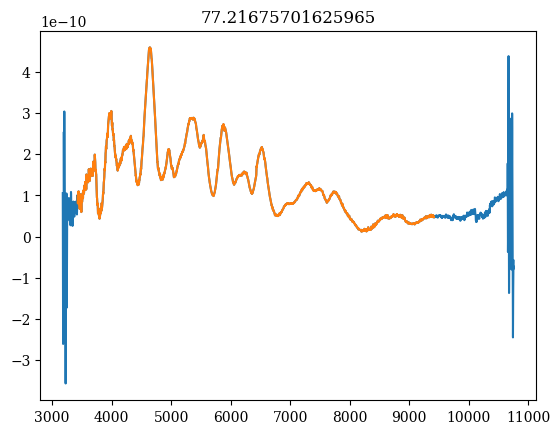

-3.4571393176548305e-11
-9.015709409465543e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


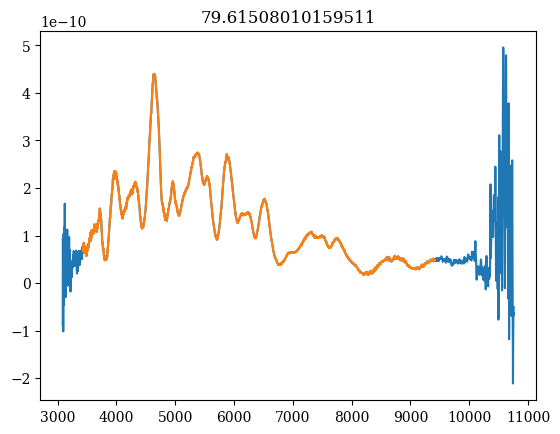

-3.471078164972568e-11
-9.052963692932768e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


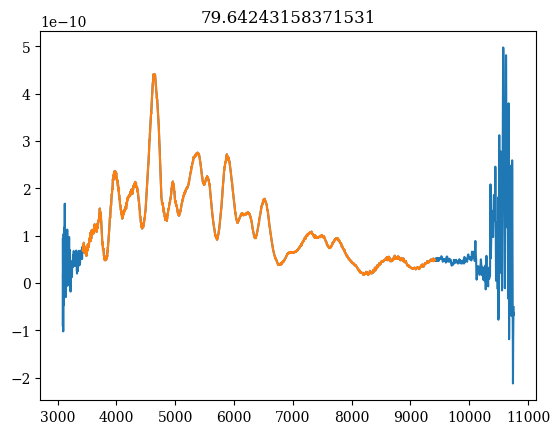

-3.4579432793458094e-11
-8.978455125998315e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


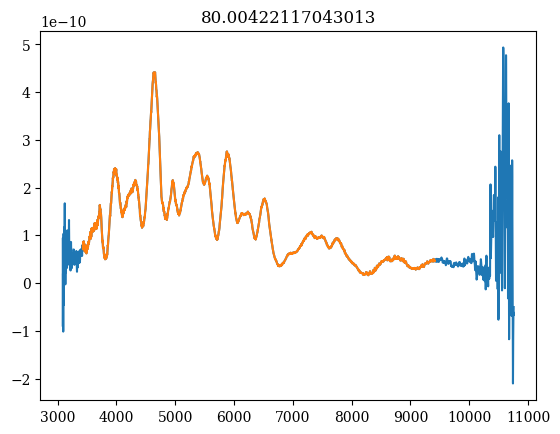

-3.1591595969161874e-11
-8.196115173186575e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


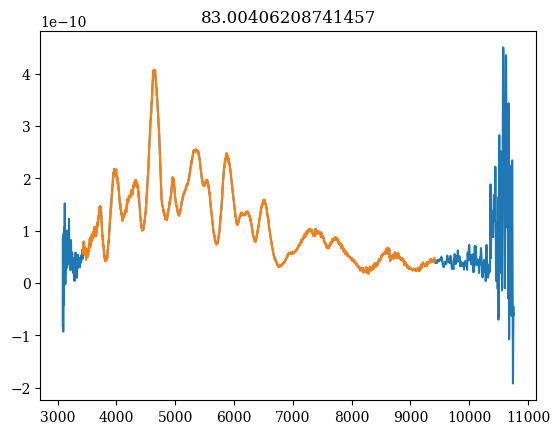

-2.9646954303756833e-11
-7.674555204645415e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


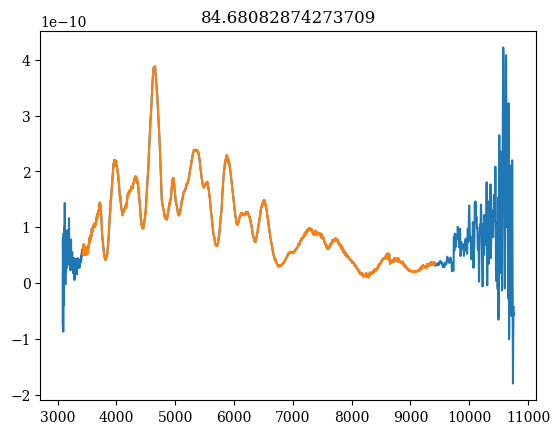

-2.966319431237474e-11
-7.674555204645416e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


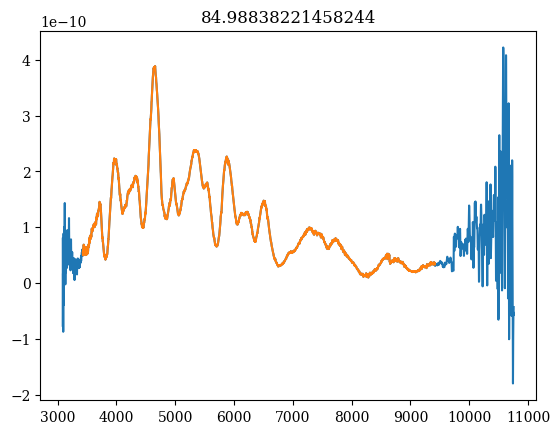

-2.880756298378981e-11
-7.451029503842064e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


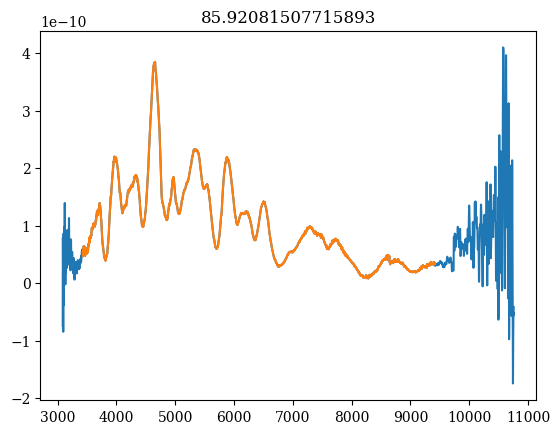

-2.8340273772724616e-11
-7.339266653440385e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


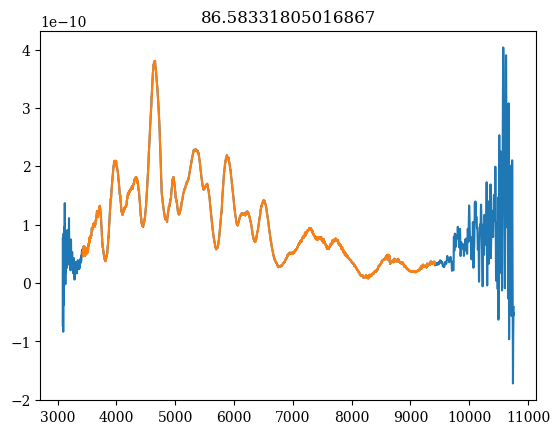

-2.850519722385198e-11
-7.376520936907611e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


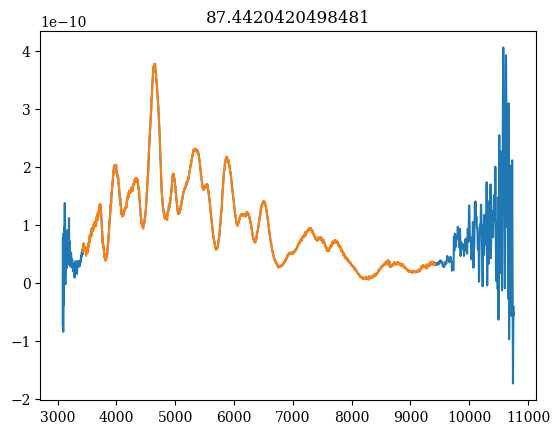

-2.6768265236028616e-11
-6.929469535300904e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


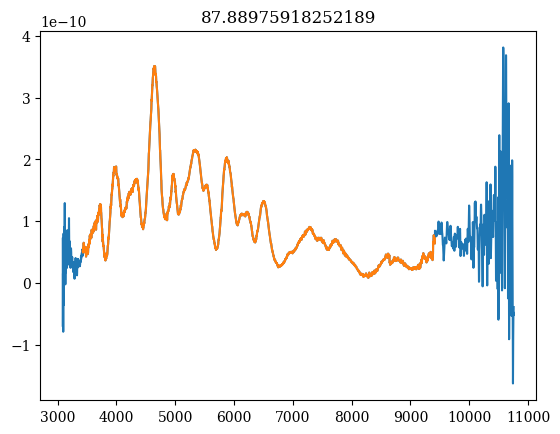

-2.7056003778918153e-11
-7.003978102235357e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


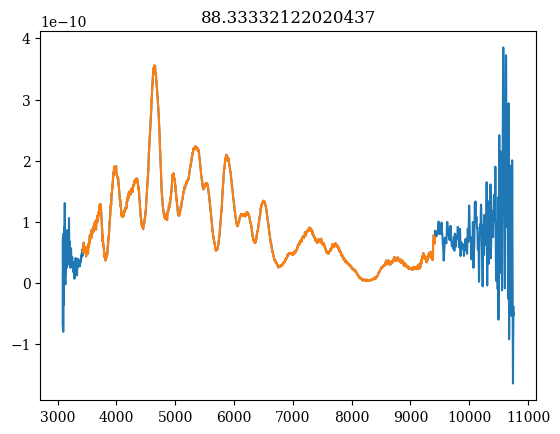

-2.9316347847192024e-11
2.533304638481041e-11
[3428. 3430. 3432. ... 9412. 9414. 9416.]


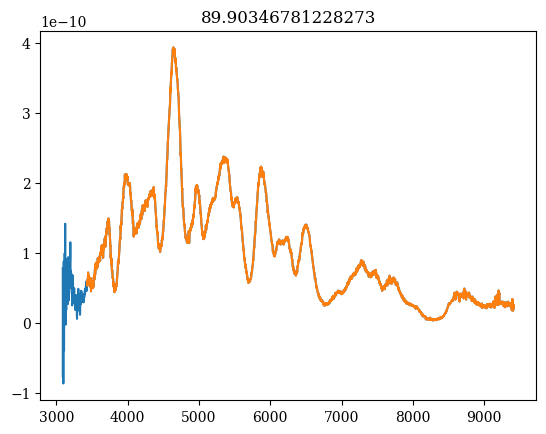

[-11.55054391  -8.3100462   -7.41657646  -5.97538499  -5.37981295
  -4.6544208   -3.13775541  -2.59650769  -1.75260226  -0.39601997
   0.46189645   1.55894998   2.27093615   3.77661167   4.4487805
   5.33065433   6.84800741   7.54849281   8.29190802   9.1661163
  10.41273562  11.0955974   12.29678438  13.09444689  14.6199781
  15.38464075  16.07633425  17.70895962  18.35548821  19.3521499
  20.7684878   21.1722207   22.21875791  23.53314206  24.51387481
  25.34139065  26.44334886  27.70852328  28.48224076  29.17778352
  30.66870066  31.91816366  32.20326348  36.23961125  36.63922072
  37.39991569  37.60246017  38.73432881  40.78402734  41.74741163
  43.52927932  43.61667311  45.10995136  45.24760158  45.46701168
  46.3821856   47.37389652  48.06189803  48.36890809  52.03631
  53.6661065   55.05638784  55.16013135  55.71275341  55.78616406
  56.73514168  58.23665712  58.67337228  60.16225191  60.9747598
  61.72954448  64.89418207  71.03729749  71.66934553  71.69210216
  72.09418273  72.

In [37]:
spec_arr_new = []
minwaves = []
maxwaves = []
for spec in calibrated_spec_array_highv:
    minwaves.append(spec.wavelength[spec.x1])
    maxwaves.append(spec.wavelength[spec.x2])
wrange = [np.amax(minwaves), np.amin(maxwaves)]
print (wrange)

for spec in calibrated_spec_array_highv:
    spec_arr_new.append(spec)
specnew, phases, waves = fc.prepare_spec(spec_arr_new,waverange=wrange,plot=True)
print (phases)
print (waves)

In [38]:
X2_highv, Y2_highv, Z2_highv = fc.linear_interpolation(specnew, waves, phases)

(2995,)
(93,)
(93, 2995)


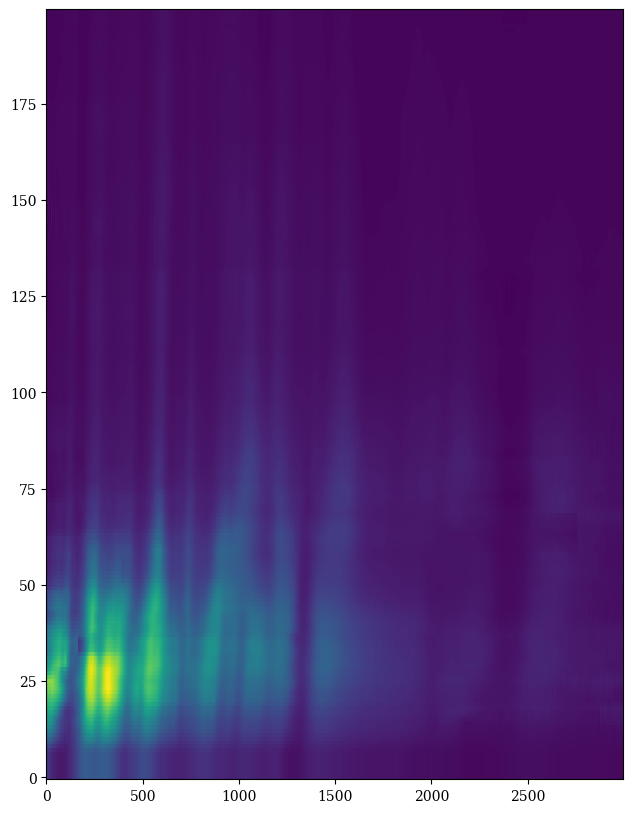

In [39]:
plt.figure(figsize=[10,10])
plt.imshow(Z2_highv,aspect=20, origin='lower', interpolation='none')
plt.show()

-15.0


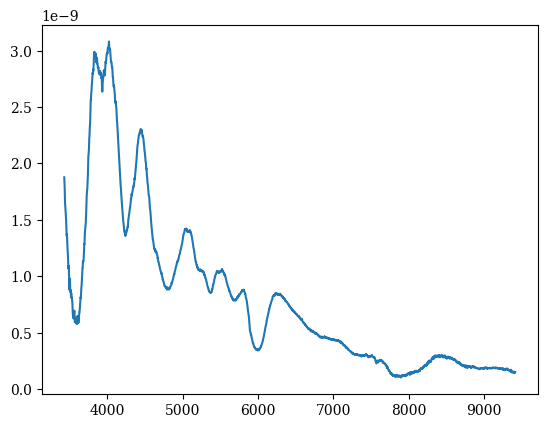

-14.472361809045227


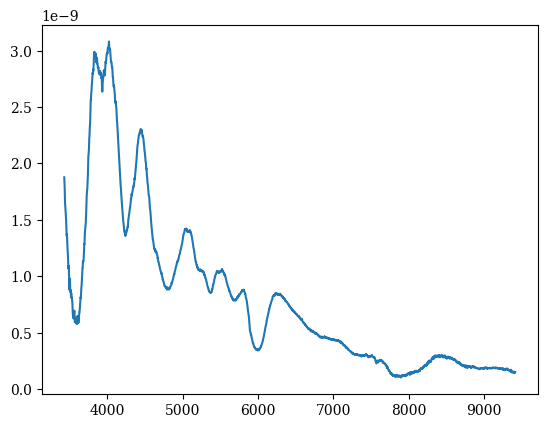

-13.944723618090453


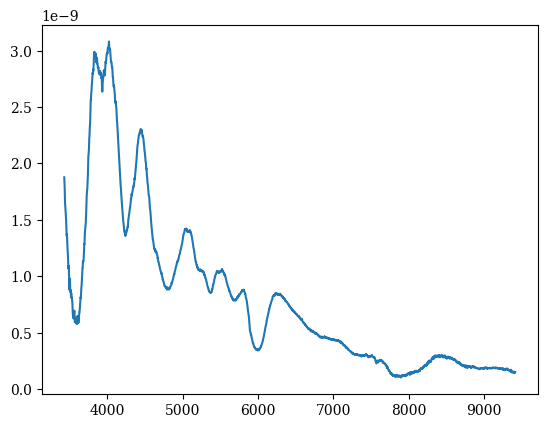

-13.417085427135678


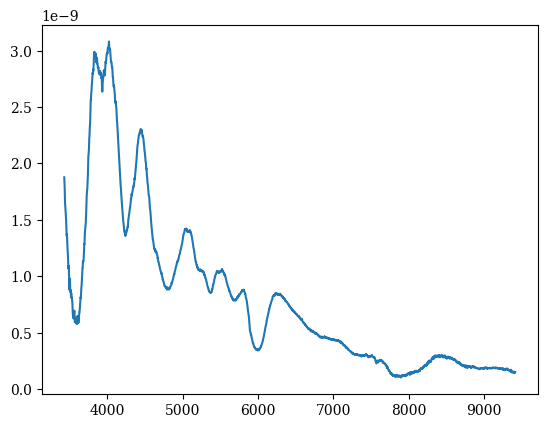

-12.889447236180905


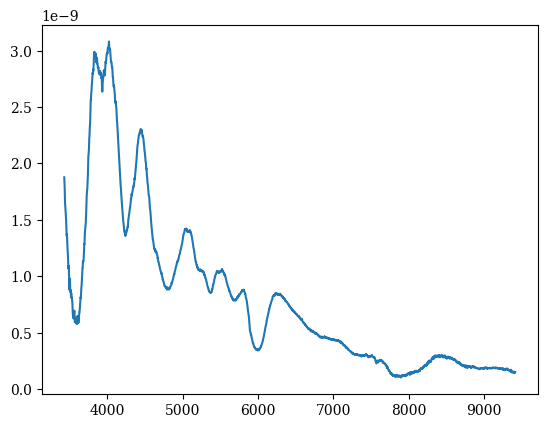

-12.361809045226131


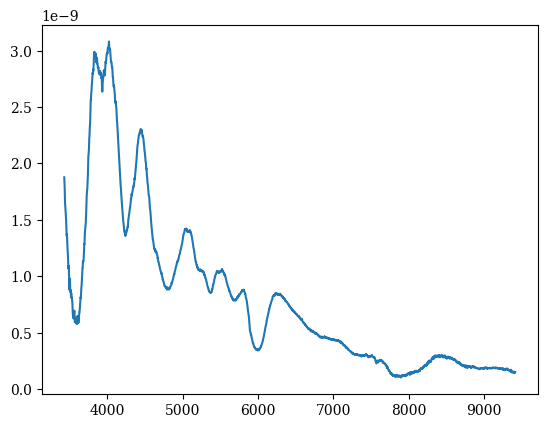

-11.834170854271356


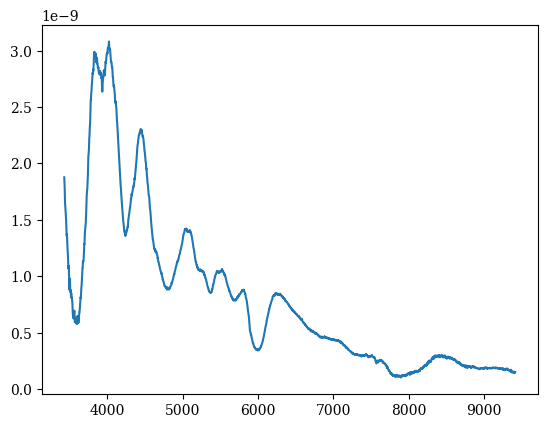

-11.306532663316583


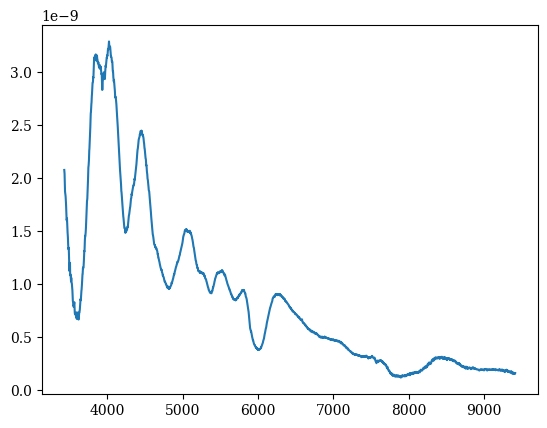

-10.77889447236181


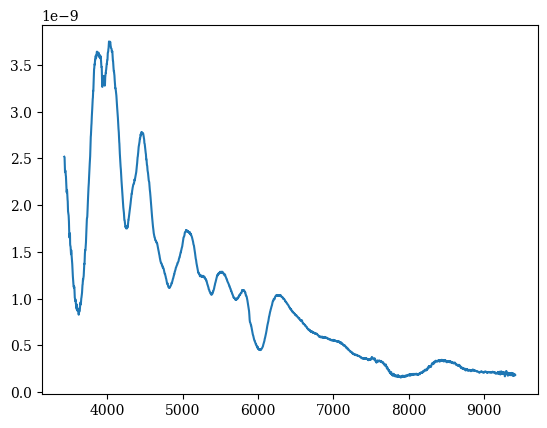

-10.251256281407036


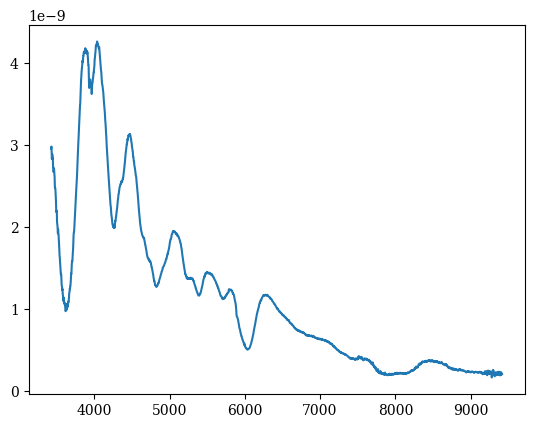

-9.723618090452263


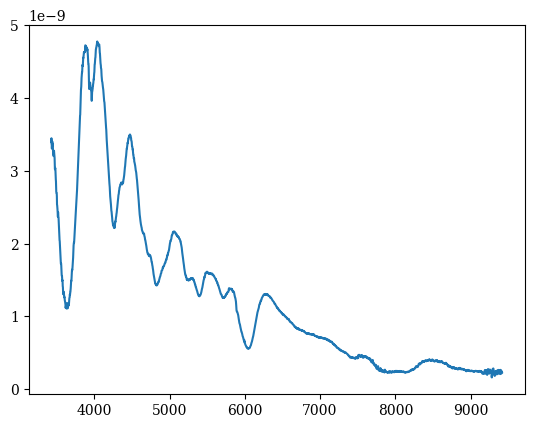

-9.195979899497488


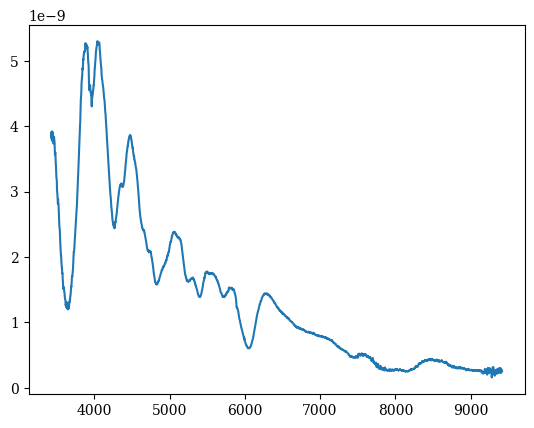

-8.668341708542714


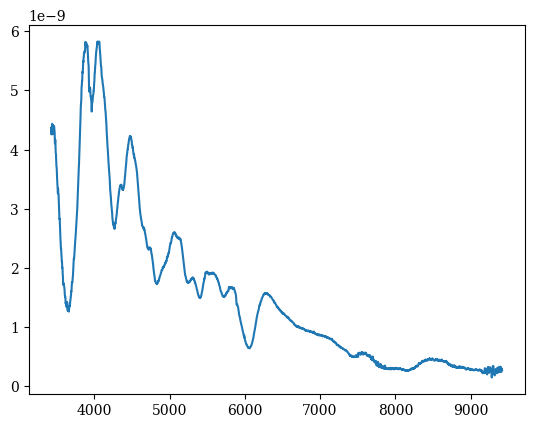

-8.14070351758794


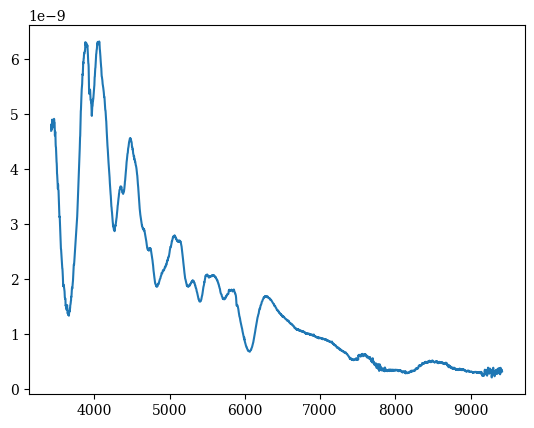

-7.6130653266331665


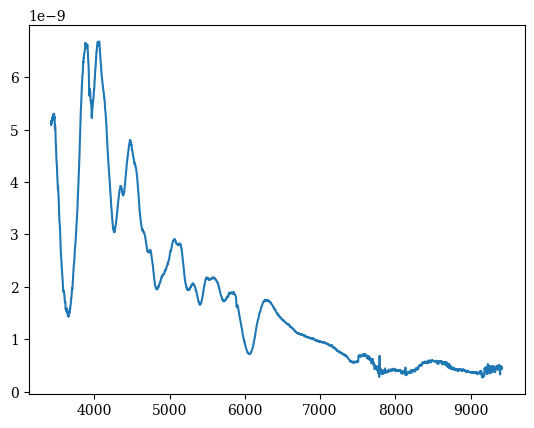

-7.085427135678392


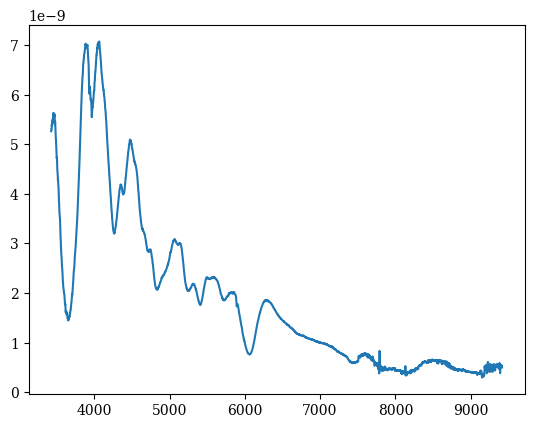

-6.557788944723619


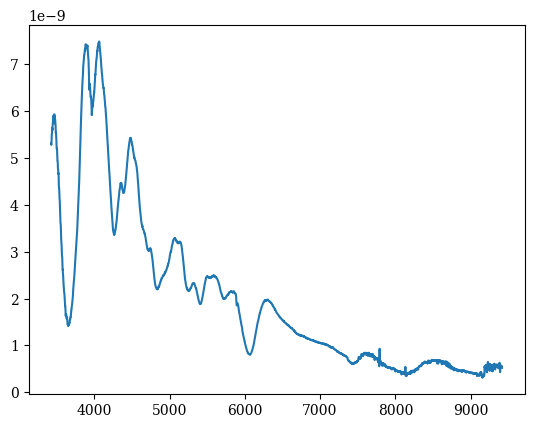

-6.0301507537688455


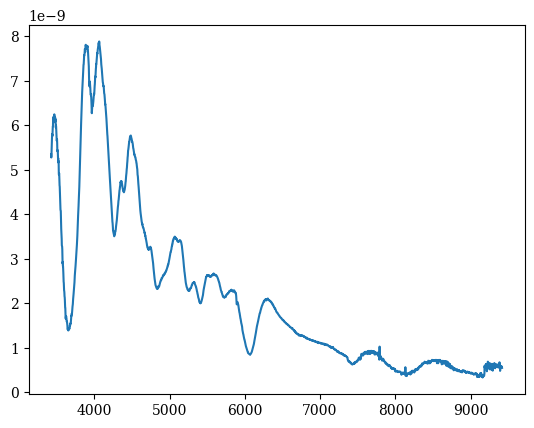

-5.502512562814072


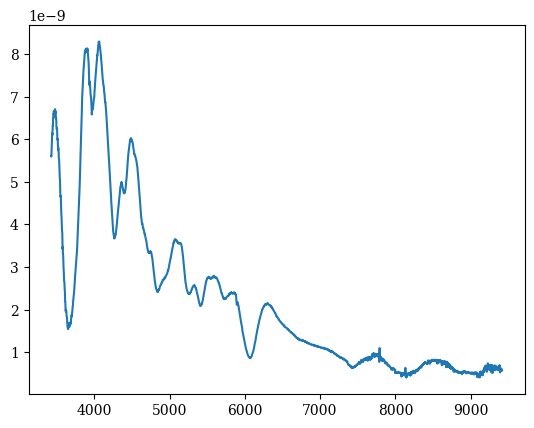

-4.974874371859297


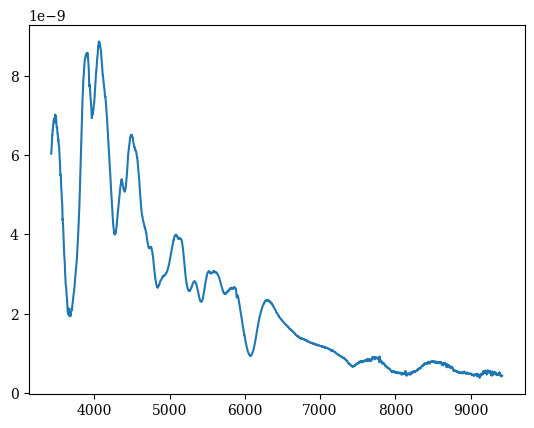

-4.4472361809045236


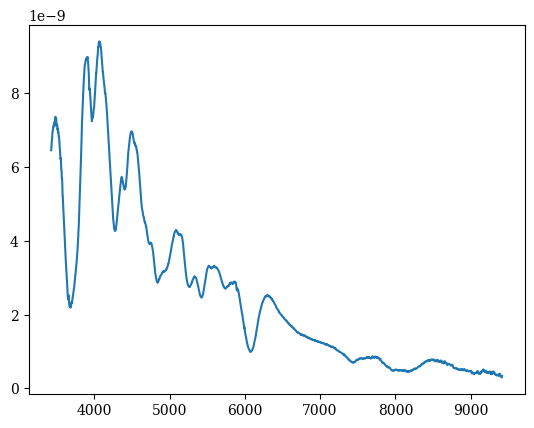

-3.91959798994975


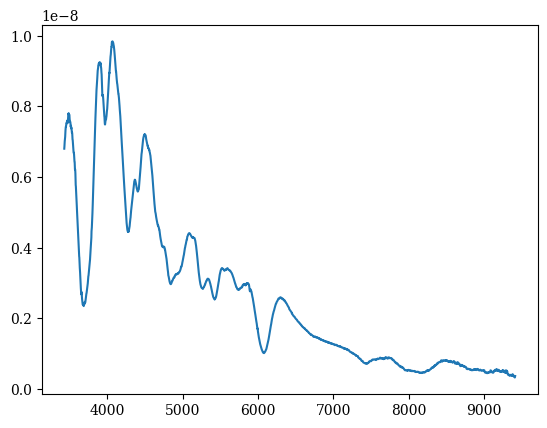

-3.391959798994975


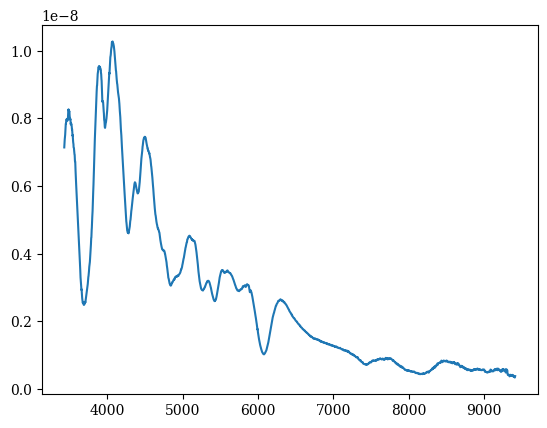

-2.8643216080402016


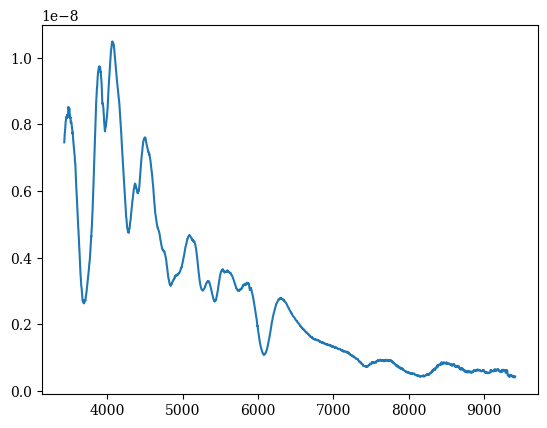

-2.3366834170854283


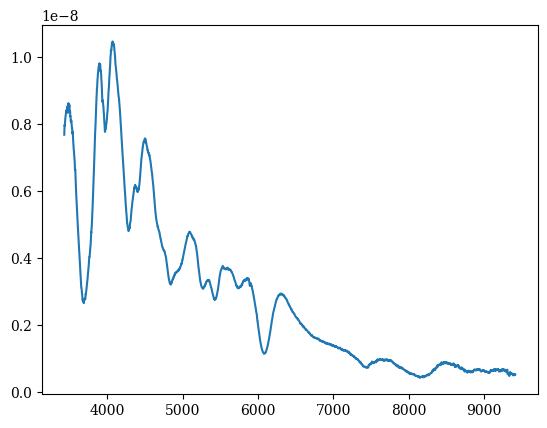

-1.8090452261306549


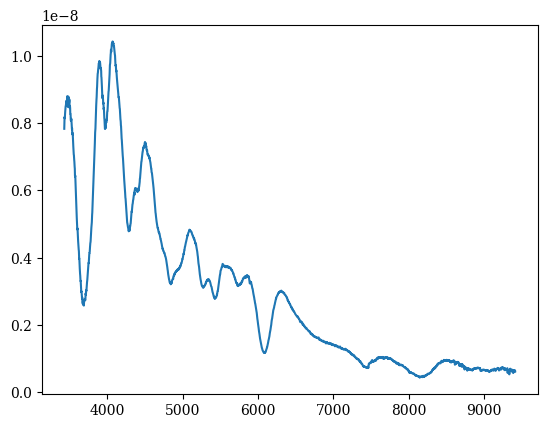

-1.2814070351758815


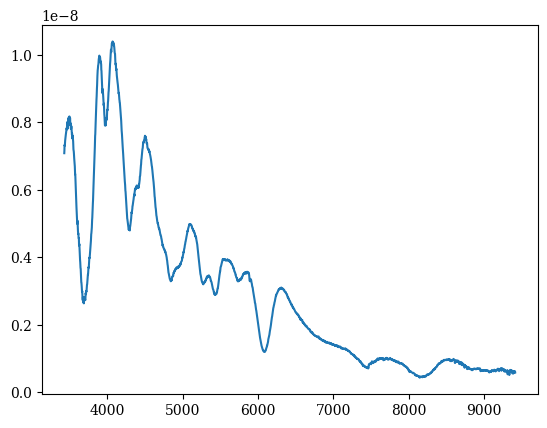

-0.7537688442211063


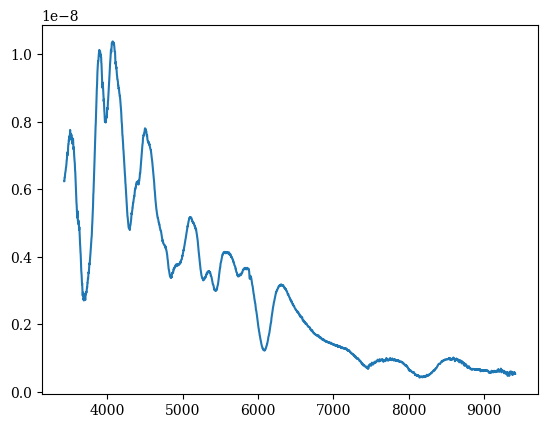

-0.22613065326633297


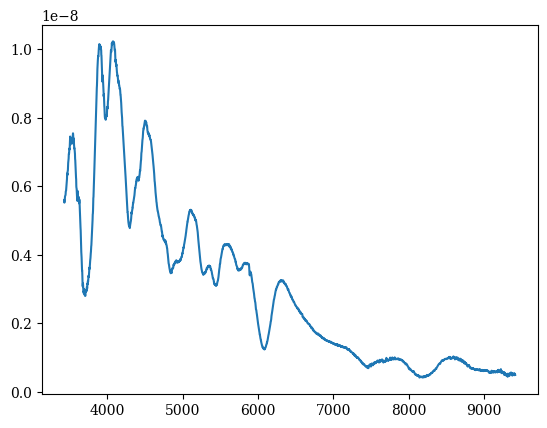

0.3015075376884404


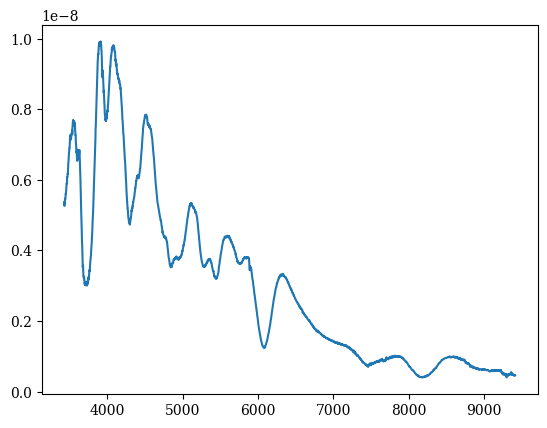

0.8291457286432156


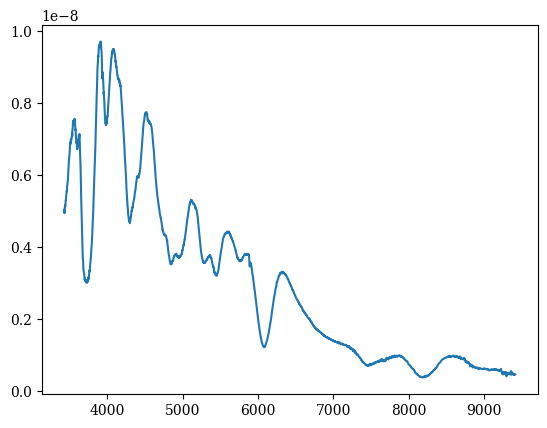

1.3567839195979872


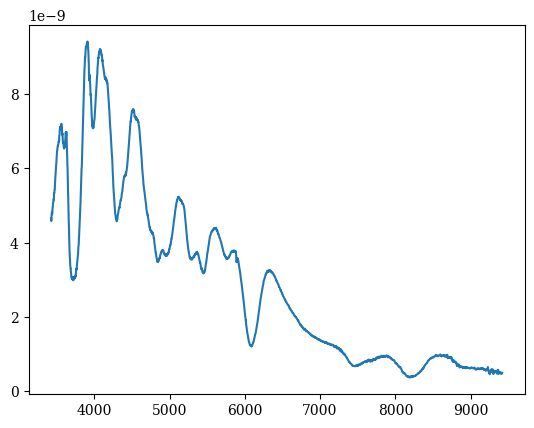

1.8844221105527623


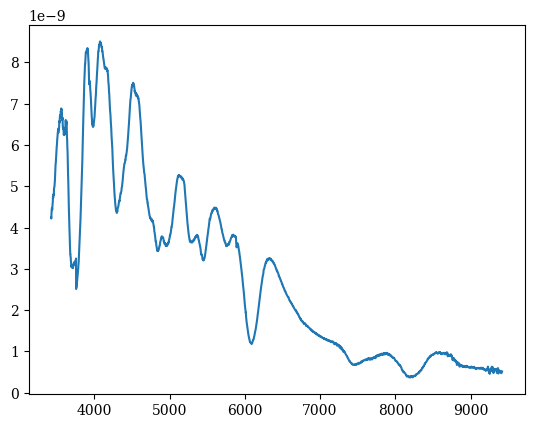

2.4120603015075375


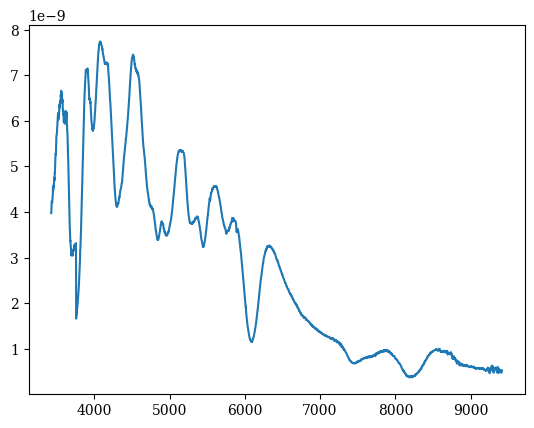

2.939698492462309


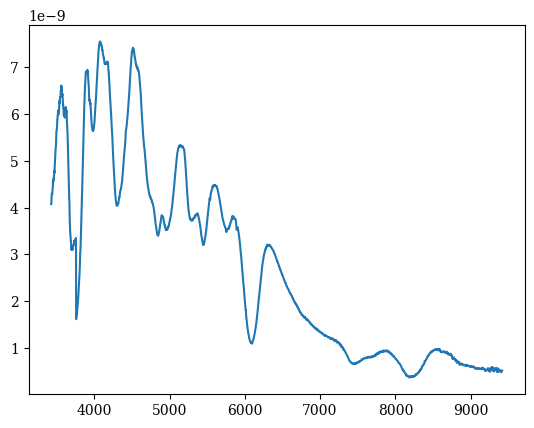

3.4673366834170842


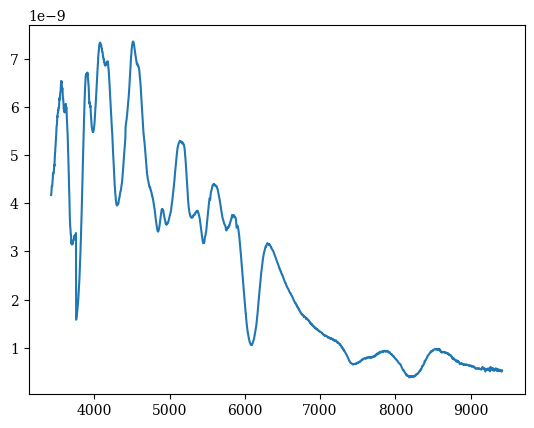

3.994974874371856


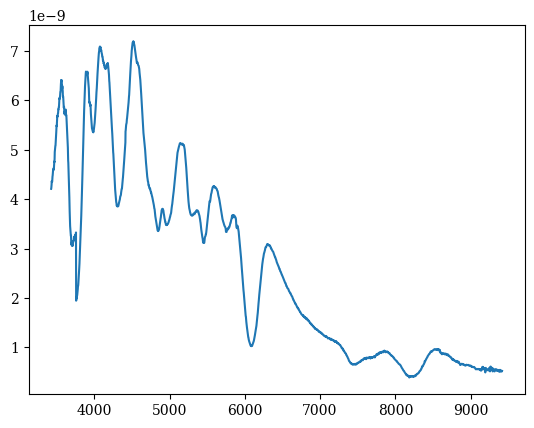

4.522613065326631


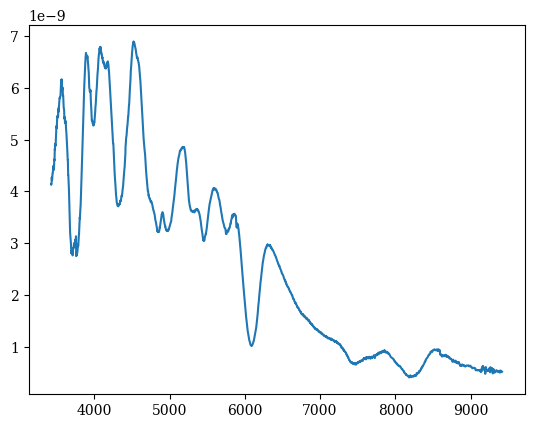

5.050251256281406


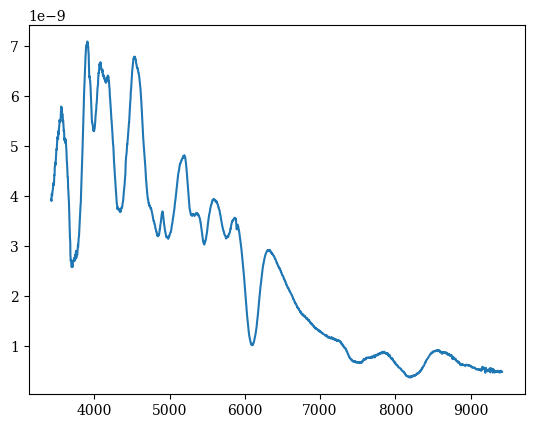

5.577889447236178


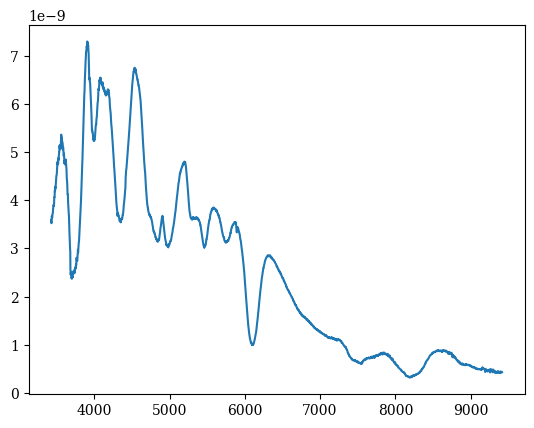

6.105527638190953


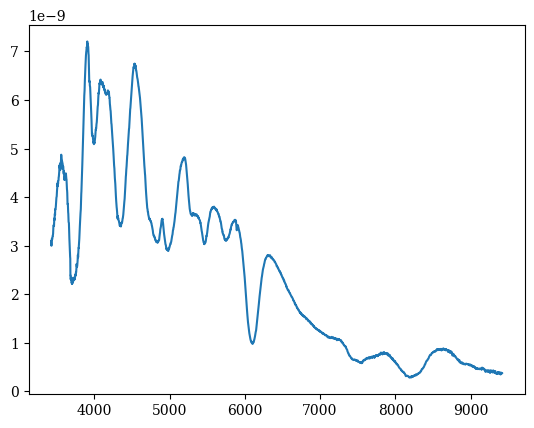

6.633165829145728


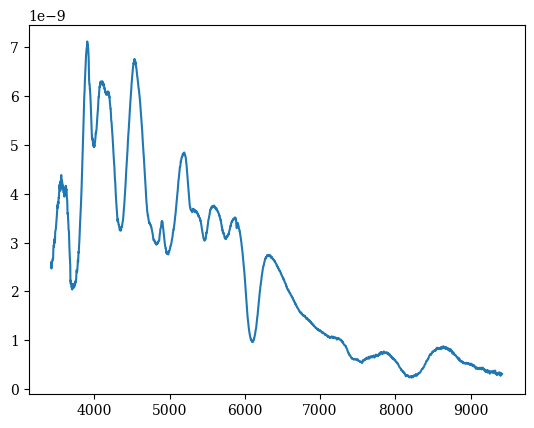

7.1608040201005


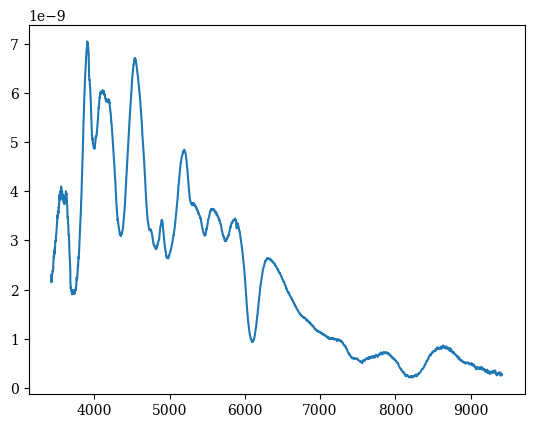

7.688442211055275


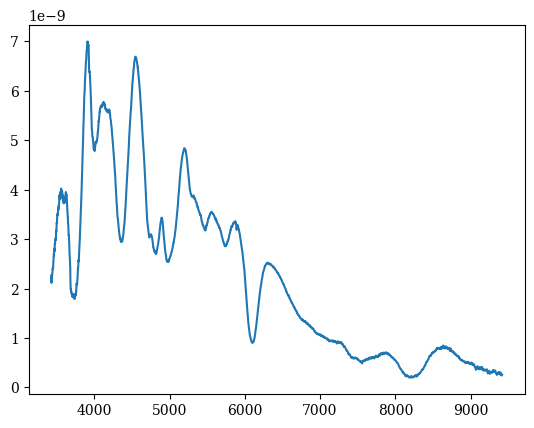

8.21608040201005


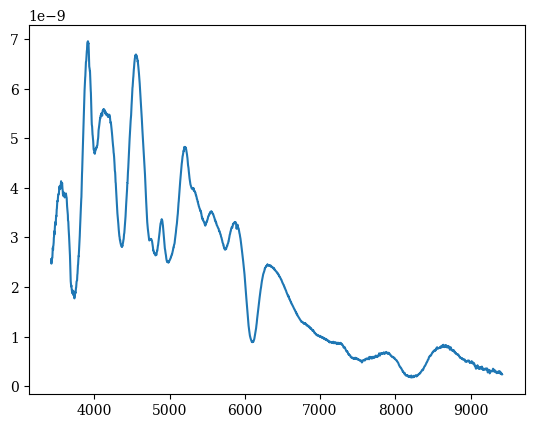

8.743718592964822


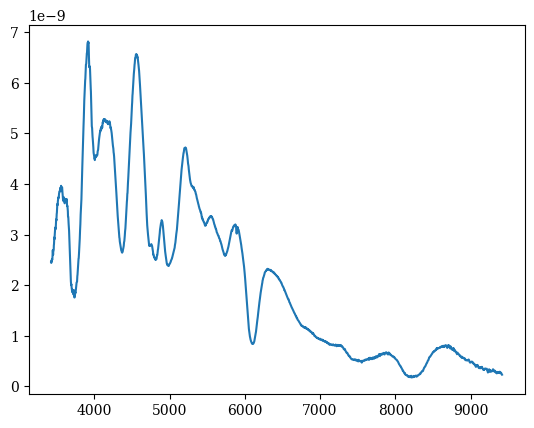

9.271356783919597


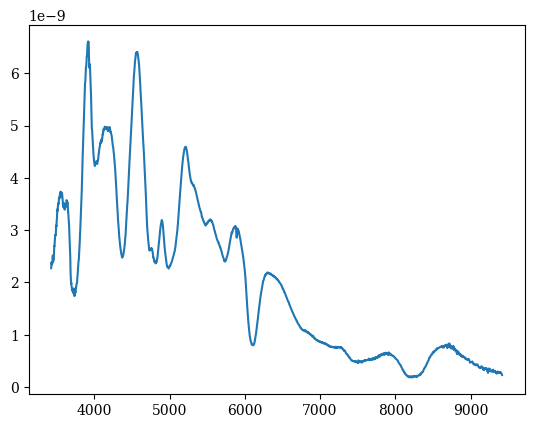

9.798994974874368


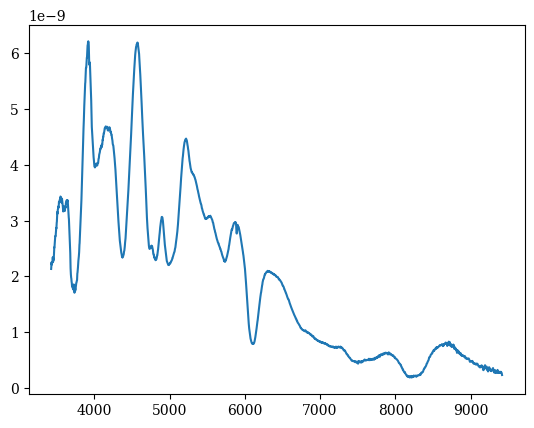

10.326633165829143


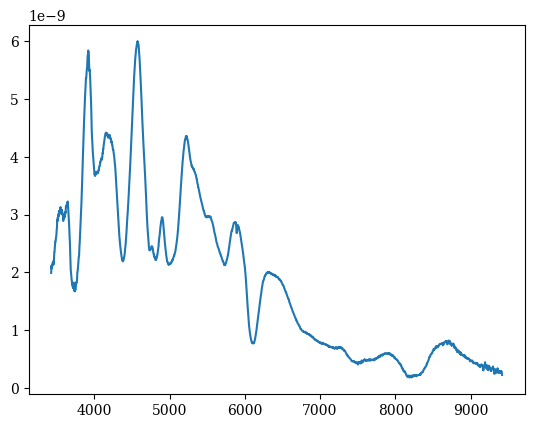

10.854271356783919


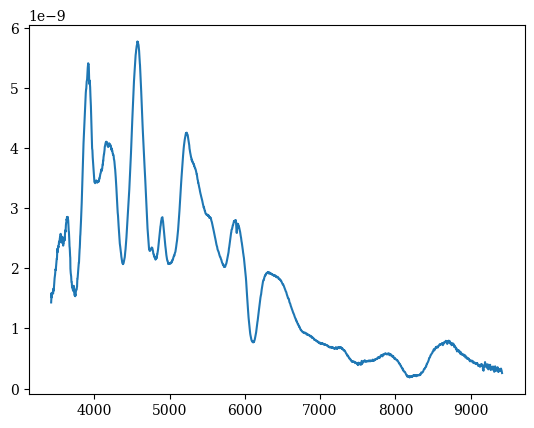

11.38190954773869


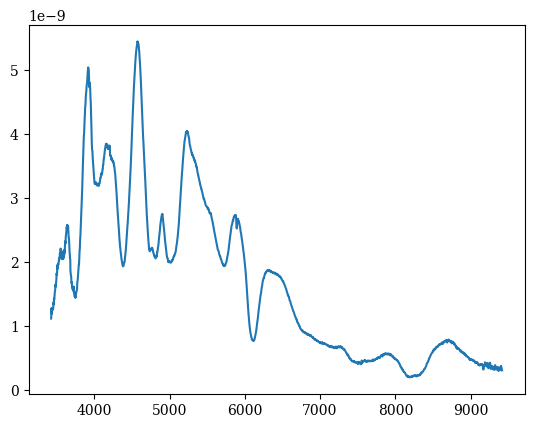

11.909547738693465


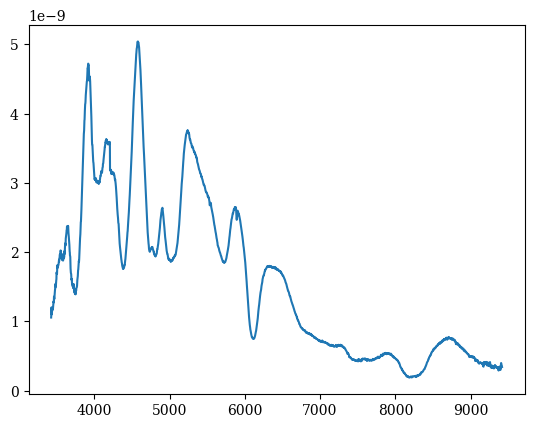

12.437185929648237


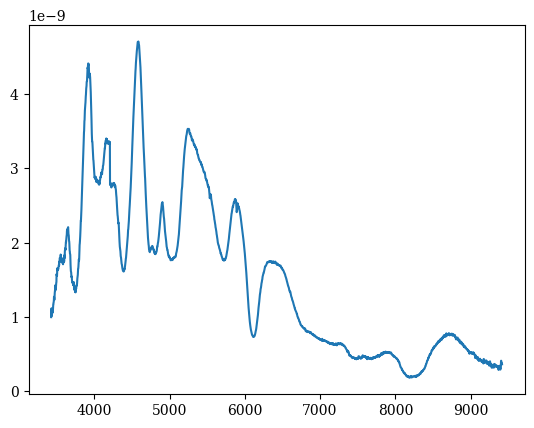

12.964824120603012


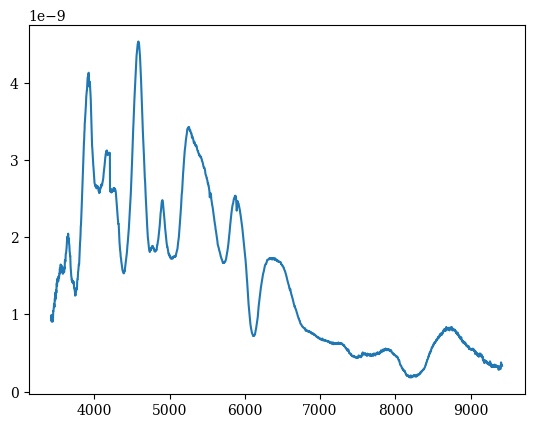

13.492462311557787


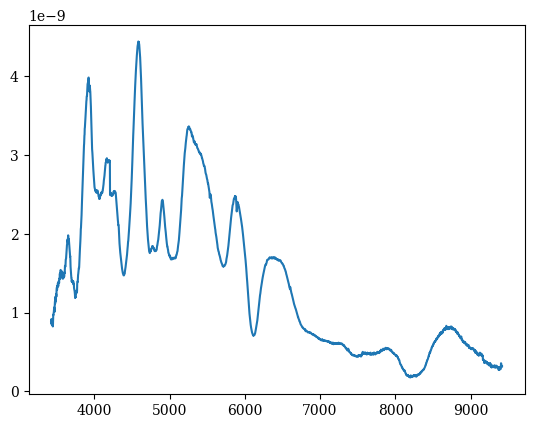

14.020100502512559


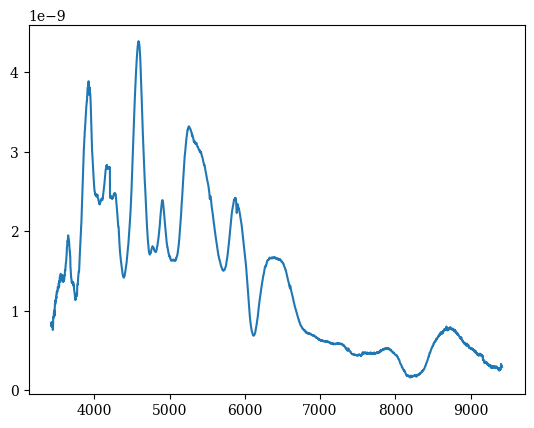

14.547738693467334


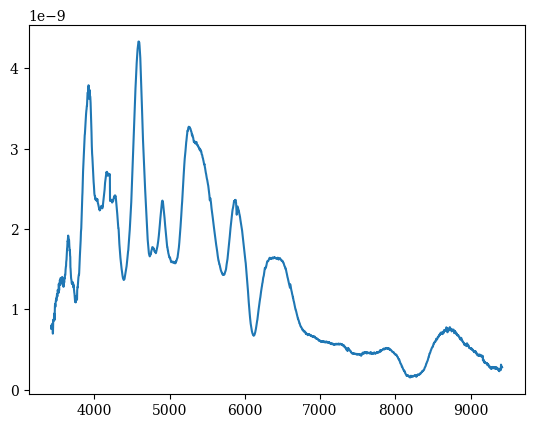

15.07537688442211


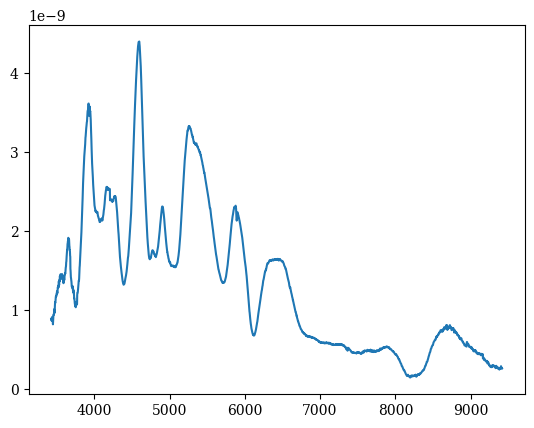

15.60301507537688


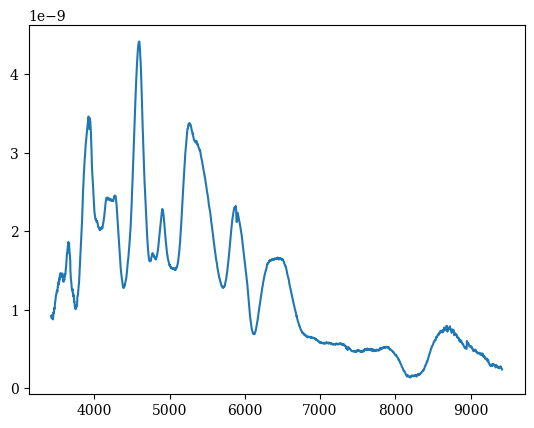

16.130653266331656


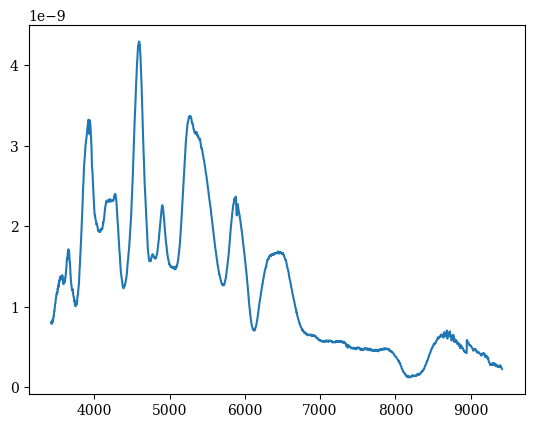

16.65829145728643


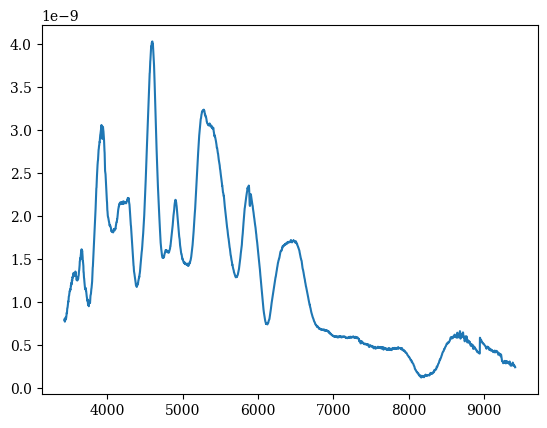

17.185929648241206


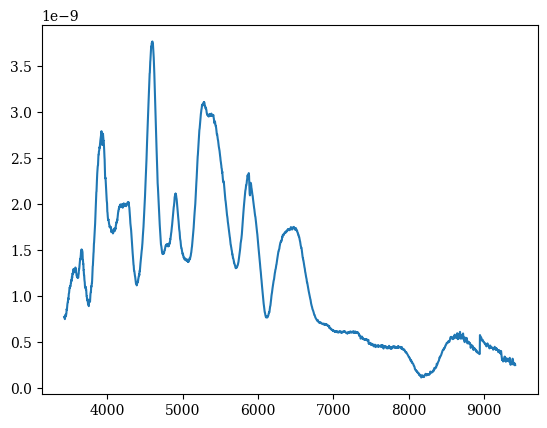

17.713567839195974


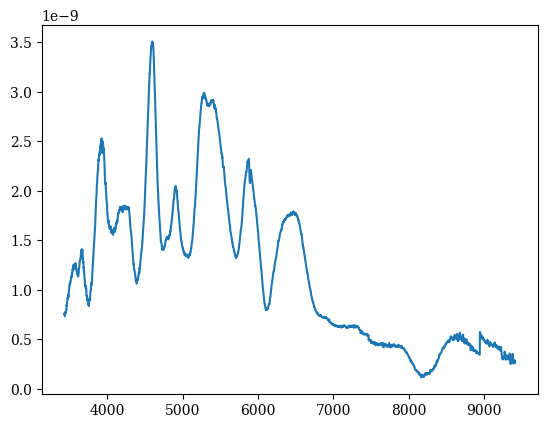

18.24120603015075


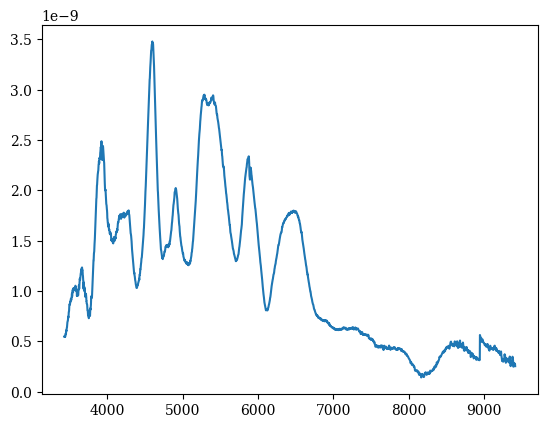

18.768844221105525


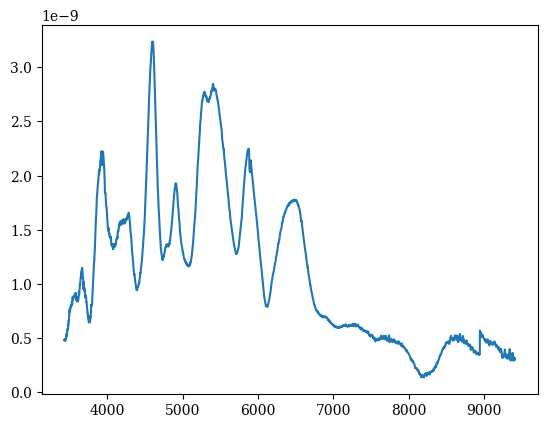

19.2964824120603


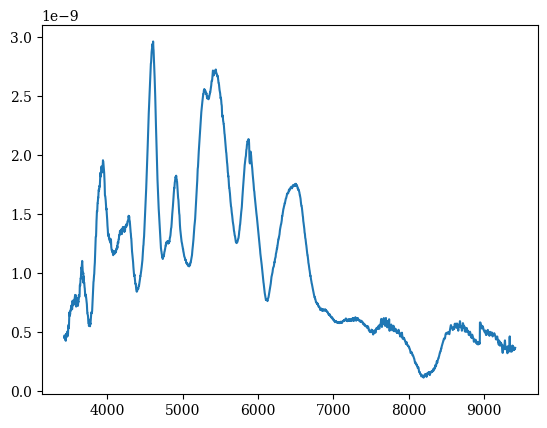

19.824120603015075


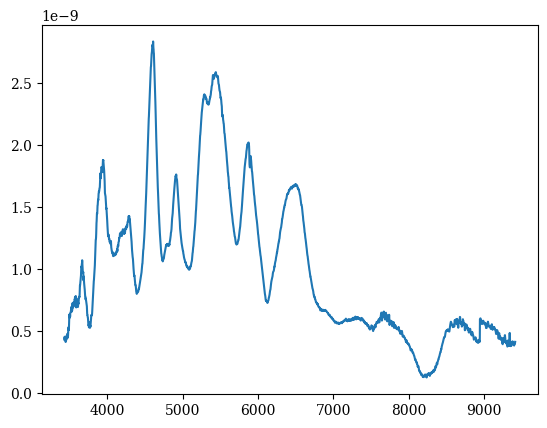

20.351758793969843


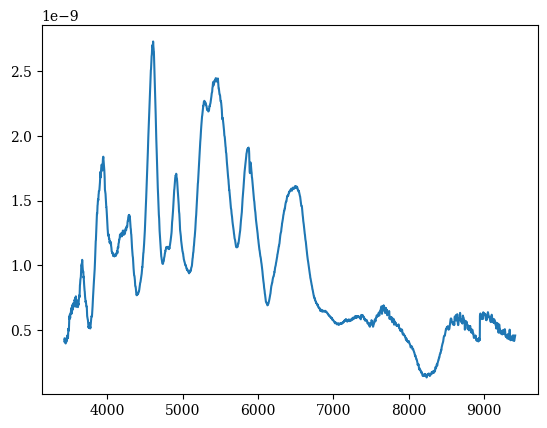

20.879396984924618


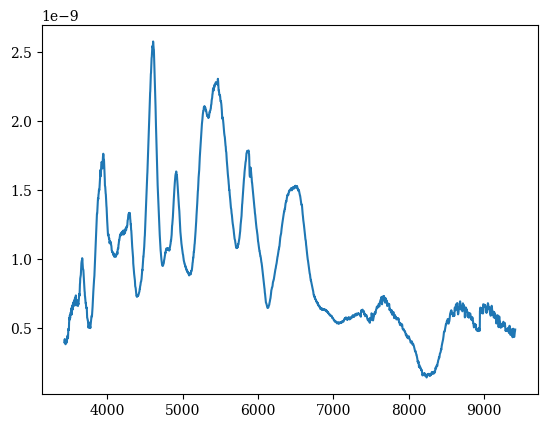

21.407035175879393


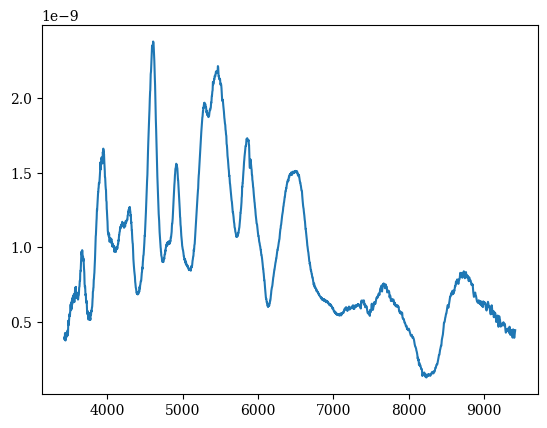

21.93467336683417


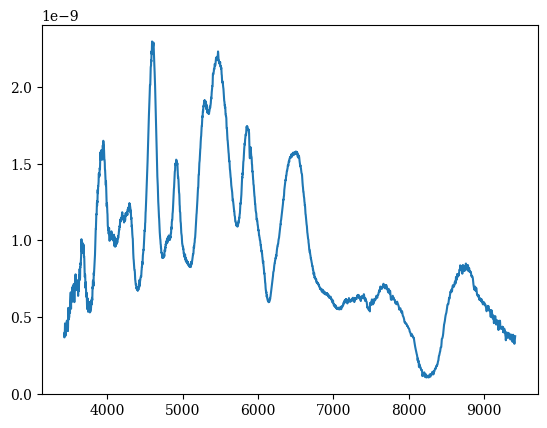

22.462311557788944


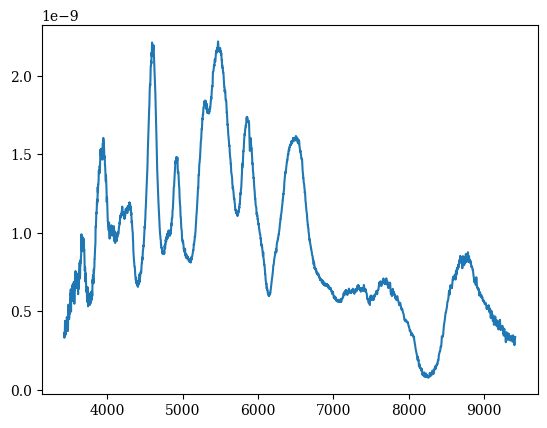

22.98994974874371


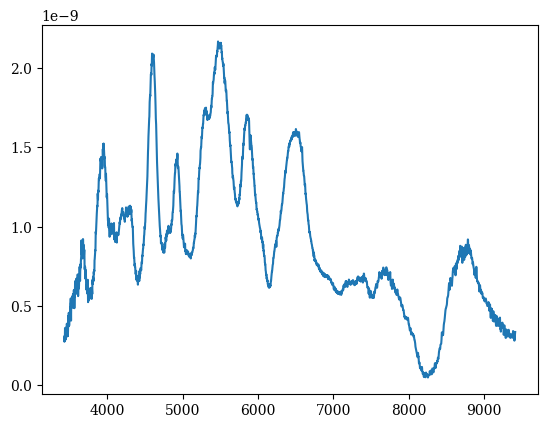

23.517587939698487


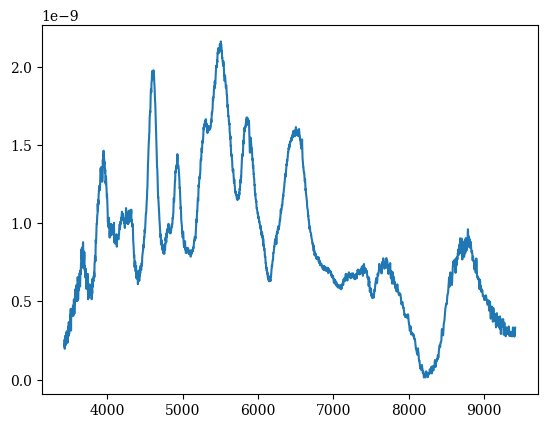

24.045226130653262


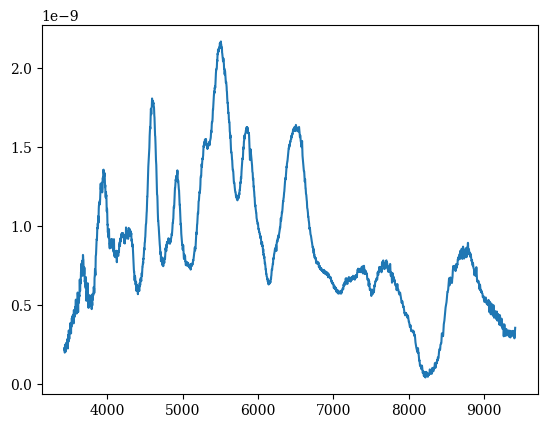

24.572864321608037


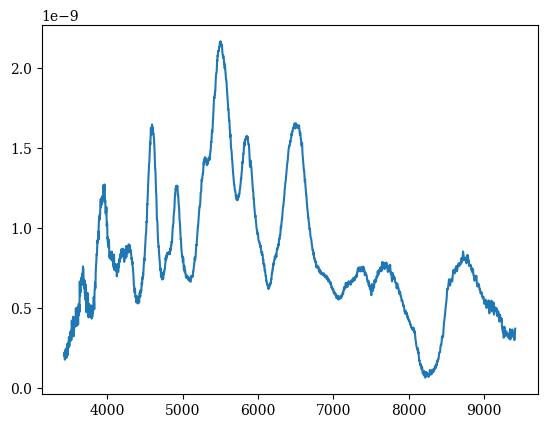

25.100502512562812


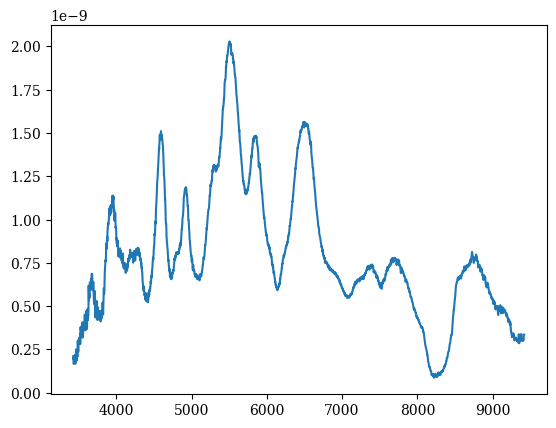

25.628140703517587


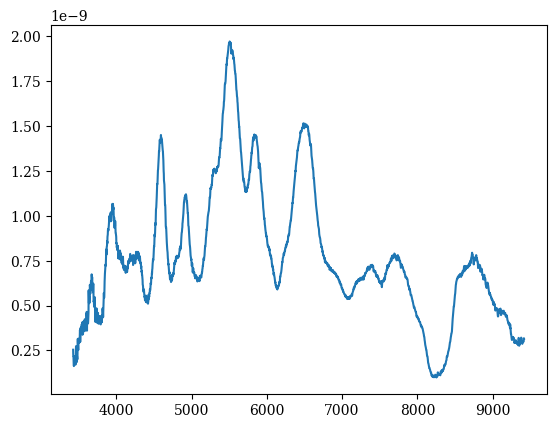

26.155778894472355


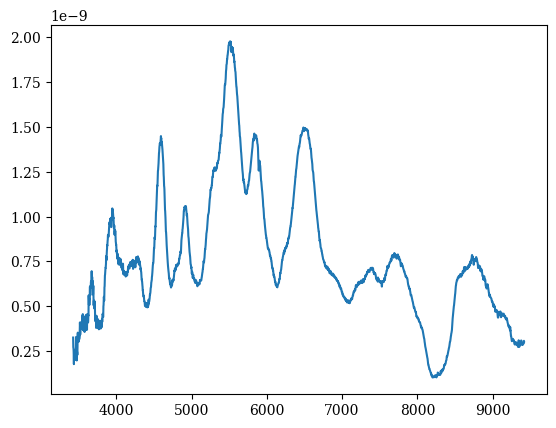

26.68341708542713


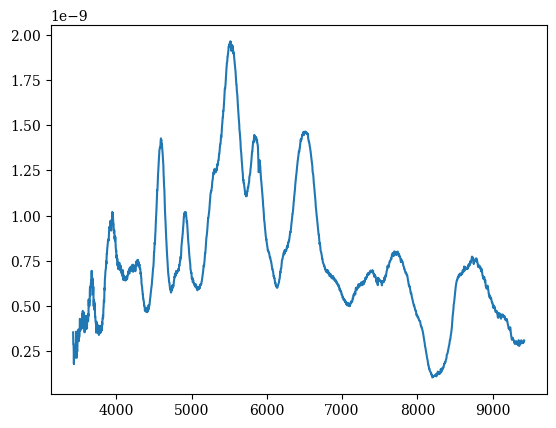

27.211055276381906


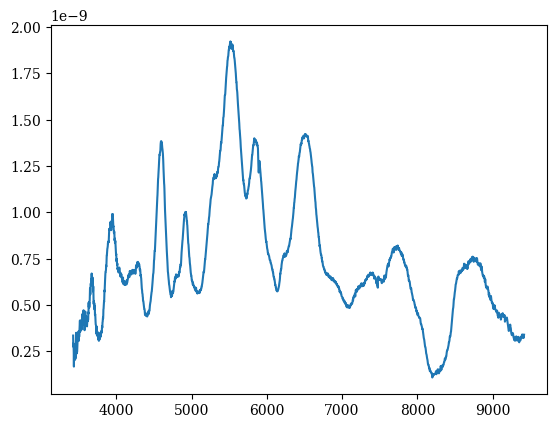

27.73869346733668


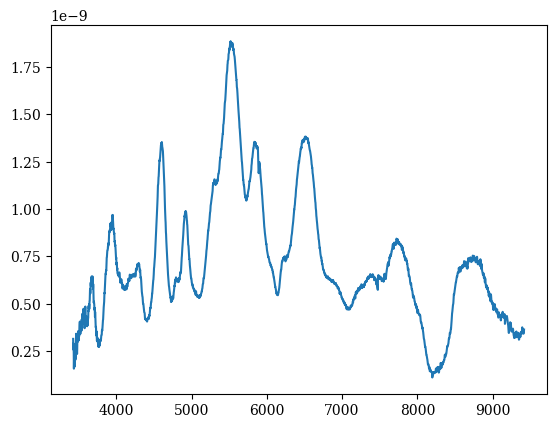

28.266331658291456


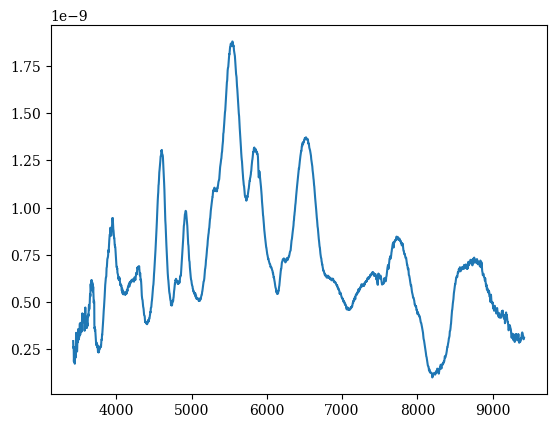

28.793969849246224


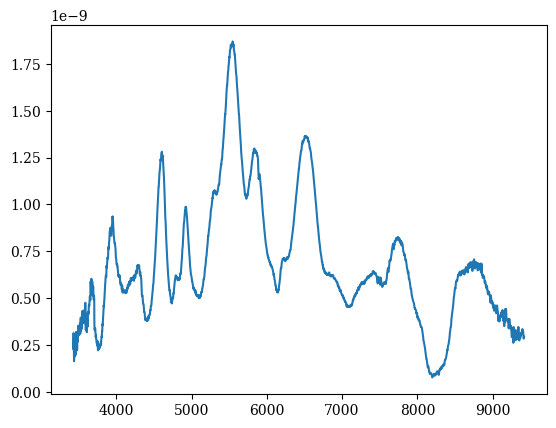

29.321608040201


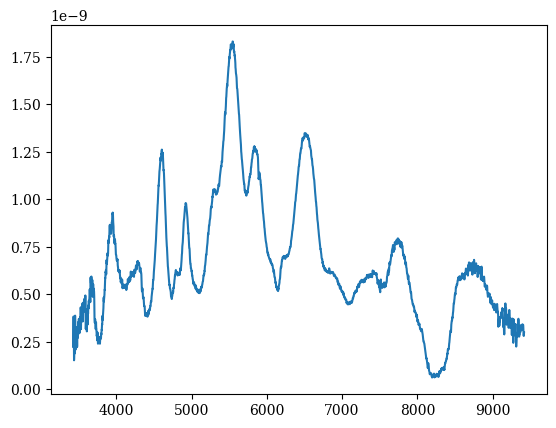

29.849246231155774


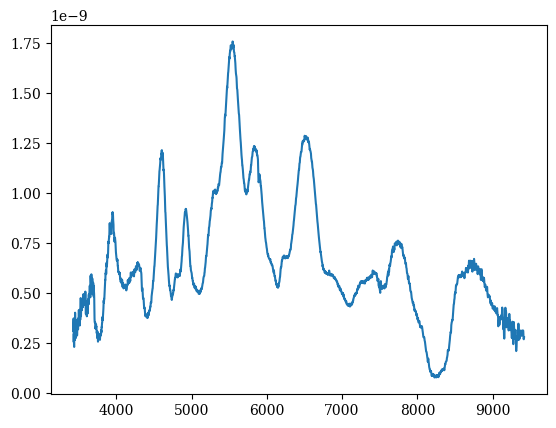

30.37688442211055


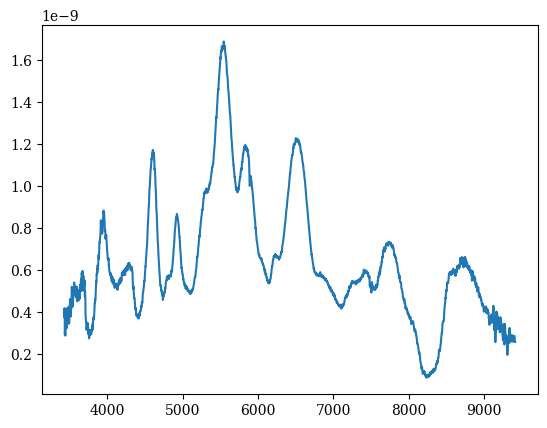

30.904522613065325


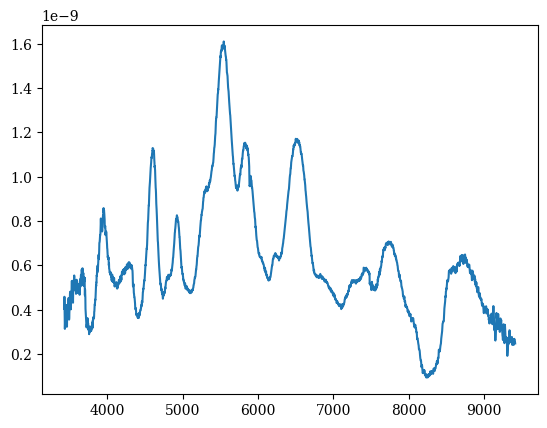

31.4321608040201


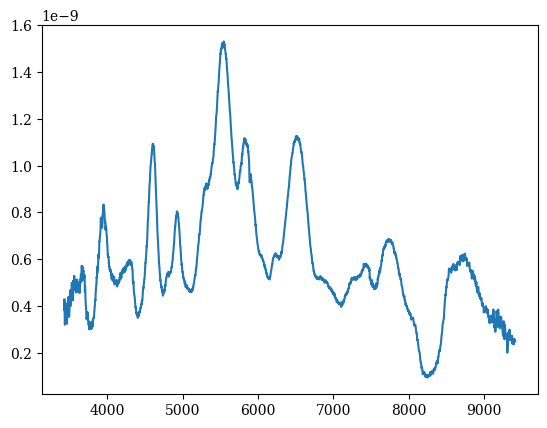

31.959798994974868


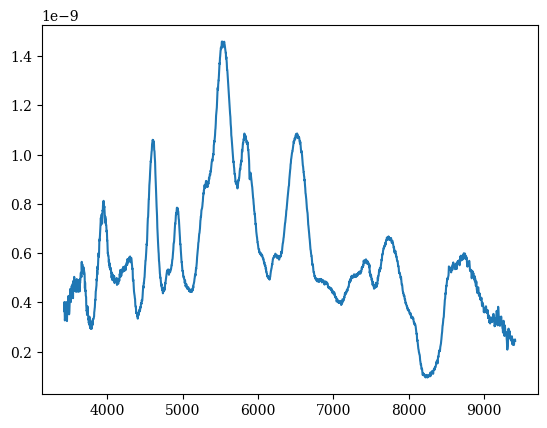

32.48743718592964


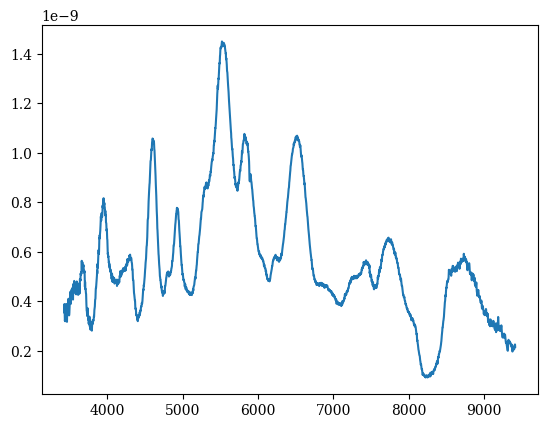

33.01507537688442


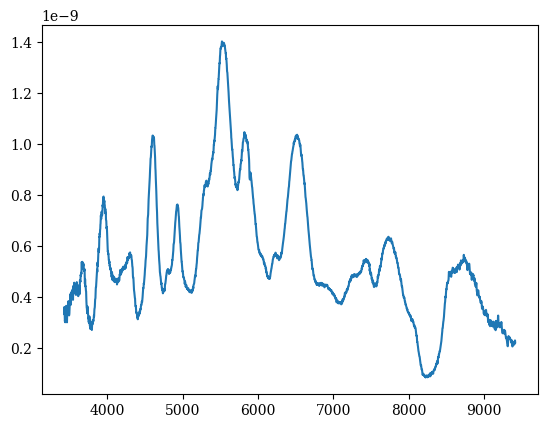

33.54271356783919


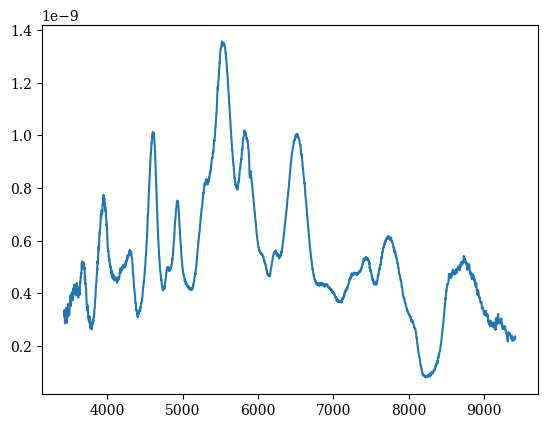

34.07035175879397


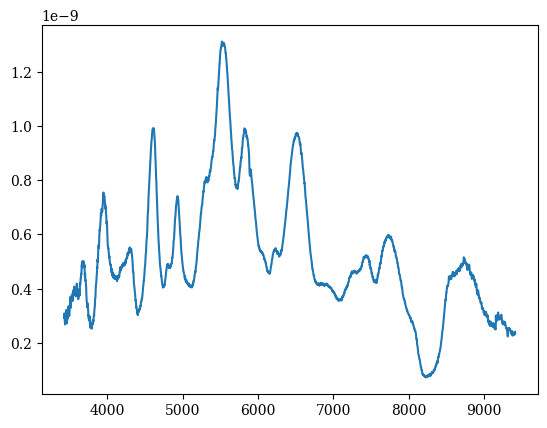

34.59798994974874


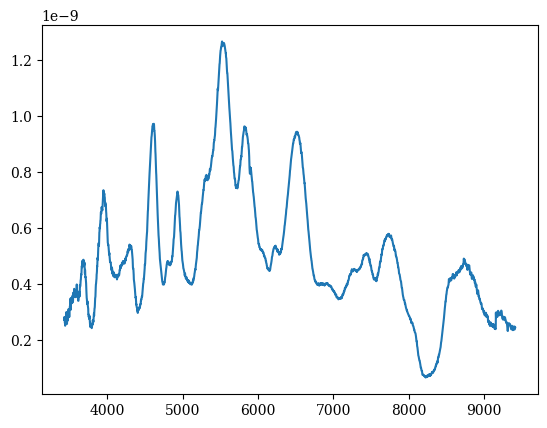

35.12562814070351


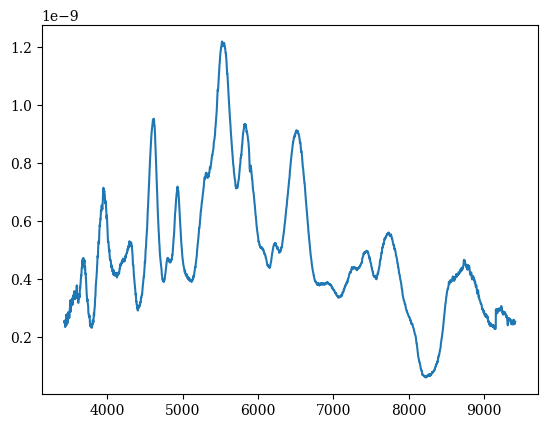

35.65326633165829


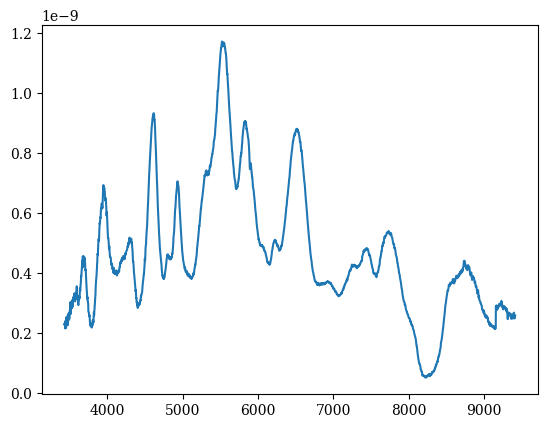

36.18090452261306


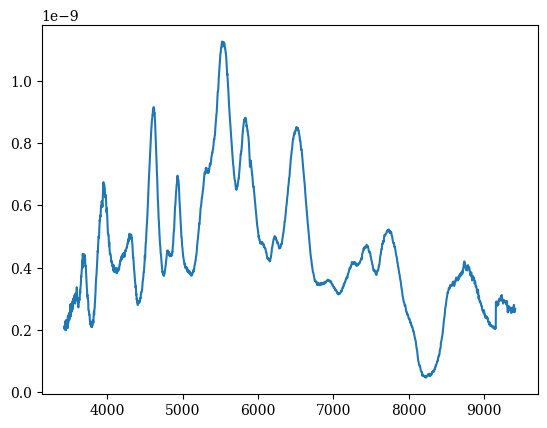

36.70854271356784


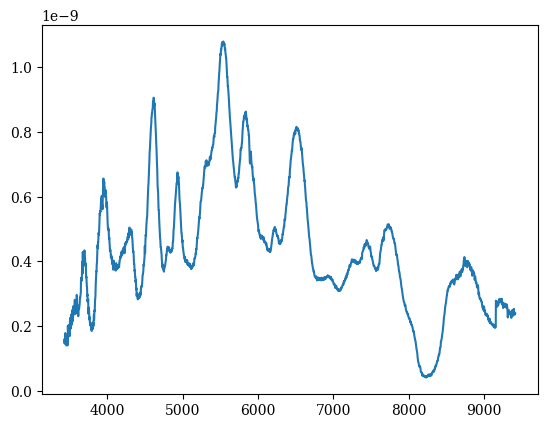

37.236180904522605


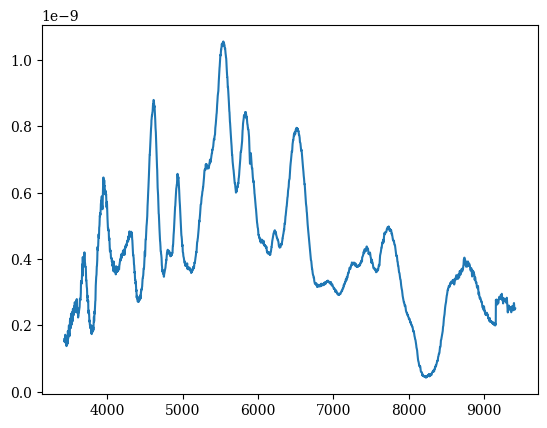

37.76381909547738


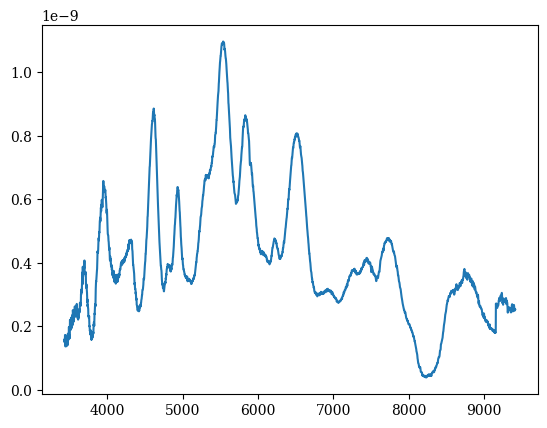

38.291457286432156


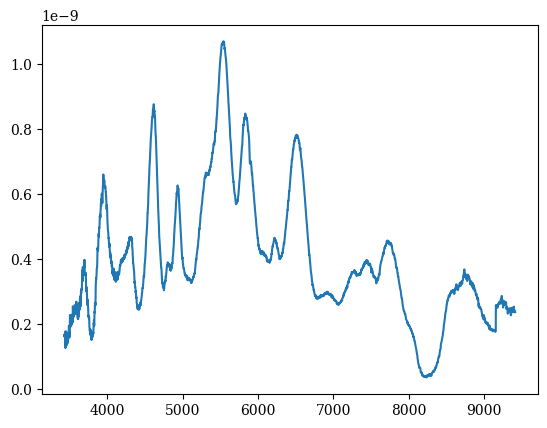

38.81909547738693


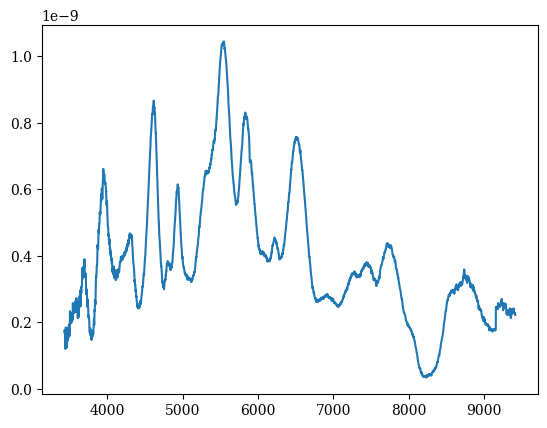

39.346733668341706


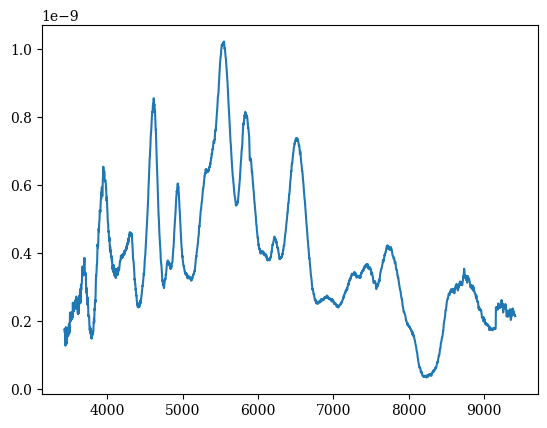

39.874371859296474


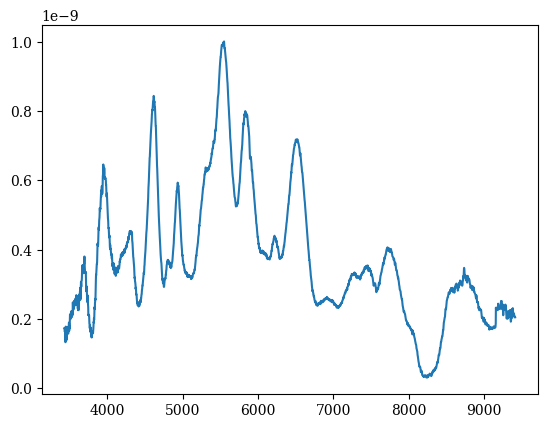

40.40201005025125


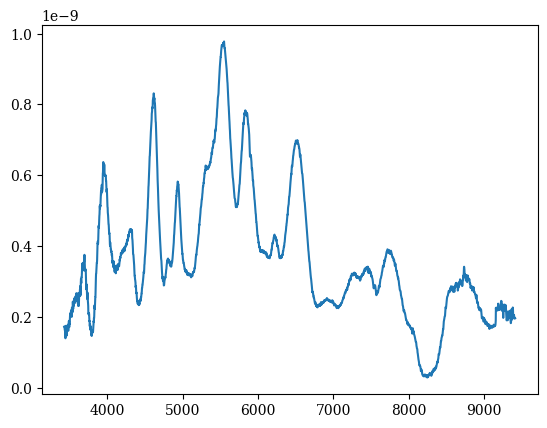

40.929648241206024


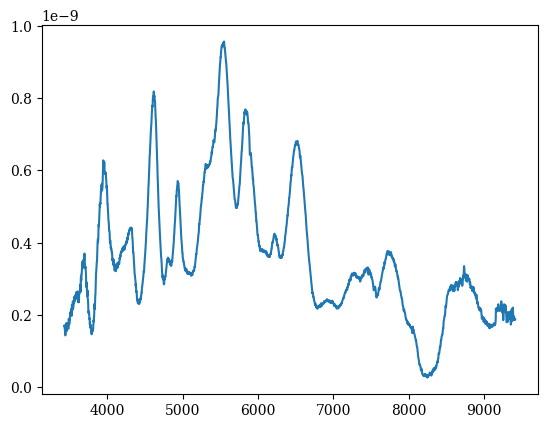

41.4572864321608


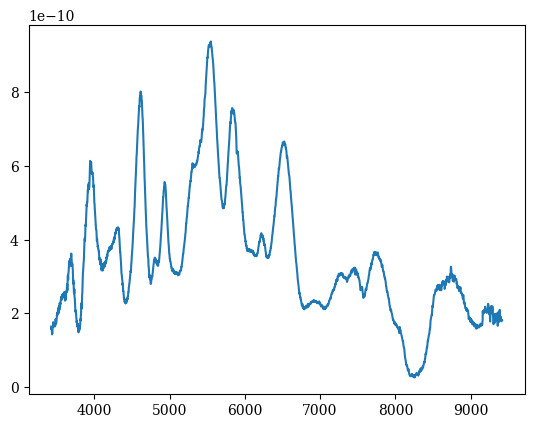

41.984924623115575


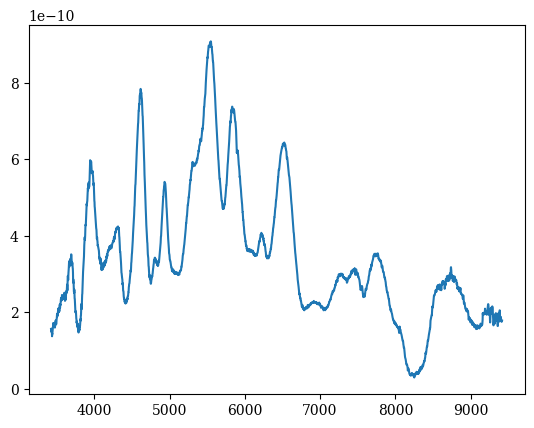

42.51256281407035


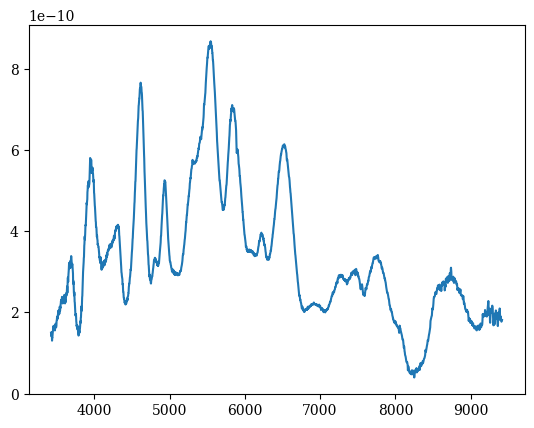

43.04020100502512


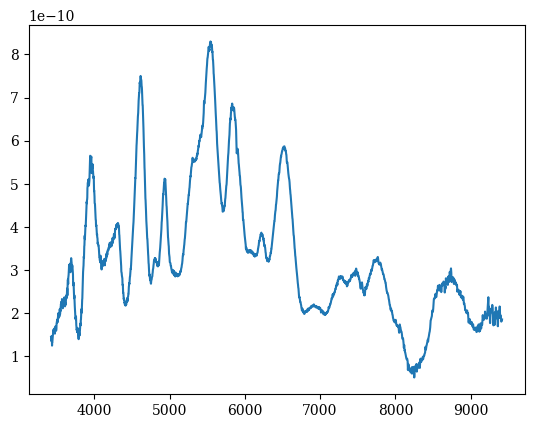

43.56783919597989


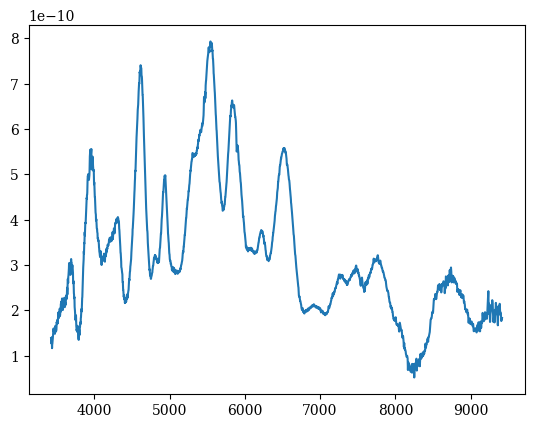

44.09547738693467


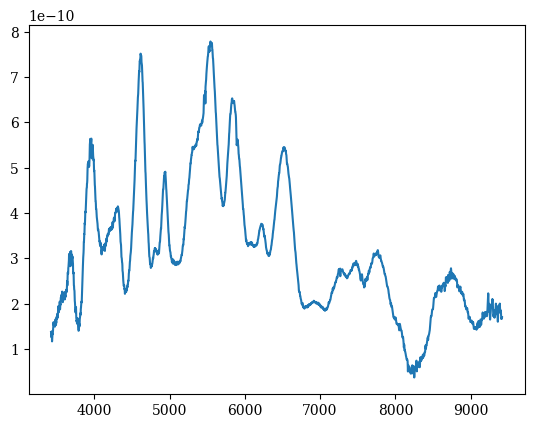

44.62311557788944


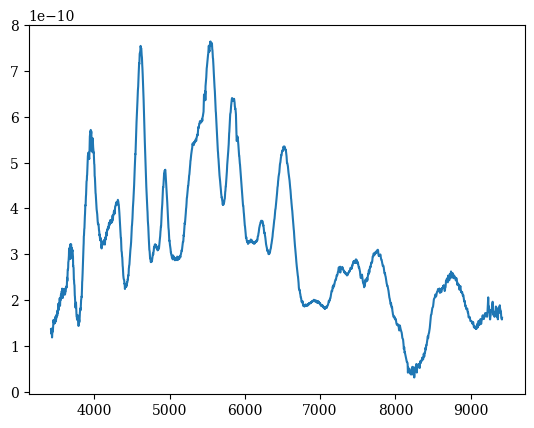

45.15075376884422


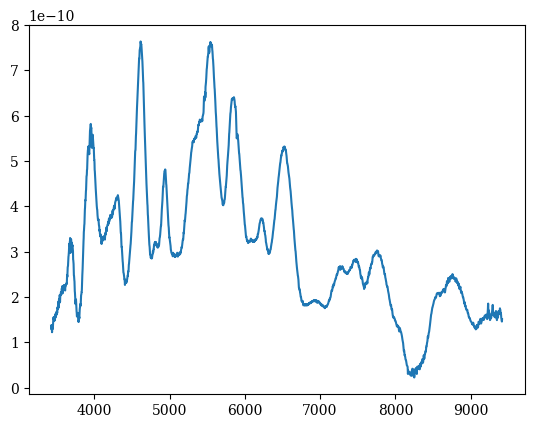

45.67839195979899


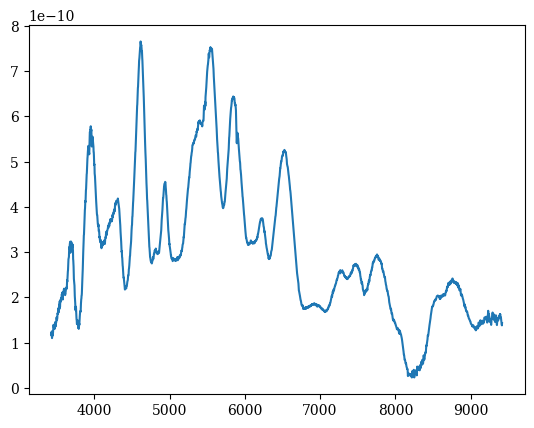

46.20603015075376


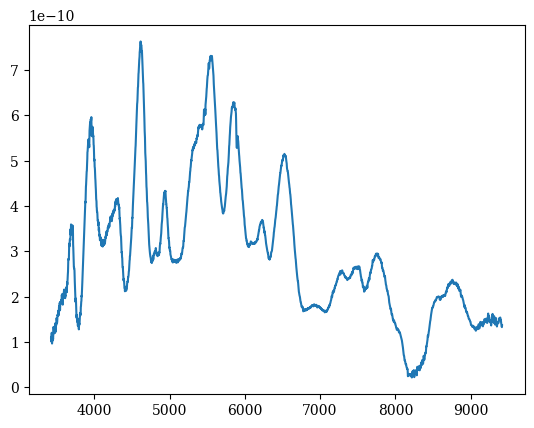

46.73366834170854


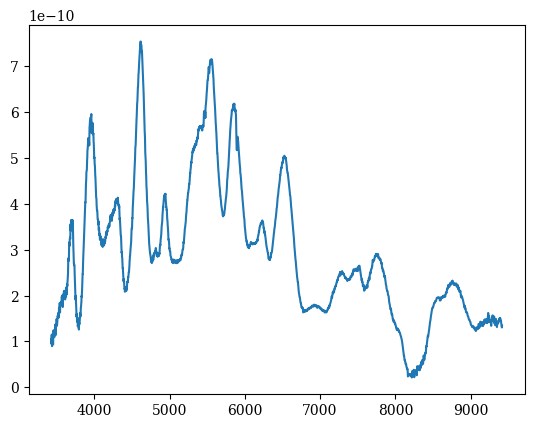

47.26130653266331


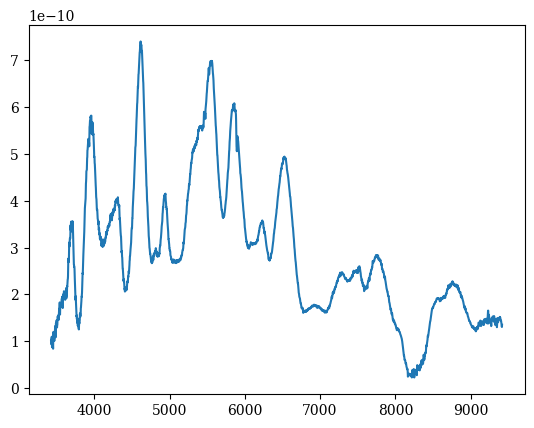

47.78894472361809


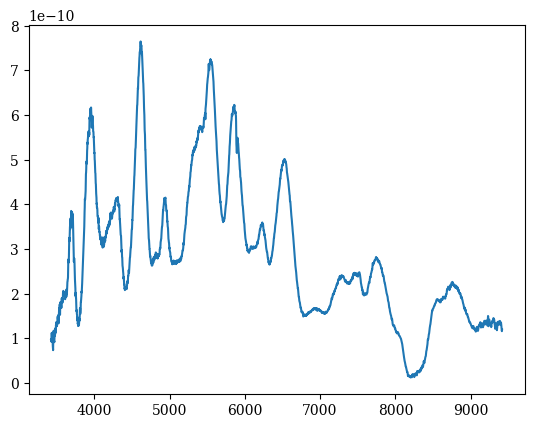

48.31658291457286


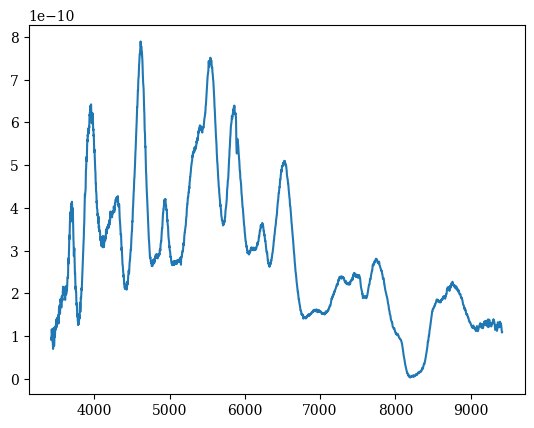

48.84422110552763


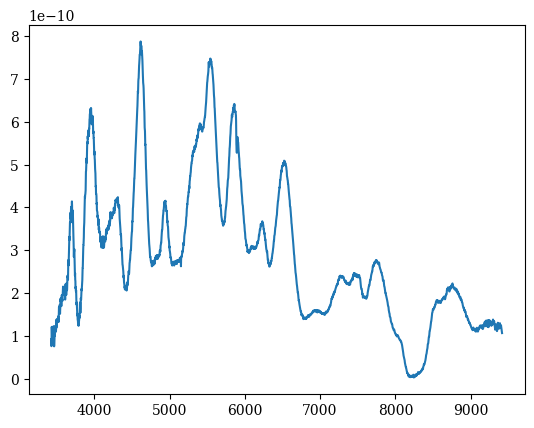

49.37185929648241


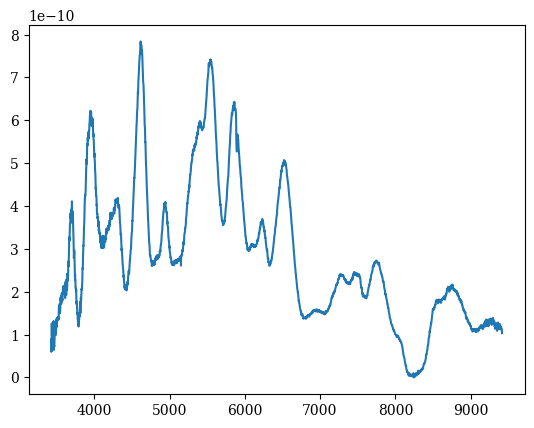

49.89949748743717


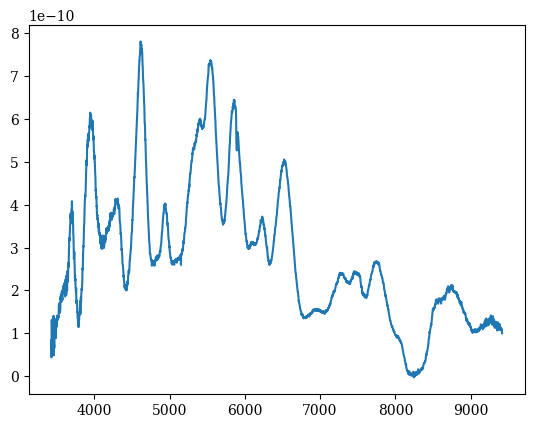

50.42713567839195


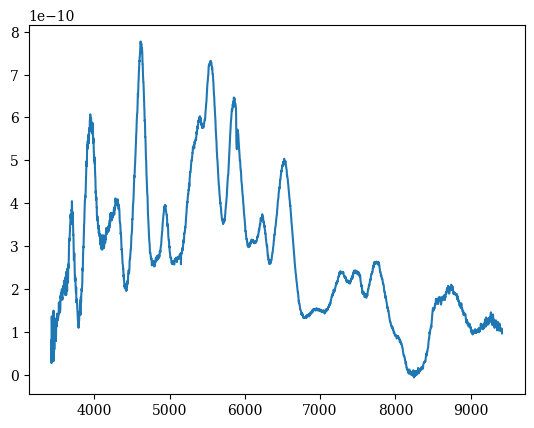

50.954773869346724


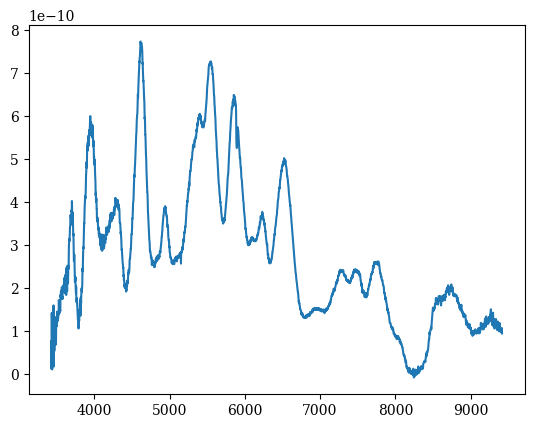

51.4824120603015


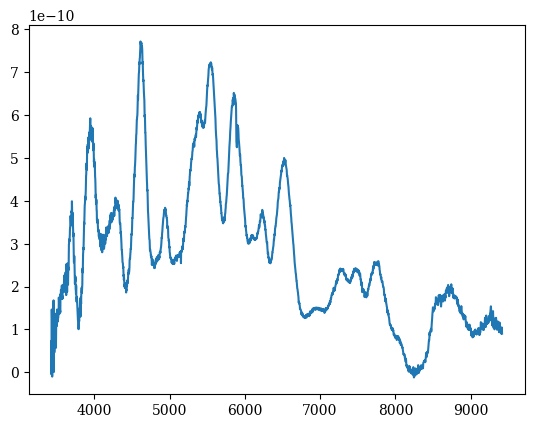

52.010050251256274


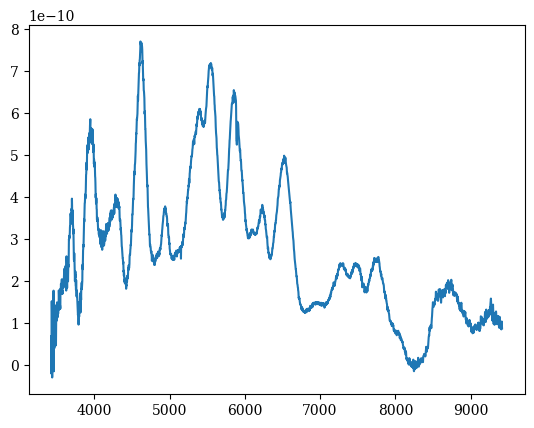

52.53768844221105


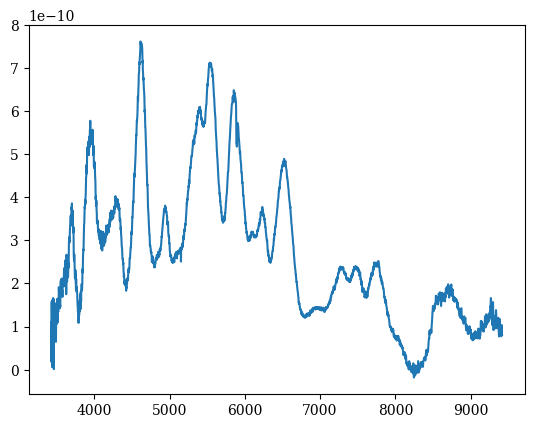

53.065326633165824


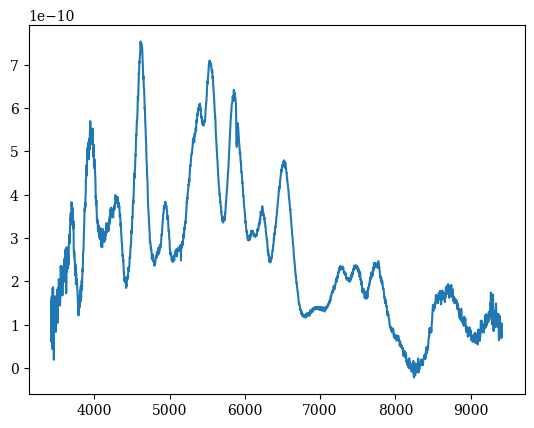

53.5929648241206


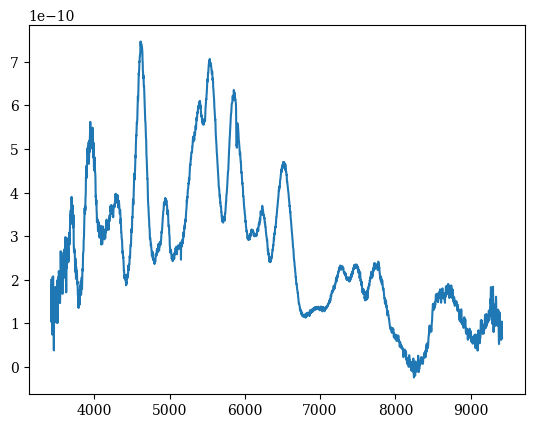

54.120603015075375


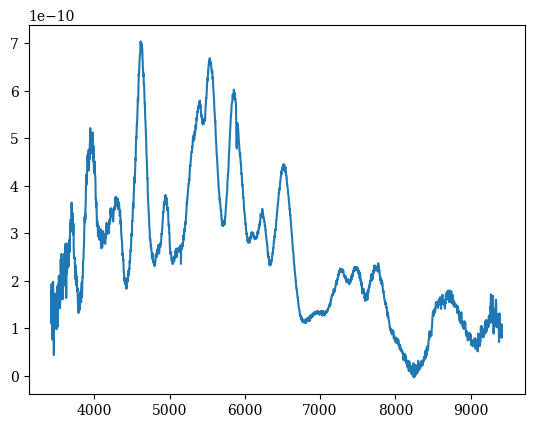

54.64824120603015


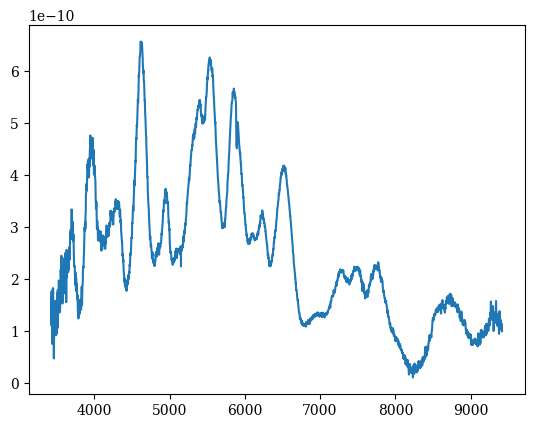

55.175879396984925


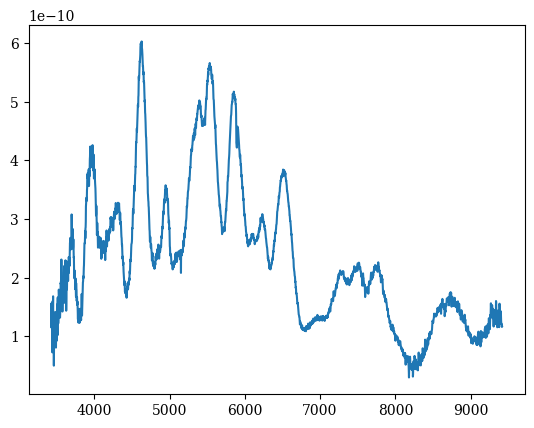

55.703517587939686


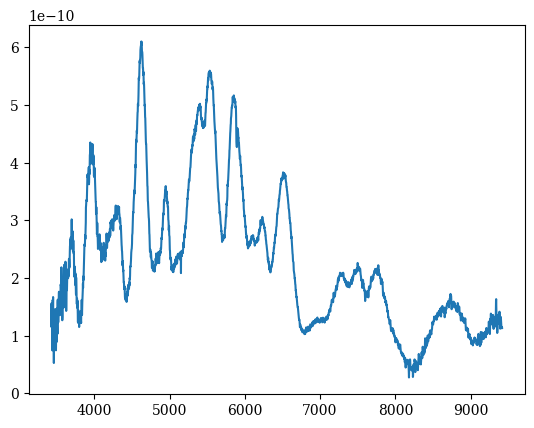

56.23115577889446


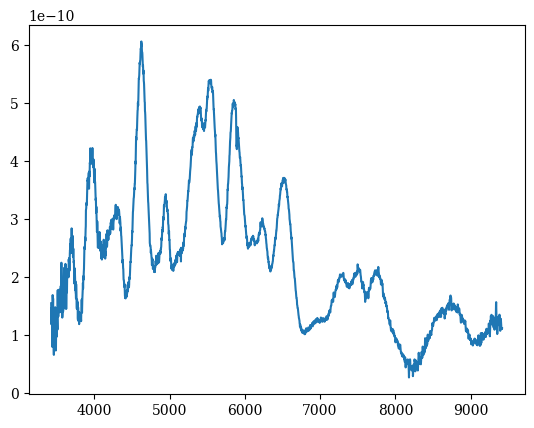

56.758793969849236


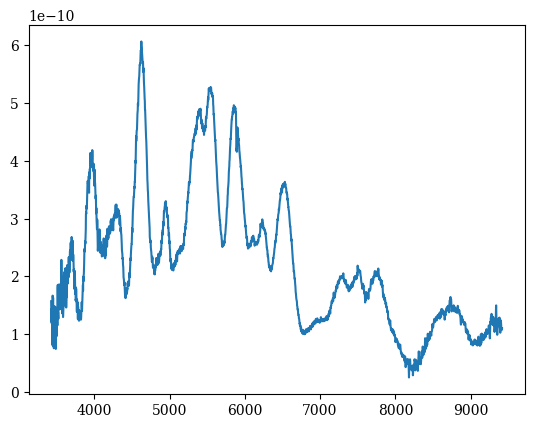

57.28643216080401


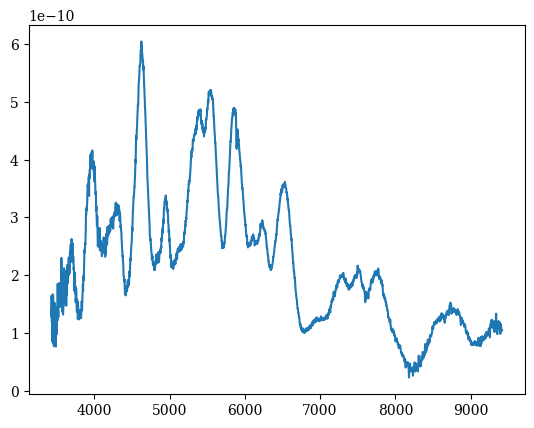

57.81407035175879


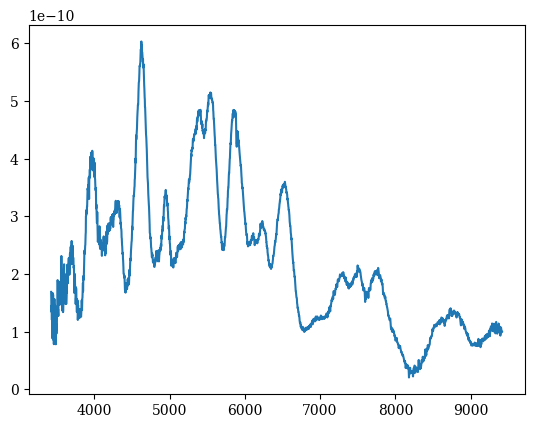

58.34170854271356


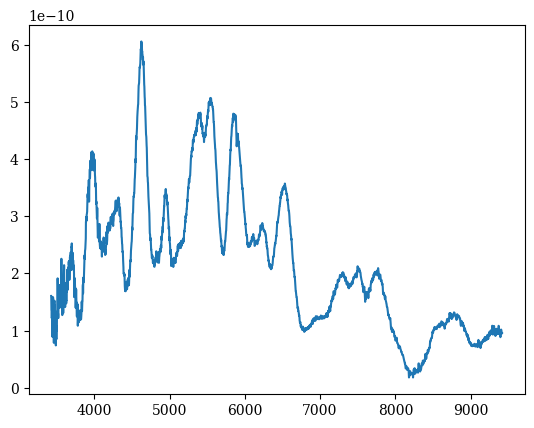

58.86934673366834


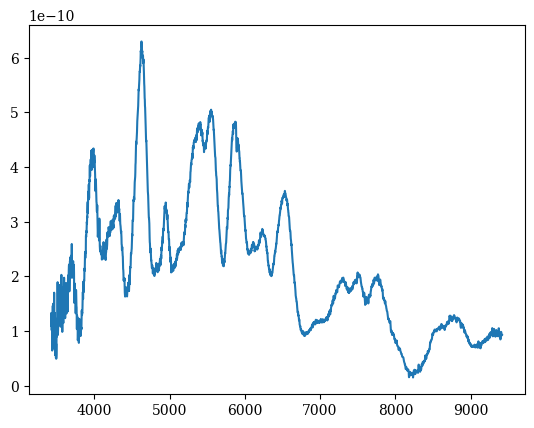

59.39698492462311


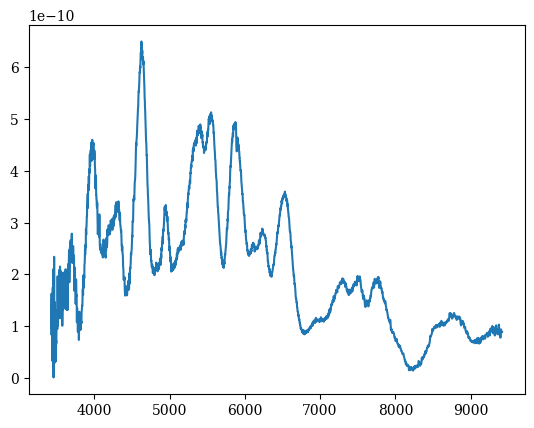

59.92462311557789


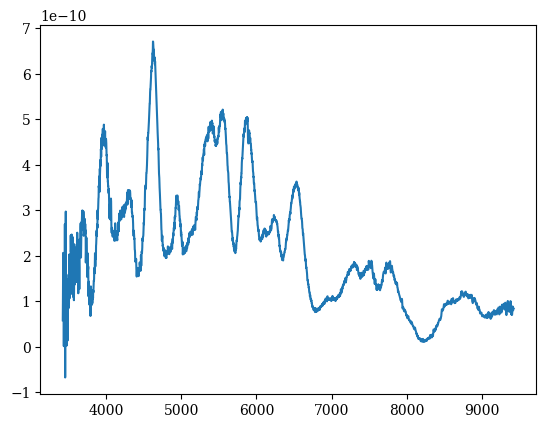

60.45226130653266


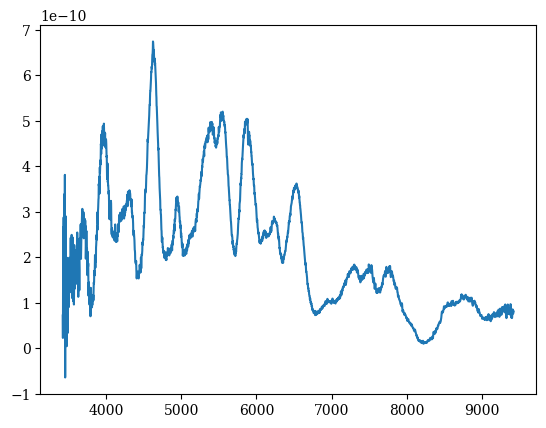

60.97989949748742


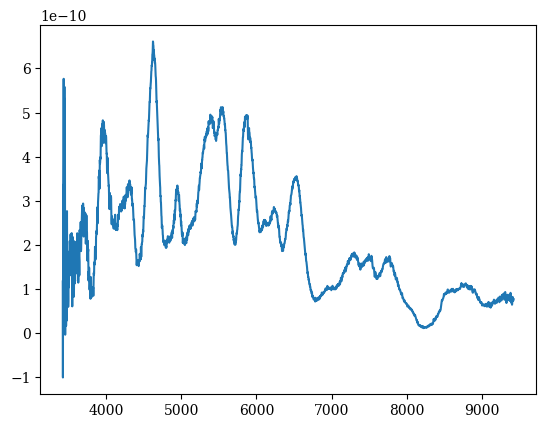

61.5075376884422


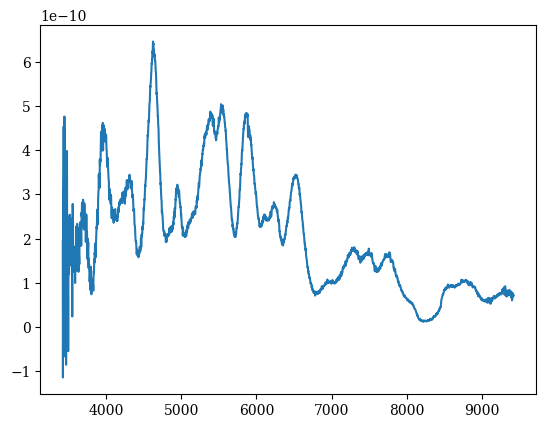

62.035175879396974


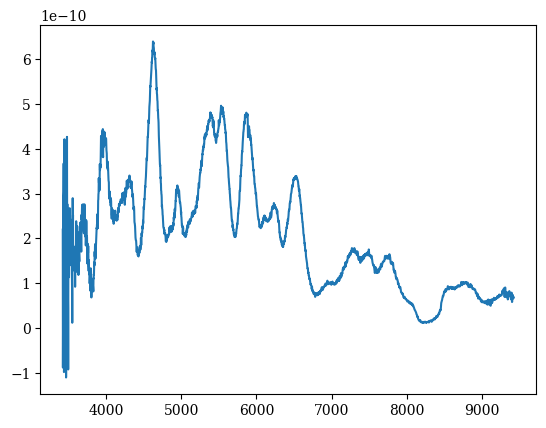

62.56281407035175


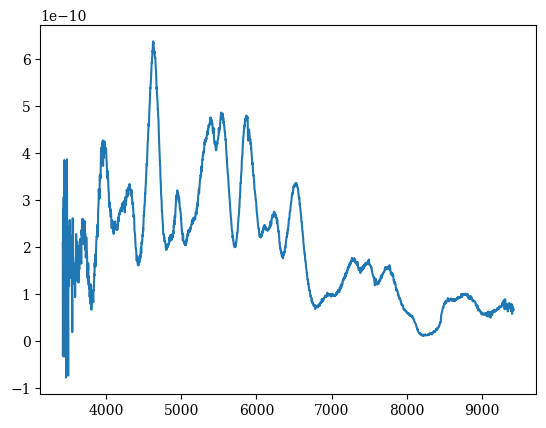

63.090452261306524


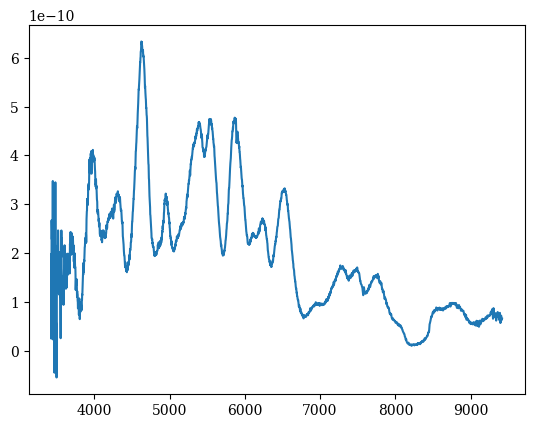

63.6180904522613


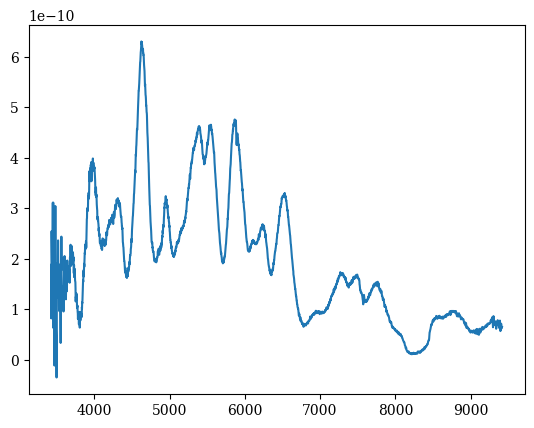

64.14572864321607


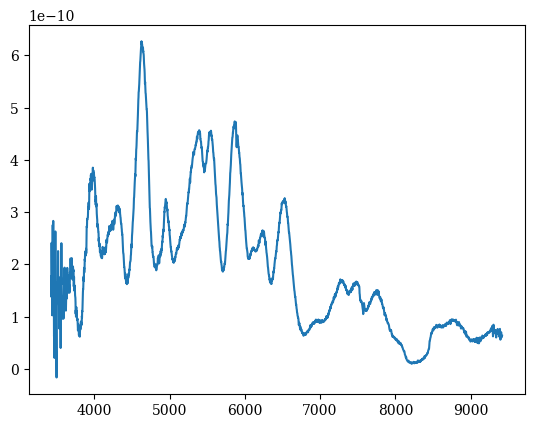

64.67336683417085


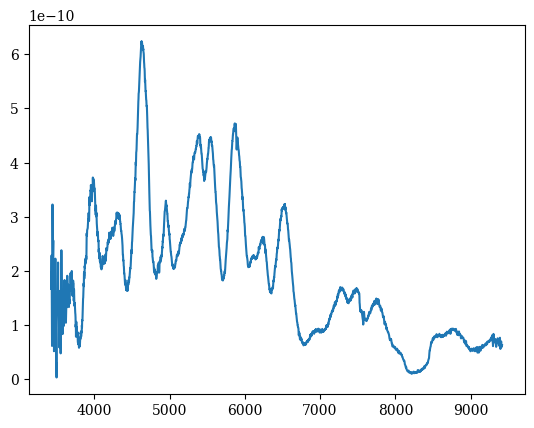

65.20100502512562


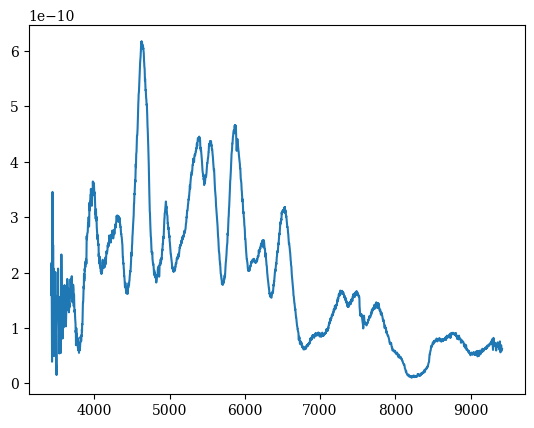

65.7286432160804


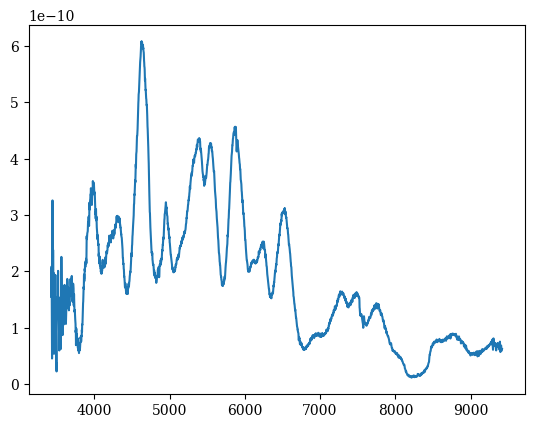

66.25628140703517


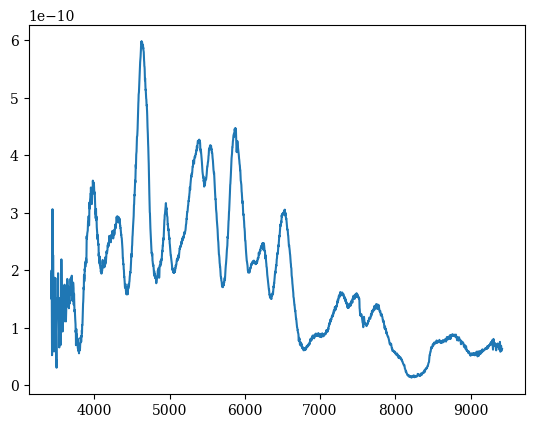

66.78391959798994


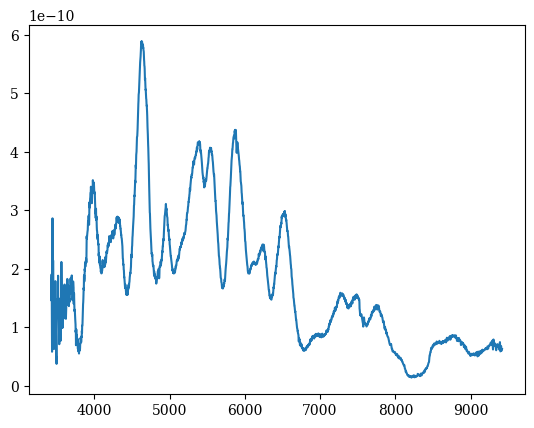

67.31155778894471


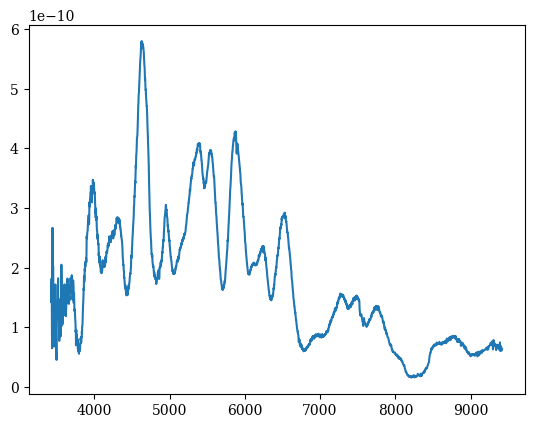

67.83919597989949


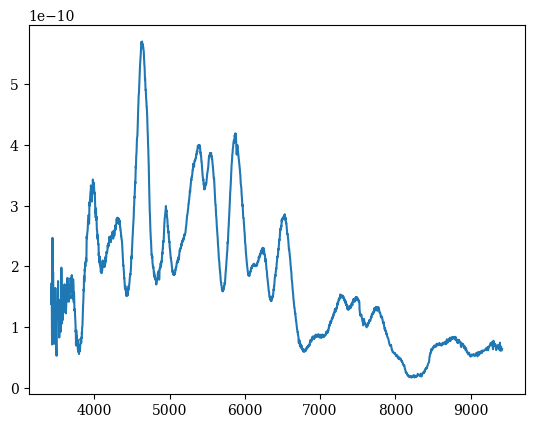

68.36683417085426


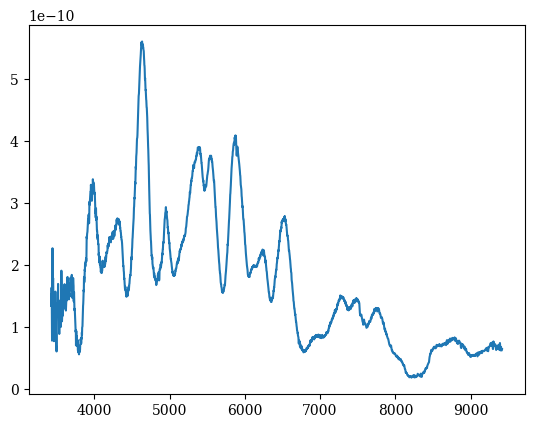

68.89447236180904


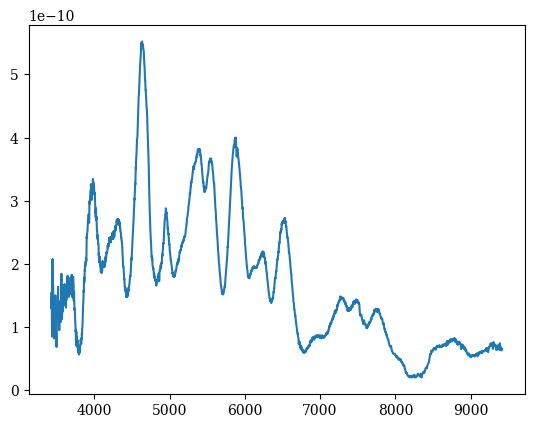

69.42211055276381


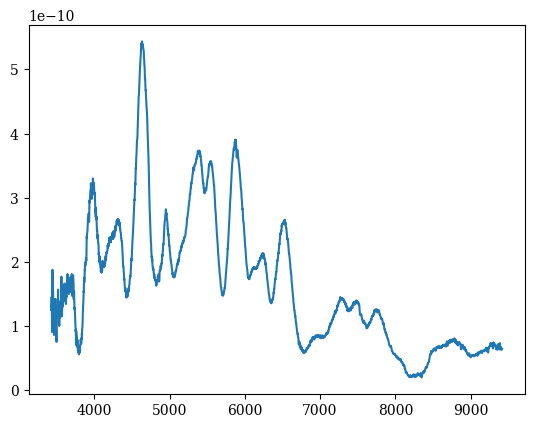

69.94974874371859


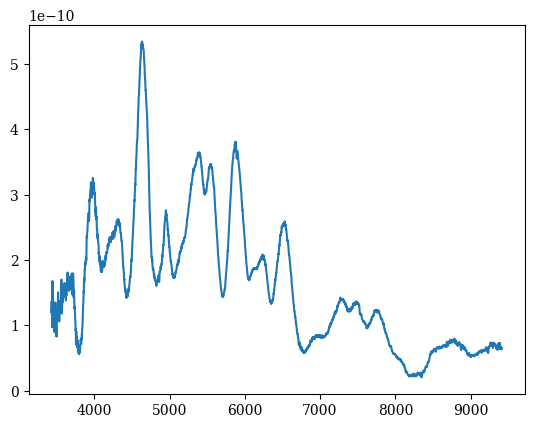

70.47738693467336


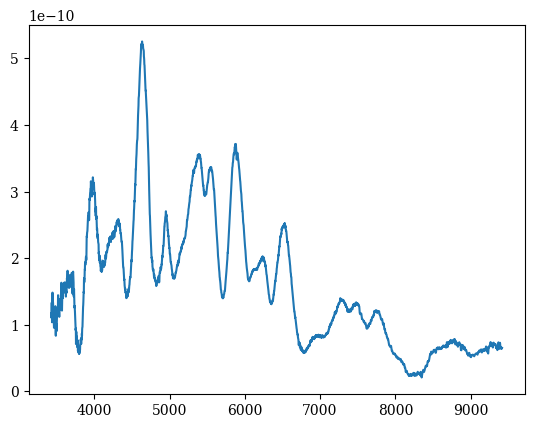

71.00502512562814


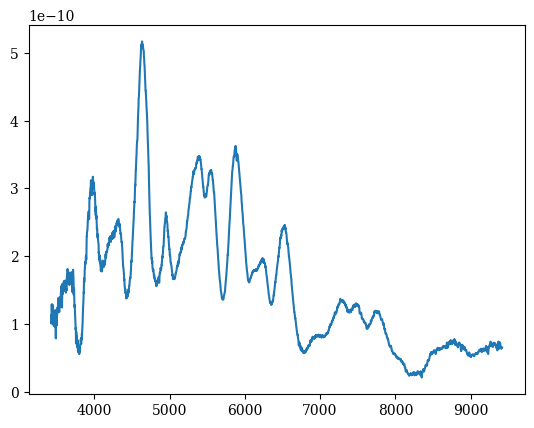

71.53266331658291


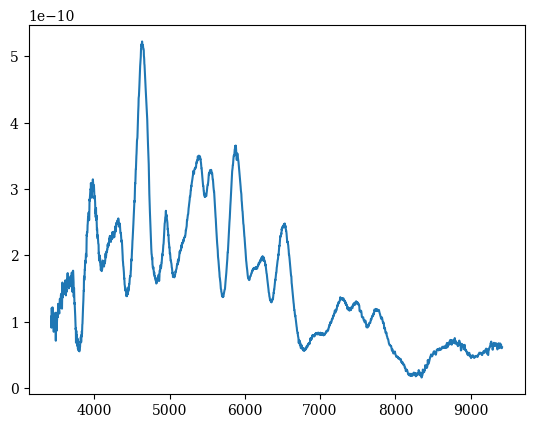

72.06030150753769


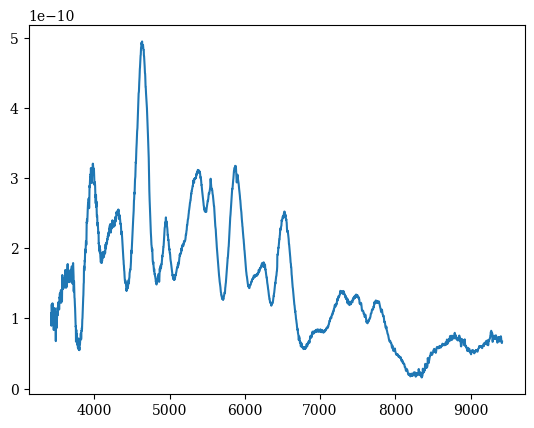

72.58793969849245


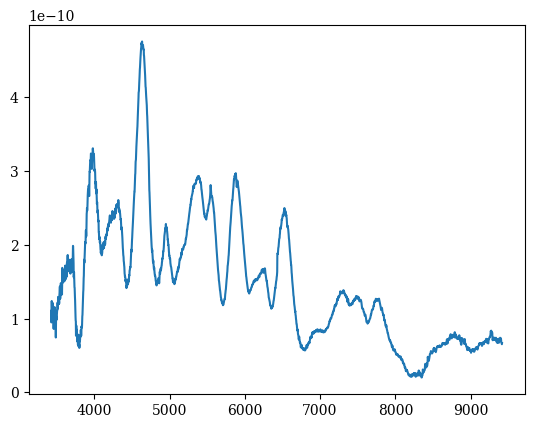

73.11557788944722


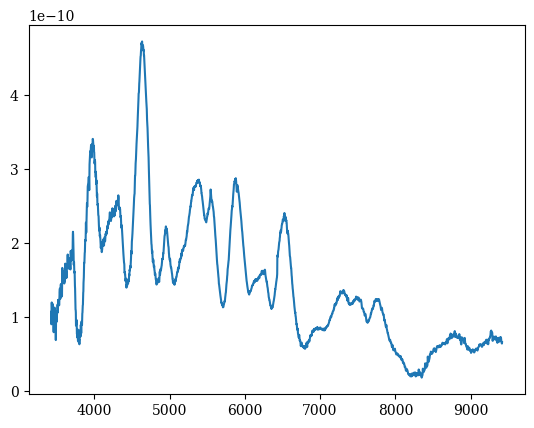

73.643216080402


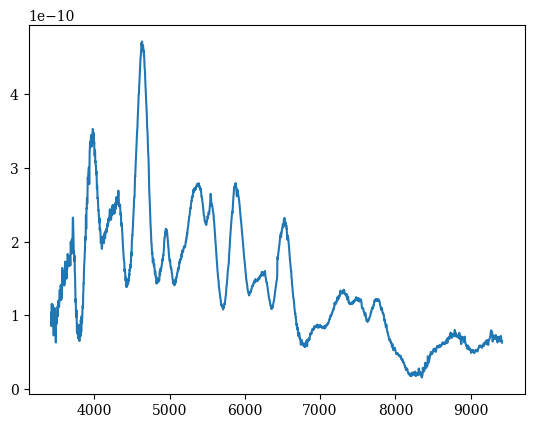

74.17085427135677


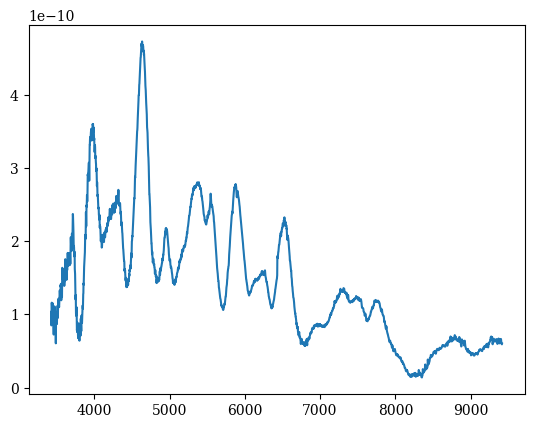

74.69849246231155


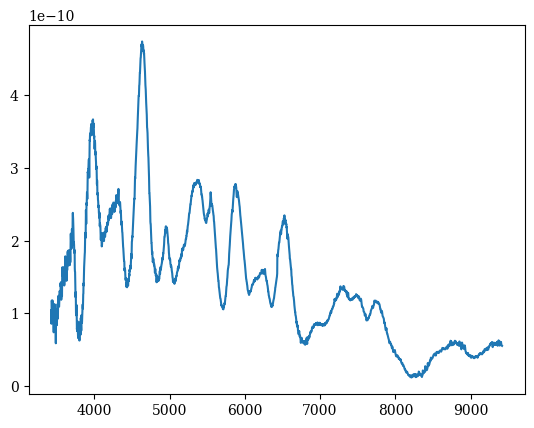

75.22613065326632


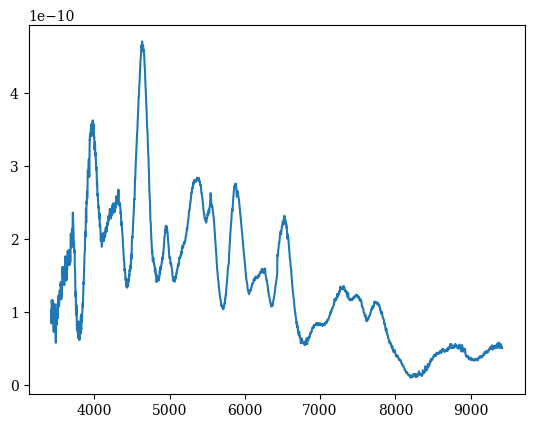

75.7537688442211


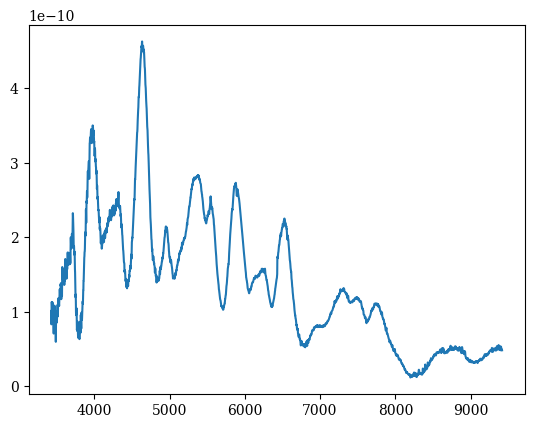

76.28140703517587


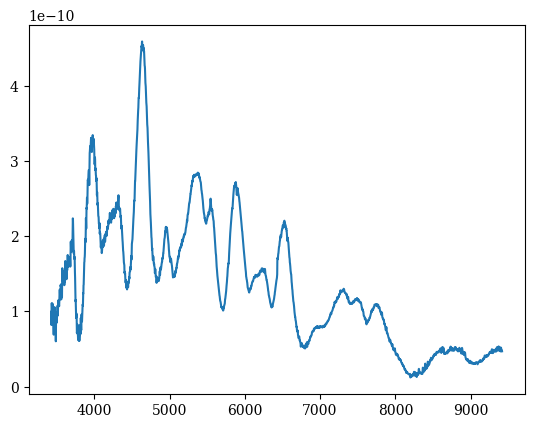

76.80904522613065


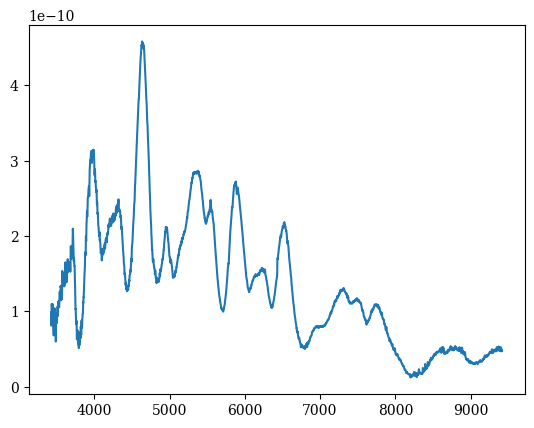

77.33668341708542


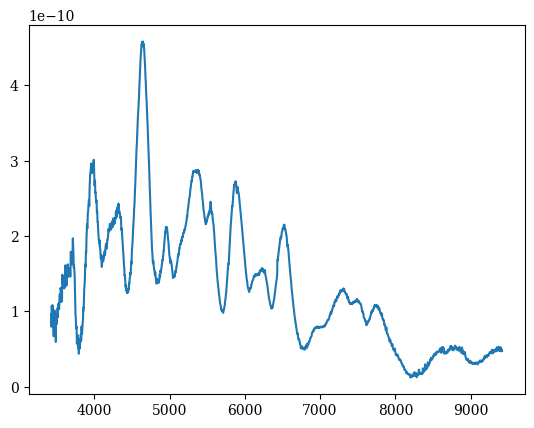

77.8643216080402


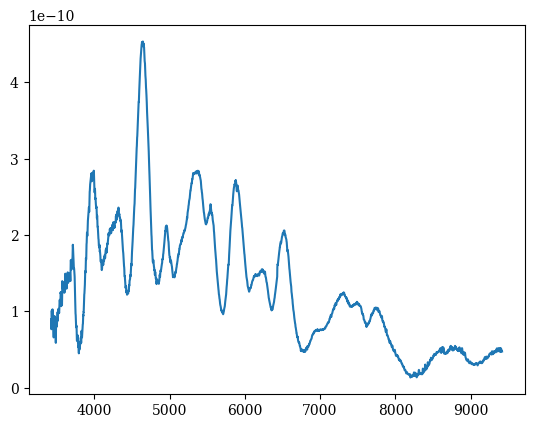

78.39195979899496


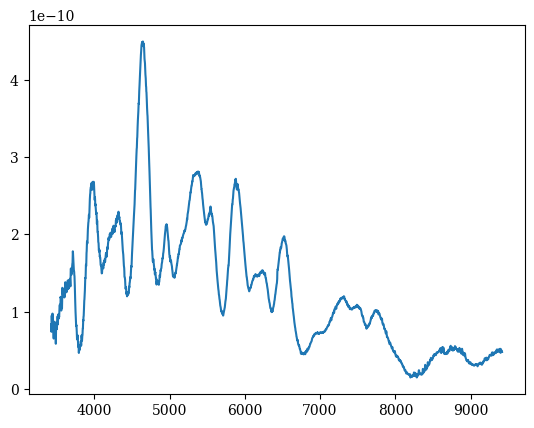

78.91959798994974


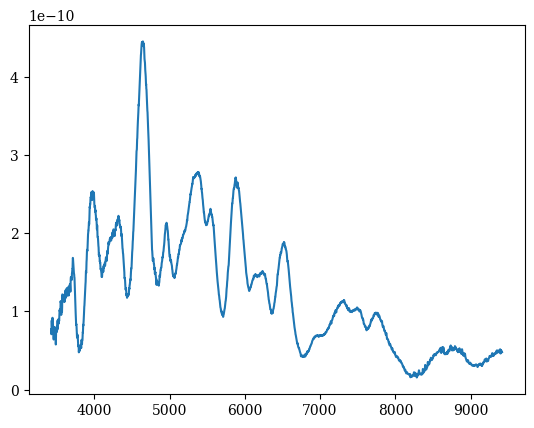

79.44723618090451


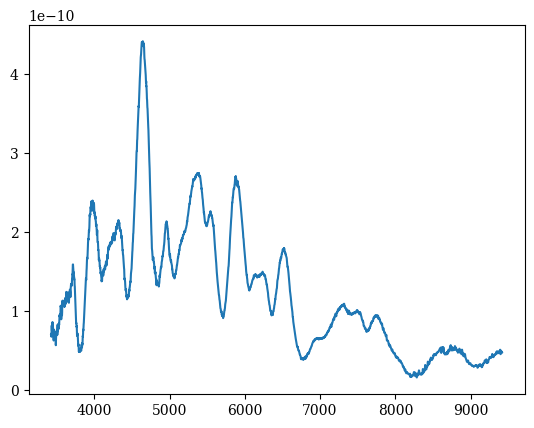

79.97487437185929


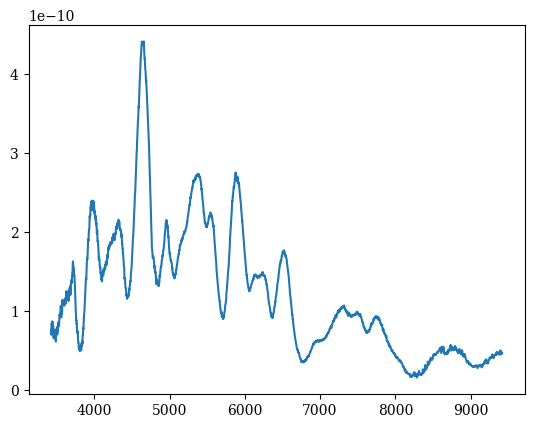

80.50251256281406


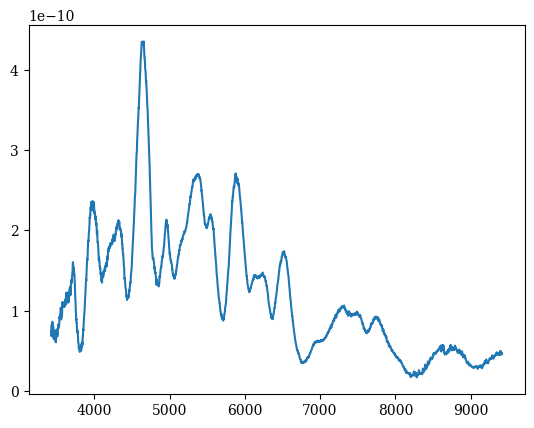

81.03015075376884


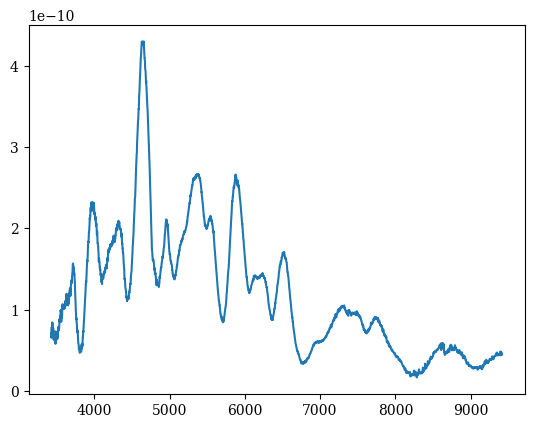

81.55778894472361


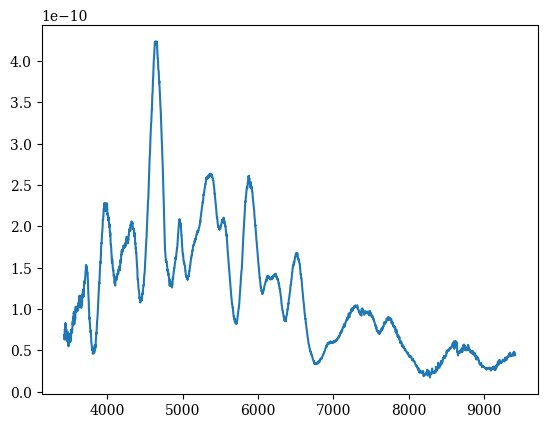

82.08542713567839


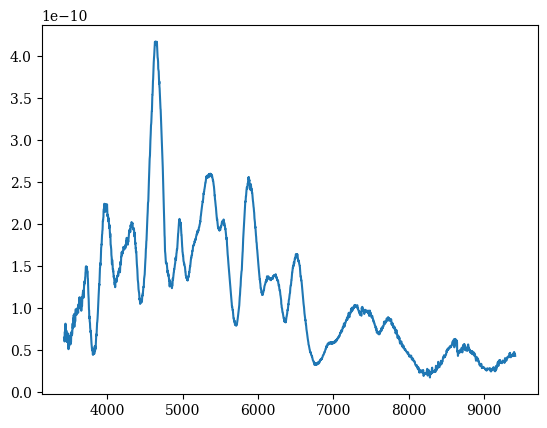

82.61306532663316


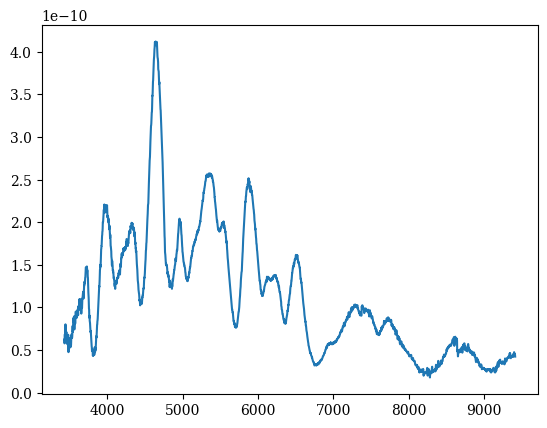

83.14070351758794


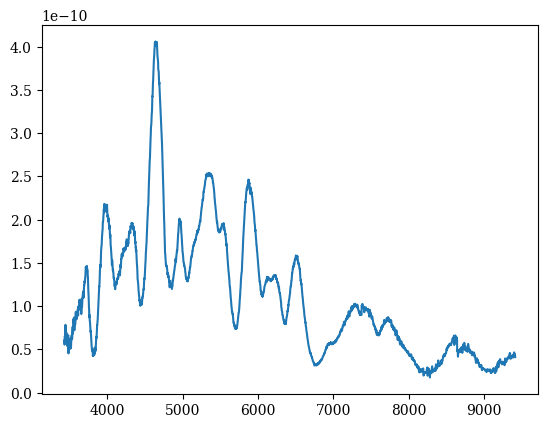

83.6683417085427


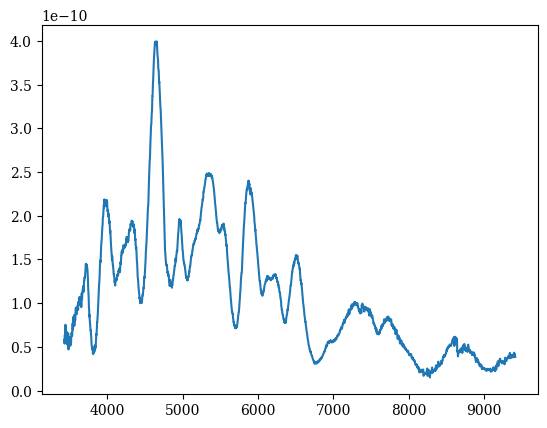

84.19597989949747


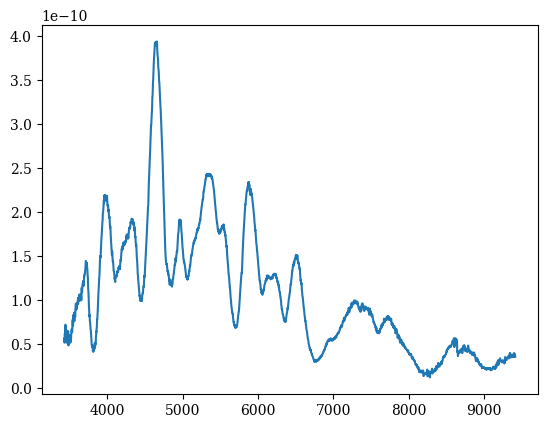

84.72361809045225


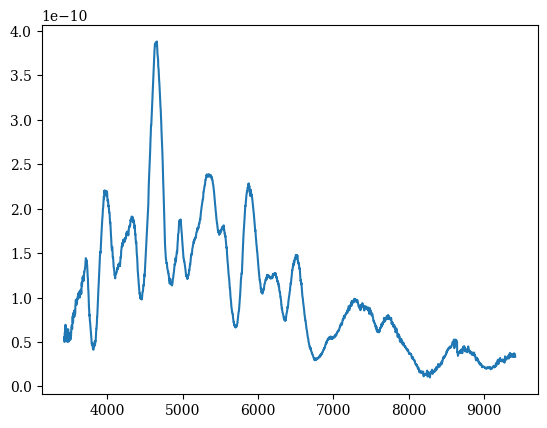

85.25125628140702


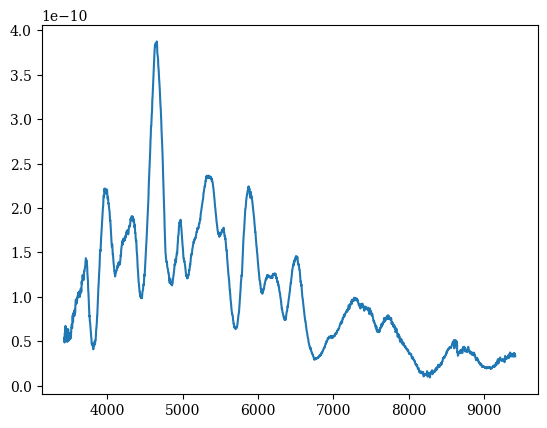

85.7788944723618


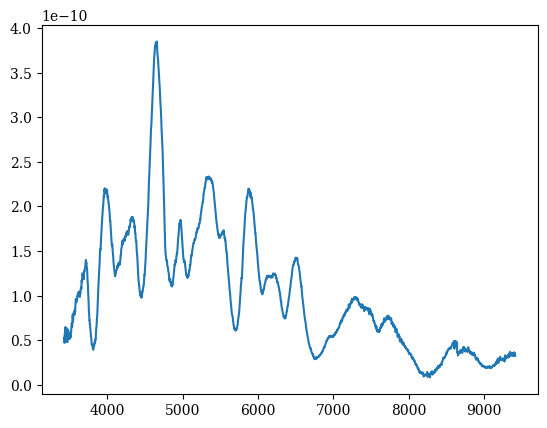

86.30653266331657


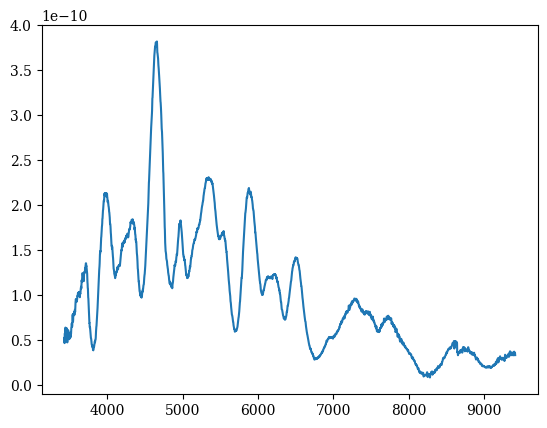

86.83417085427135


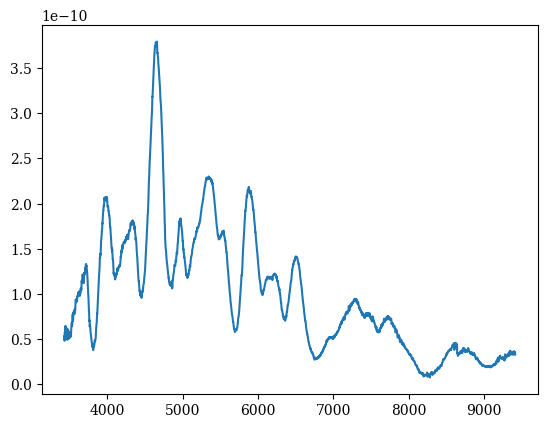

87.36180904522612


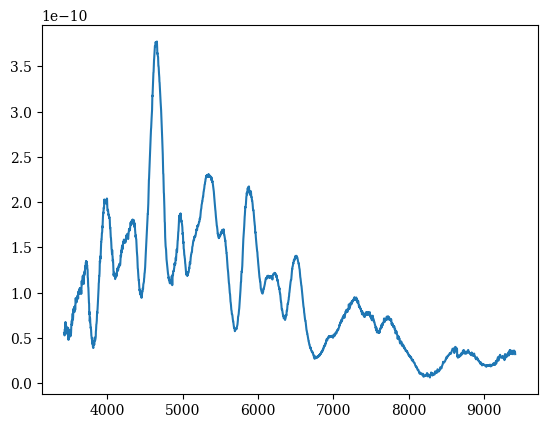

87.8894472361809


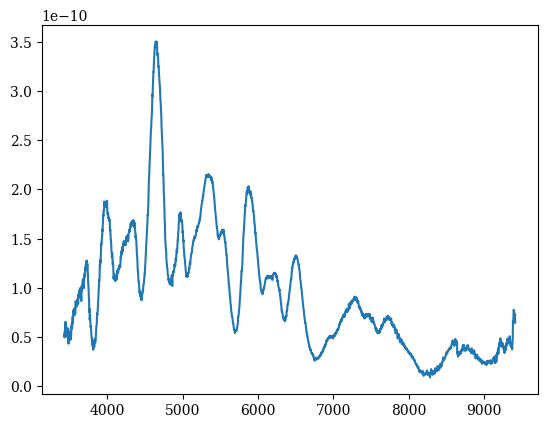

88.41708542713567


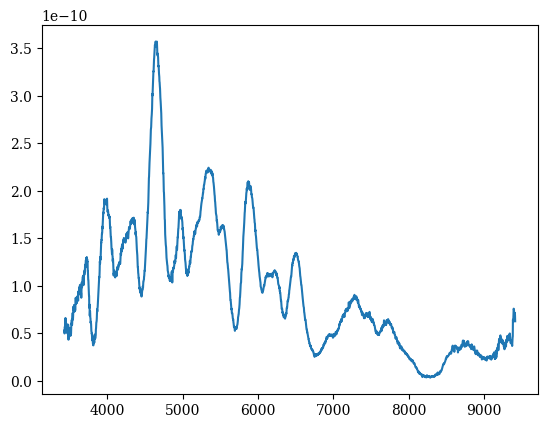

88.94472361809045


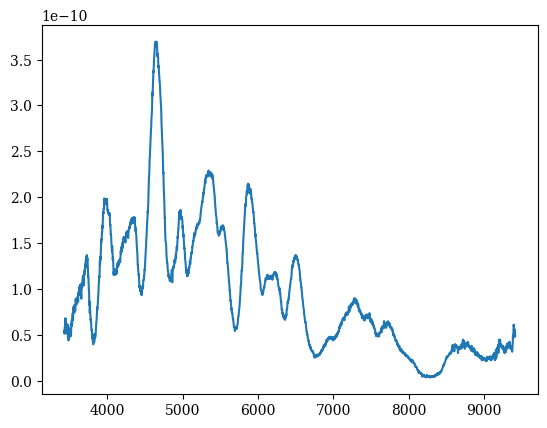

89.47236180904521


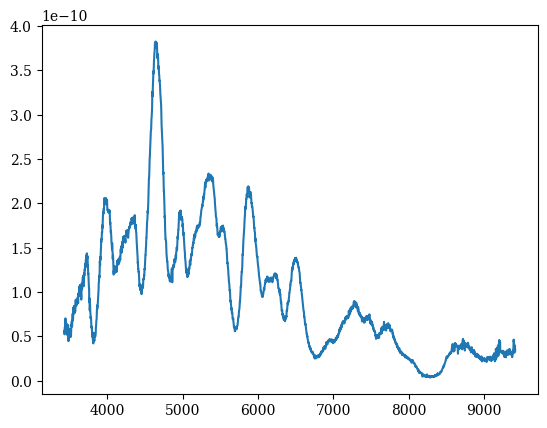

90.0


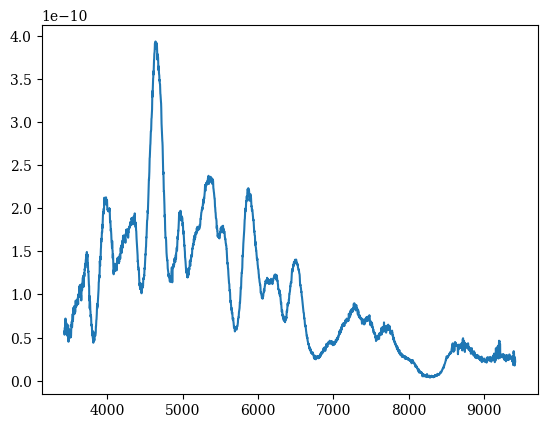

In [40]:
for i,z in enumerate(Z2_highv):
    print (Y2_highv[i][0])
    plt.plot(X2_highv[i], z)
    plt.show()

In [41]:
def make_colorbar(params):
    # print np.min(params), np.max(params)
    norm = matplotlib.colors.Normalize(vmin=np.min(params),vmax=np.max(params))
    c_m = matplotlib.cm.gist_rainbow
    s_m = matplotlib.cm.ScalarMappable(cmap=c_m, norm=norm)
    s_m.set_array([])
    return s_m

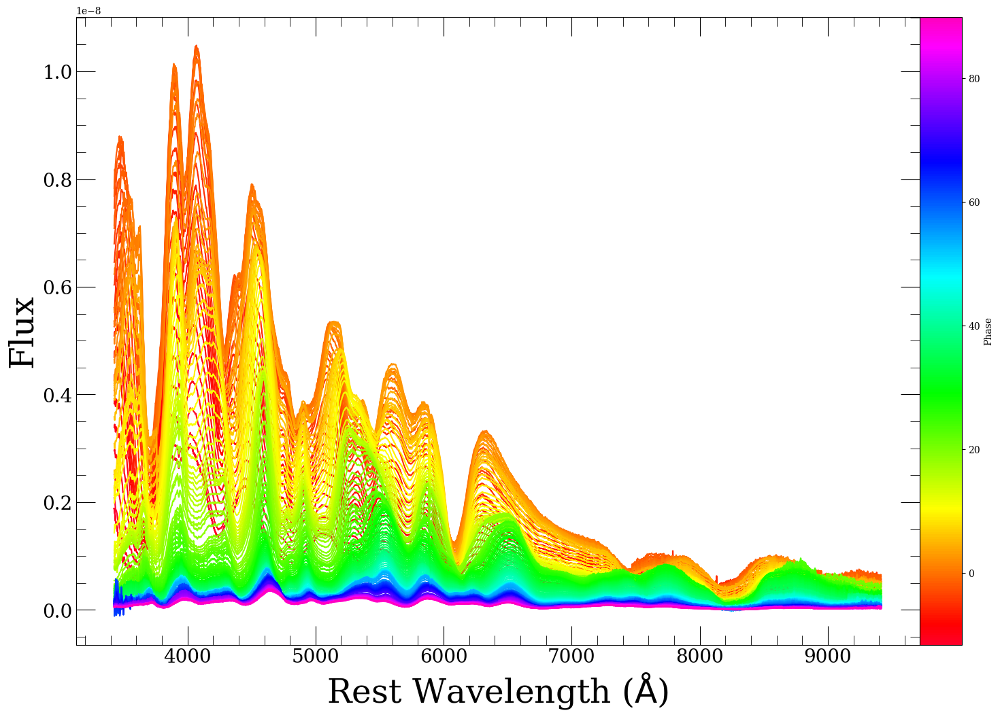

In [42]:
fig, ax, = kplot.basic_format()

s_m = make_colorbar(phases)
for i,z in enumerate(Z2_highv):
    plt.plot(X2_highv[i], z, color = s_m.to_rgba(Y2_highv[i][0]))
plt.xlabel('Rest Wavelength ($\mathrm{\AA}$)', fontsize = 35)
plt.ylabel('Flux', fontsize = 35)
cax=ax.inset_axes([1, 0., 0.05, 1])
plt.colorbar(s_m, cax=cax,label='Phase')
plt.show()

200
[10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47]


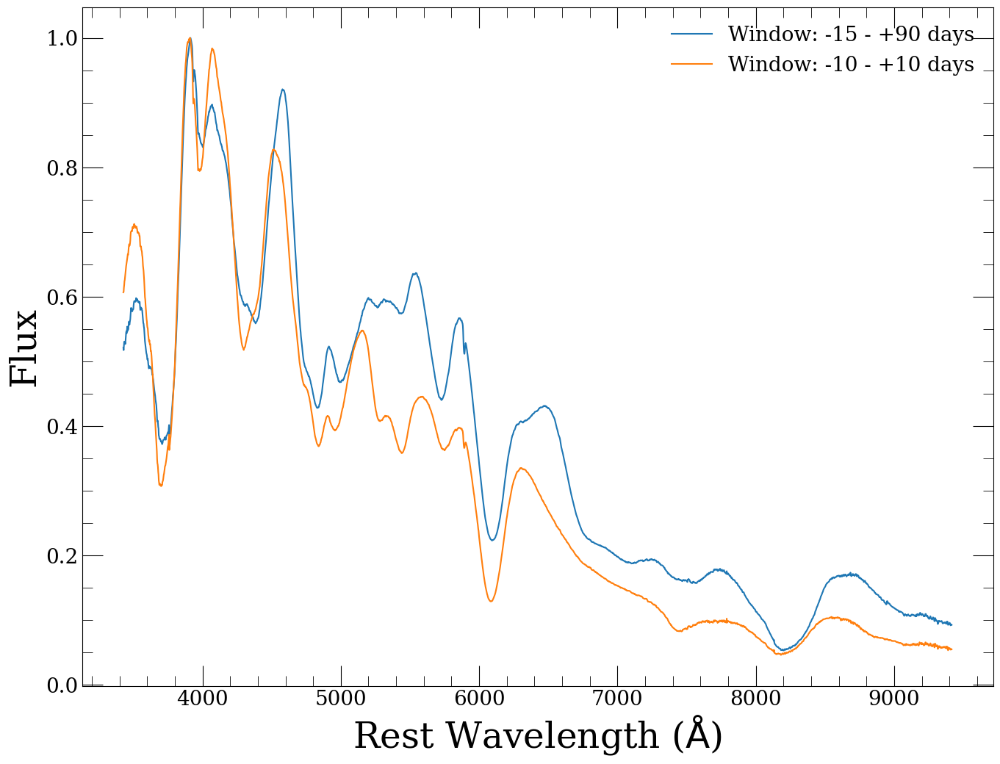

In [75]:
fig, ax, = kplot.basic_format()
print (len(Y2_highv))
inds = []
plow = -10
phigh = 10
phases_interp = []
for i, y in enumerate(Y2_highv):
    if y[0] > plow and y[0] < phigh:
        inds.append(i)
    phases_interp.append(y[0])
    
phase_diff = np.diff(phases_interp)[0]

print (inds)

lecho1_highv = np.sum(Z2_highv*phase_diff,axis=0)
lecho2_highv = np.sum(Z2_highv[inds]*phase_diff,axis=0)
scale1_highv = 1./np.amax(lecho1_highv)
scale2_highv = 1./np.amax(lecho2_highv)

plt.plot(X2_highv[0], scale1_highv*lecho1_highv, label = 'Window: -15 - +90 days')
plt.plot(X2_highv[0], scale2_highv*lecho2_highv, label = 'Window: -10 - +10 days')
plt.xlabel('Rest Wavelength ($\mathrm{\AA}$)', fontsize = 35)
plt.ylabel('Flux', fontsize = 35)
# plt.xlim(3500, 9000)
plt.legend(fontsize=20, frameon=False)
plt.show()

In [46]:
queries_custom_low_v = kpora.create_query_strings_for_sequence([-10,90], [.5,1.8], velocity_range=[-12, -8], phase_step = 1, phase_bin_size=3, phase_step_bin_scale = True)


SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase < -10 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -10 and phase < -7 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -9 and phase < -6 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -8 and phase < -5 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -7 and phase < -4 a

In [47]:
composites_custom_lowv, sn_arrays, og_SN_Arrays, boot_sn_arrays = kpora.make_composite(queries_custom_low_v, db_file = '../data/kaepora_v1.2.db', shape_param='dm15', boot=False, make_corr=True, av_corr=True, medmean=1, 
                                                                                         verbose=False, gini_balance=True, combine=True, scale_region=[4000,9000], get_og_arr = True)

SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase < -10 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
ERROR:  sn2006oa-20061116-not.dat None
59 Total Spectra found
1 flagged spectra removed 58 spectra left
0 spectra of peculiar Ias removed 58 spectra left
58 spectra of SNe that have host reddening corrections
Arrays cleaned
58 spectra may have telluric contamination
24 total SNe
removed spectra of SNe with A_V > 2.0
Using 58 spectra of 24 SNe
Gini balancing...
Balanced after 20 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= -10 and phase < -7 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
112 Total Spectra found
3 flagged spectra removed 109 spectra left
0 spectra of peculiar Ias removed 109 spectra left
96 spectra of SNe that h

191 Total Spectra found
9 flagged spectra removed 182 spectra left
0 spectra of peculiar Ias removed 182 spectra left
172 spectra of SNe that have host reddening corrections
Arrays cleaned
172 spectra may have telluric contamination
84 total SNe
removed spectra of SNe with A_V > 2.0
Using 168 spectra of 82 SNe
Gini balancing...
Balanced after 24 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 2 and phase < 5 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
189 Total Spectra found
7 flagged spectra removed 182 spectra left
0 spectra of peculiar Ias removed 182 spectra left
169 spectra of SNe that have host reddening corrections
Arrays cleaned
169 spectra may have telluric contamination
80 total SNe
removed spectra of SNe with A_V > 2.0
Using 165 spectra of 78 SNe
Gini balancing...
Balanced after 17 iterations
SQL Query: SELECT * from Spectra inner join 

105 Total Spectra found
7 flagged spectra removed 98 spectra left
0 spectra of peculiar Ias removed 98 spectra left
90 spectra of SNe that have host reddening corrections
Arrays cleaned
90 spectra may have telluric contamination
56 total SNe
removed spectra of SNe with A_V > 2.0
Using 84 spectra of 53 SNe
Gini balancing...
Balanced after 18 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 15 and phase < 18 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
99 Total Spectra found
6 flagged spectra removed 93 spectra left
0 spectra of peculiar Ias removed 93 spectra left
85 spectra of SNe that have host reddening corrections
Arrays cleaned
85 spectra may have telluric contamination
55 total SNe
removed spectra of SNe with A_V > 2.0
Using 81 spectra of 52 SNe
Gini balancing...
Balanced after 17 iterations
SQL Query: SELECT * from Spectra inner join Events ON

74 Total Spectra found
2 flagged spectra removed 72 spectra left
0 spectra of peculiar Ias removed 72 spectra left
68 spectra of SNe that have host reddening corrections
Arrays cleaned
68 spectra may have telluric contamination
46 total SNe
removed spectra of SNe with A_V > 2.0
Using 66 spectra of 44 SNe
Gini balancing...
Balanced after 20 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 28 and phase < 31 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
69 Total Spectra found
2 flagged spectra removed 67 spectra left
0 spectra of peculiar Ias removed 67 spectra left
64 spectra of SNe that have host reddening corrections
Arrays cleaned
64 spectra may have telluric contamination
51 total SNe
removed spectra of SNe with A_V > 2.0
Using 63 spectra of 50 SNe
Gini balancing...
Balanced after 17 iterations
SQL Query: SELECT * from Spectra inner join Events ON 

83 Total Spectra found
5 flagged spectra removed 78 spectra left
0 spectra of peculiar Ias removed 78 spectra left
73 spectra of SNe that have host reddening corrections
Arrays cleaned
73 spectra may have telluric contamination
44 total SNe
removed spectra of SNe with A_V > 2.0
Using 72 spectra of 43 SNe
Gini balancing...
Balanced after 27 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 41 and phase < 48 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
78 Total Spectra found
3 flagged spectra removed 75 spectra left
0 spectra of peculiar Ias removed 75 spectra left
70 spectra of SNe that have host reddening corrections
Arrays cleaned
70 spectra may have telluric contamination
44 total SNe
removed spectra of SNe with A_V > 2.0
Using 69 spectra of 43 SNe
Gini balancing...
Balanced after 19 iterations
SQL Query: SELECT * from Spectra inner join Events ON 

60 Total Spectra found
4 flagged spectra removed 56 spectra left
0 spectra of peculiar Ias removed 56 spectra left
53 spectra of SNe that have host reddening corrections
Arrays cleaned
0 spectra may have telluric contamination
32 total SNe
removed spectra of SNe with A_V > 2.0
Using 53 spectra of 31 SNe
Gini balancing...
Balanced after 19 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 54 and phase < 61 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
66 Total Spectra found
5 flagged spectra removed 61 spectra left
0 spectra of peculiar Ias removed 61 spectra left
57 spectra of SNe that have host reddening corrections
Arrays cleaned
57 spectra may have telluric contamination
36 total SNe
removed spectra of SNe with A_V > 2.0
Using 57 spectra of 35 SNe
Gini balancing...
Balanced after 20 iterations
SQL Query: SELECT * from Spectra inner join Events ON S

52 Total Spectra found
1 flagged spectra removed 51 spectra left
0 spectra of peculiar Ias removed 51 spectra left
48 spectra of SNe that have host reddening corrections
Arrays cleaned
48 spectra may have telluric contamination
27 total SNe
removed spectra of SNe with A_V > 2.0
Using 48 spectra of 27 SNe
Gini balancing...
Balanced after 7 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 67 and phase < 81 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
55 Total Spectra found
1 flagged spectra removed 54 spectra left
0 spectra of peculiar Ias removed 54 spectra left
51 spectra of SNe that have host reddening corrections
Arrays cleaned
51 spectra may have telluric contamination
28 total SNe
removed spectra of SNe with A_V > 2.0
Using 51 spectra of 28 SNe
Gini balancing...
Balanced after 6 iterations
SQL Query: SELECT * from Spectra inner join Events ON Sp

47 Total Spectra found
1 flagged spectra removed 46 spectra left
0 spectra of peculiar Ias removed 46 spectra left
45 spectra of SNe that have host reddening corrections
Arrays cleaned
45 spectra may have telluric contamination
25 total SNe
removed spectra of SNe with A_V > 2.0
Using 45 spectra of 25 SNe
Gini balancing...
Balanced after 11 iterations
SQL Query: SELECT * from Spectra inner join Events ON Spectra.SN = Events.SN and phase >= 80 and phase < 94 and ((dm15_source >= 0.5 and dm15_source < 1.8) or (dm15_from_fits >= 0.5 and dm15_from_fits < 1.8))and v_at_max between -12 and -8
42 Total Spectra found
1 flagged spectra removed 41 spectra left
0 spectra of peculiar Ias removed 41 spectra left
41 spectra of SNe that have host reddening corrections
Arrays cleaned
41 spectra may have telluric contamination
24 total SNe
removed spectra of SNe with A_V > 2.0
Using 41 spectra of 24 SNe
Gini balancing...
Balanced after 11 iterations
SQL Query: SELECT * from Spectra inner join Events ON 

In [48]:
dm15s = []
composites_custom_dict_lowv = {}
for comp in composites_custom_lowv:
    phase = np.average(comp.phase_array[comp.x1:comp.x2])
    dm15s.append(np.average(comp.dm15_array[comp.x1:comp.x2]))
    composites_custom_dict_lowv[phase] = comp
print (np.median(dm15s))
dm15_med = np.median(dm15s)
x_1 = sa.calc_x1_from_dm15(dm15_med)
print (x_1)

1.0860760622799583
-0.4239500876414709


In [49]:
phot_salt = fc.create_salt_phot(x_1)
phot_hsiao = fc.create_hsiao_phot()
min_phase = -20
max_phase = 90
del_phases = []
for phase in composites_custom_dict_lowv.keys():
    composites_custom_dict_lowv[phase].event_data = {}
    composites_custom_dict_lowv[phase].event_data['Homogenized_Photometry'] = phot_hsiao #assign template here
    if phase < min_phase or phase > max_phase:
        del_phases.append(phase)
for p in del_phases:
    print ("spectrum outside phase range")
    del composites_custom_dict_lowv[p]

Warning, 326 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 326 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 33 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 32 of 721 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

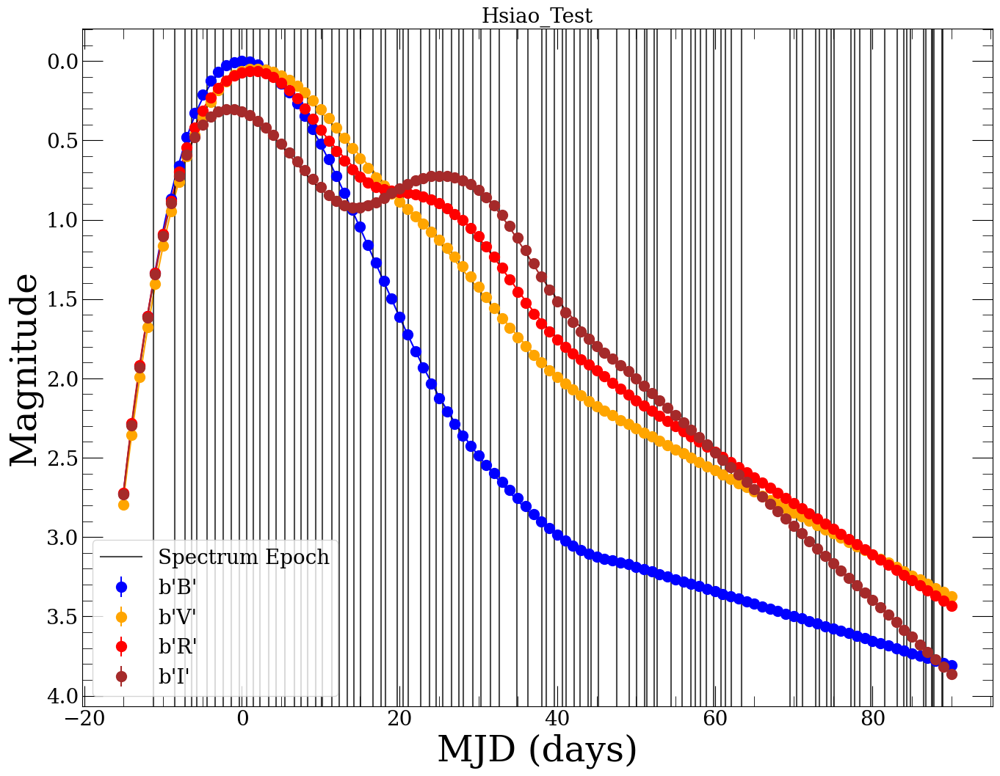

In [50]:
fc.plot_light_curves(phot_hsiao, 'Hsiao_Test', spec_dates = composites_custom_dict_lowv.keys(), fit=True)

In [51]:
calibrated_spec_array_lowv = fc.scale_composites_to_photometry(composites_custom_dict_lowv, verbose=True)

Warning, 66 of 4440 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 66 of 4440 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 66 of 4440 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 66 of 4440 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 109 of 4398 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 109 of 4398 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 109 of 4398 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 106 of 4604 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 106 of 4604 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 106 of 4604 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 113 of 4604 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 113 of 4604 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 113 of 4604 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 113 of 4604 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a d

Warning, 113 of 4650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 113 of 4650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 113 of 4650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 113 of 4650 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a d

Warning, 165 of 4283 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 165 of 4283 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 165 of 4283 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 23 of 4465 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 23 of 4465 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 23 of 4465 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 29 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 22 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 22 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 22 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 22 of 4427 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 21 of 4756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 24 of 4763 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 24 of 4763 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 24 of 4763 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 28 of 4763 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 28 of 4763 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 28 of 4763 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 33 of 4495 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 33 of 4495 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 33 of 4495 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 21 of 4443 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4443 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 21 of 4443 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4443 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 11 of 4413 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 4413 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 4413 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 4413 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 123 of 4656 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 123 of 4656 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 123 of 4656 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 123 of 4656 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 237 of 4631 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 237 of 4631 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 237 of 4631 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 197 of 4631 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 197 of 4631 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 197 of 4631 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 197 of 4631 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a d

Warning, 23 of 4402 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 23 of 4402 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 23 of 4402 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 88 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 88 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 88 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 88 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 82 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 82 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 82 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 132 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 132 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 132 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 132 of 4561 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

Warning, 70 of 4423 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 70 of 4423 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 70 of 4423 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 56 of 4623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 56 of 4623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 56 of 4623 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 124 of 4814 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 124 of 4814 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 124 of 4814 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 124 of 4814 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 124 of 4814 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 124 of 4814 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 146 of 4610 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 146 of 4610 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a d

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 146 of 4610 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inst

Warning, 78 of 4385 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 78 of 4385 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 78 of 4385 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 78 of 4367 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 78 of 4367 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 78 of 4367 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 78 of 4367 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 15 of 4416 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 15 of 4416 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 15 of 4416 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 14 of 4458 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 4458 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 4458 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 15 of 4458 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 15 of 4458 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 15 of 4458 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 26 of 3738 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 26 of 3738 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 26 of 3738 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 26 of 3738 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 43 of 3738 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 43 of 3738 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 43 of 3738 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 28 of 3983 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 28 of 3983 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 28 of 3983 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 11 of 3955 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3955 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3955 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 5 of 4703 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4703 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 5 of 4703 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4703 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 5 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 5 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 5 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined b

Warning, 16 of 3952 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3952 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3952 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 3 of 3964 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3964 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

Warning, 3 of 3964 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3964 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

Warning, 30 of 3812 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 30 of 3812 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 30 of 3812 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 21 of 4472 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined b

Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 3 of 3756 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 40 of 3822 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3822 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3822 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 40 of 3822 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 32 of 3826 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 32 of 3826 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 32 of 3826 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 32 of 3826 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 35 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 11 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 4022 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 16 of 3879 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3879 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 16 of 3879 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined b

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined b

Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 1 of 3702 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

Warning, 6 of 3658 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 6 of 3658 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 6 of 3658 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instea

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3681 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 11 of 3681 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3681 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 11 of 3681 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 15 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 15 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 15 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 13 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 13 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 14 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 14 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 14 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 14 of 3677 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 8 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 8 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defin

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 8 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 8 of 3663 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defin

Warning, 31 of 3775 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 31 of 3775 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 31 of 3775 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 24 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 24 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 24 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 24 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 25 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

Warning, 30 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 30 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 30 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 29 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

Warning, 34 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 34 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 34 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 34 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a def

Warning, 34 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 34 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a def

(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_r_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_i_003_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
Warning, 34 of 4151 bins contained negative fluxes; they have been set to zero.
(/Volumes/cdbs/comp/nonhst/johnson_b_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used instead.
(/Volumes/cdbs/comp/nonhst/johnson_v_004_syn.fits) does not have a defined binset in the wavecat table. The waveset of the spectrum will be used inste

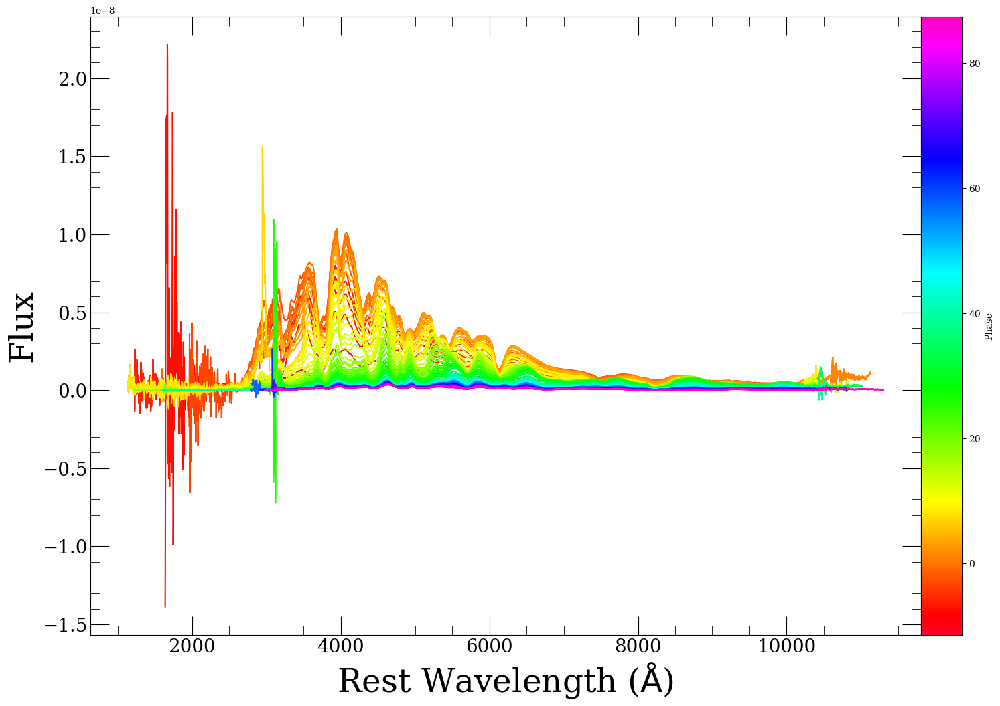

In [52]:
fc.plot_spectra(calibrated_spec_array_lowv)

[3142.0, 10184.0]
2.899586182692436e-12
1.9757586514669525e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


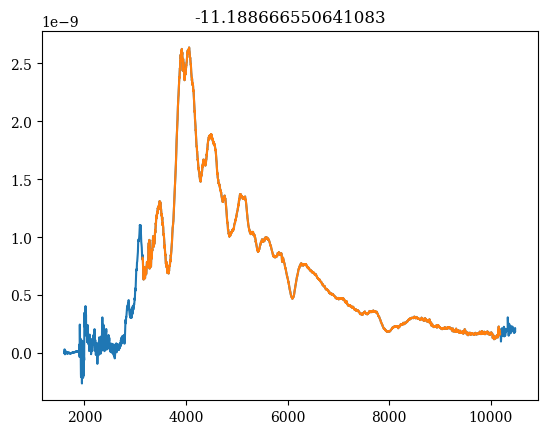

8.483176287842267e-09
2.0107493276171073e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


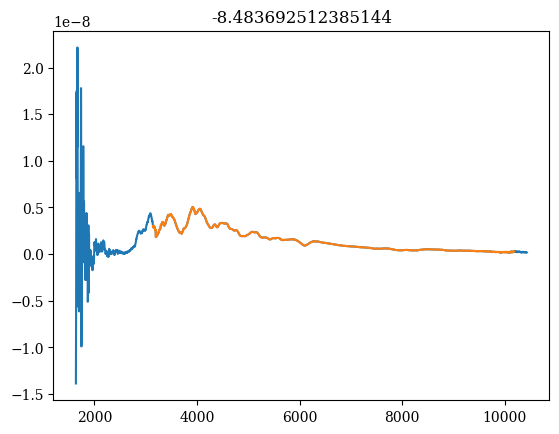

5.50028114397109e-10
2.4822018150861916e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


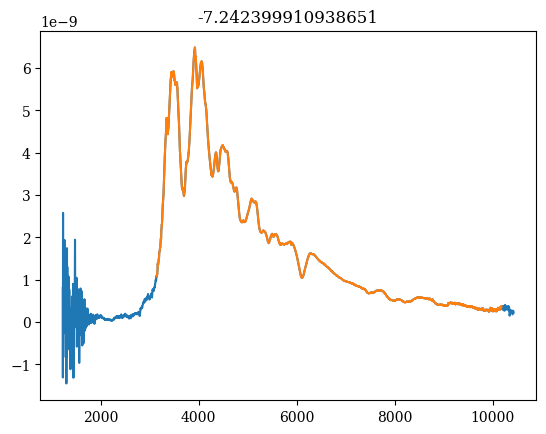

4.717842430750271e-10
2.7931340223275723e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


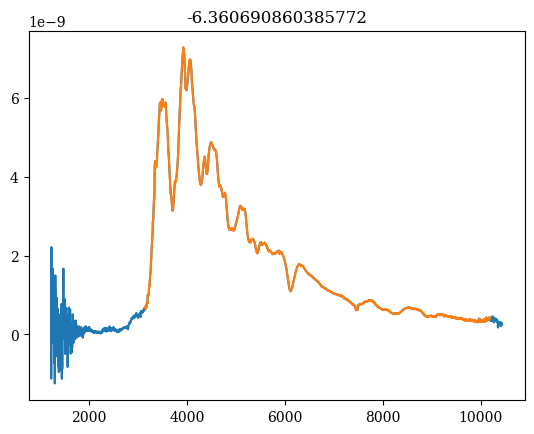

5.632213842295454e-10
2.7579402985703796e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


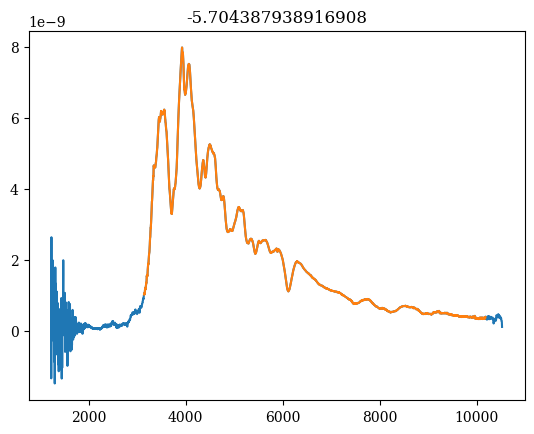

-1.8732884197016525e-10
3.143664164681399e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


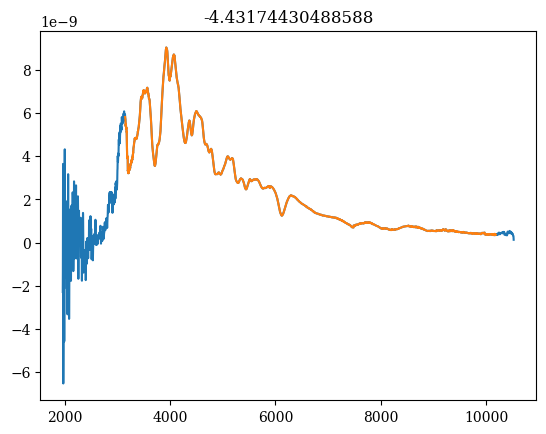

-5.446040127814391e-12
3.412797336377548e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


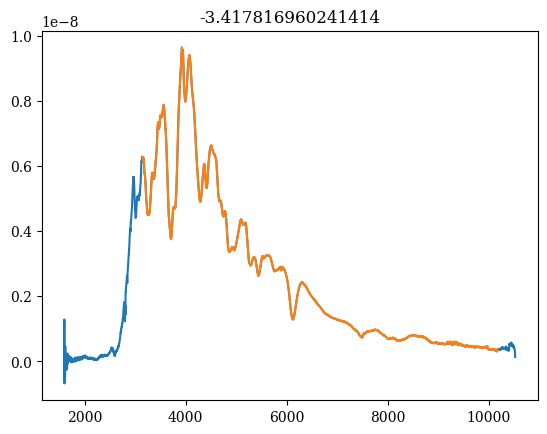

-5.6070444028993315e-12
8.769966051381862e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


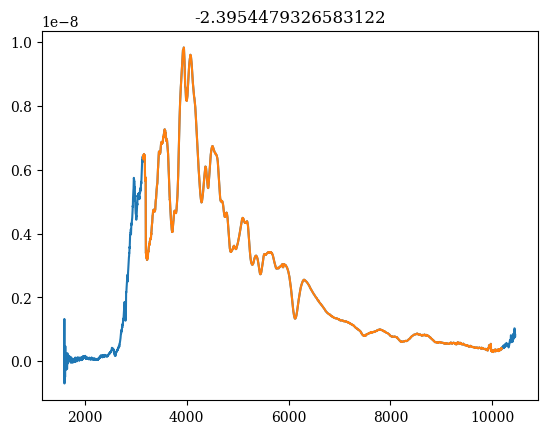

-5.821133351046884e-12
4.295463958815454e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


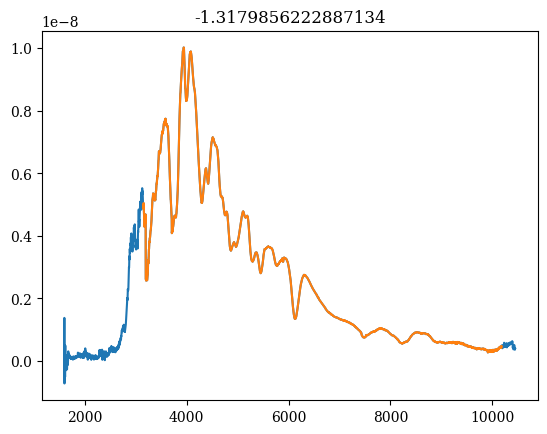

-3.927866807362924e-11
1.0269337954571938e-09
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


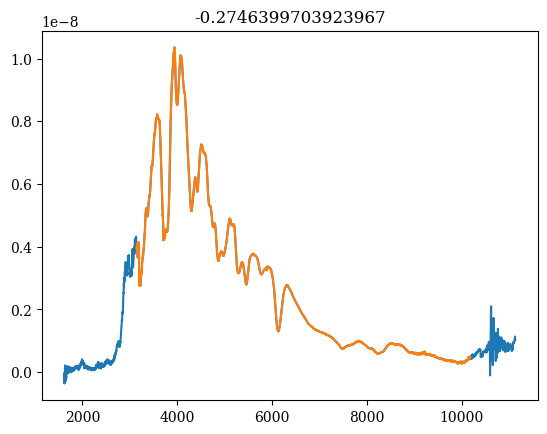

-4.714465874885493e-12
1.0270560781474069e-09
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


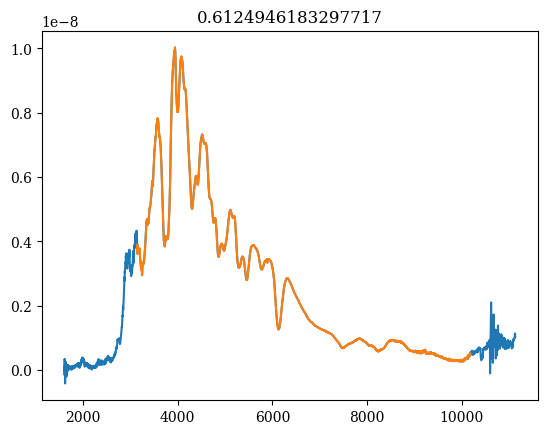

6.188644717266157e-11
1.025468392367894e-09
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


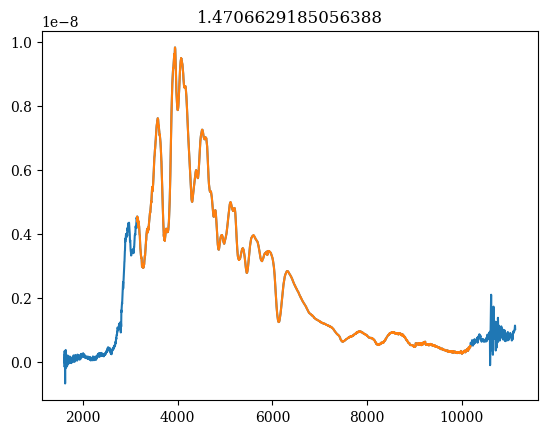

6.053657009750955e-11
8.387578835370276e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


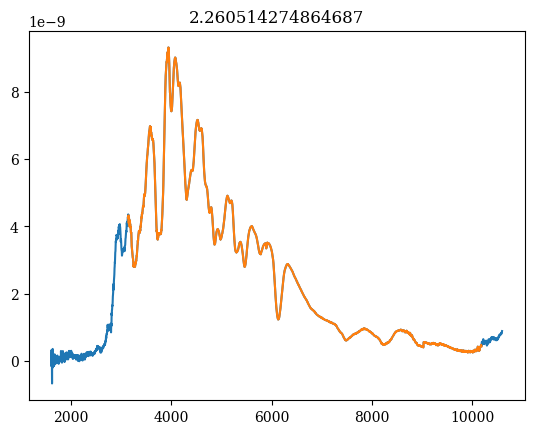

1.3582048493925836e-10
6.517507220593182e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


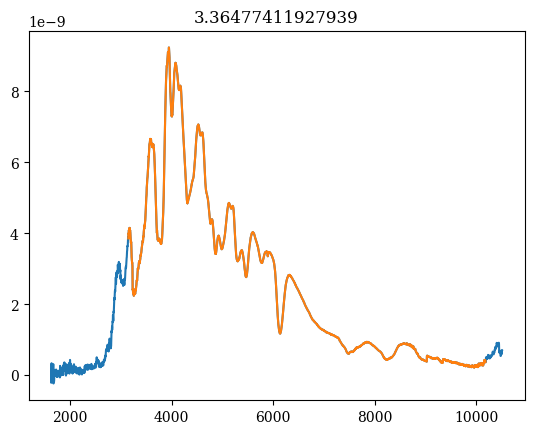

1.3081151545834542e-10
1.0305705678525524e-09
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


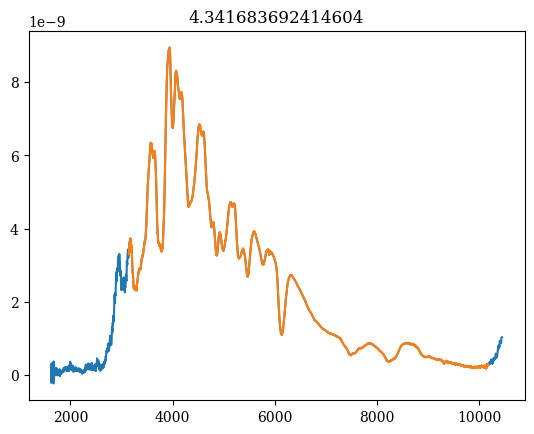

3.1541867378369726e-10
9.79943096707592e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


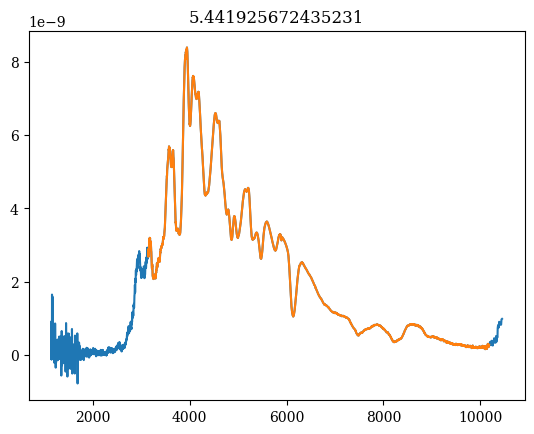

2.9137568210583906e-10
6.361401024668466e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


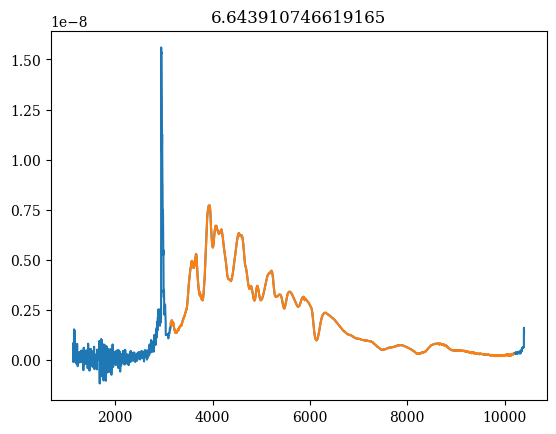

2.7206877556174755e-10
6.068985534128886e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


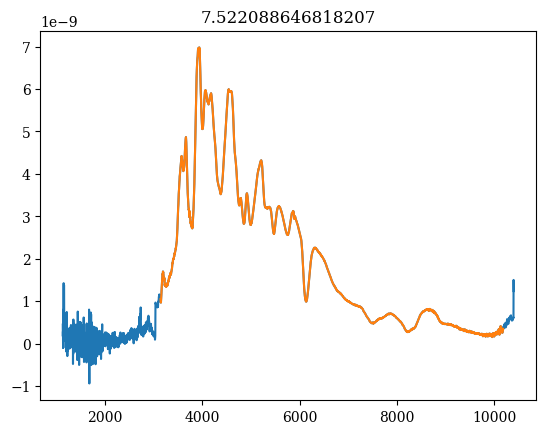

1.536784496123911e-11
5.863065716670544e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


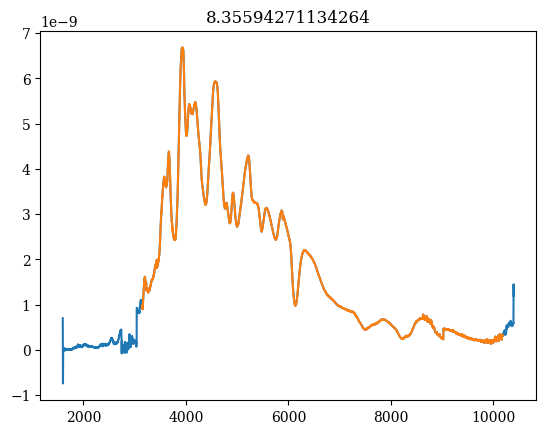

2.2787369195600967e-12
1.1117494492379245e-09
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


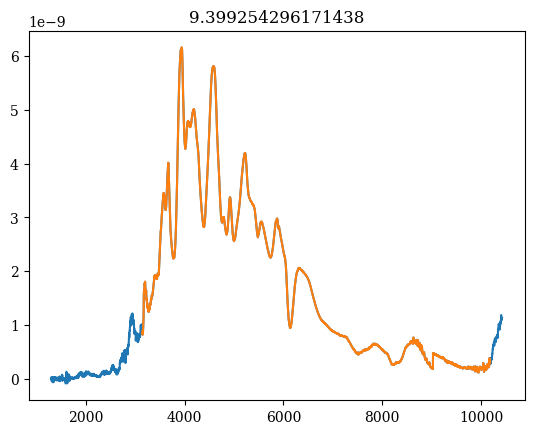

2.1210868413210053e-12
1.03041236679387e-09
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


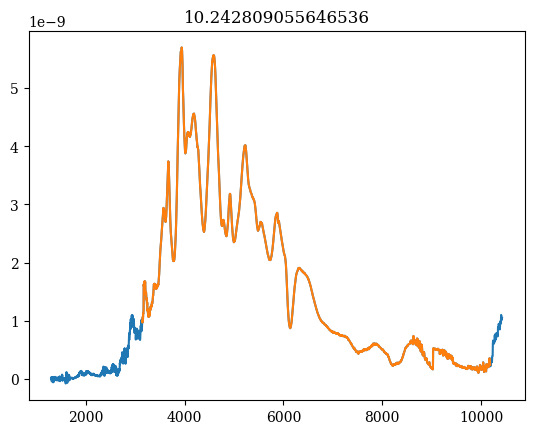

1.90022135557855e-12
9.201502511643579e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


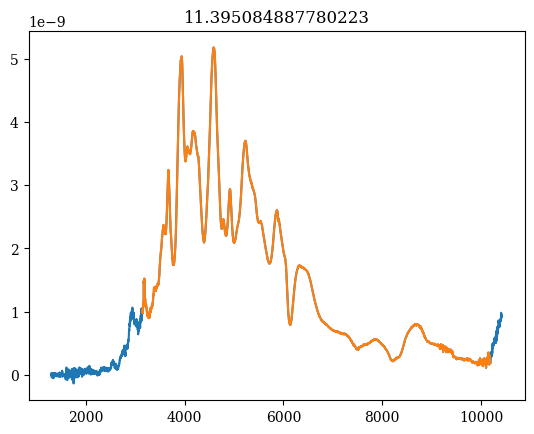

-6.282362940473237e-11
6.506815305471402e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


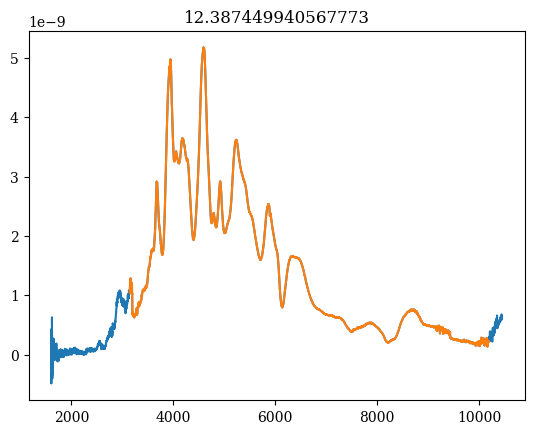

-3.3941106849420365e-11
2.4218638210623926e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


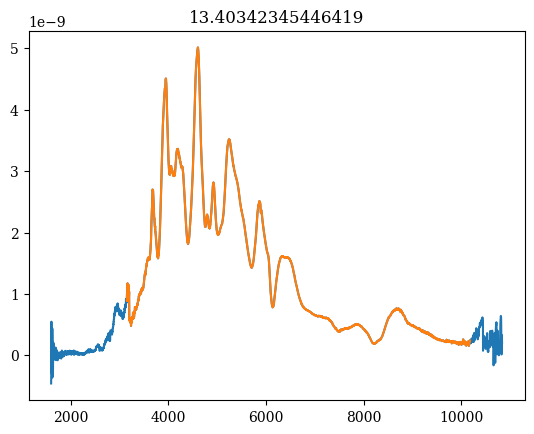

4.413316673669155e-11
2.289701977862064e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


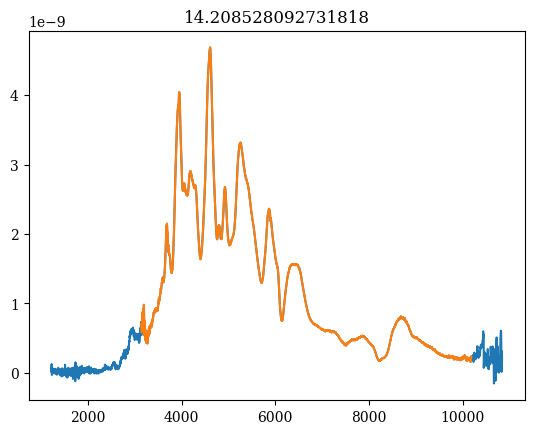

4.00183137961206e-11
2.1091497699018826e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


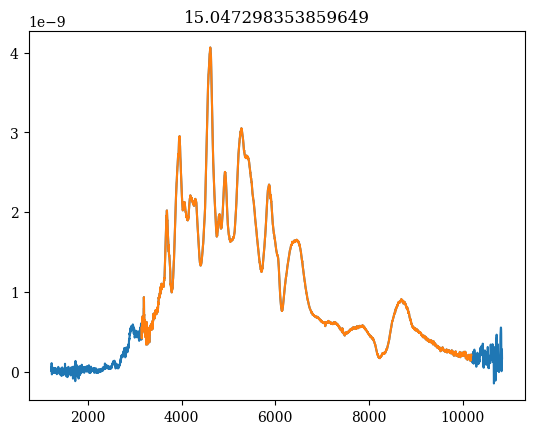

3.5780201820039043e-11
2.6325253429969516e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


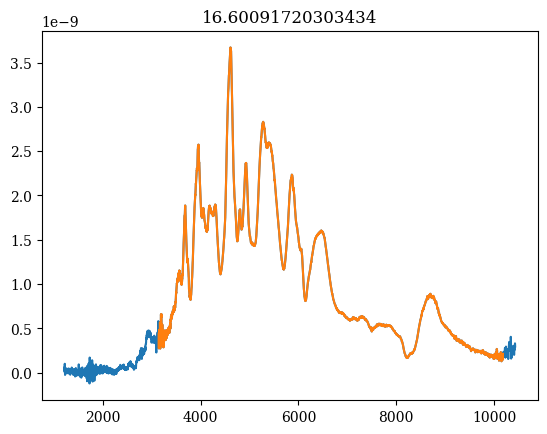

4.365918486162807e-11
4.130839356686221e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


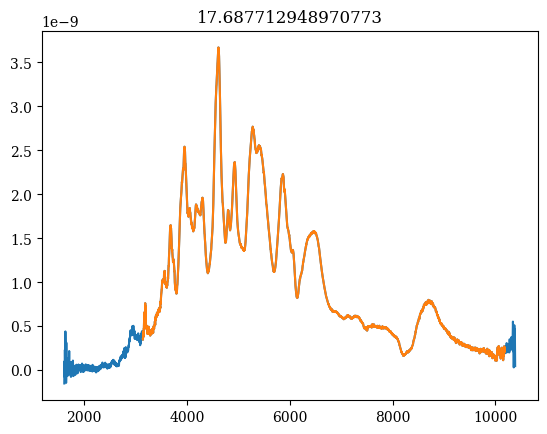

4.1271121264585265e-11
4.61652757860258e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


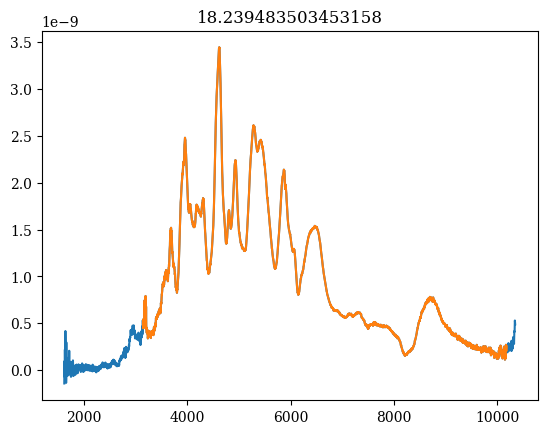

4.659067039406136e-12
1.8012079116764308e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


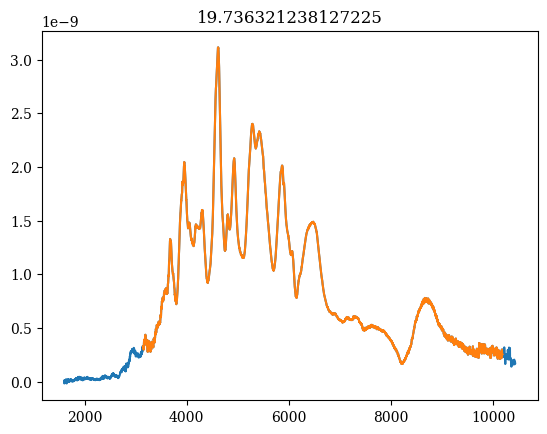

4.249972341666684e-12
5.131130864828152e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


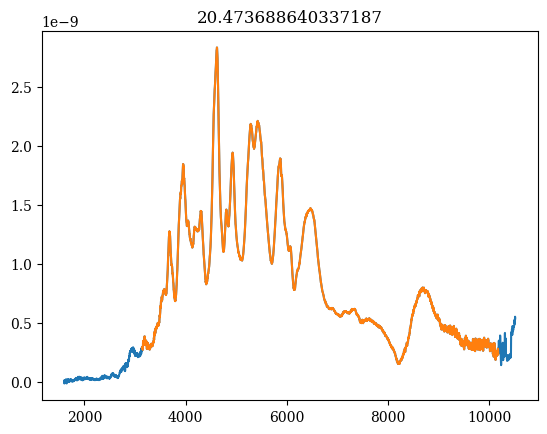

4.037676696742747e-12
4.907853764301857e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


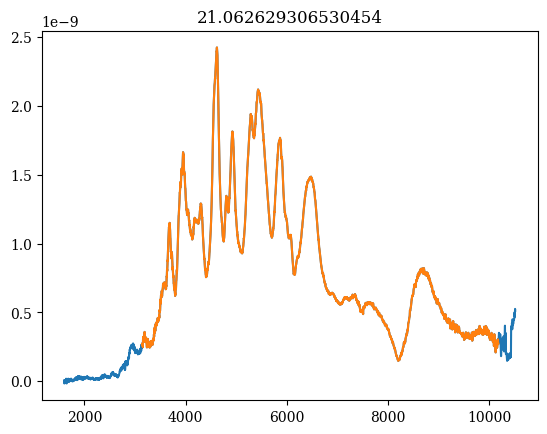

-1.8390963058023204e-10
4.056164625520918e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


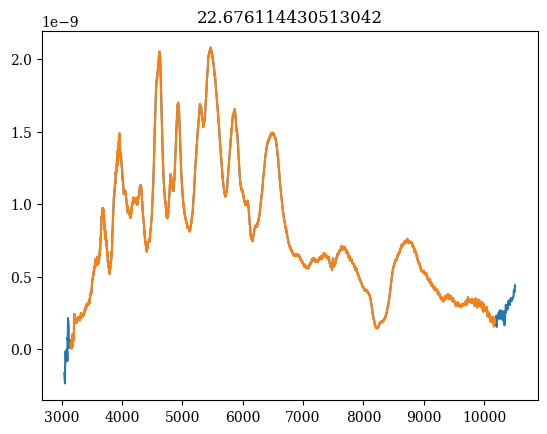

-1.7730875412620788e-10
3.3254355570803133e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


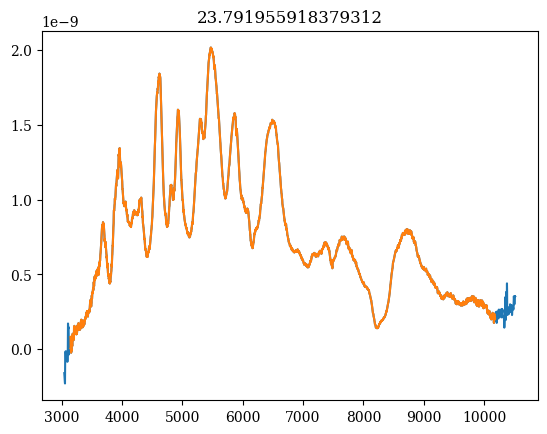

-1.7251789255573585e-10
2.753947254993188e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


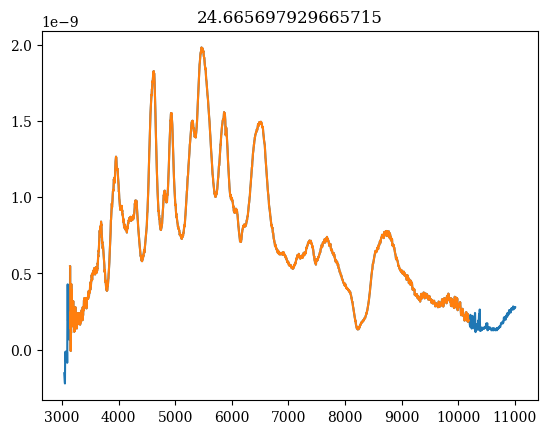

-9.055806314671192e-10
2.5591348751513004e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


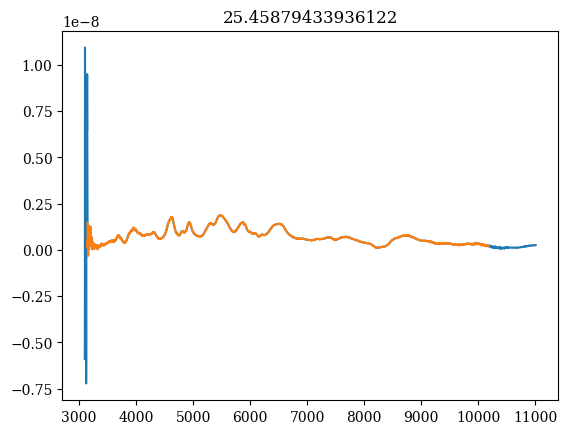

1.0170351104995652e-11
2.5293674708580864e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


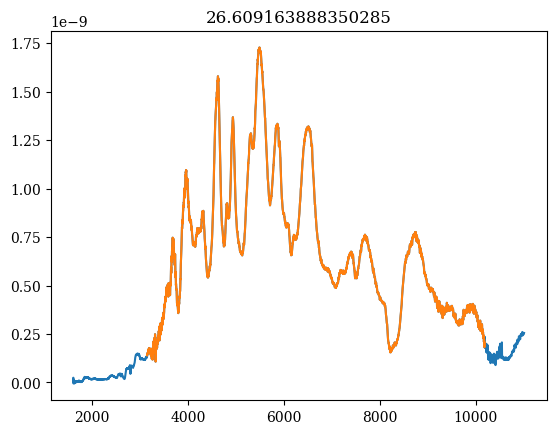

9.737387395477724e-12
1.8620900122047507e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


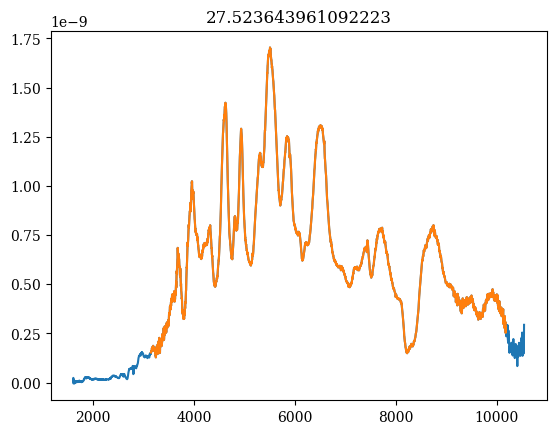

9.376402691131595e-12
2.707700517146805e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


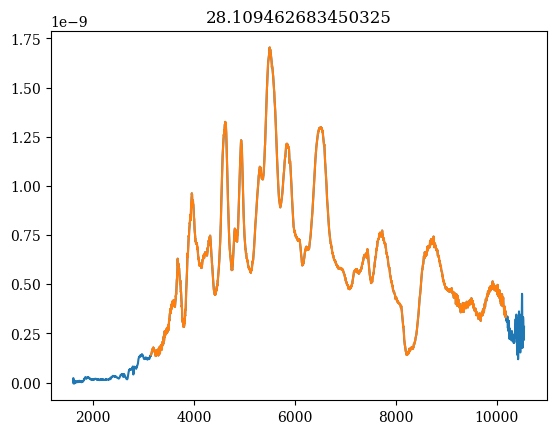

1.3738915081129788e-10
2.0944075546937305e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


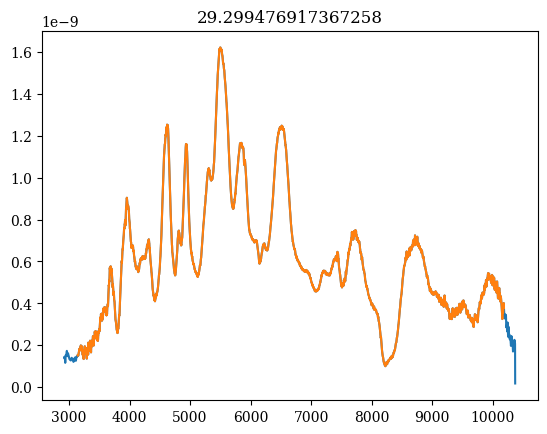

1.889654993562641e-10
2.857894137388256e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


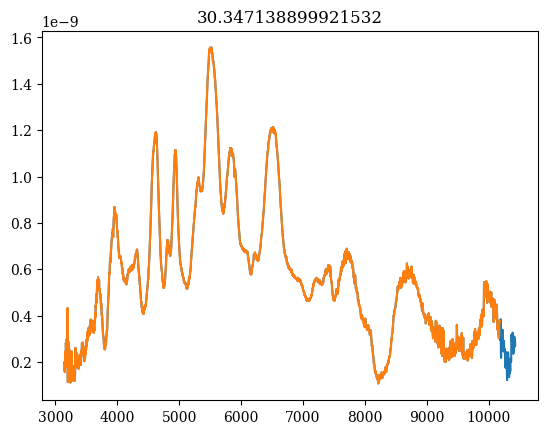

6.215131938951724e-11
2.7165656021993683e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


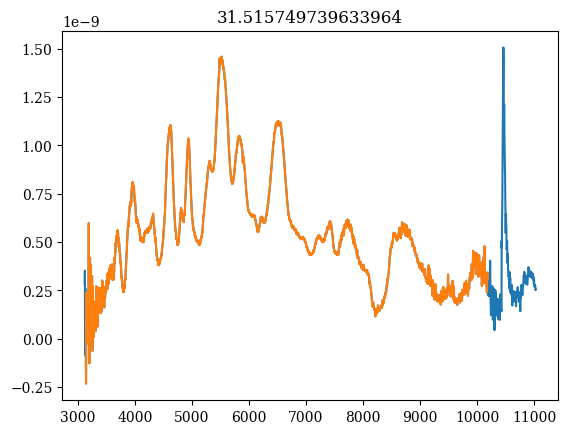

1.6865870747826554e-10
2.5682282019991073e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


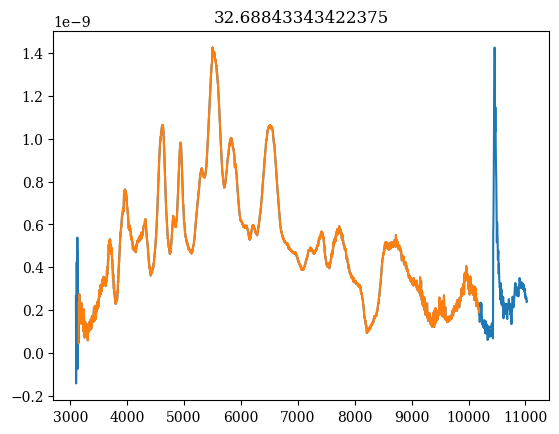

1.3222899541349992e-10
2.185066986344711e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


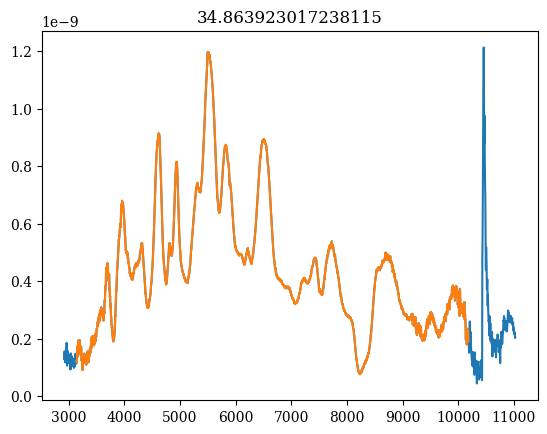

1.2122929123448535e-10
2.577313091298333e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


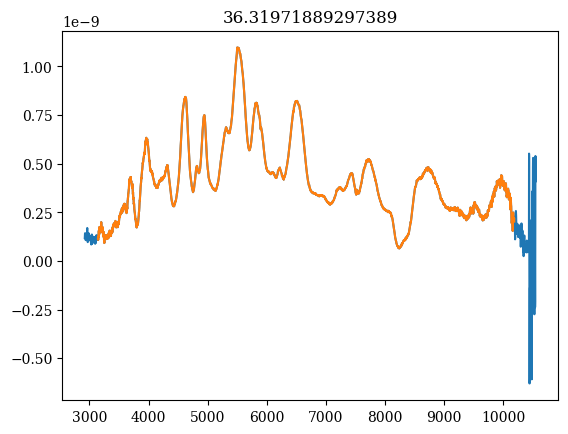

-9.118298748584036e-13
1.433363868054493e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


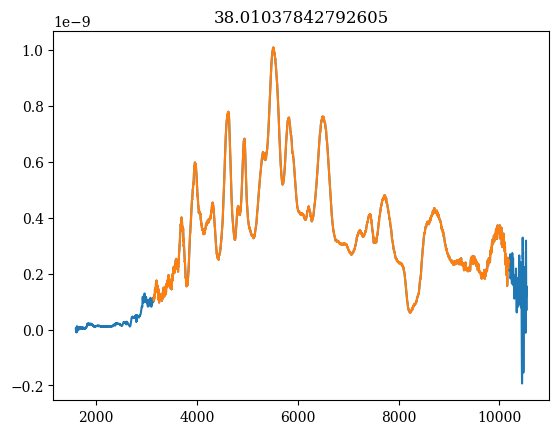

-8.879062139358262e-13
1.3664317522648757e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


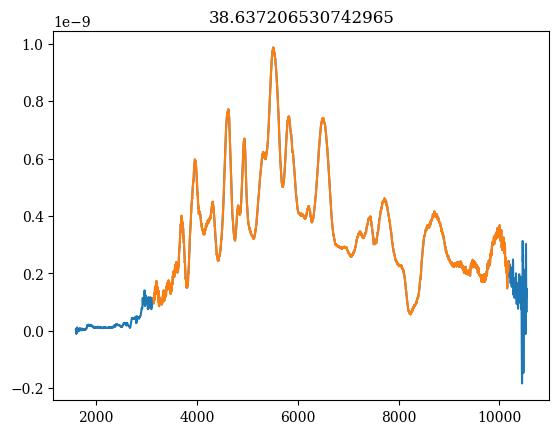

-8.424829533390231e-13
1.2972091584244627e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


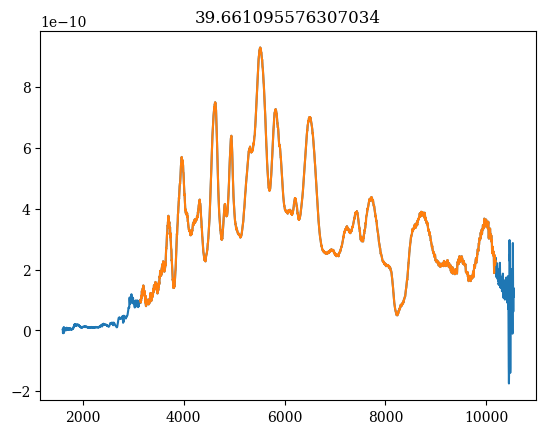

-8.065217227659287e-13
1.242496313296734e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


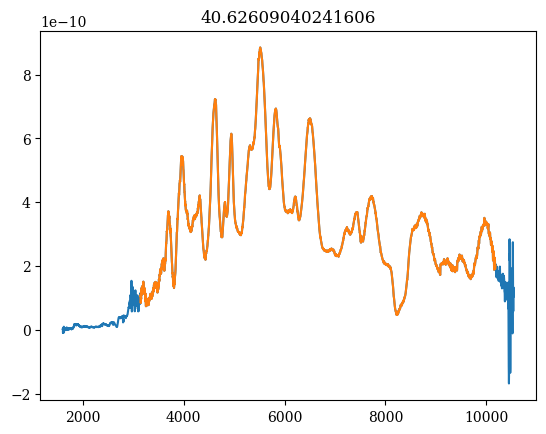

-7.942522137354946e-13
1.2240962519959732e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


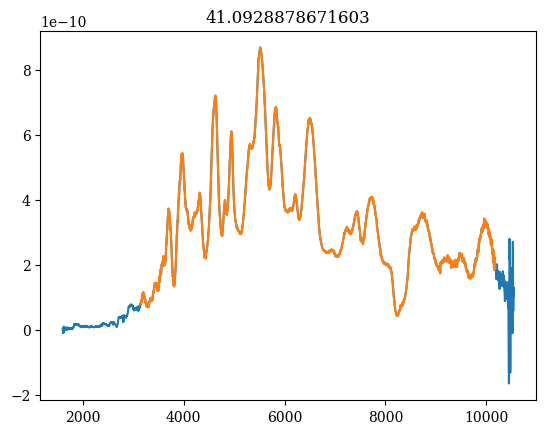

-7.600831047350037e-13
1.1843764840516862e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


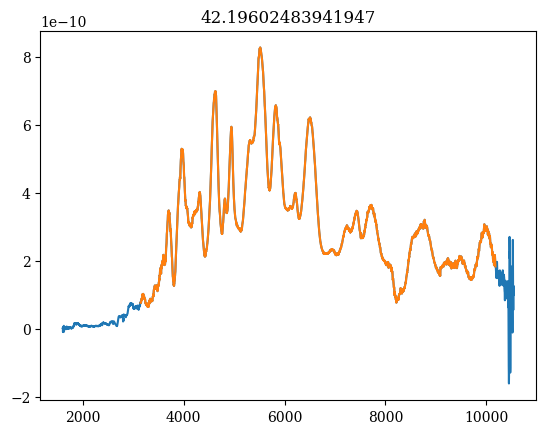

-7.43770520468364e-13
1.0407555575700743e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


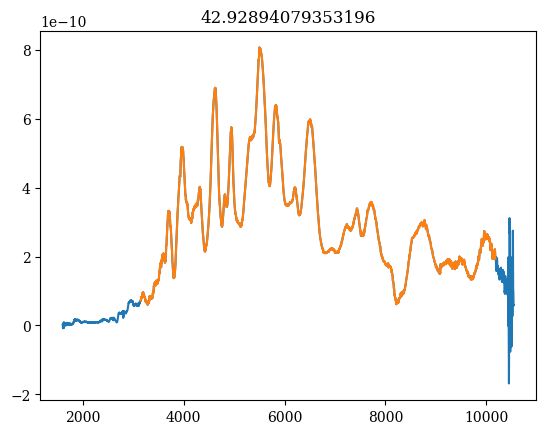

7.730720225103634e-11
1.1410610330403332e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


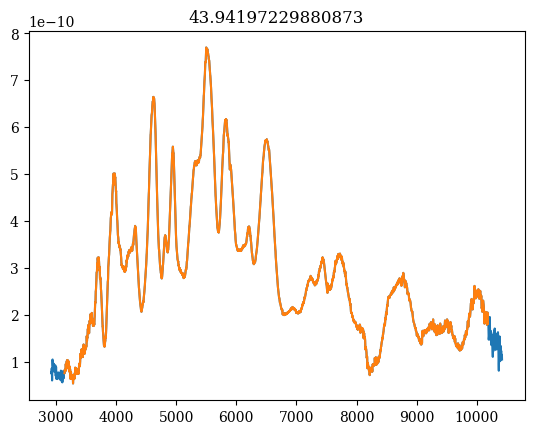

7.844957813990536e-11
1.1572608103979467e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


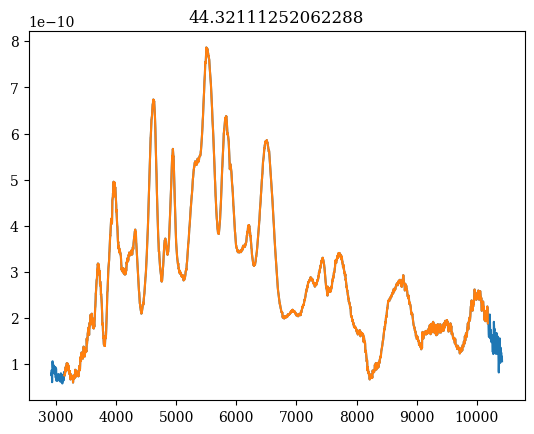

7.477669209592739e-11
1.818631764498862e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


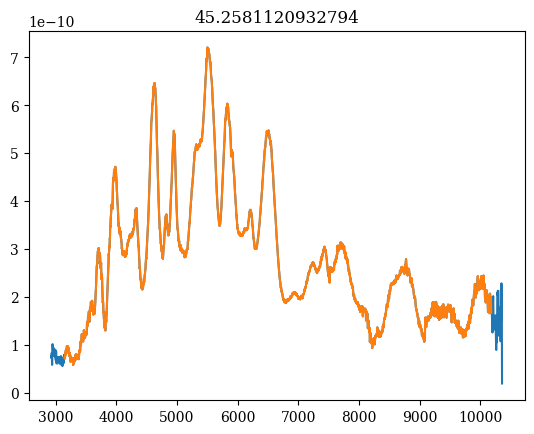

5.016100087472807e-11
1.3647975258784582e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


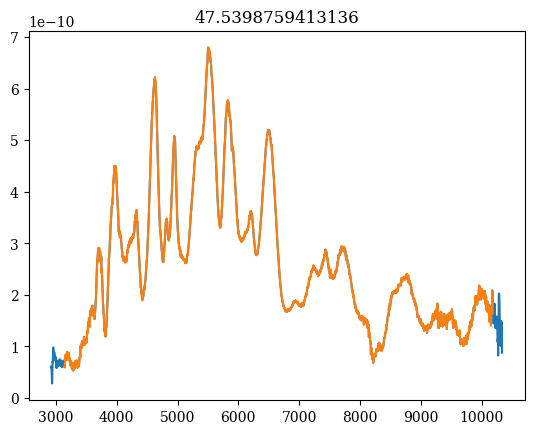

4.892251721704293e-11
4.1094238928945736e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


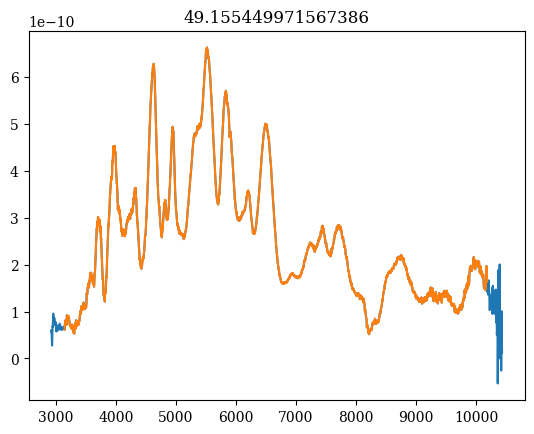

4.810445813072748e-11
4.043302285624938e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


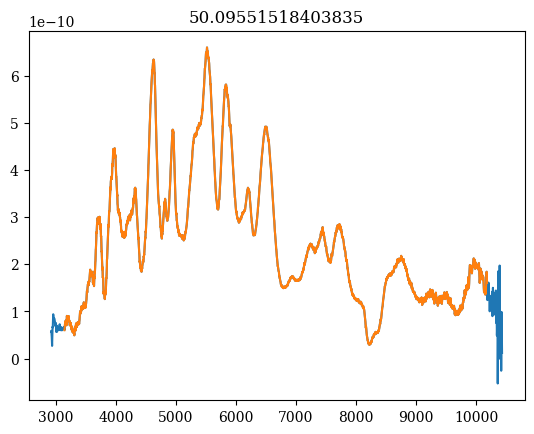

4.7104211746269196e-11
3.9596707172309906e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


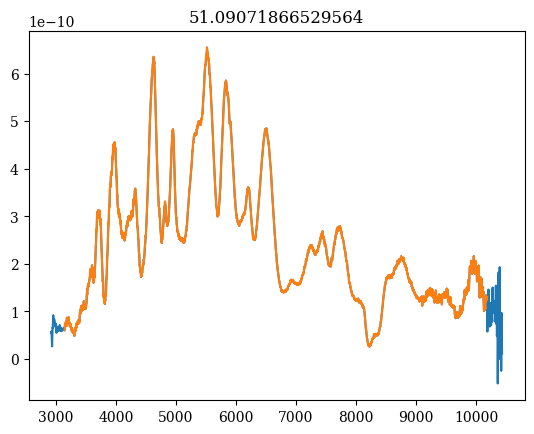

4.612164104269577e-11
3.8707528975865277e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


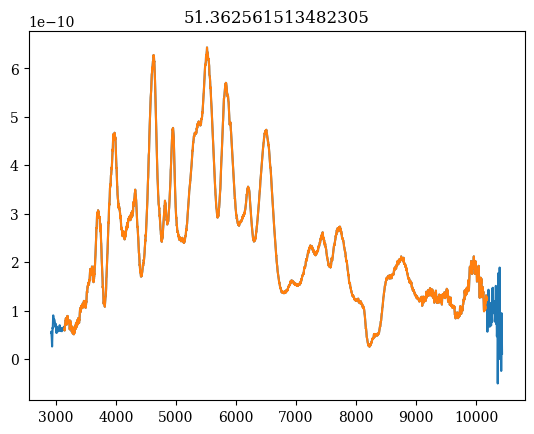

-4.6620460750367674e-11
3.817413610593761e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


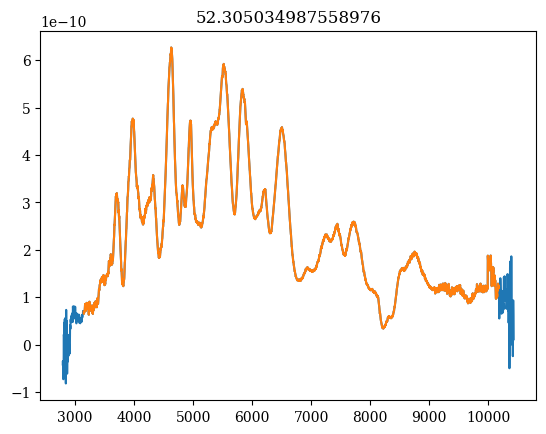

-1.636075248847297e-11
9.774262059777776e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


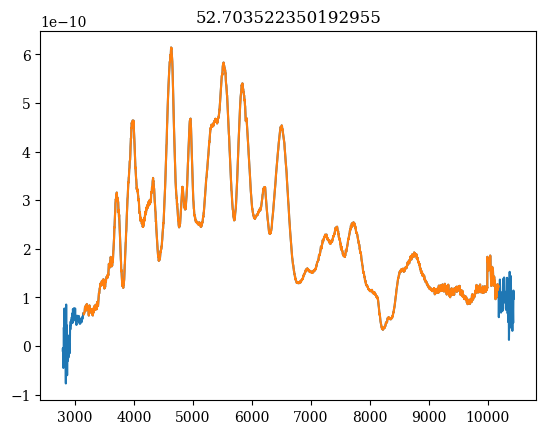

-1.6659495366911745e-11
6.83279070690293e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


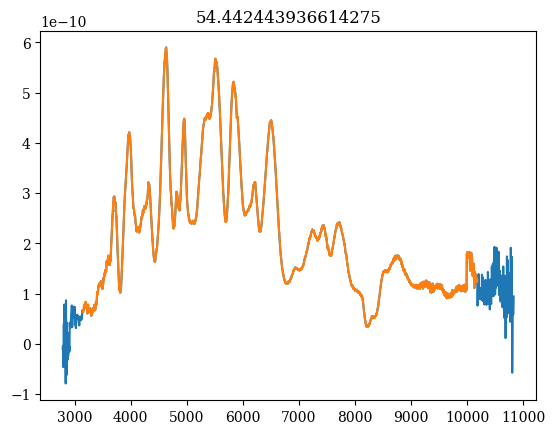

-1.599164064787857e-11
6.479749228758927e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


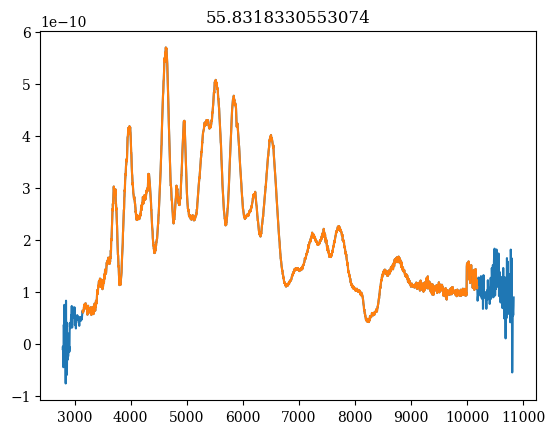

-1.579838516594246e-11
6.376601893307883e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


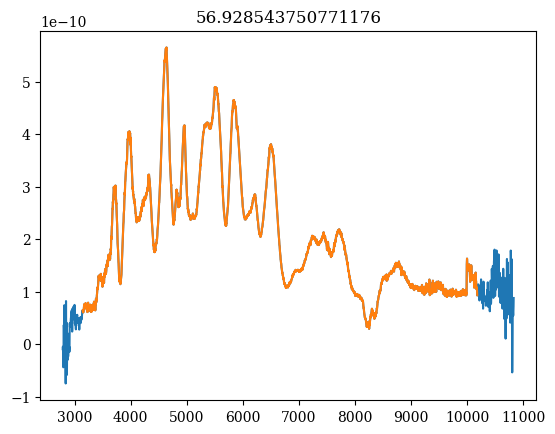

-1.528852213491803e-11
6.1319942800407e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


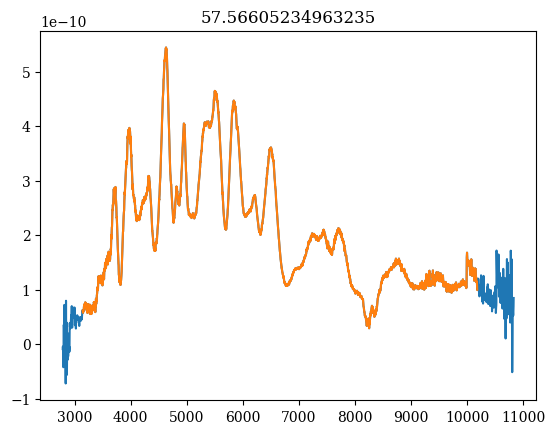

-1.533663690957751e-11
6.146308256558508e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


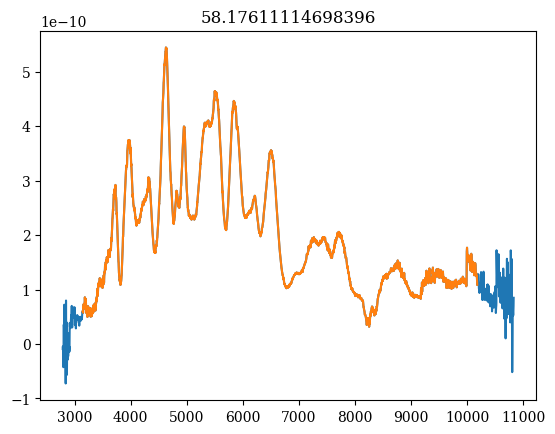

3.713487800347233e-10
5.959675793638091e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


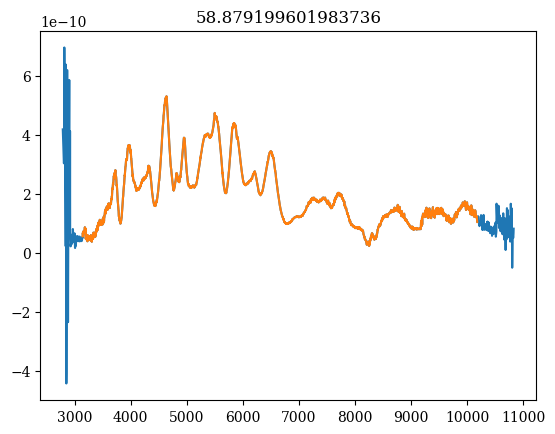

9.42070929478795e-11
5.7502813458002154e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


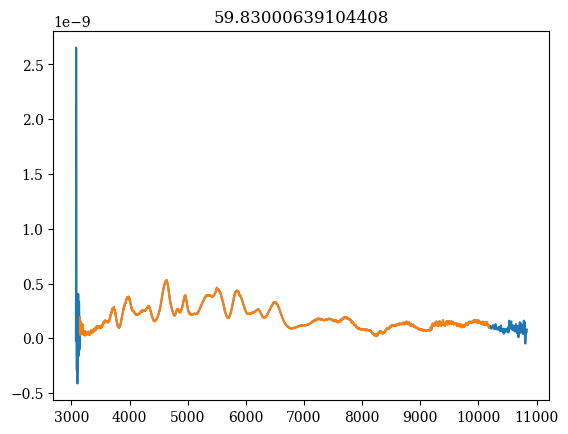

3.6393375472954706e-11
6.11742349937293e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


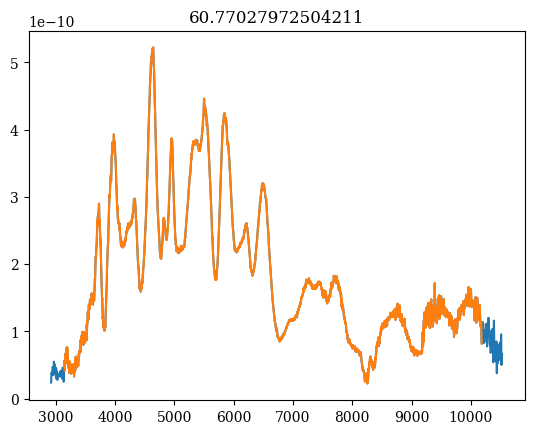

3.626335766004618e-11
6.029589723248357e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


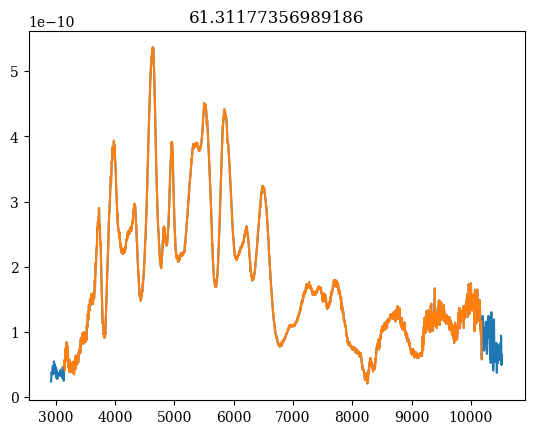

3.490566688475069e-11
5.7499941493949126e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


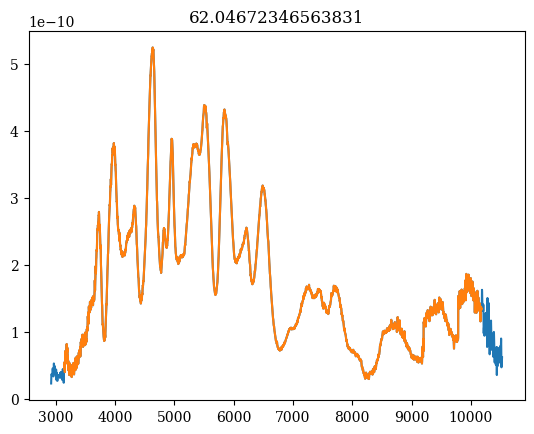

3.5395871232512886e-11
9.777720726237302e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


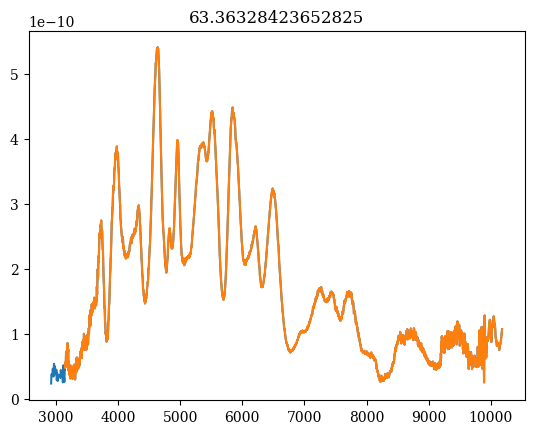

3.099377419655972e-11
5.21470656712656e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


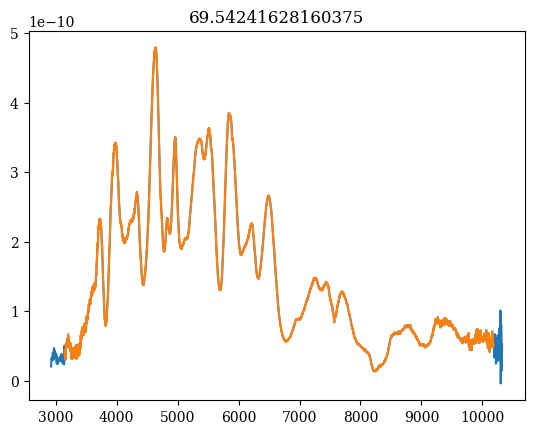

3.042635658102637e-11
5.1217577838445296e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


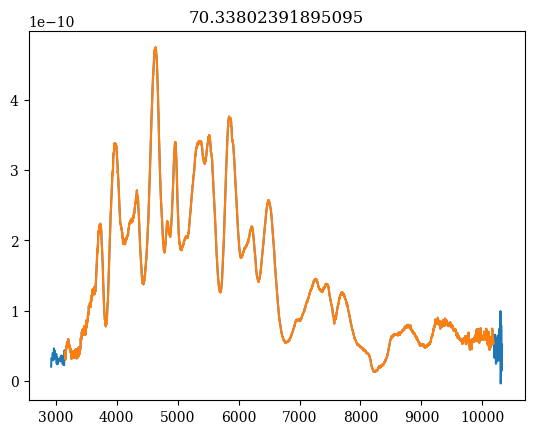

2.974495738496057e-11
5.004713845057329e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


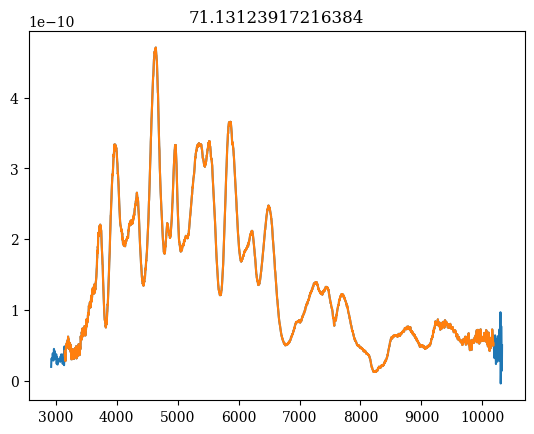

1.654775449858913e-10
2.725824643029717e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


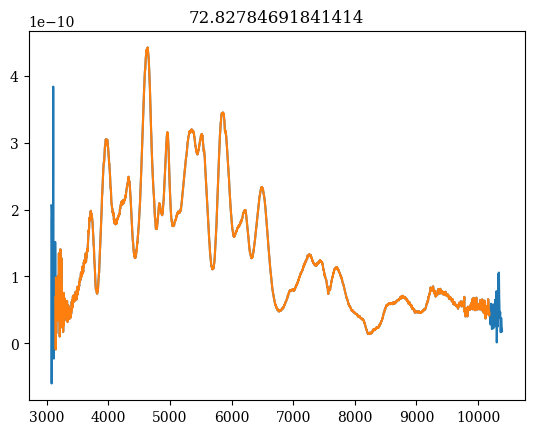

1.6674684924185683e-10
8.716591405994431e-12
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


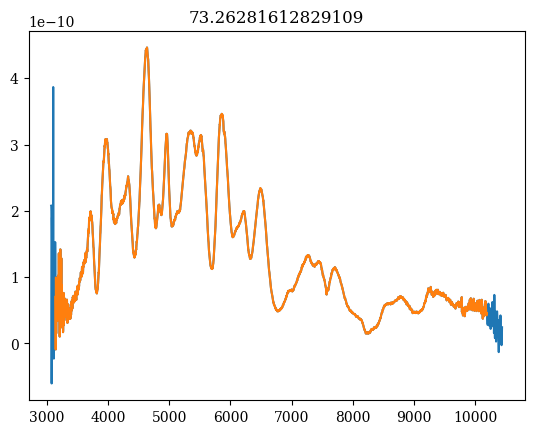

1.635433041710759e-10
8.557734395037936e-12
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


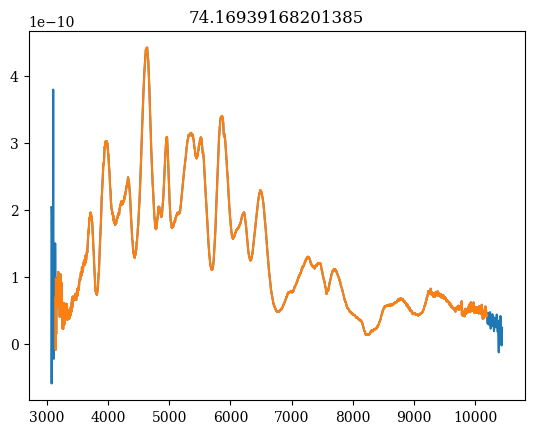

-1.3517768093884017e-11
8.413231056585888e-12
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


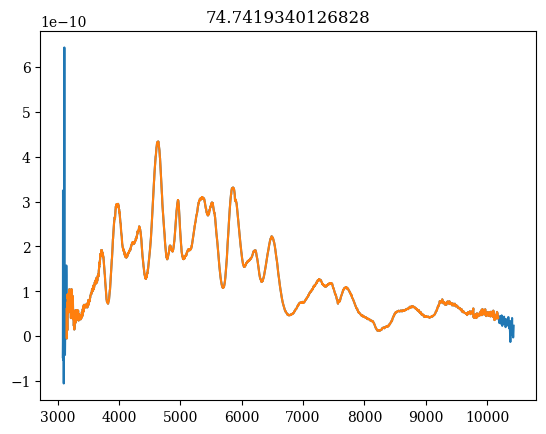

-1.3517768093884019e-11
8.417626936167873e-12
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


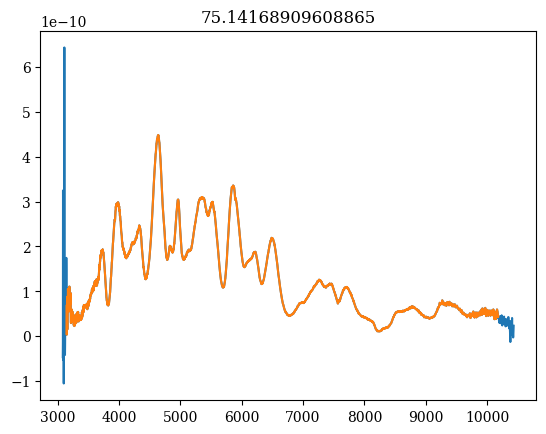

-1.2742875637775518e-11
7.936866623205733e-12
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


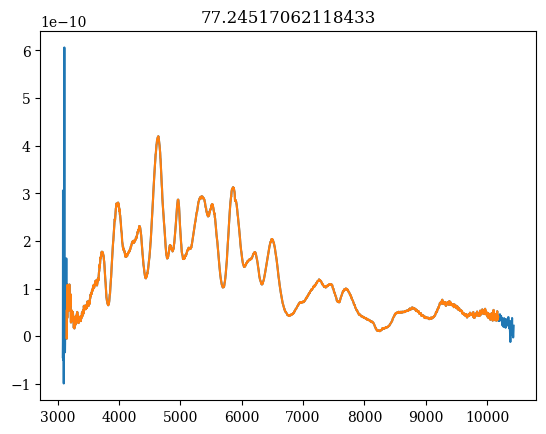

-1.2570677314195849e-11
7.828222750187615e-12
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


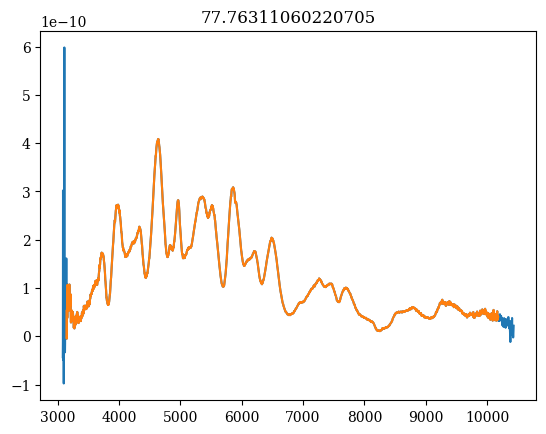

6.07408749478732e-11
8.512509806416433e-12
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


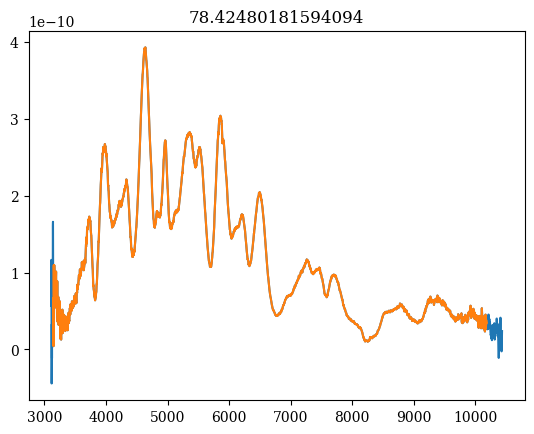

-6.029165386151721e-12
1.8004015957164283e-10
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


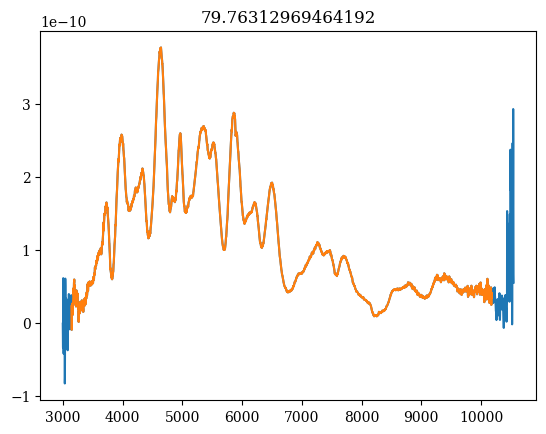

-5.857899717380191e-12
4.097540005309374e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


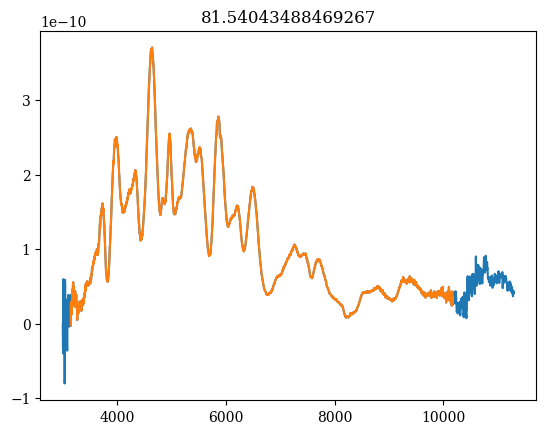

-5.522207196709443e-12
3.8596054601906604e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


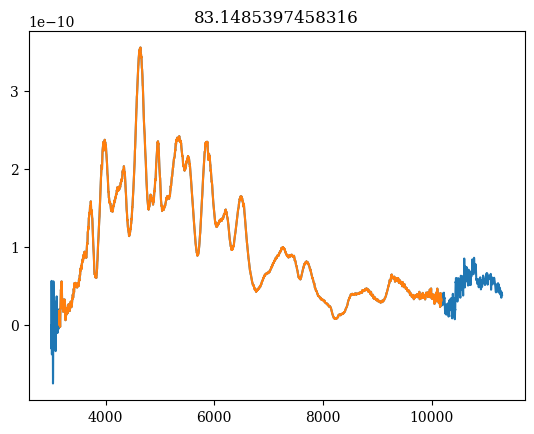

-5.546841338341286e-12
3.871274329391902e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


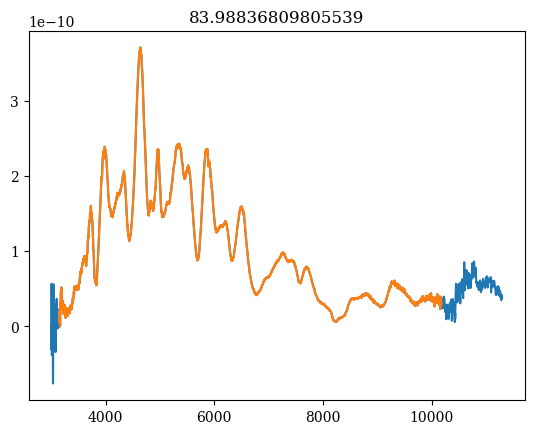

-5.515819131889998e-12
3.848582653855952e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


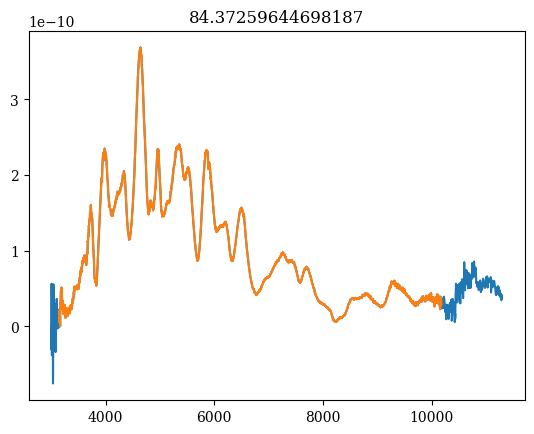

-5.4880691710626635e-12
3.826093364511477e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


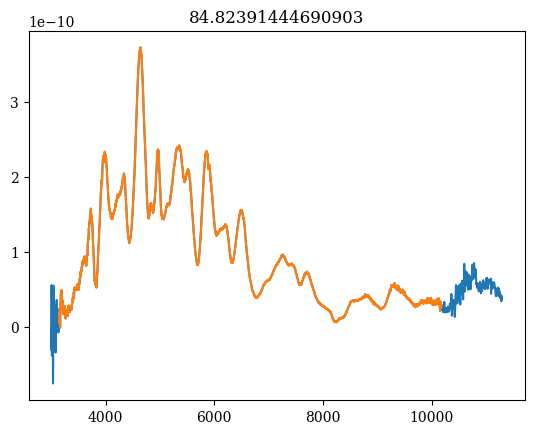

-5.363895119160199e-12
3.7314932720289764e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


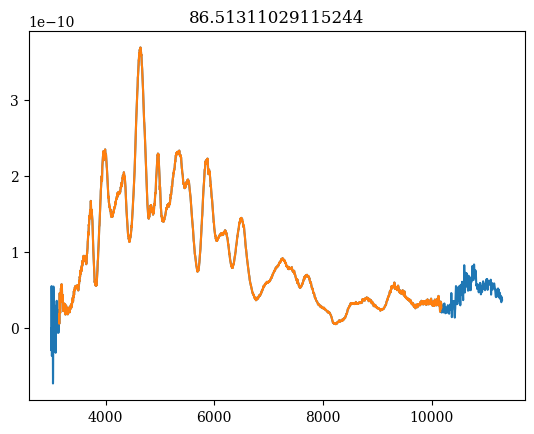

-5.3377868990528506e-12
3.711719520595496e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


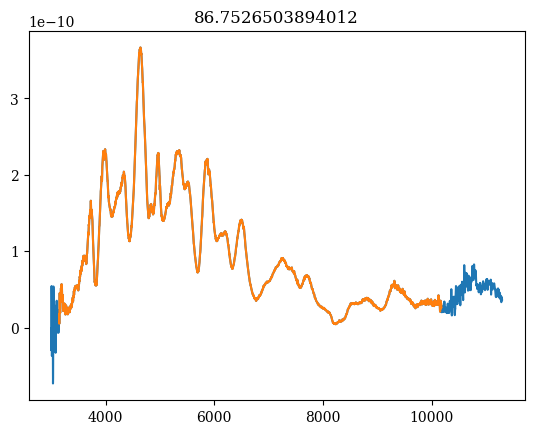

-5.258280878390213e-12
3.652630992770583e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


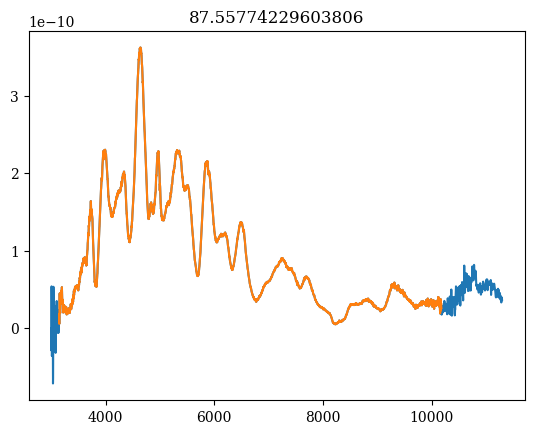

-5.236300711071199e-12
3.6367235717827994e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


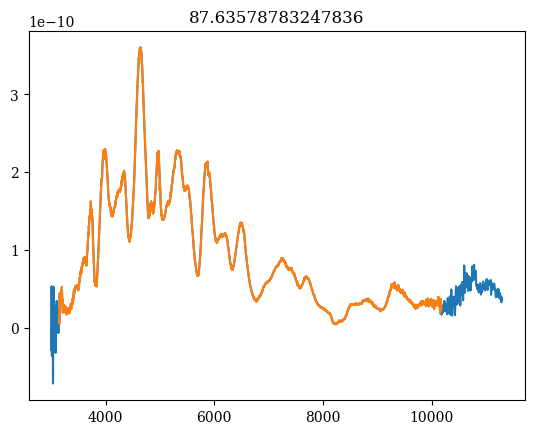

-5.187015171218995e-12
3.6041556018090614e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


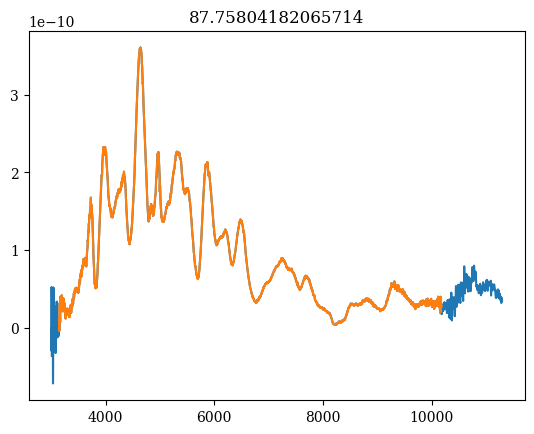

-5.089476612433511e-12
3.5333038165159603e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


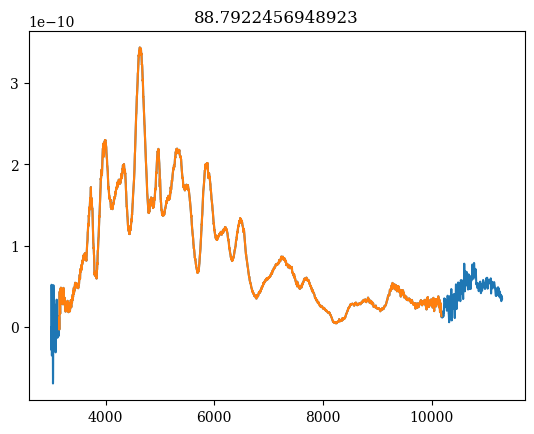

-5.09477207410502e-12
3.5362373643979753e-11
[ 3144.  3146.  3148. ... 10178. 10180. 10182.]


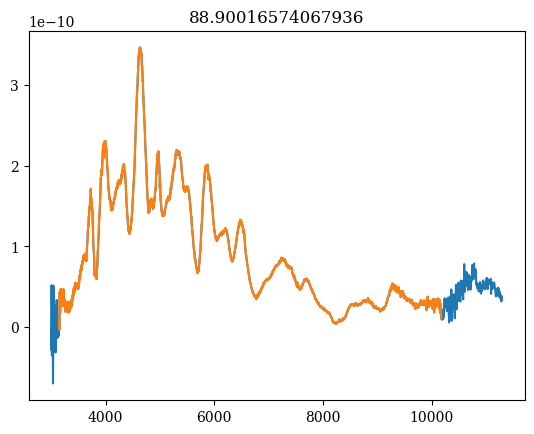

[-11.18866655  -8.48369251  -7.24239991  -6.36069086  -5.70438794
  -4.4317443   -3.41781696  -2.39544793  -1.31798562  -0.27463997
   0.61249462   1.47066292   2.26051427   3.36477412   4.34168369
   5.44192567   6.64391075   7.52208865   8.35594271   9.3992543
  10.24280906  11.39508489  12.38744994  13.40342345  14.20852809
  15.04729835  16.6009172   17.68771295  18.2394835   19.73632124
  20.47368864  21.06262931  22.67611443  23.79195592  24.66569793
  25.45879434  26.60916389  27.52364396  28.10946268  29.29947692
  30.3471389   31.51574974  32.68843343  34.86392302  36.31971889
  38.01037843  38.63720653  39.66109558  40.6260904   41.09288787
  42.19602484  42.92894079  43.9419723   44.32111252  45.25811209
  47.53987594  49.15544997  50.09551518  51.09071867  51.36256151
  52.30503499  52.70352235  54.44244394  55.83183306  56.92854375
  57.56605235  58.17611115  58.8791996   59.83000639  60.77027973
  61.31177357  62.04672347  63.36328424  69.54241628  70.33802392
  71.131239

In [53]:
spec_arr_new = []
minwaves = []
maxwaves = []
for spec in calibrated_spec_array_lowv:
    minwaves.append(spec.wavelength[spec.x1])
    maxwaves.append(spec.wavelength[spec.x2])
wrange = [np.amax(minwaves), np.amin(maxwaves)]
print (wrange)

for spec in calibrated_spec_array_lowv:
    spec_arr_new.append(spec)
specnew, phases, waves = fc.prepare_spec(spec_arr_new,waverange=wrange,plot=True)
print (phases)
print (waves)

In [54]:
X2_lowv, Y2_lowv, Z2_lowv = fc.linear_interpolation(specnew, waves, phases)

(3520,)
(97,)
(97, 3520)


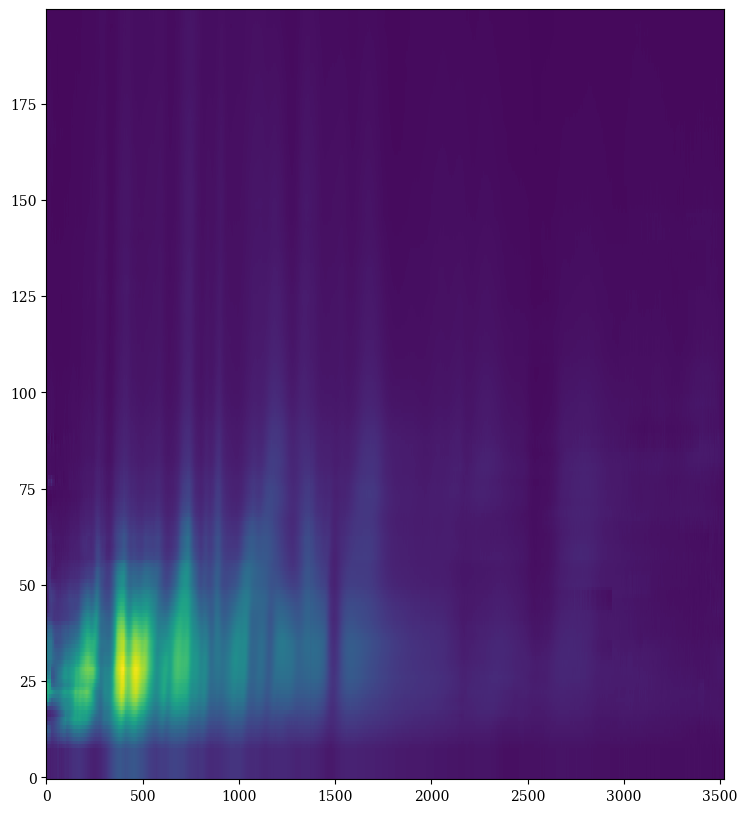

In [55]:
plt.figure(figsize=[10,10])
plt.imshow(Z2_lowv,aspect=20, origin='lower', interpolation='none')
plt.show()

-15.0


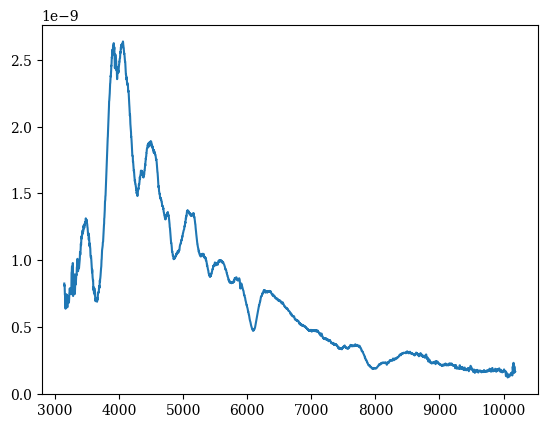

-14.472361809045227


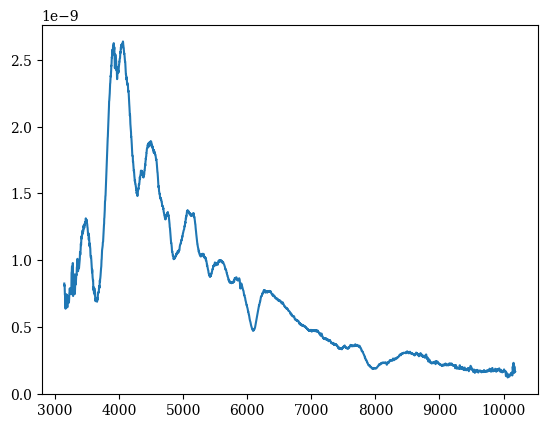

-13.944723618090453


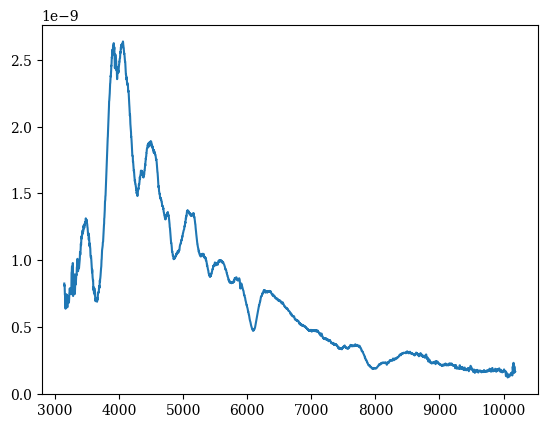

-13.417085427135678


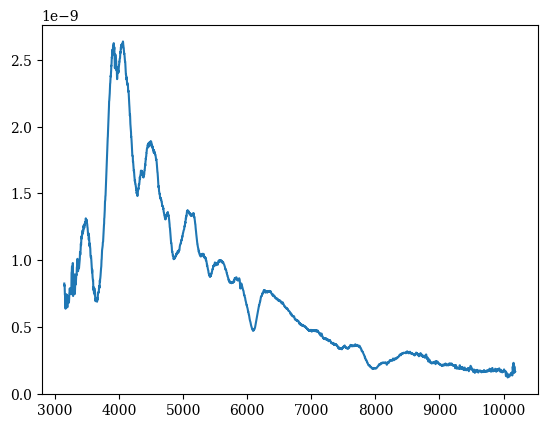

-12.889447236180905


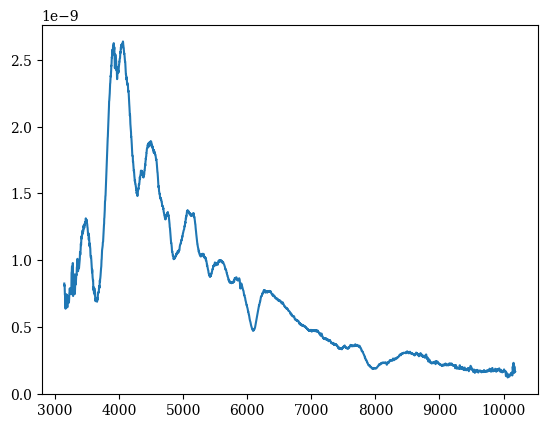

-12.361809045226131


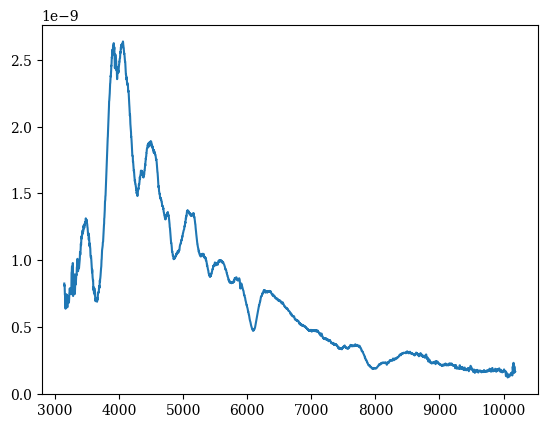

-11.834170854271356


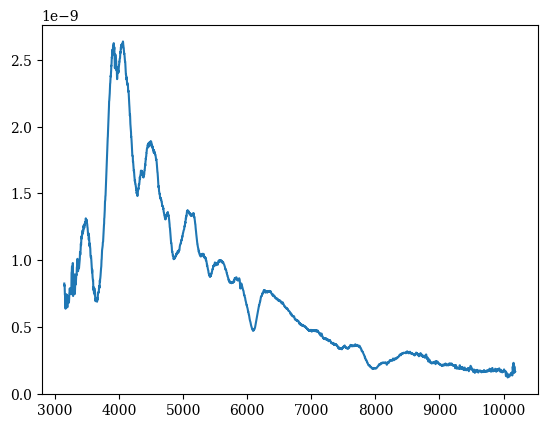

-11.306532663316583


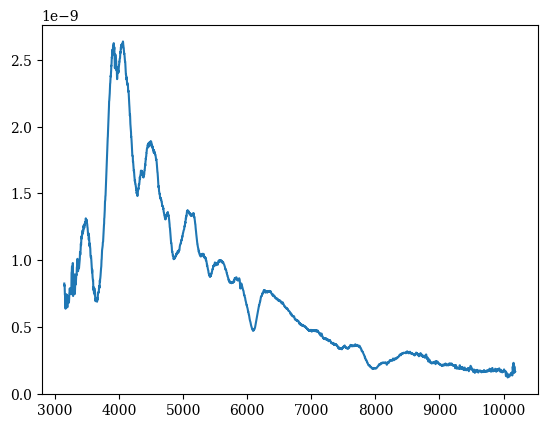

-10.77889447236181


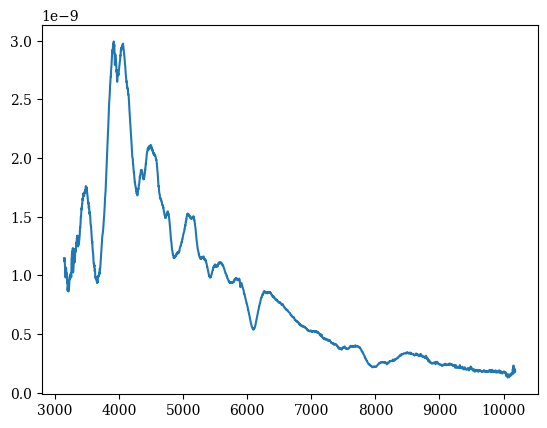

-10.251256281407036


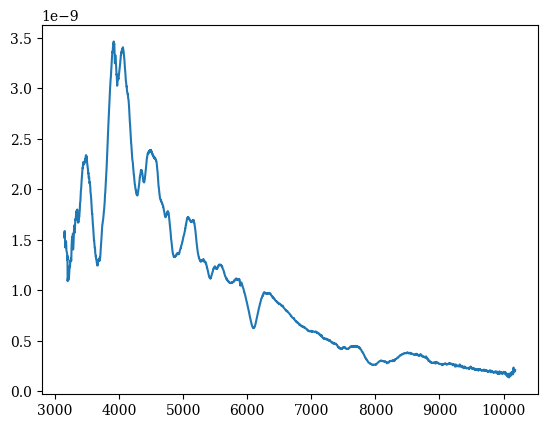

-9.723618090452263


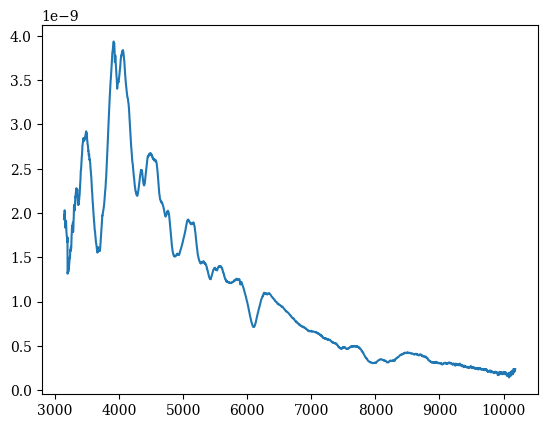

-9.195979899497488


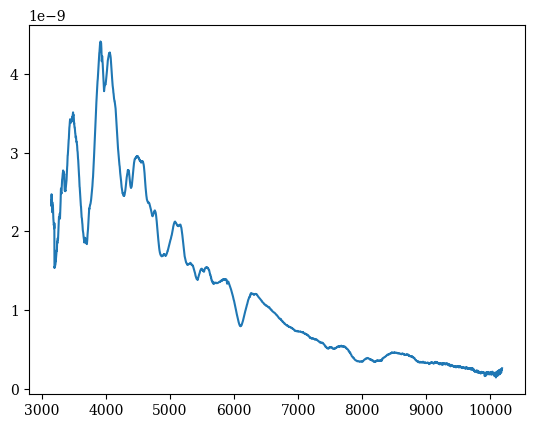

-8.668341708542714


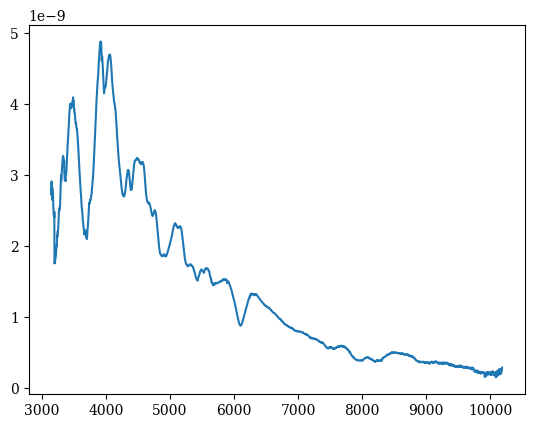

-8.14070351758794


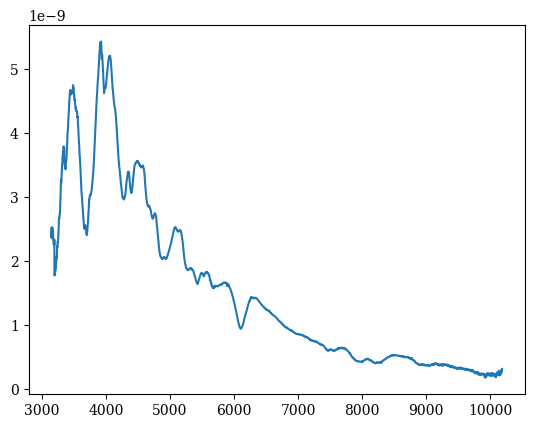

-7.6130653266331665


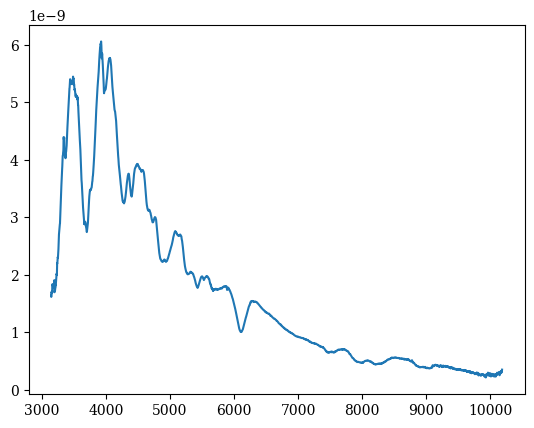

-7.085427135678392


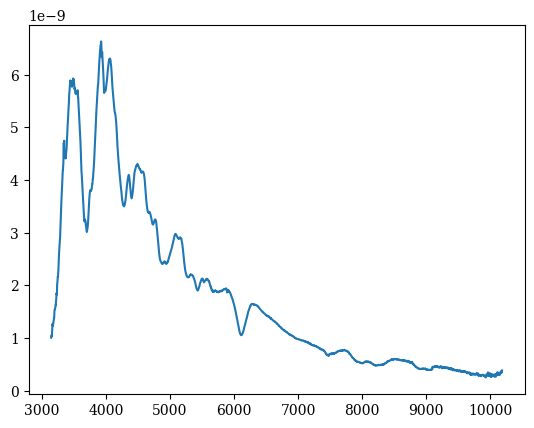

-6.557788944723619


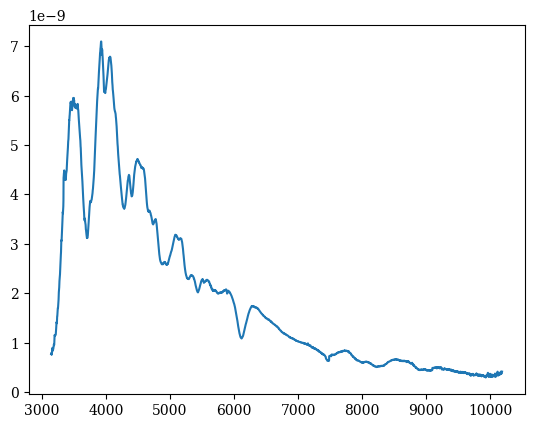

-6.0301507537688455


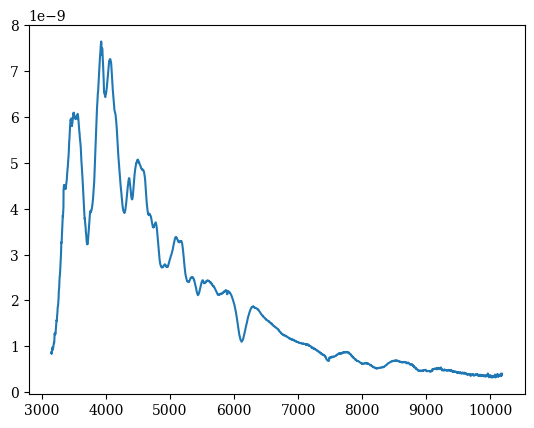

-5.502512562814072


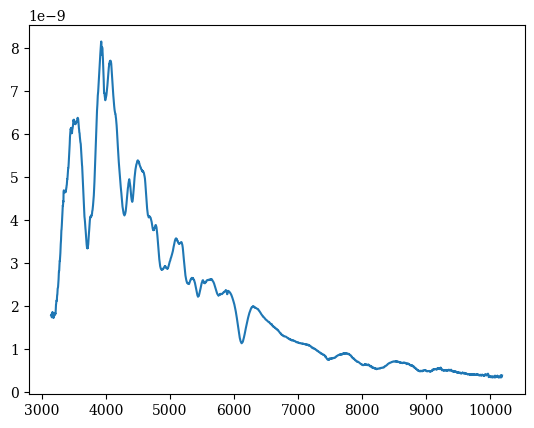

-4.974874371859297


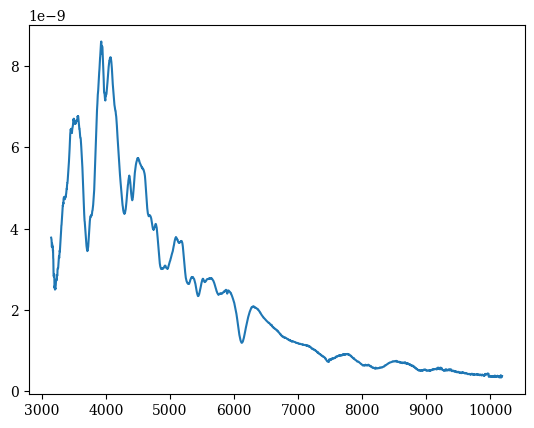

-4.4472361809045236


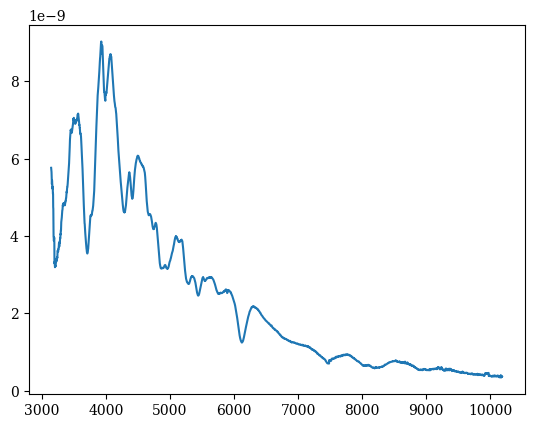

-3.91959798994975


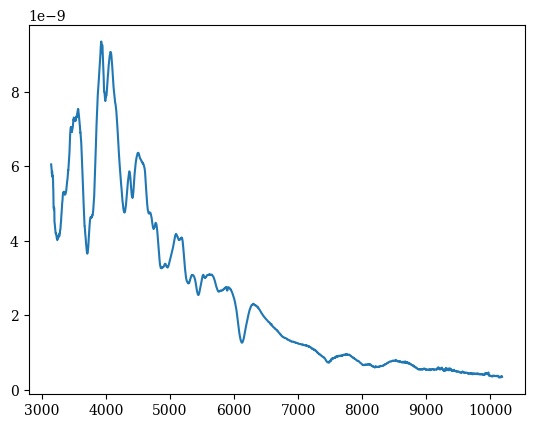

-3.391959798994975


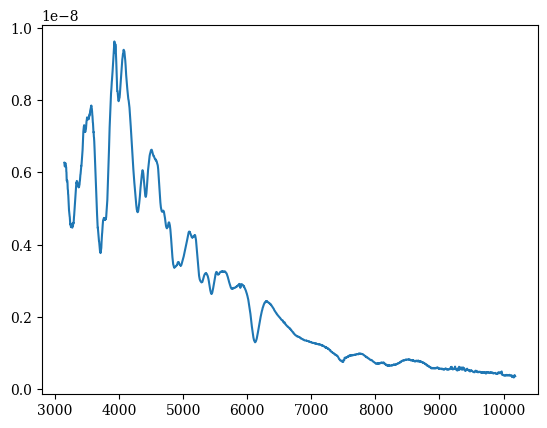

-2.8643216080402016


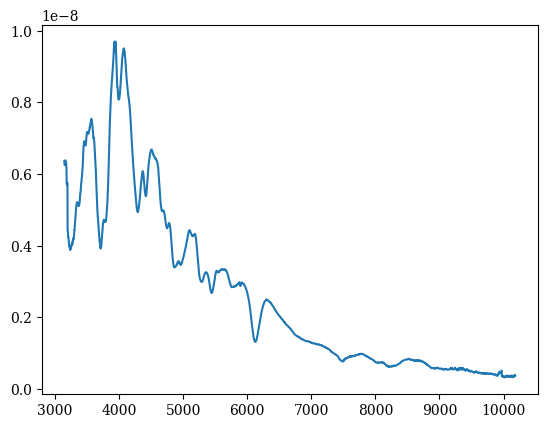

-2.3366834170854283


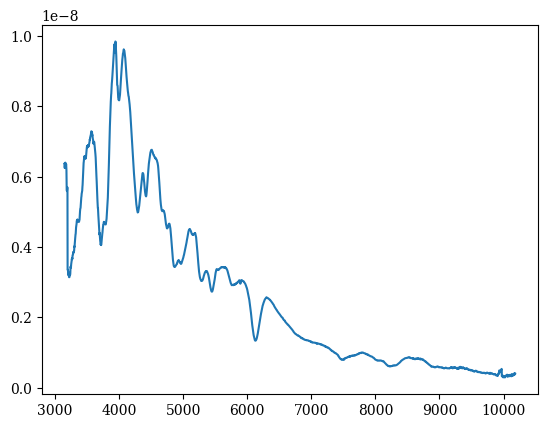

-1.8090452261306549


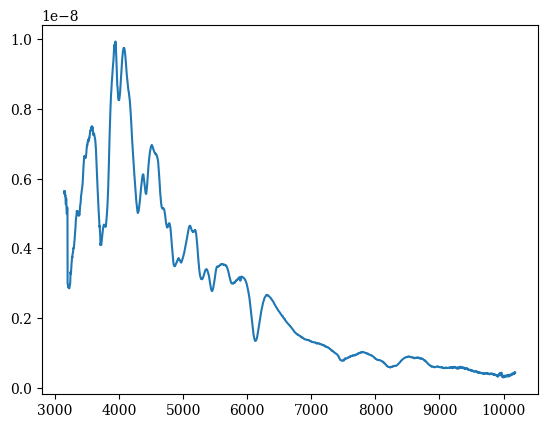

-1.2814070351758815


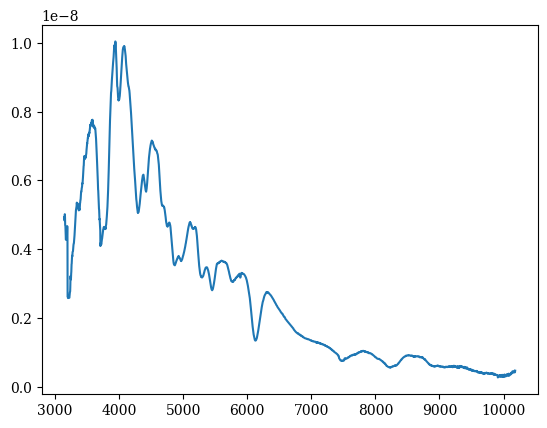

-0.7537688442211063


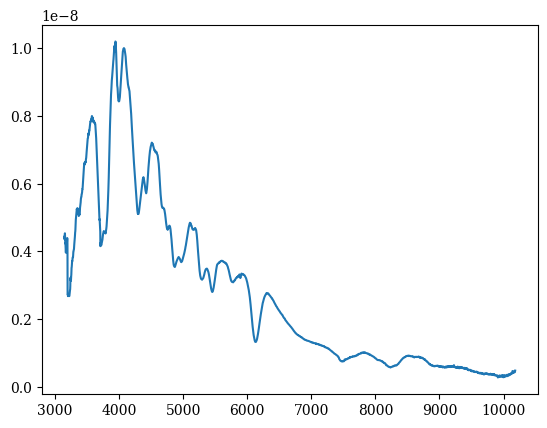

-0.22613065326633297


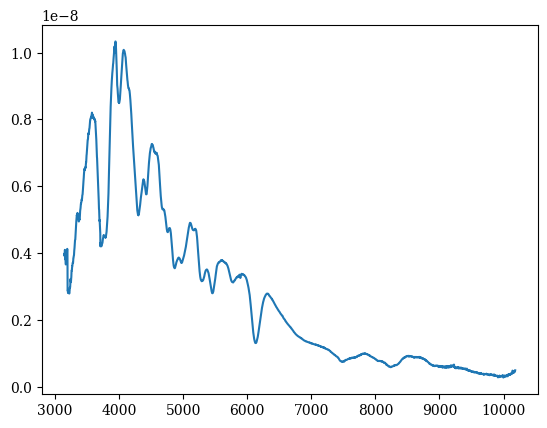

0.3015075376884404


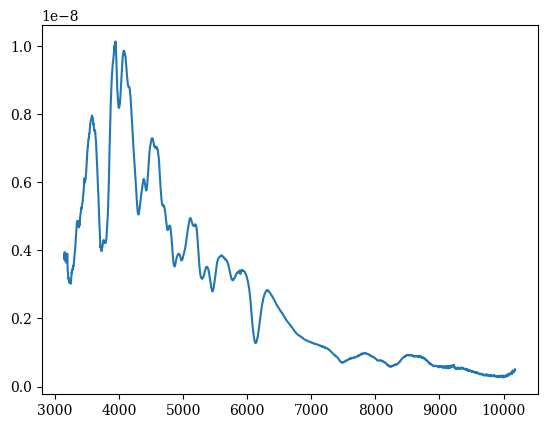

0.8291457286432156


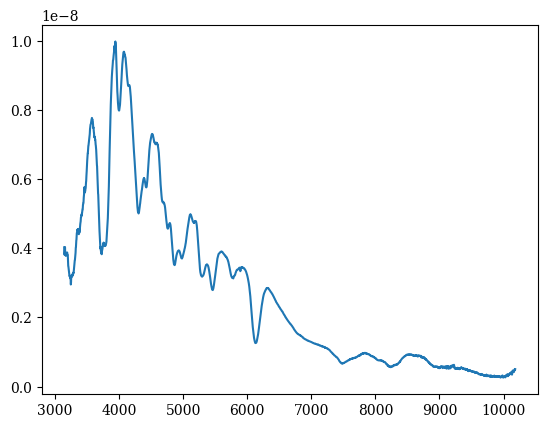

1.3567839195979872


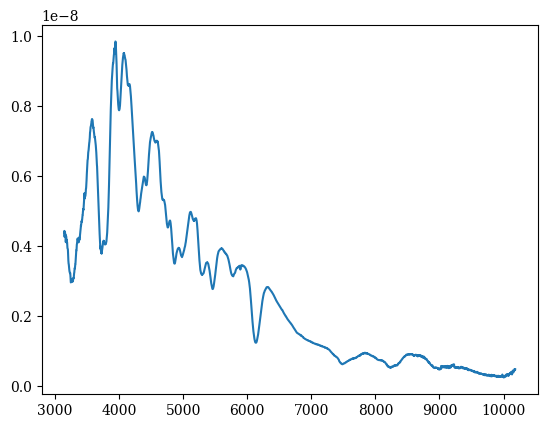

1.8844221105527623


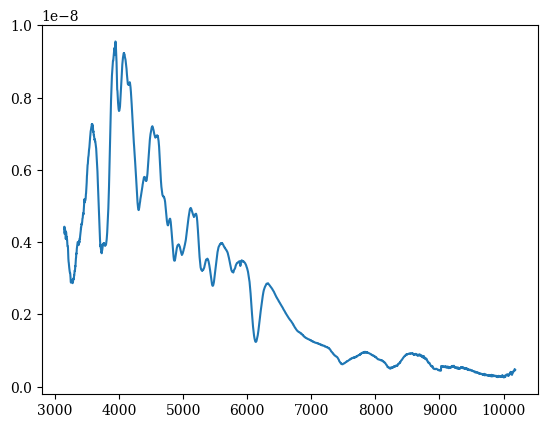

2.4120603015075375


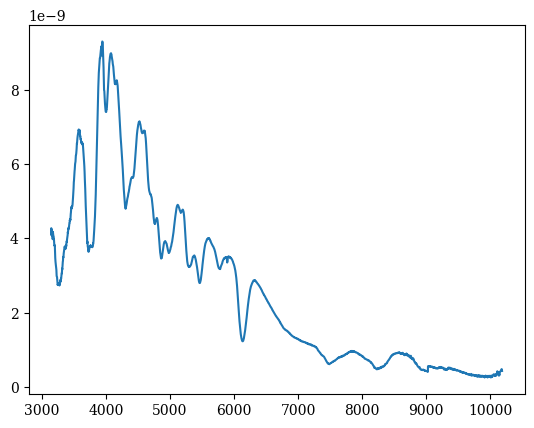

2.939698492462309


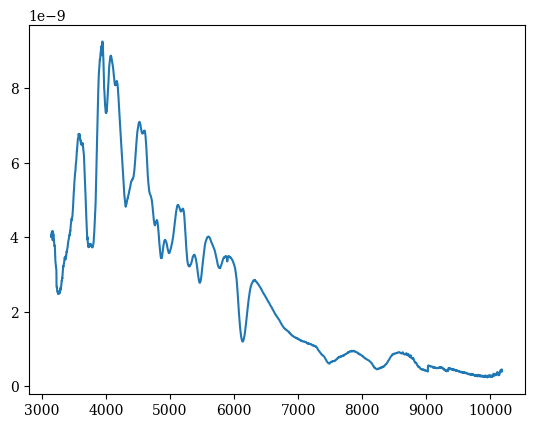

3.4673366834170842


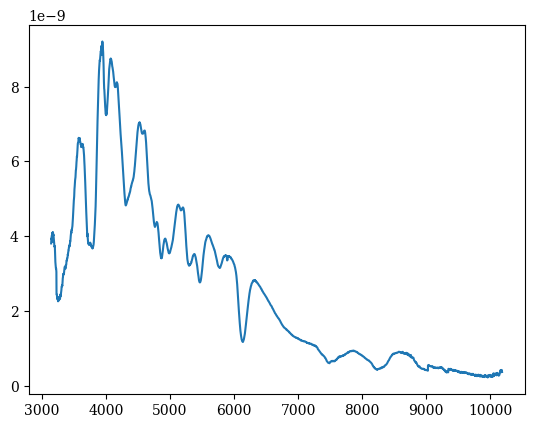

3.994974874371856


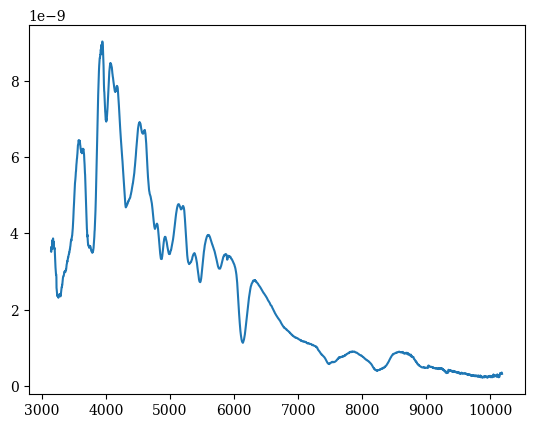

4.522613065326631


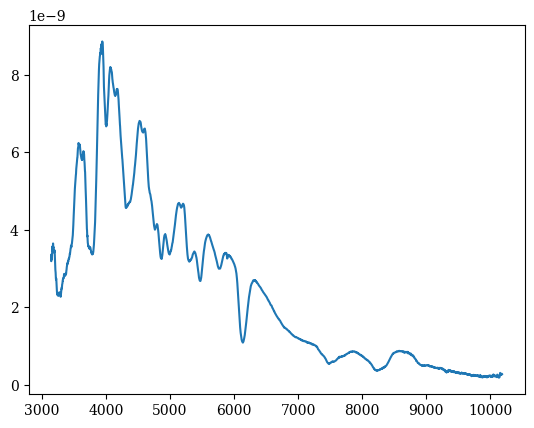

5.050251256281406


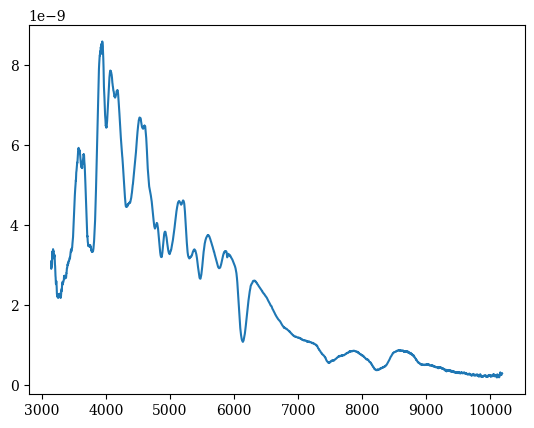

5.577889447236178


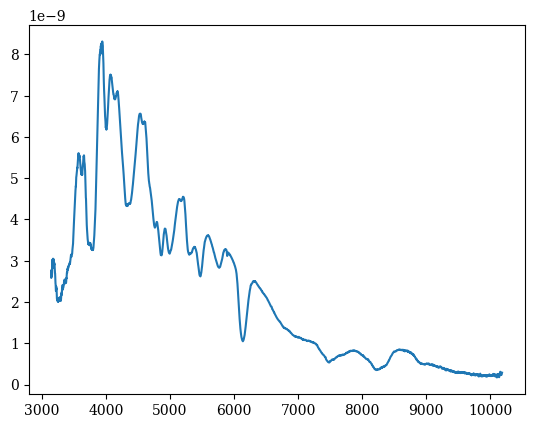

6.105527638190953


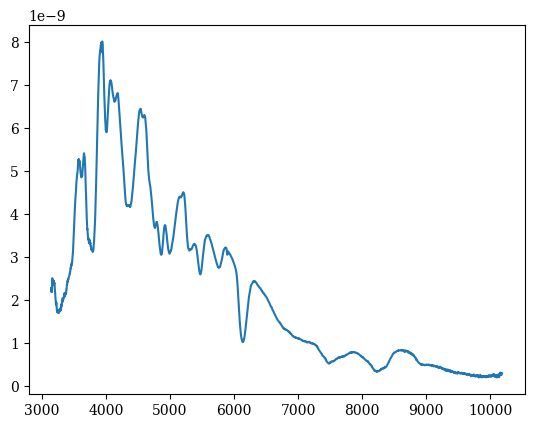

6.633165829145728


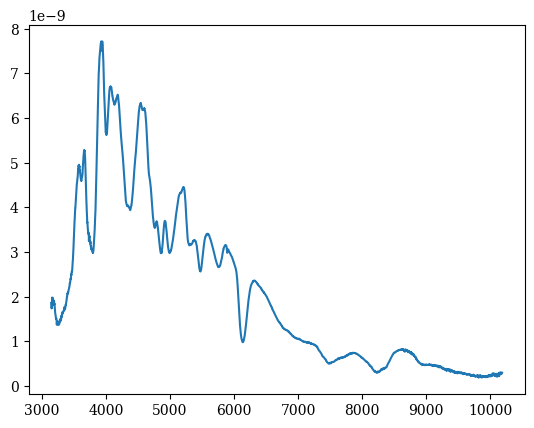

7.1608040201005


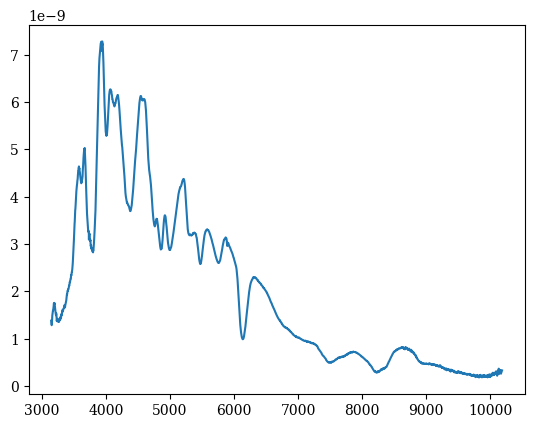

7.688442211055275


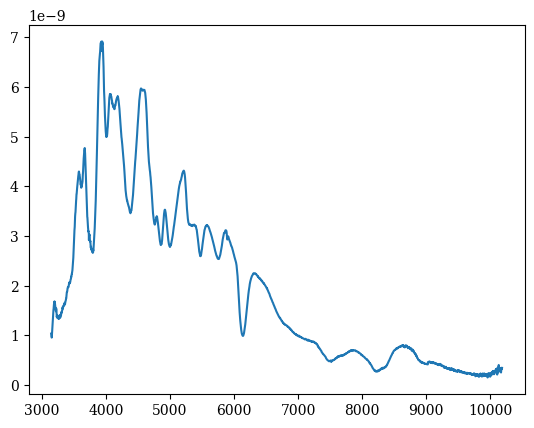

8.21608040201005


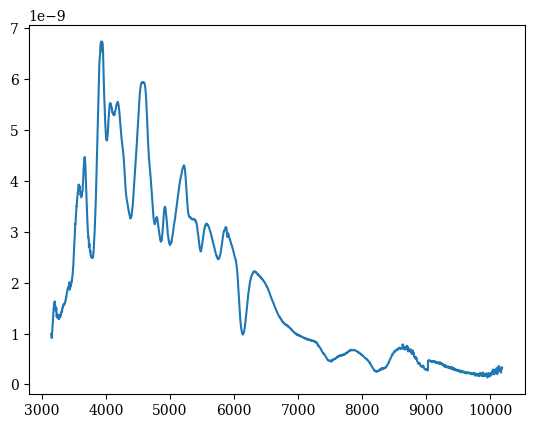

8.743718592964822


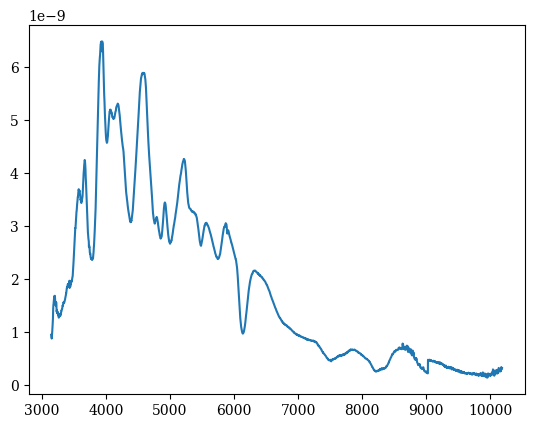

9.271356783919597


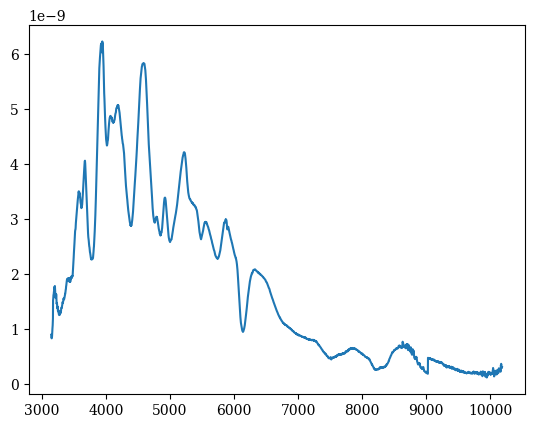

9.798994974874368


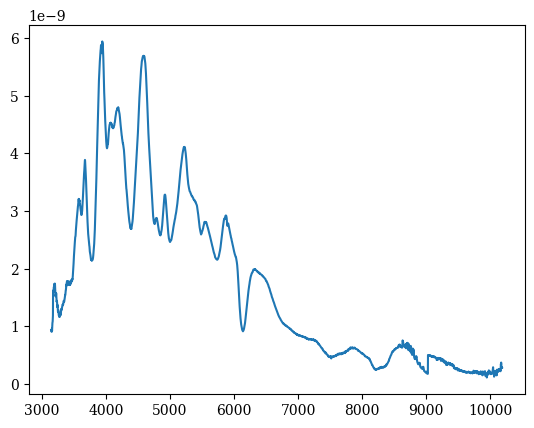

10.326633165829143


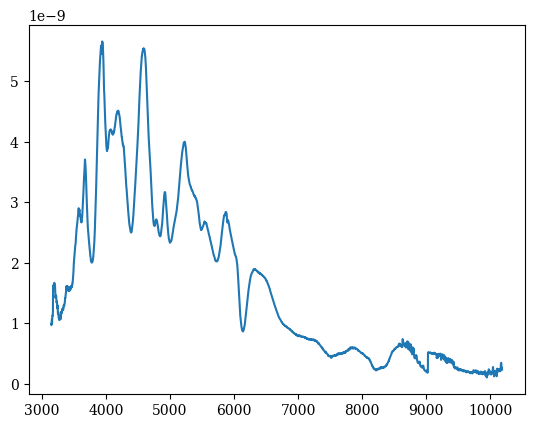

10.854271356783919


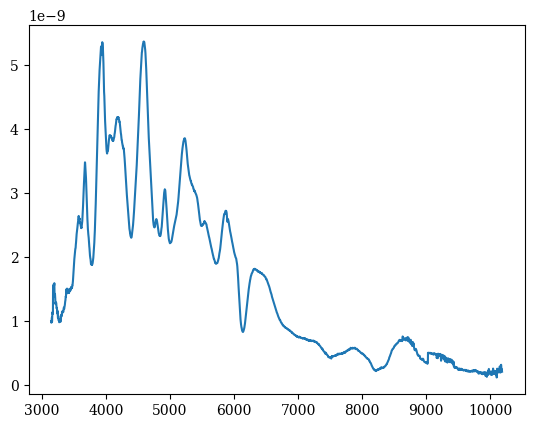

11.38190954773869


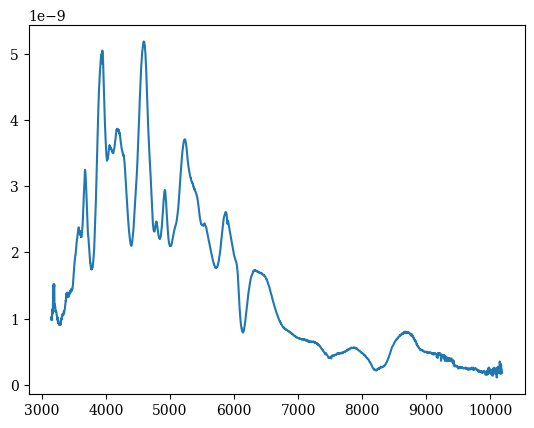

11.909547738693465


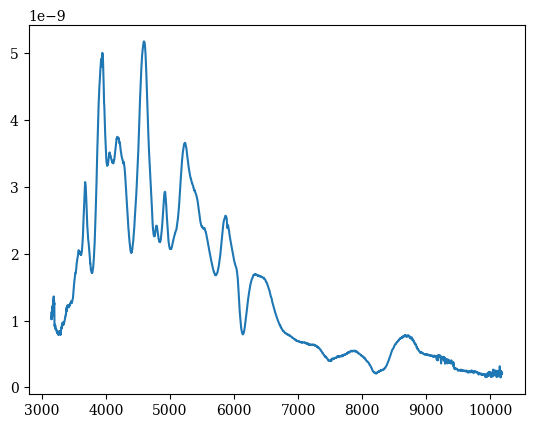

12.437185929648237


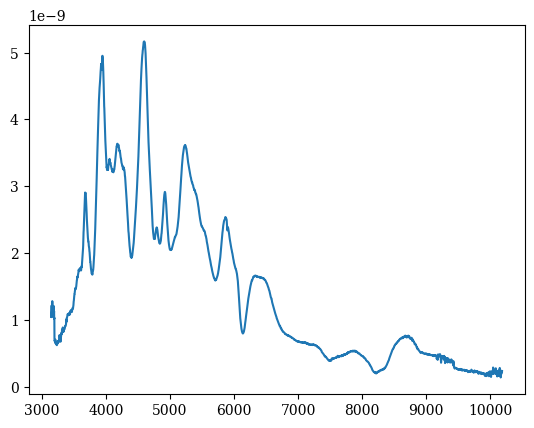

12.964824120603012


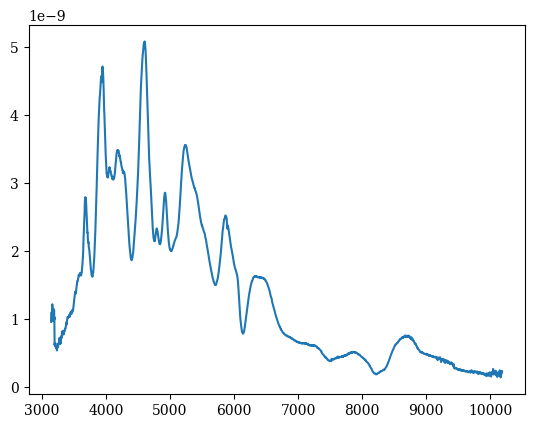

13.492462311557787


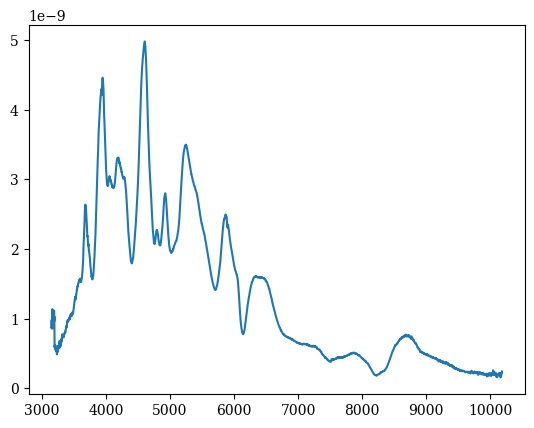

14.020100502512559


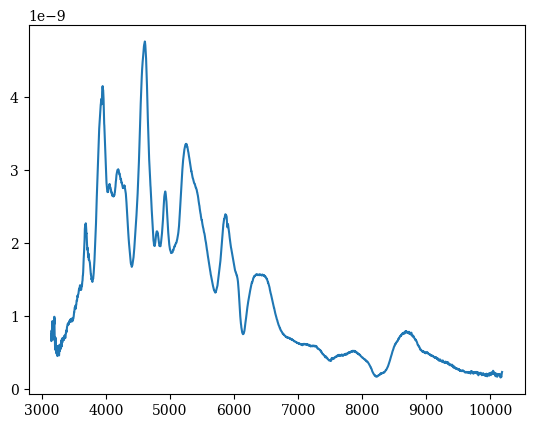

14.547738693467334


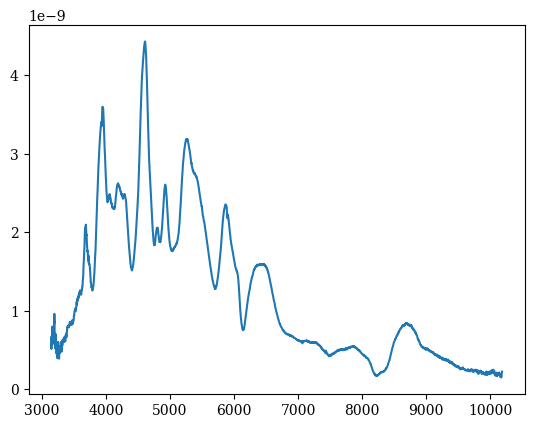

15.07537688442211


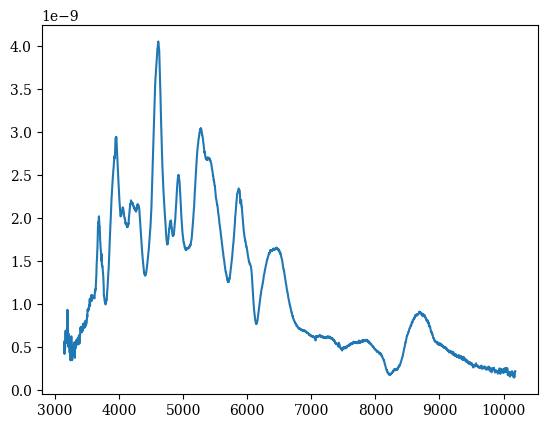

15.60301507537688


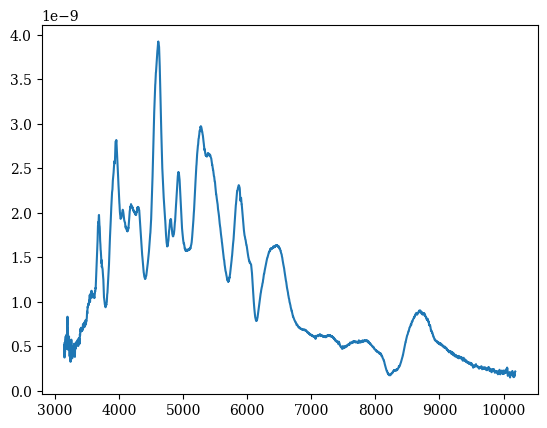

16.130653266331656


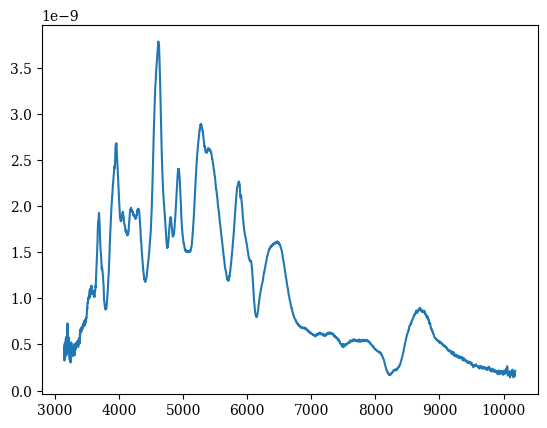

16.65829145728643


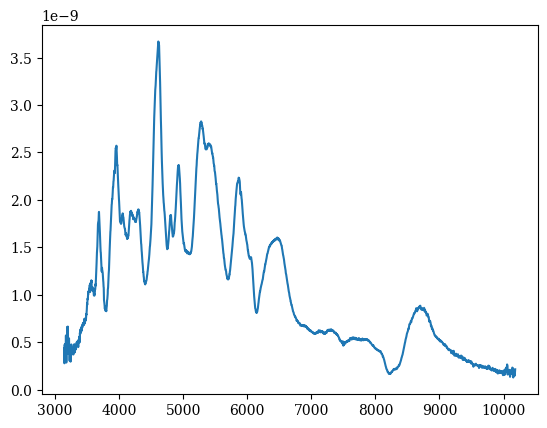

17.185929648241206


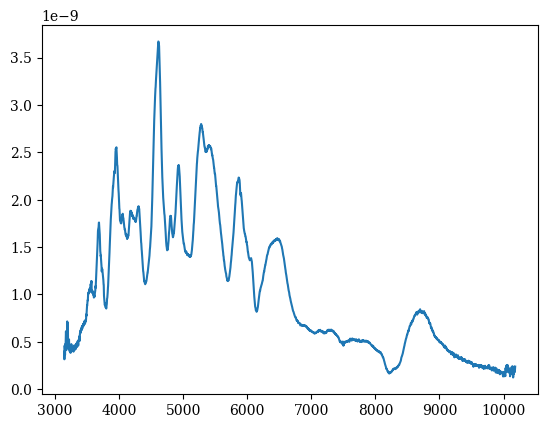

17.713567839195974


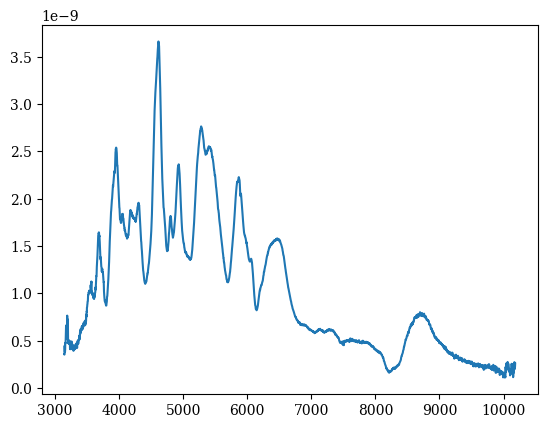

18.24120603015075


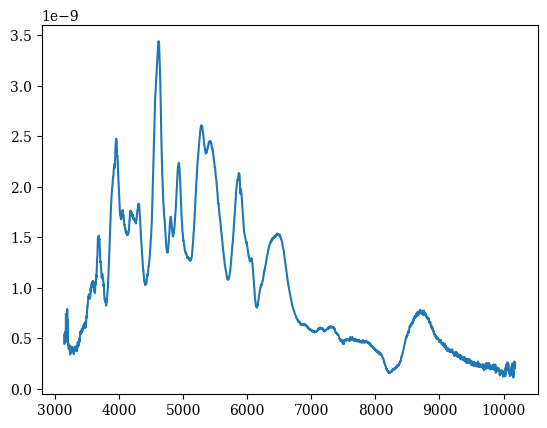

18.768844221105525


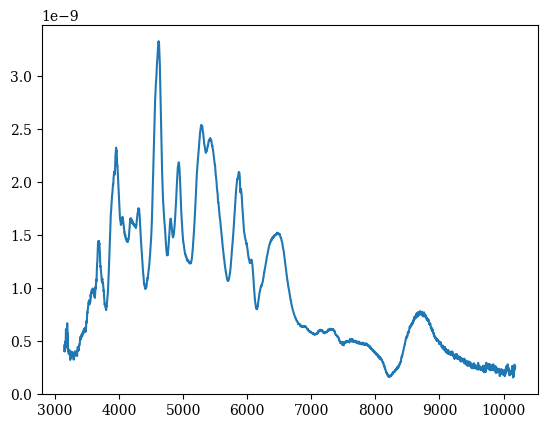

19.2964824120603


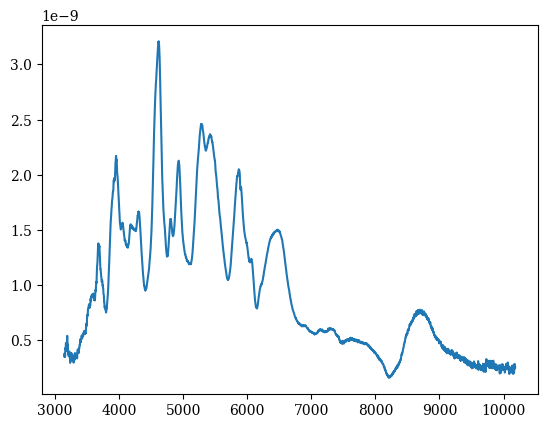

19.824120603015075


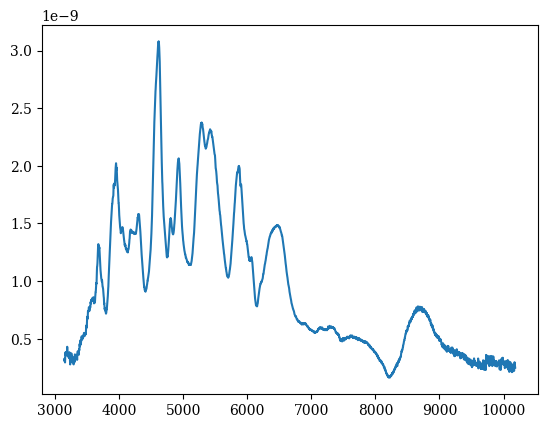

20.351758793969843


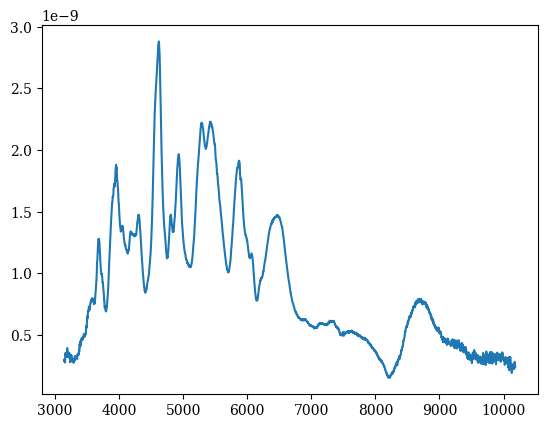

20.879396984924618


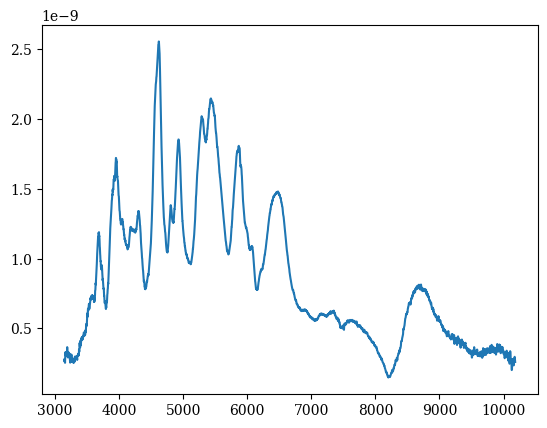

21.407035175879393


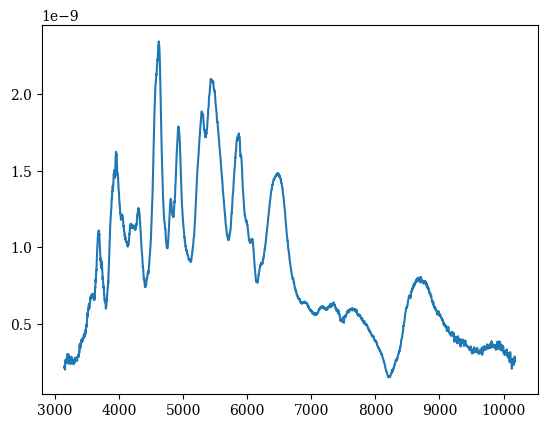

21.93467336683417


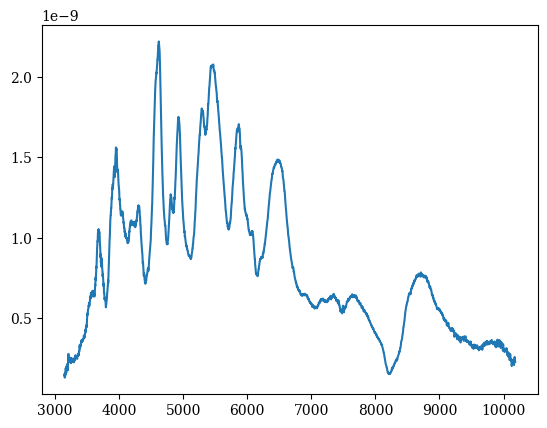

22.462311557788944


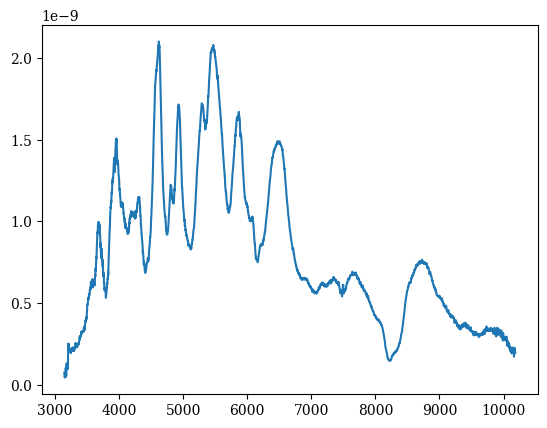

22.98994974874371


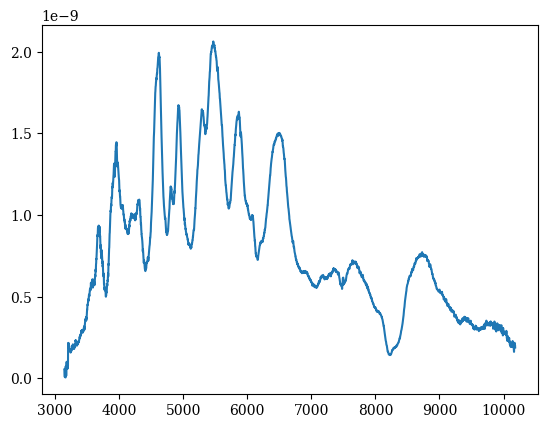

23.517587939698487


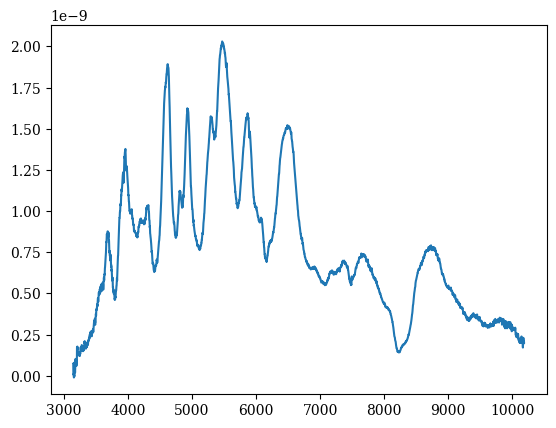

24.045226130653262


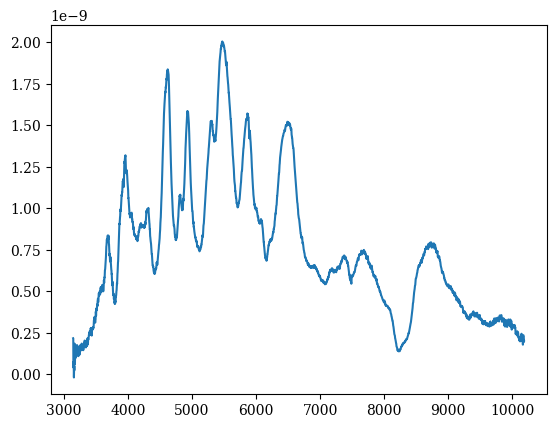

24.572864321608037


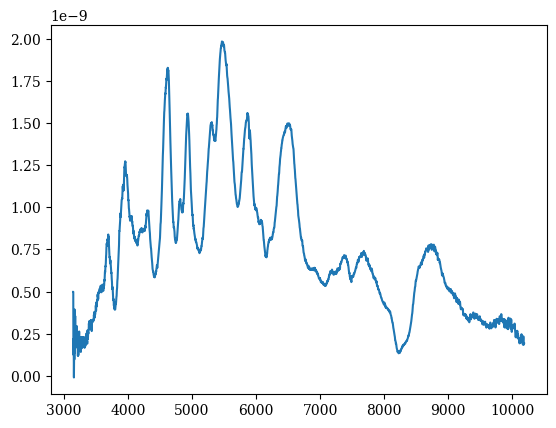

25.100502512562812


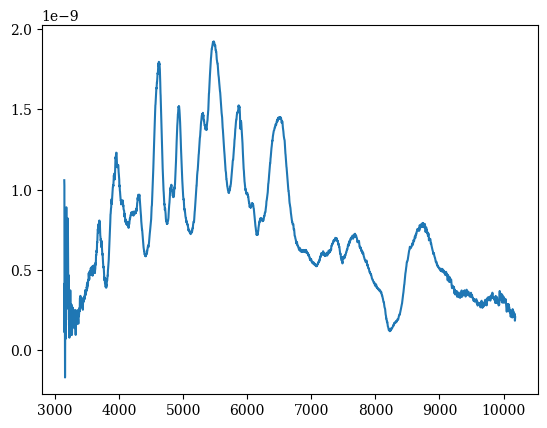

25.628140703517587


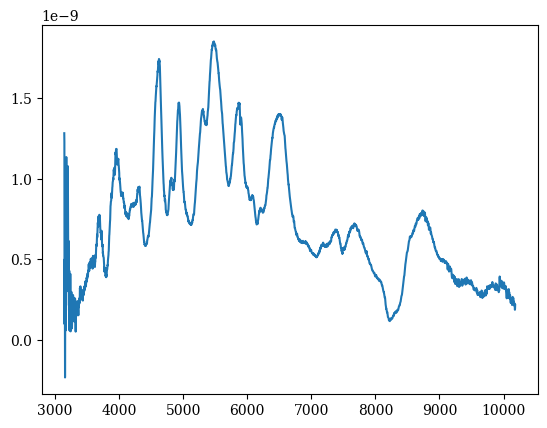

26.155778894472355


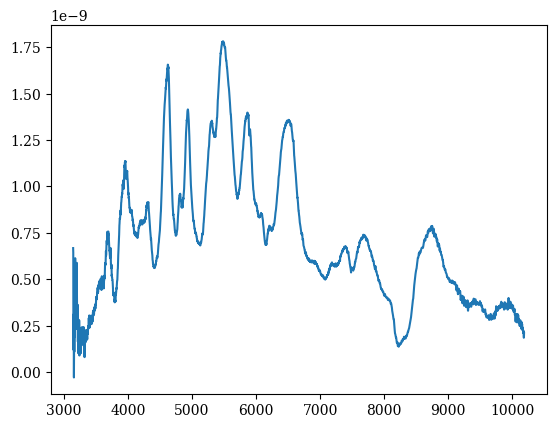

26.68341708542713


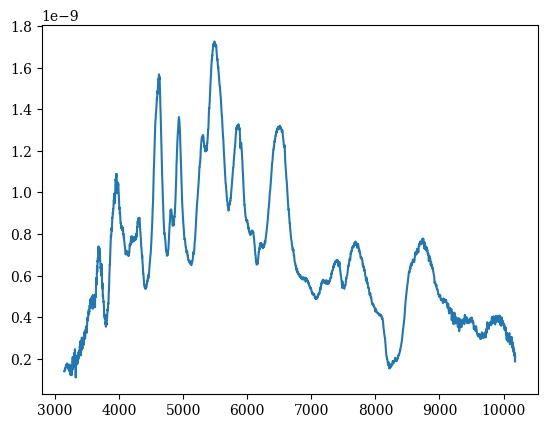

27.211055276381906


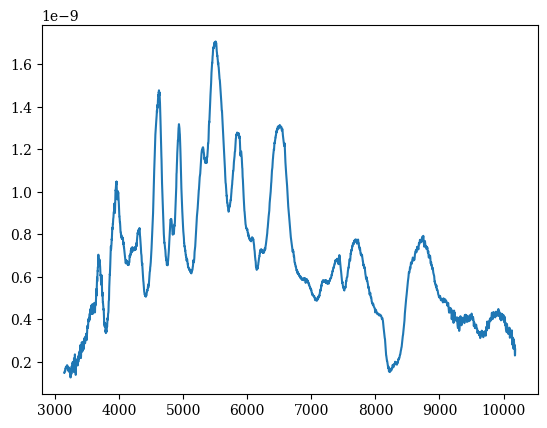

27.73869346733668


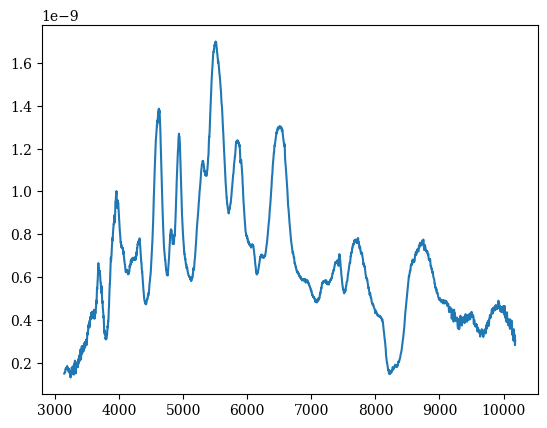

28.266331658291456


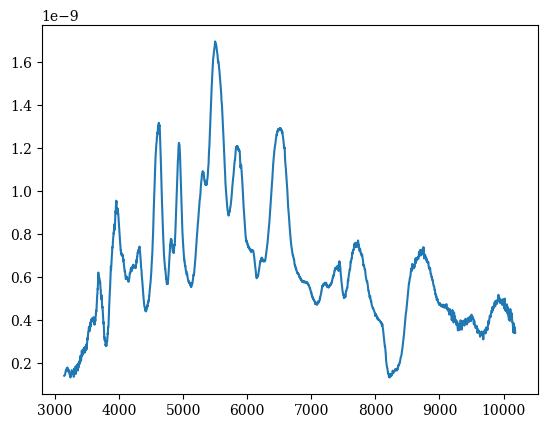

28.793969849246224


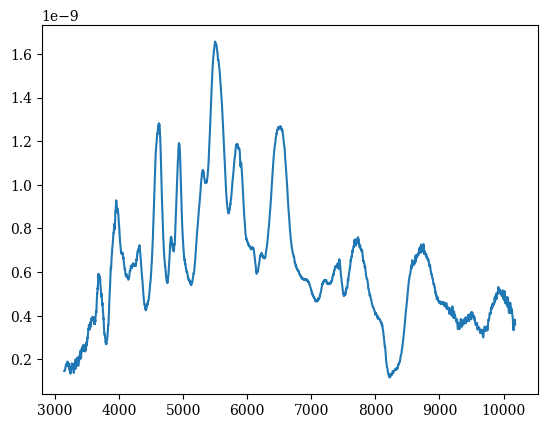

29.321608040201


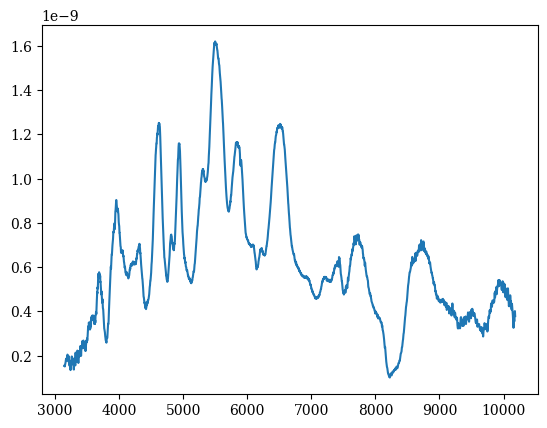

29.849246231155774


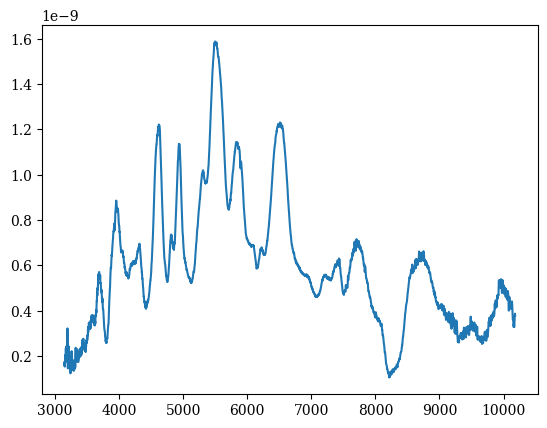

30.37688442211055


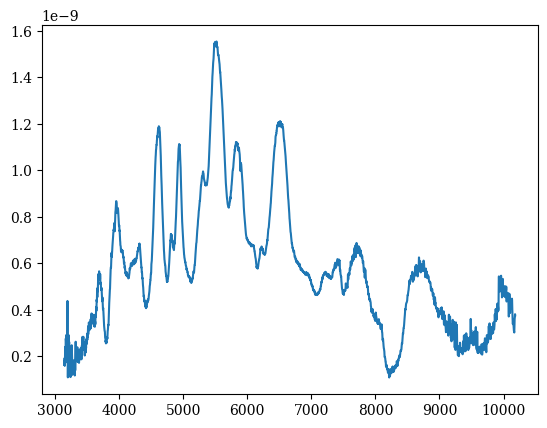

30.904522613065325


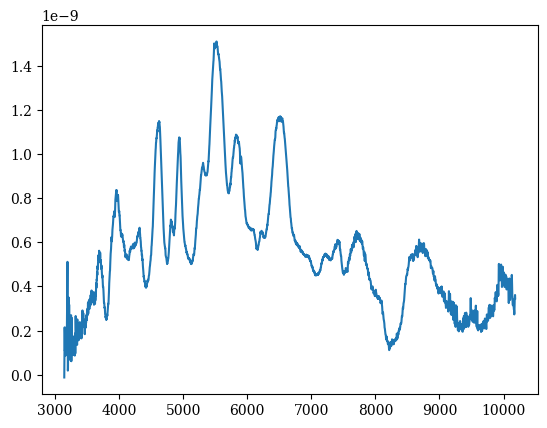

31.4321608040201


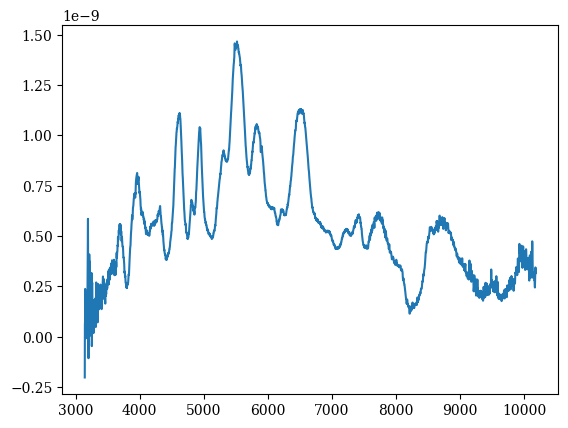

31.959798994974868


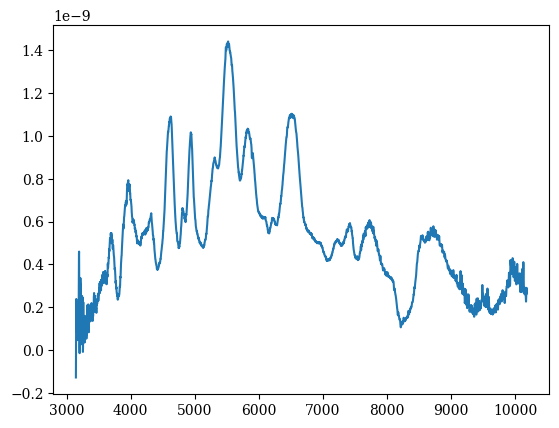

32.48743718592964


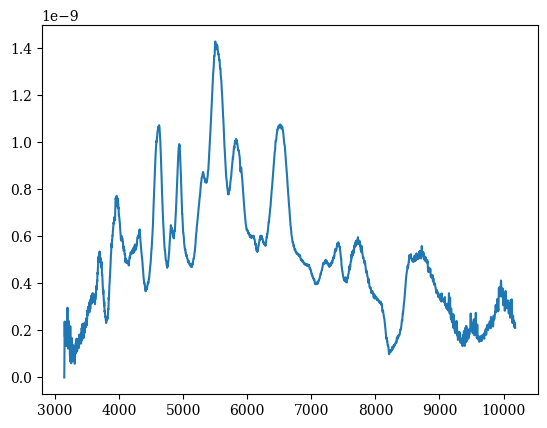

33.01507537688442


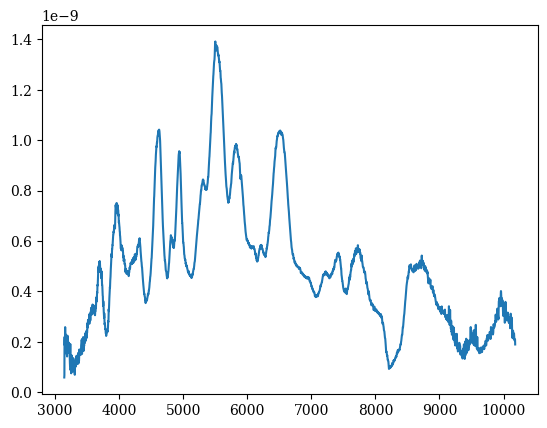

33.54271356783919


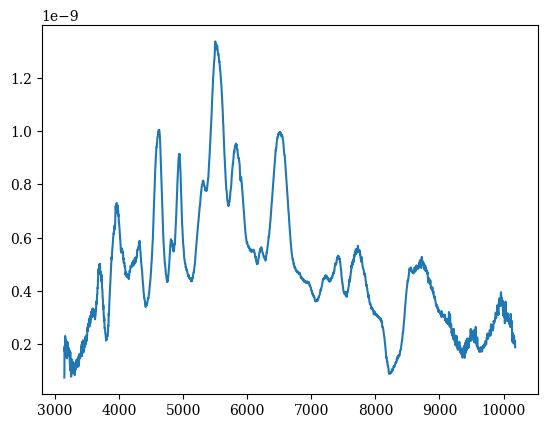

34.07035175879397


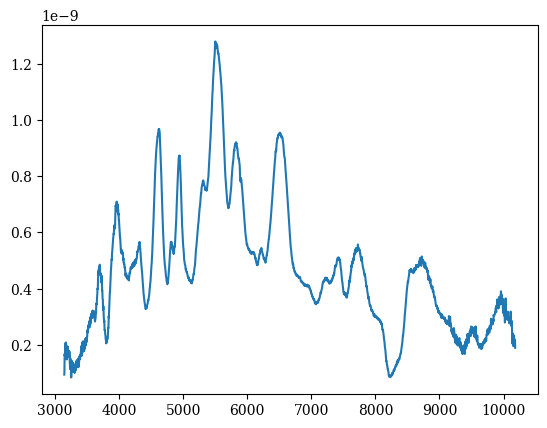

34.59798994974874


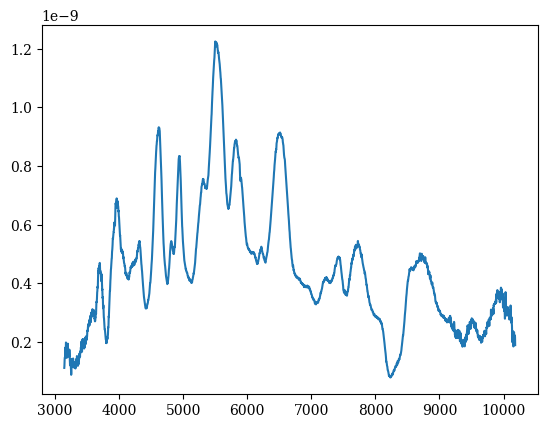

35.12562814070351


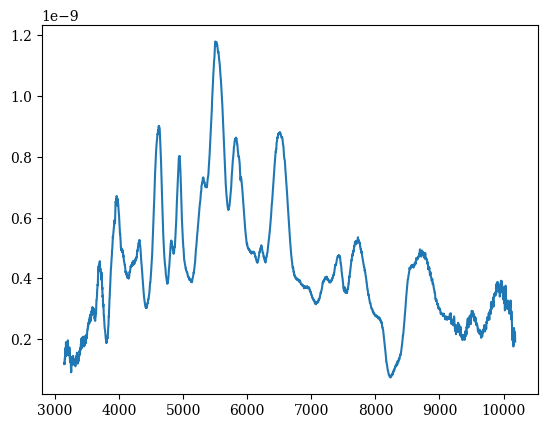

35.65326633165829


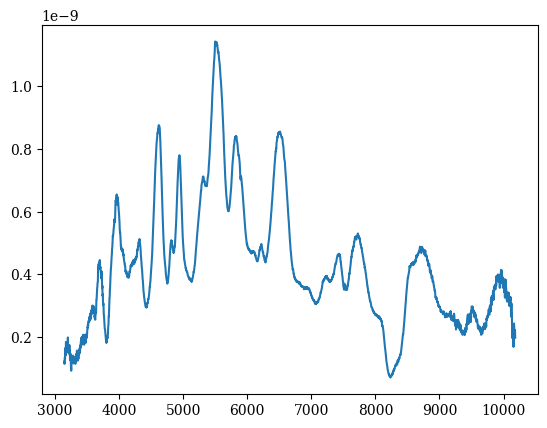

36.18090452261306


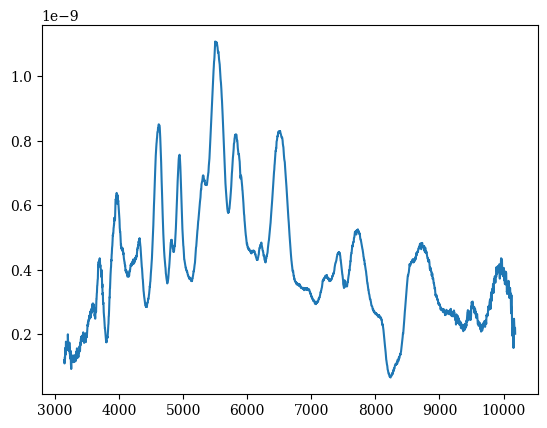

36.70854271356784


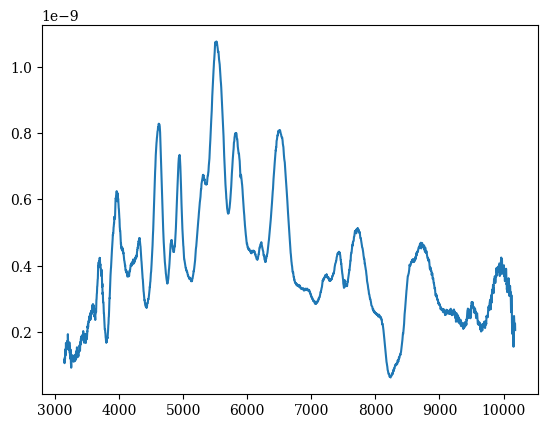

37.236180904522605


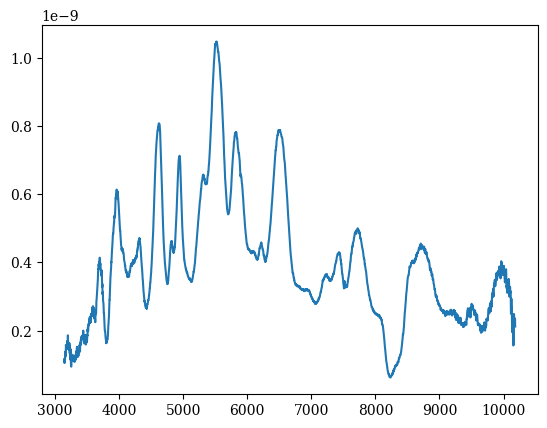

37.76381909547738


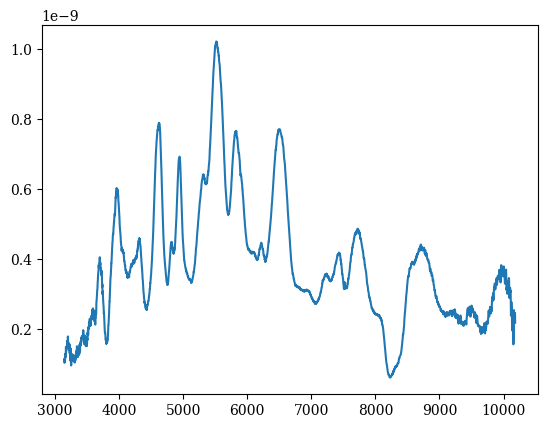

38.291457286432156


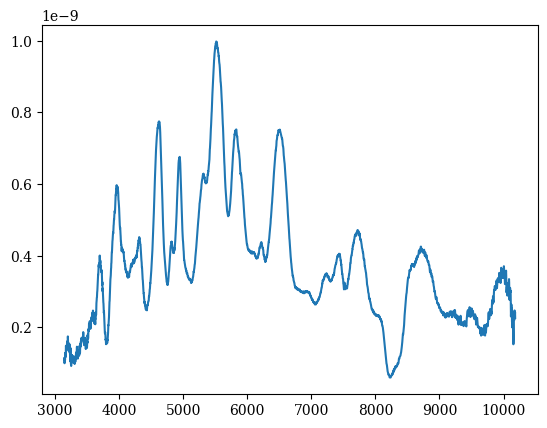

38.81909547738693


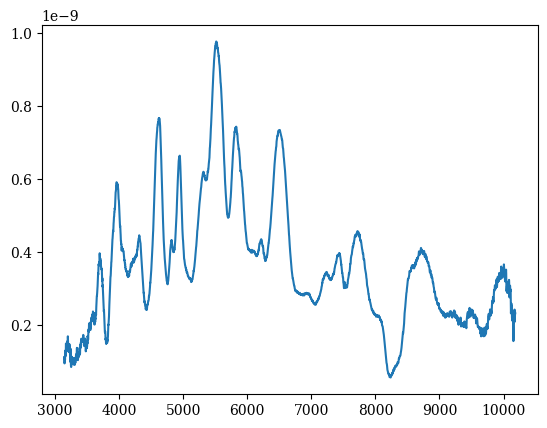

39.346733668341706


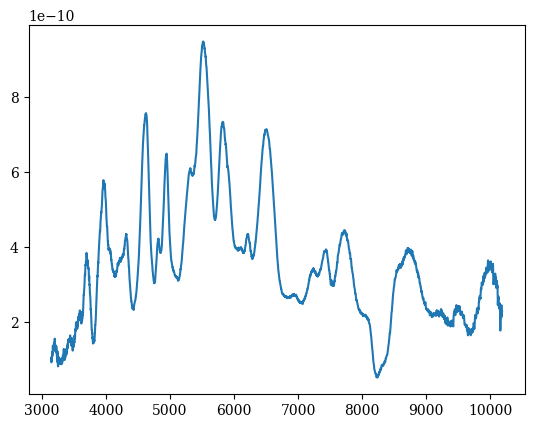

39.874371859296474


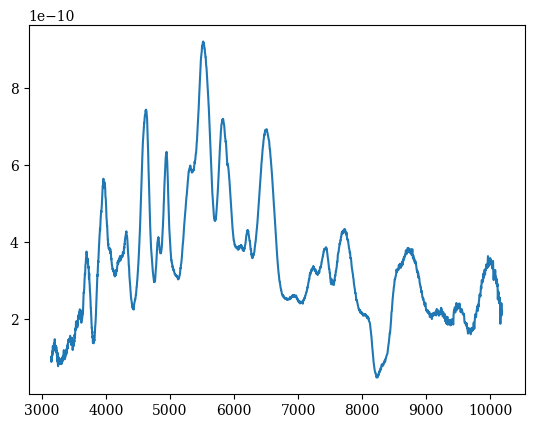

40.40201005025125


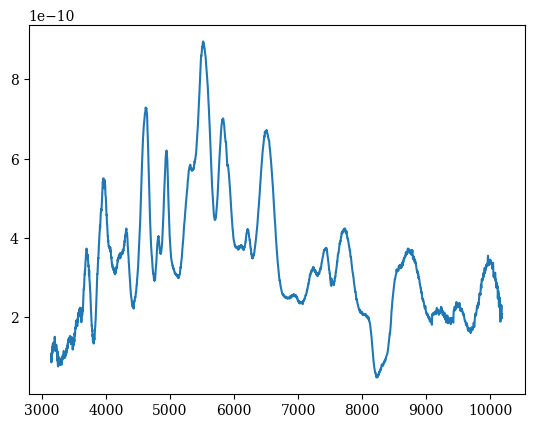

40.929648241206024


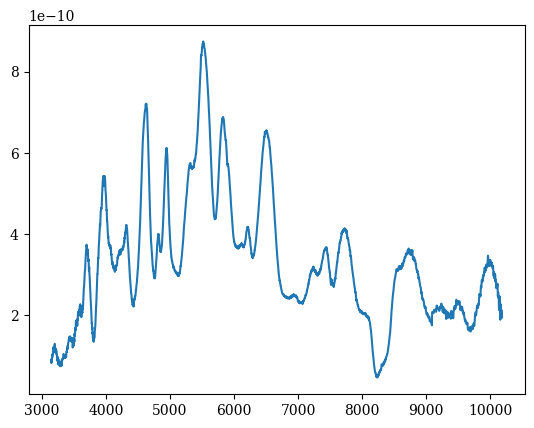

41.4572864321608


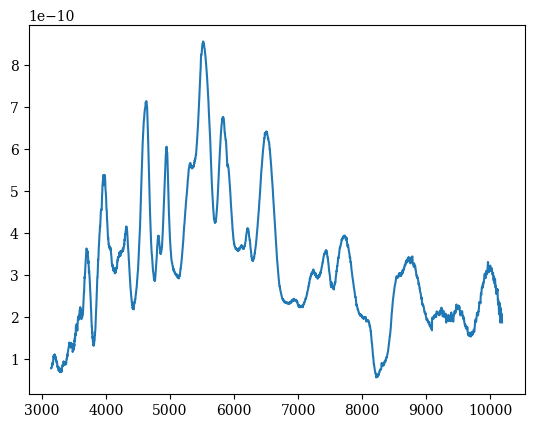

41.984924623115575


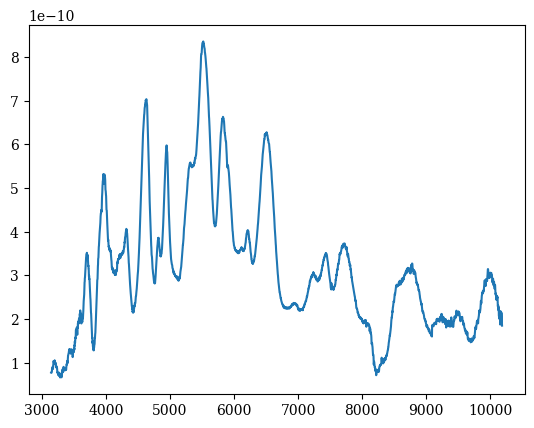

42.51256281407035


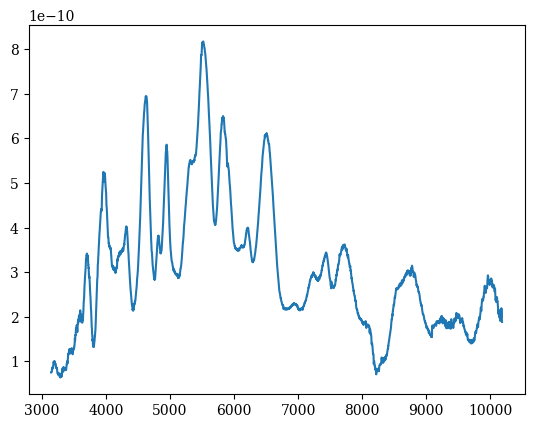

43.04020100502512


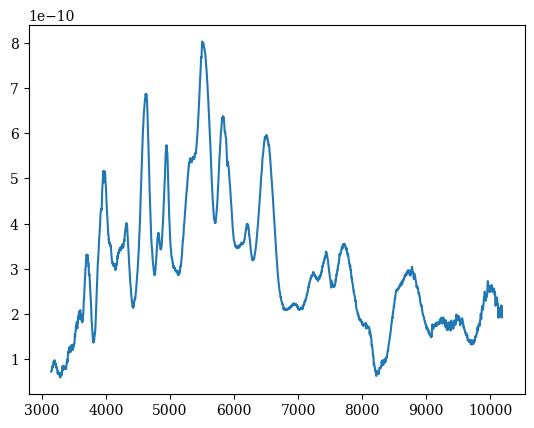

43.56783919597989


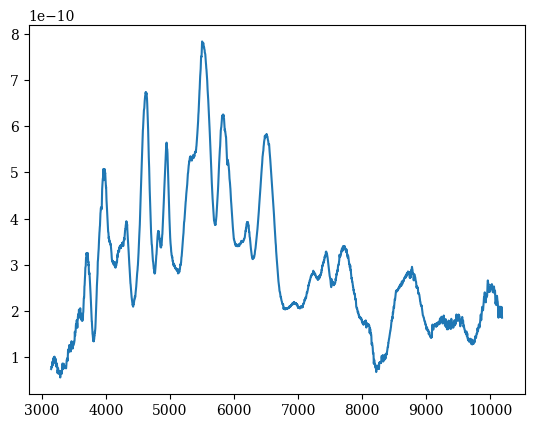

44.09547738693467


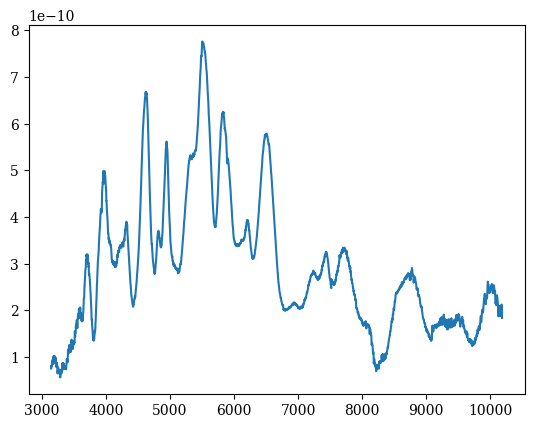

44.62311557788944


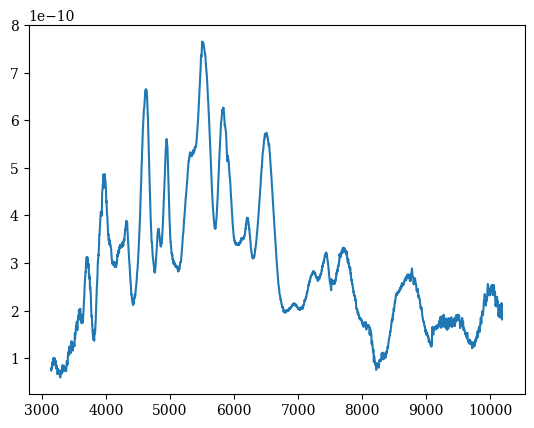

45.15075376884422


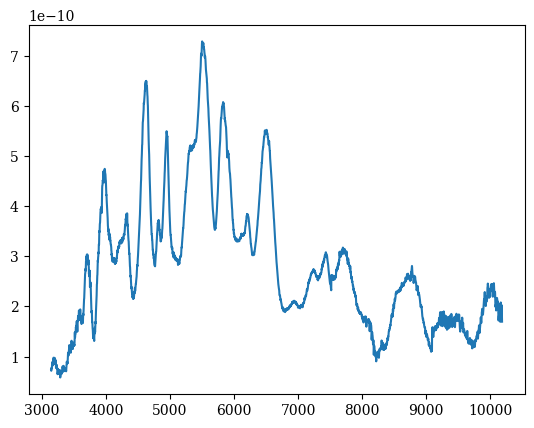

45.67839195979899


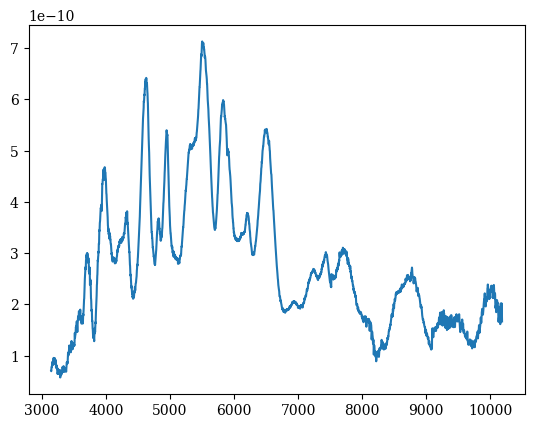

46.20603015075376


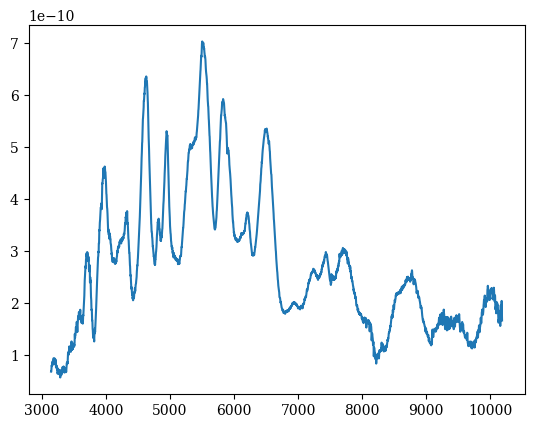

46.73366834170854


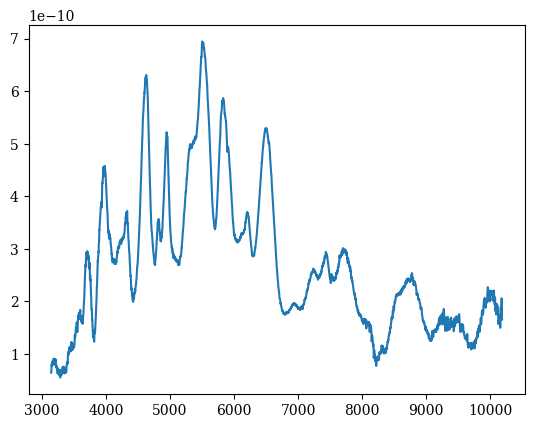

47.26130653266331


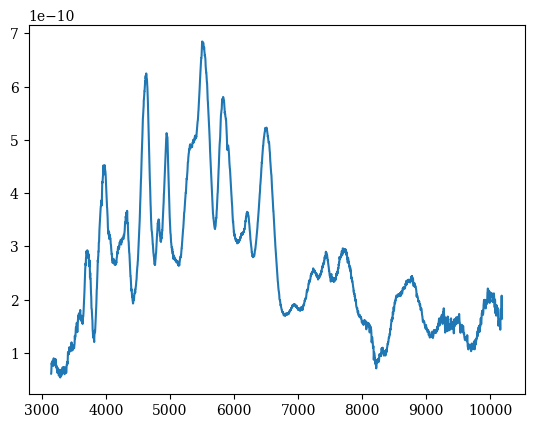

47.78894472361809


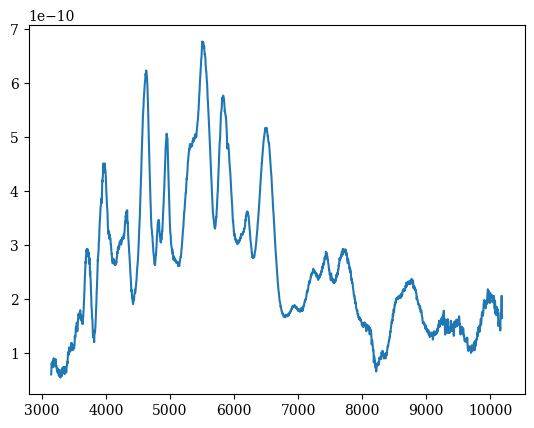

48.31658291457286


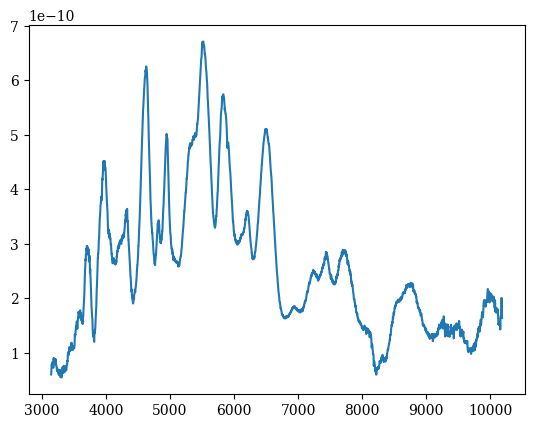

48.84422110552763


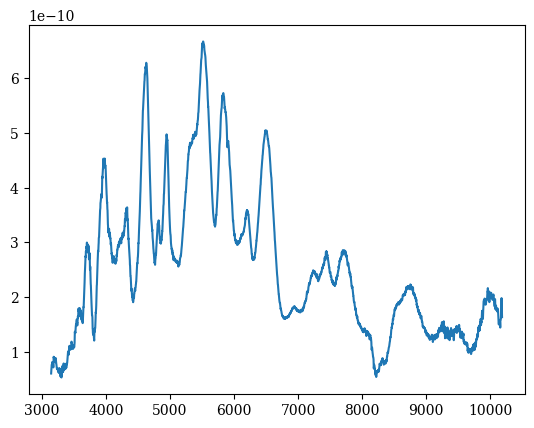

49.37185929648241


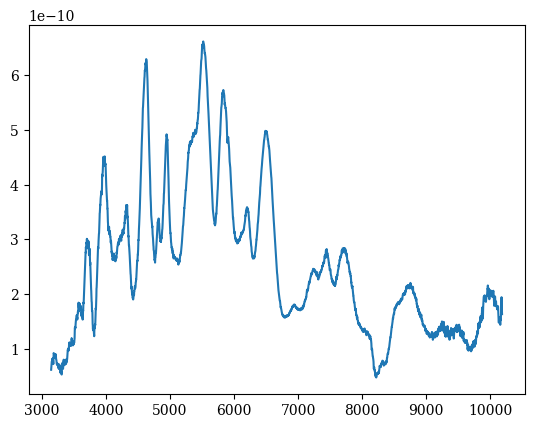

49.89949748743717


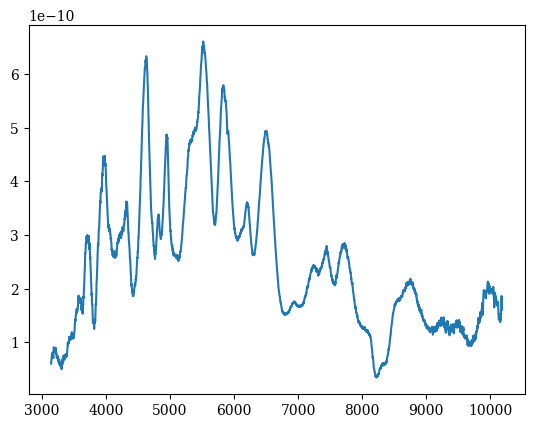

50.42713567839195


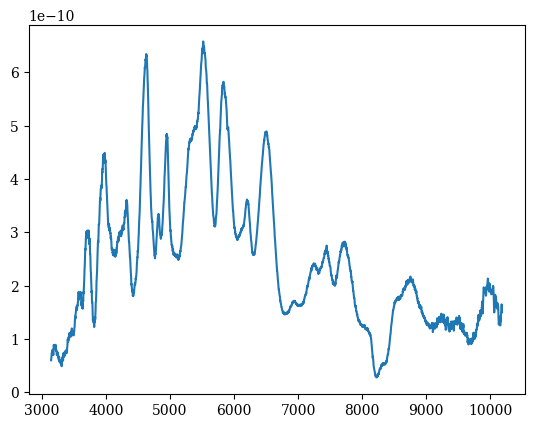

50.954773869346724


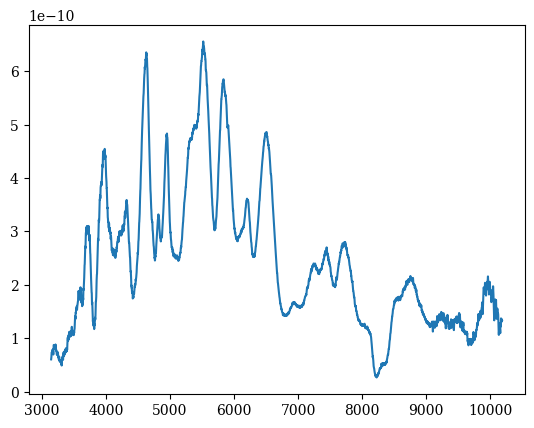

51.4824120603015


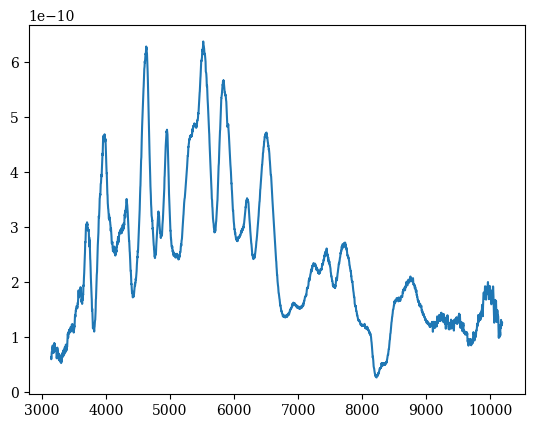

52.010050251256274


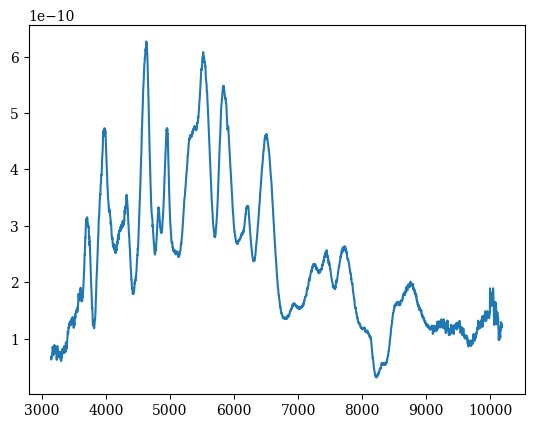

52.53768844221105


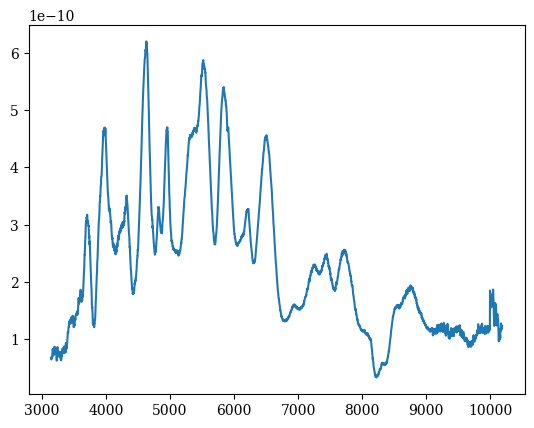

53.065326633165824


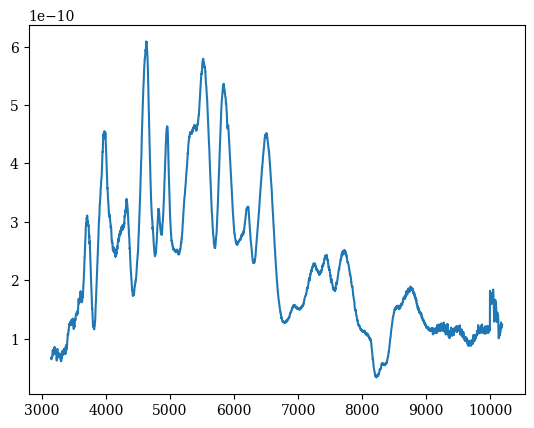

53.5929648241206


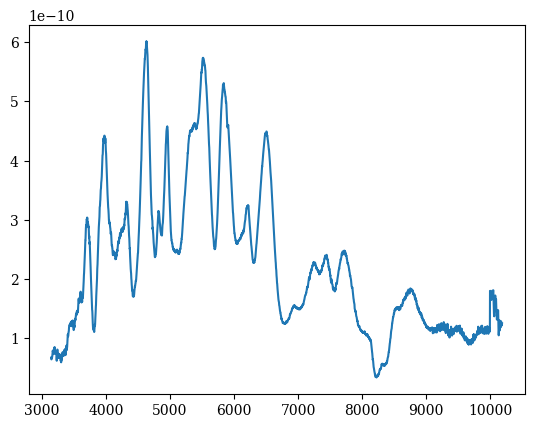

54.120603015075375


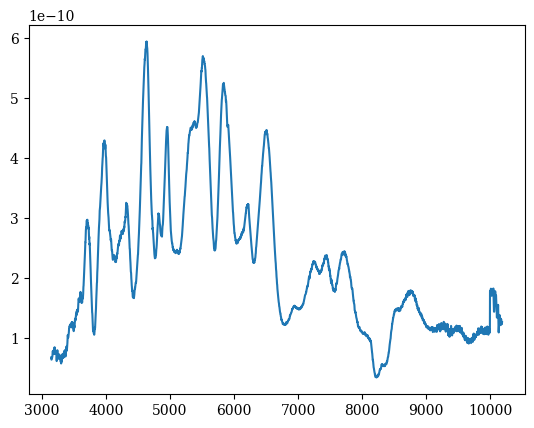

54.64824120603015


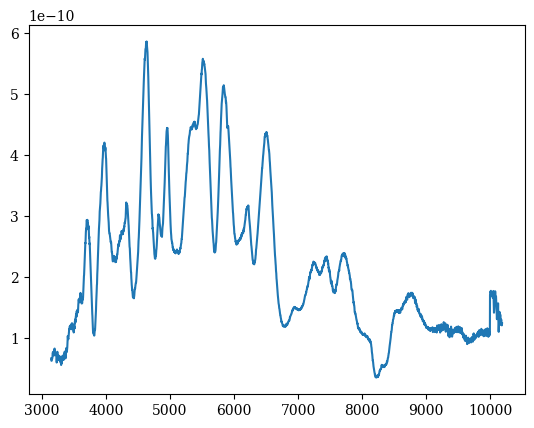

55.175879396984925


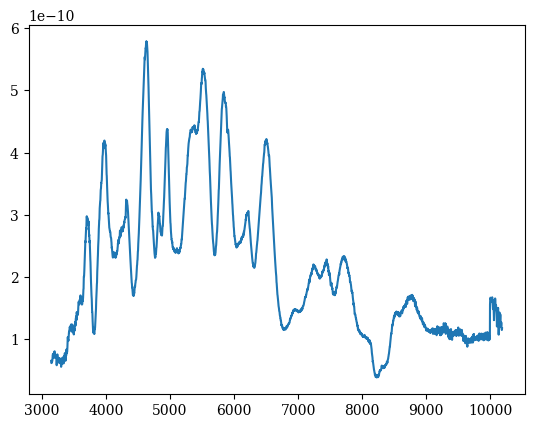

55.703517587939686


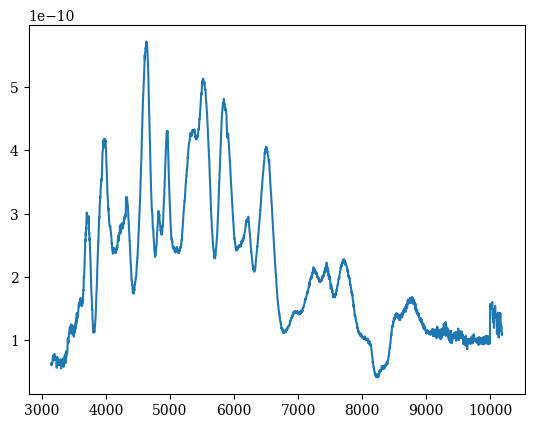

56.23115577889446


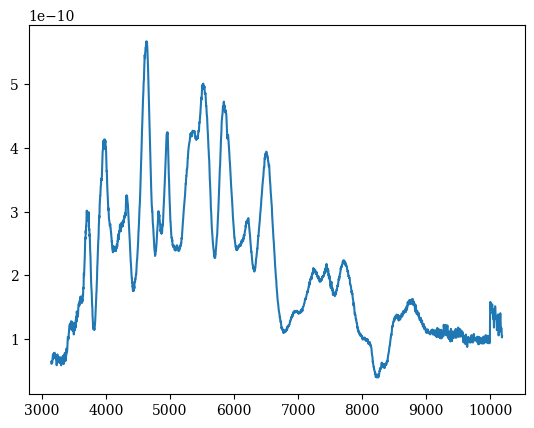

56.758793969849236


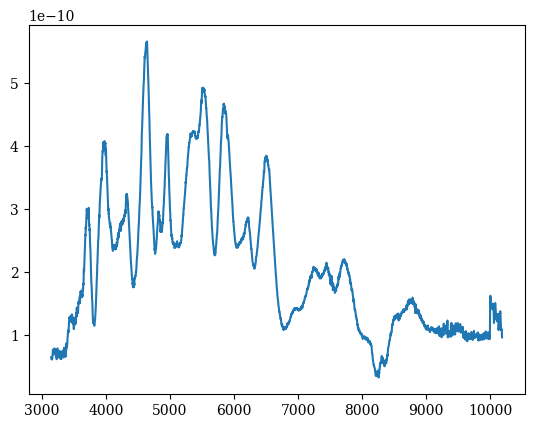

57.28643216080401


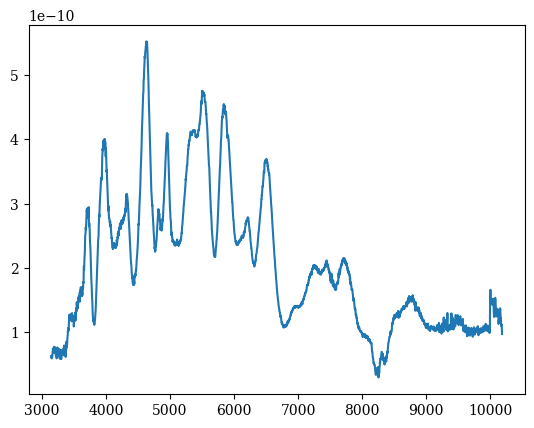

57.81407035175879


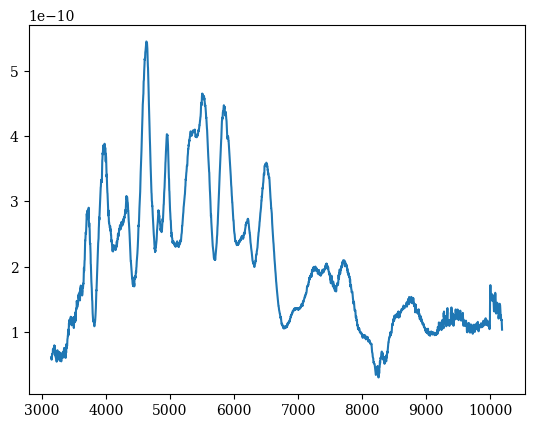

58.34170854271356


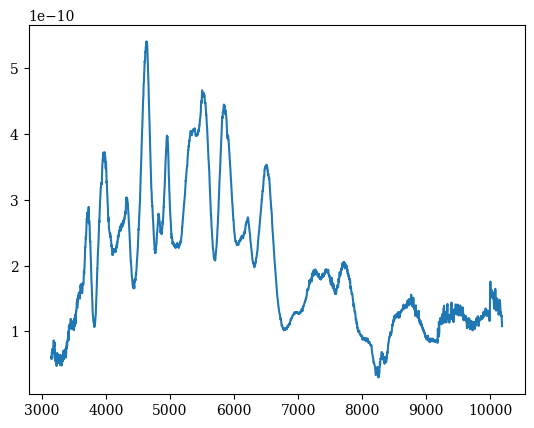

58.86934673366834


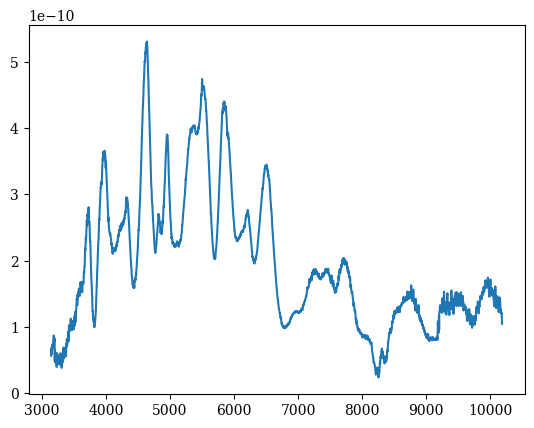

59.39698492462311


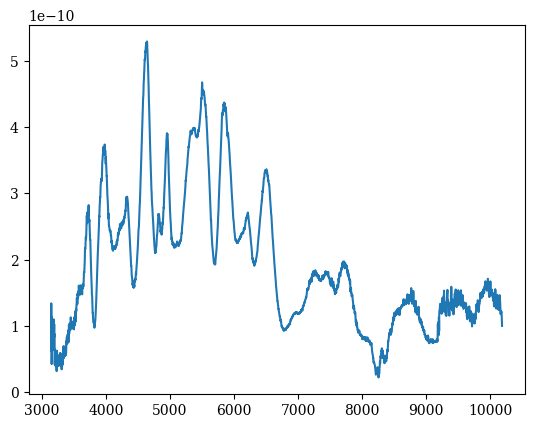

59.92462311557789


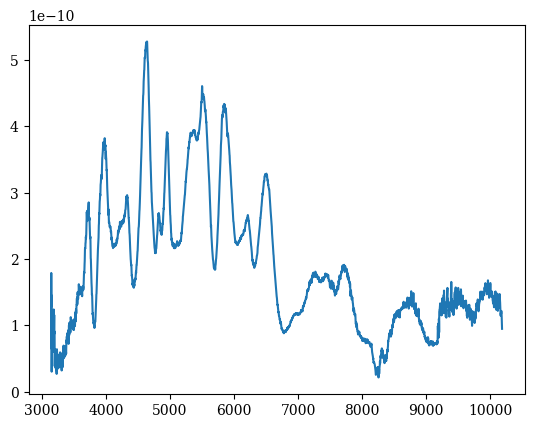

60.45226130653266


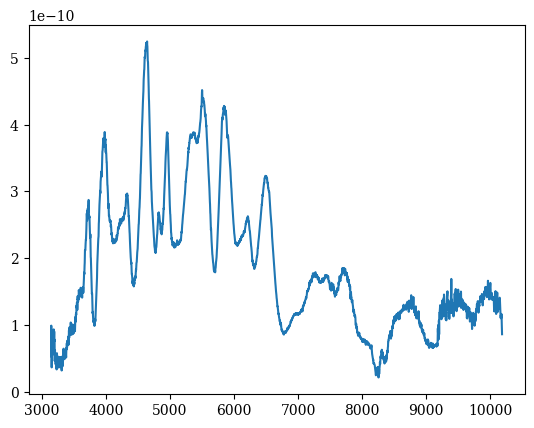

60.97989949748742


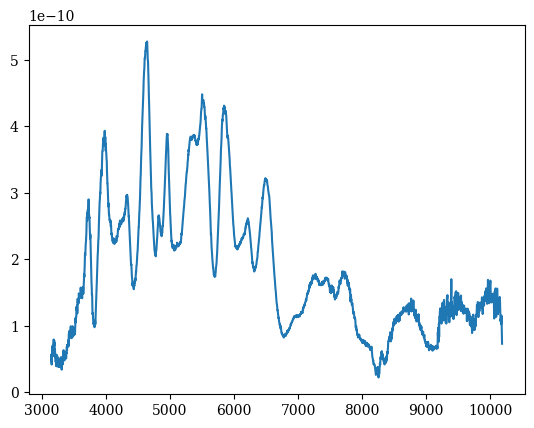

61.5075376884422


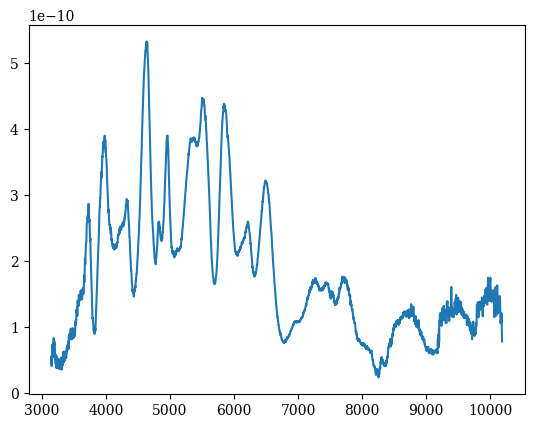

62.035175879396974


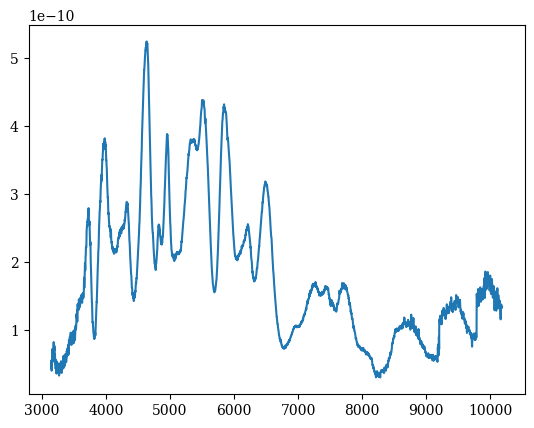

62.56281407035175


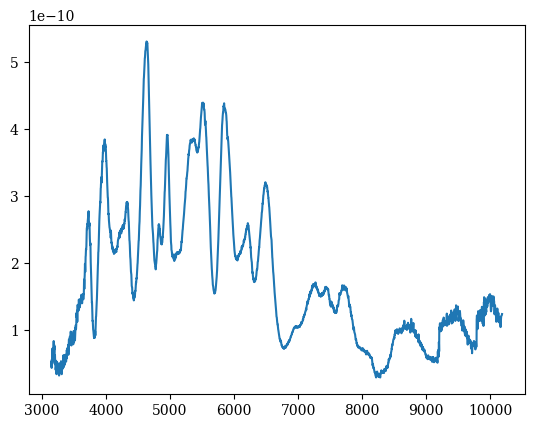

63.090452261306524


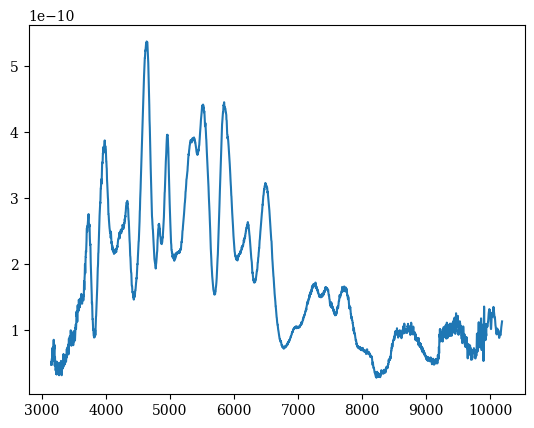

63.6180904522613


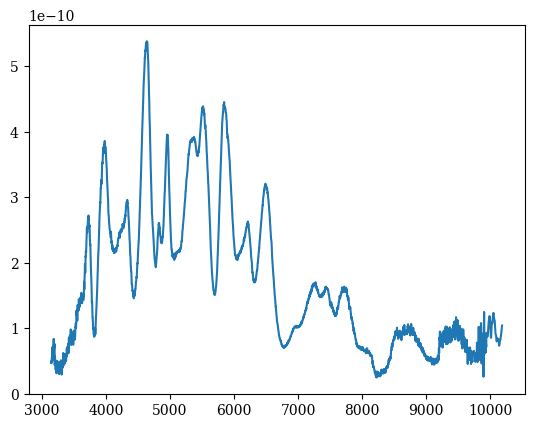

64.14572864321607


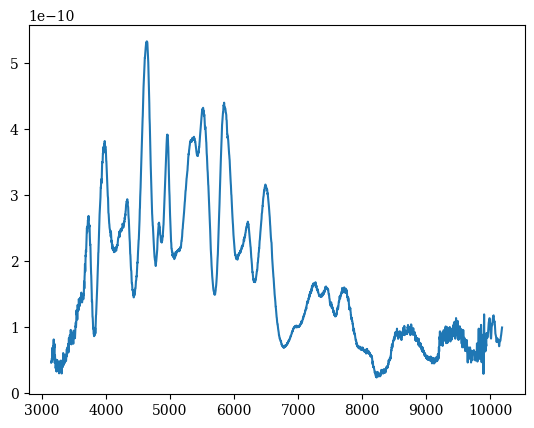

64.67336683417085


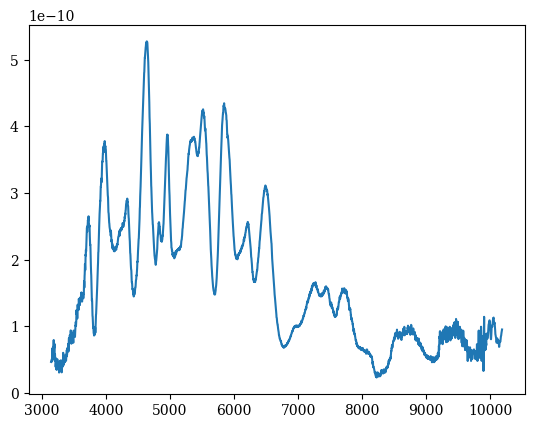

65.20100502512562


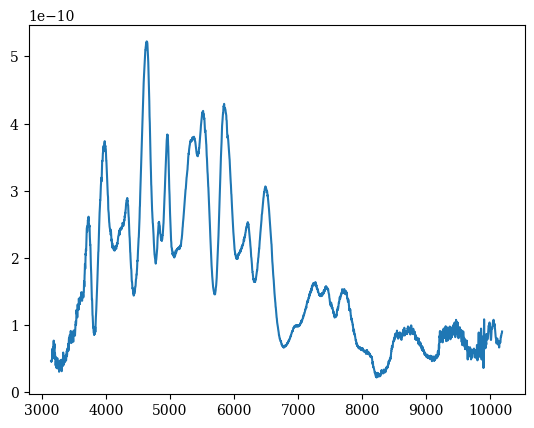

65.7286432160804


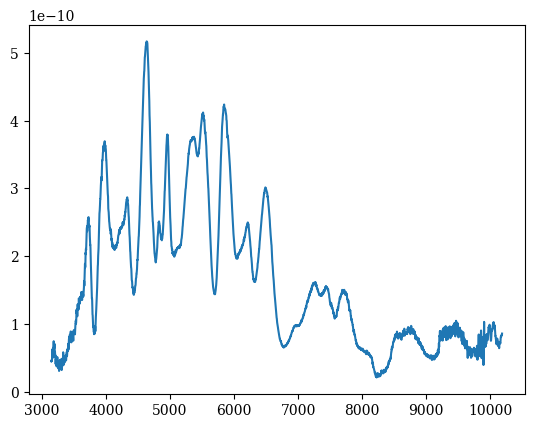

66.25628140703517


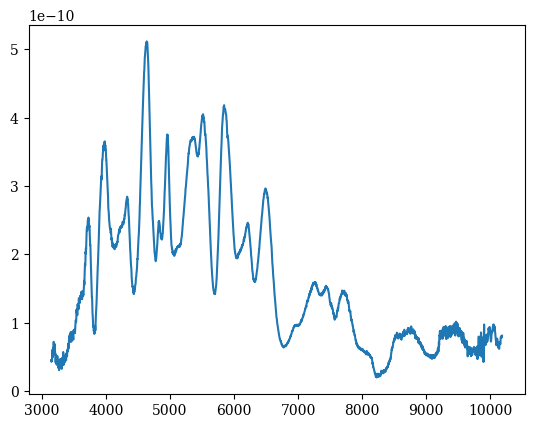

66.78391959798994


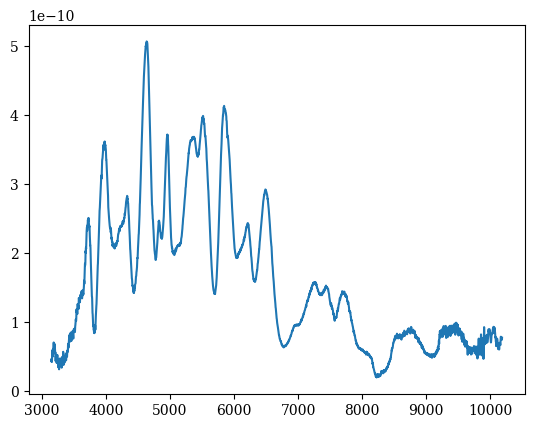

67.31155778894471


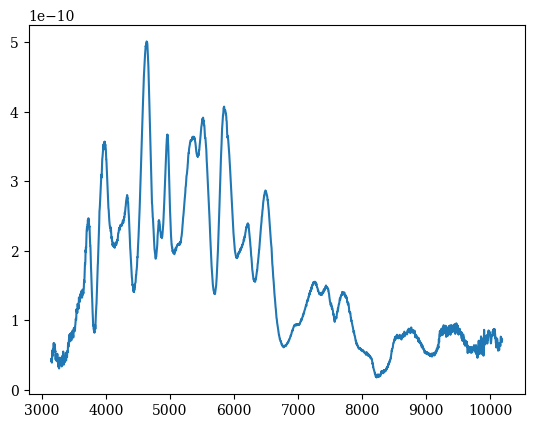

67.83919597989949


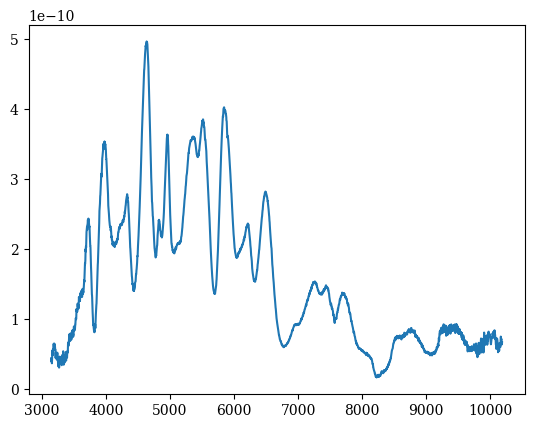

68.36683417085426


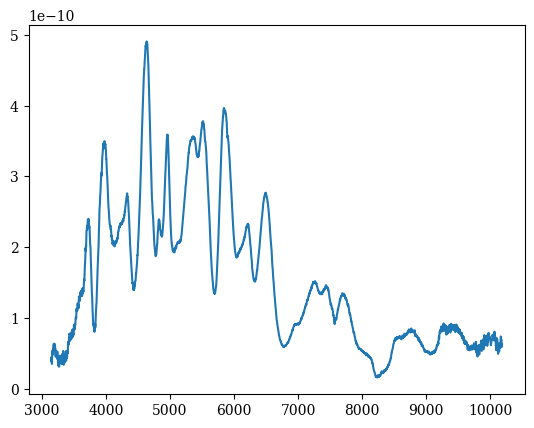

68.89447236180904


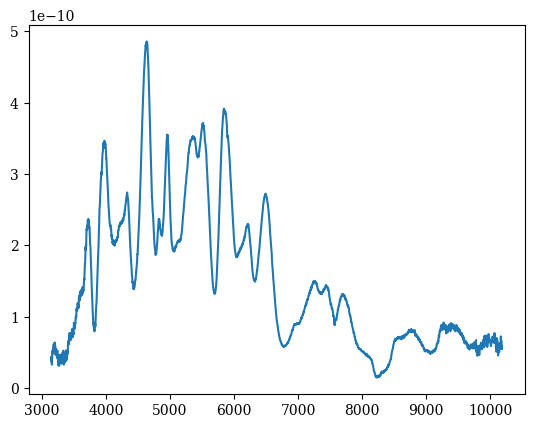

69.42211055276381


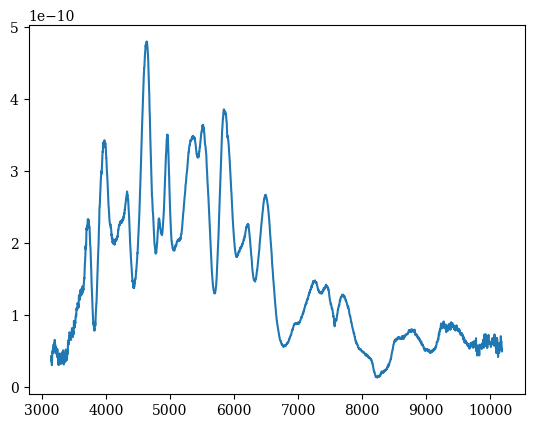

69.94974874371859


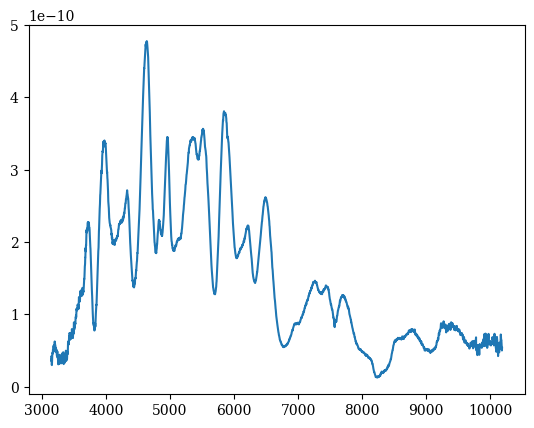

70.47738693467336


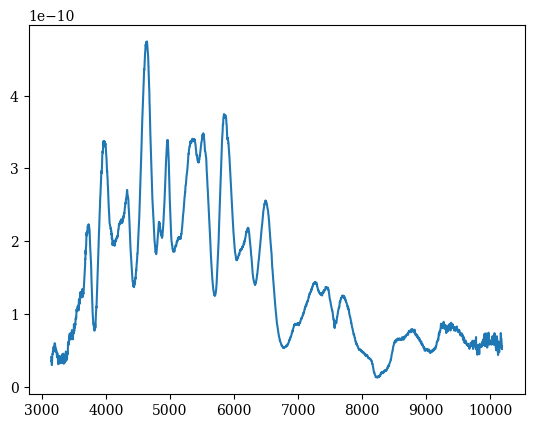

71.00502512562814


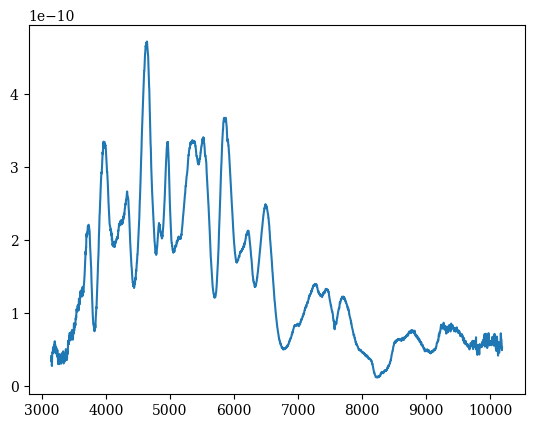

71.53266331658291


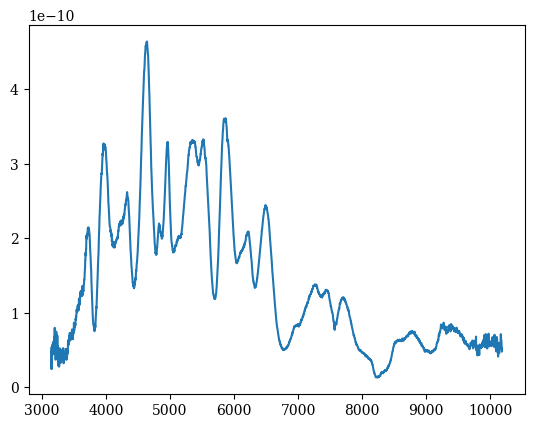

72.06030150753769


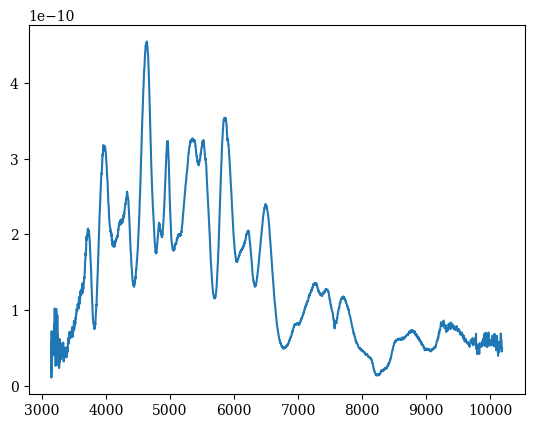

72.58793969849245


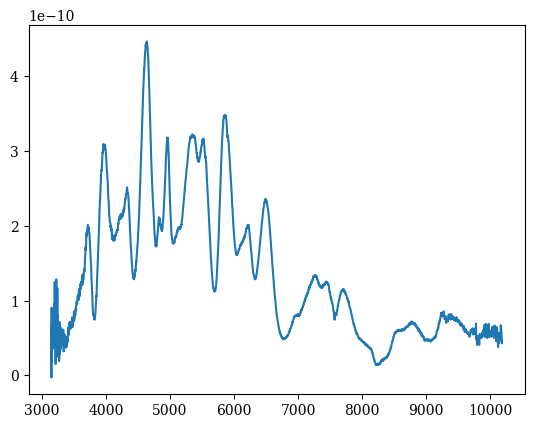

73.11557788944722


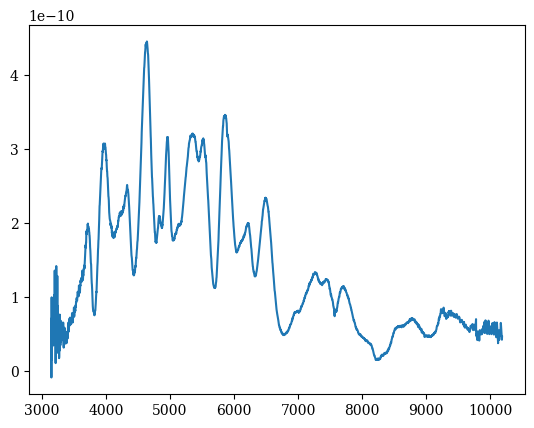

73.643216080402


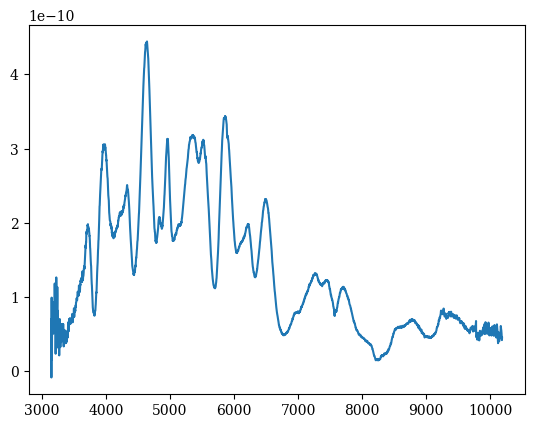

74.17085427135677


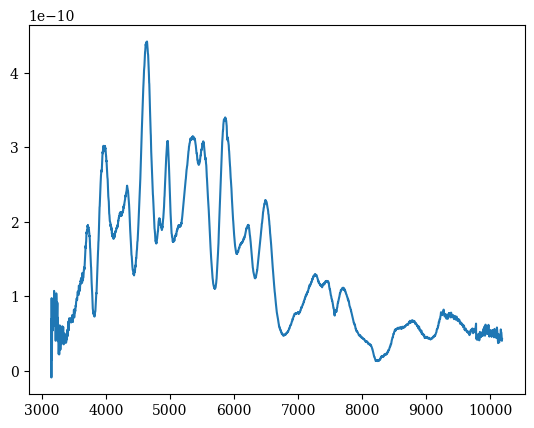

74.69849246231155


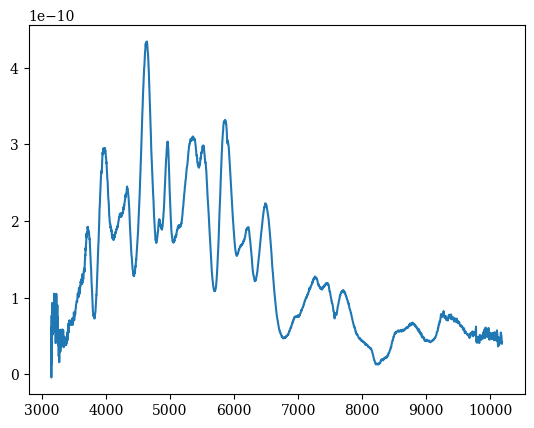

75.22613065326632


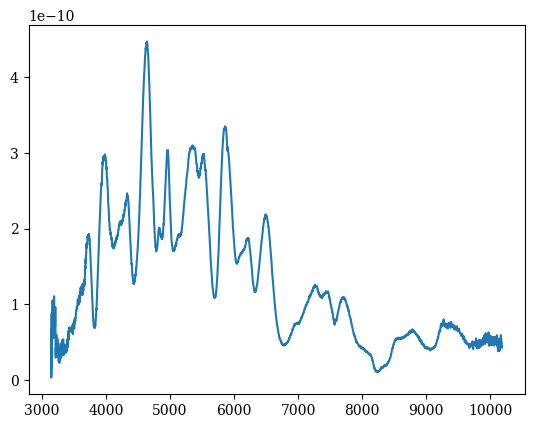

75.7537688442211


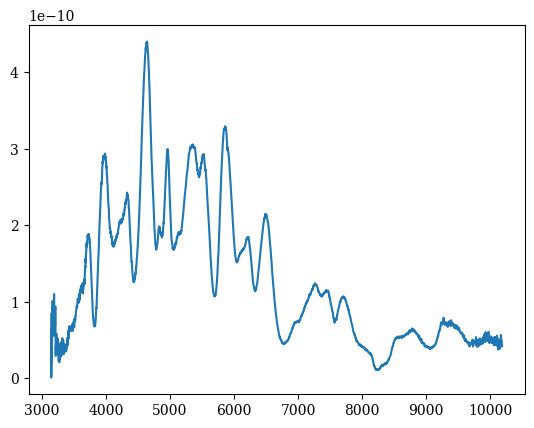

76.28140703517587


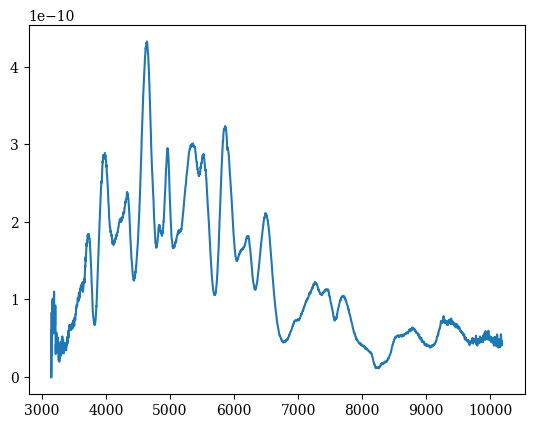

76.80904522613065


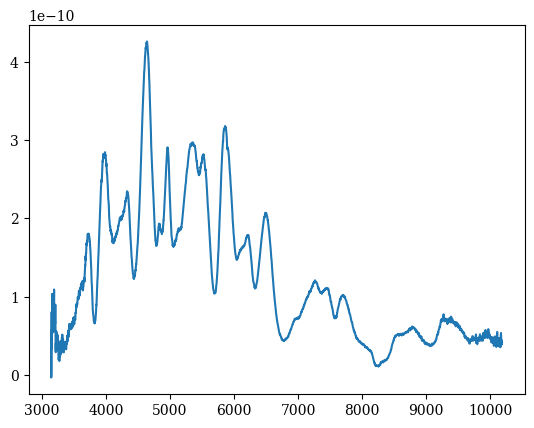

77.33668341708542


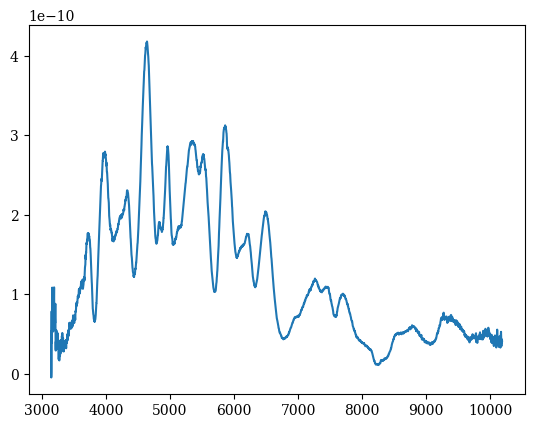

77.8643216080402


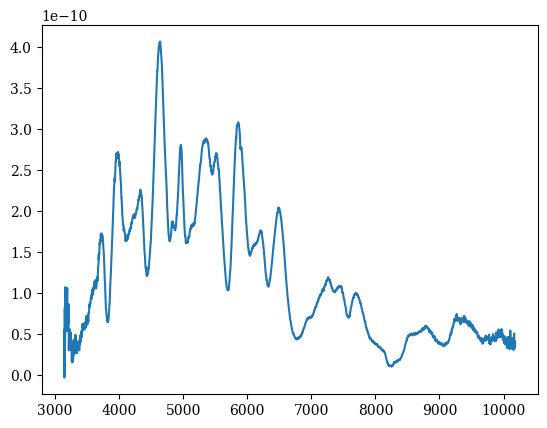

78.39195979899496


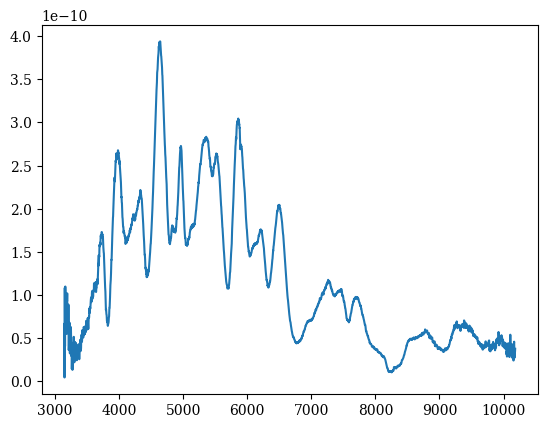

78.91959798994974


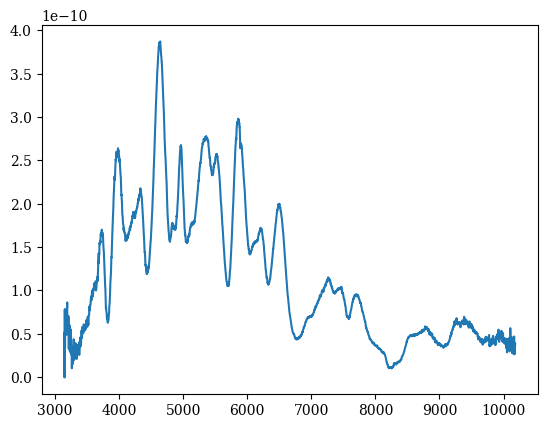

79.44723618090451


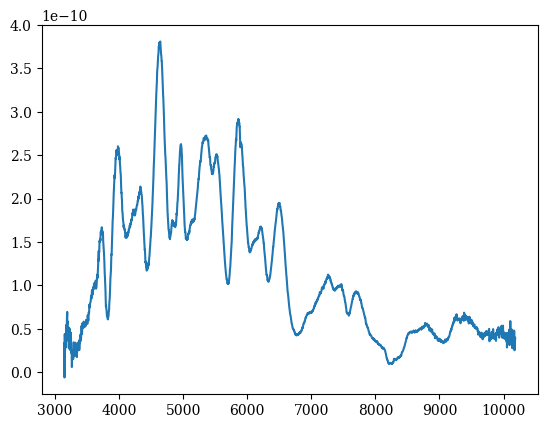

79.97487437185929


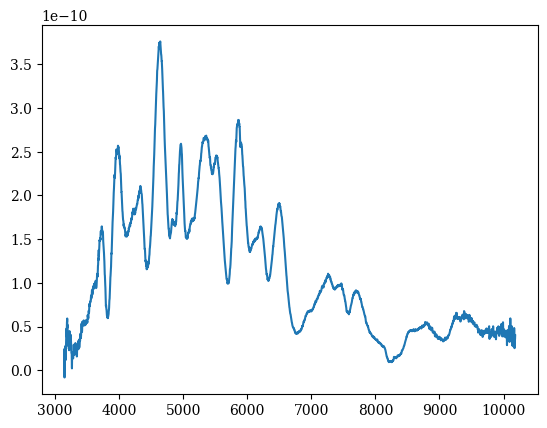

80.50251256281406


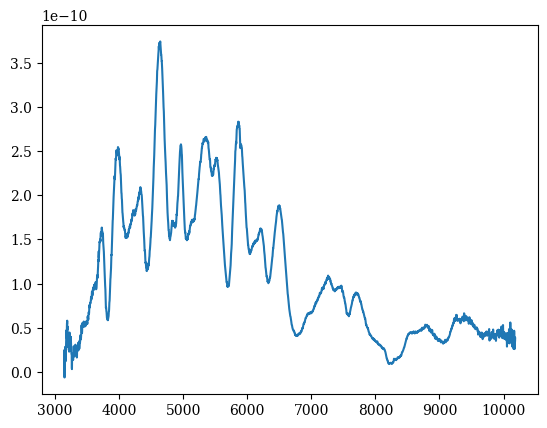

81.03015075376884


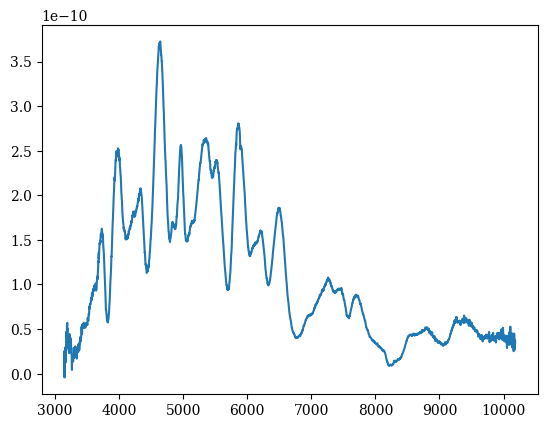

81.55778894472361


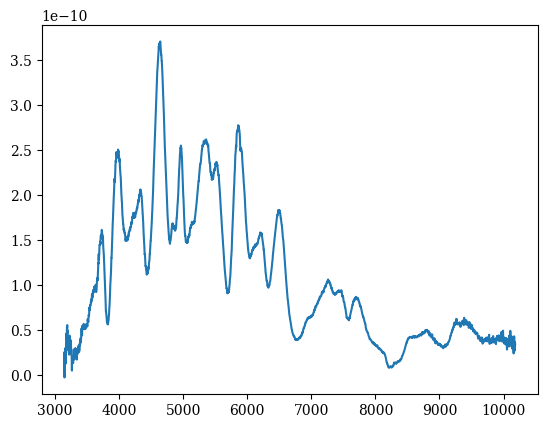

82.08542713567839


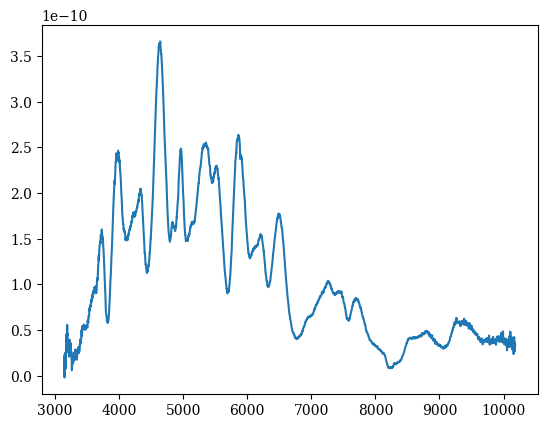

82.61306532663316


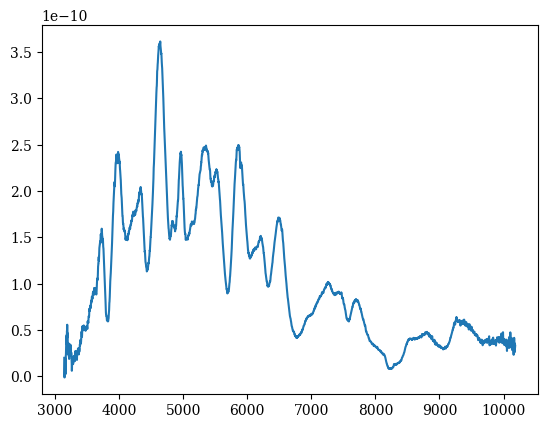

83.14070351758794


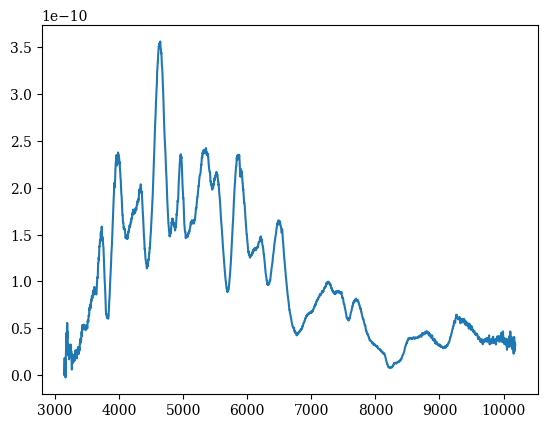

83.6683417085427


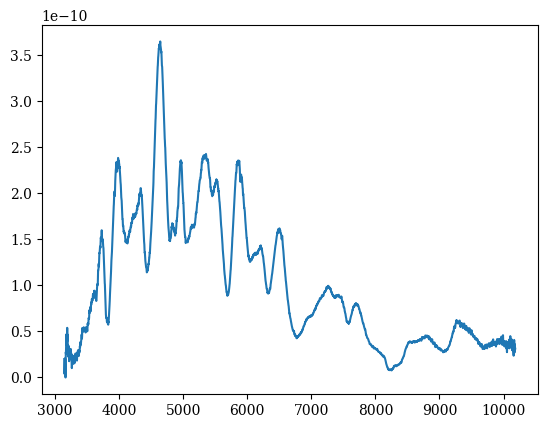

84.19597989949747


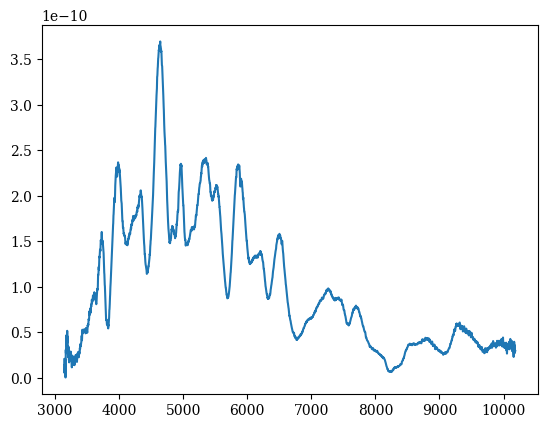

84.72361809045225


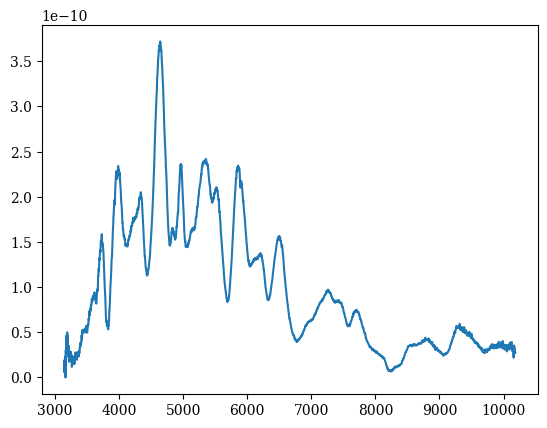

85.25125628140702


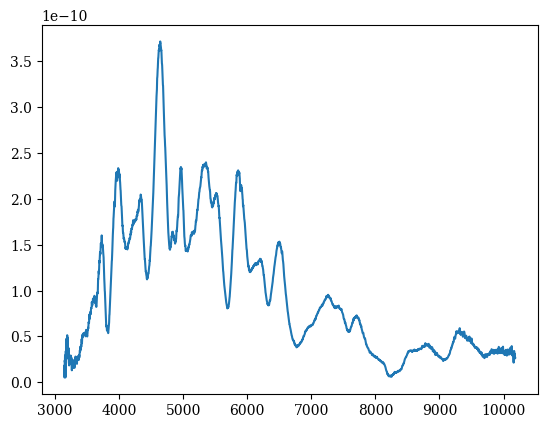

85.7788944723618


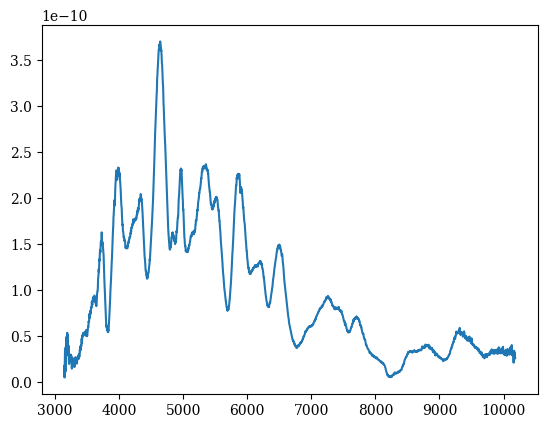

86.30653266331657


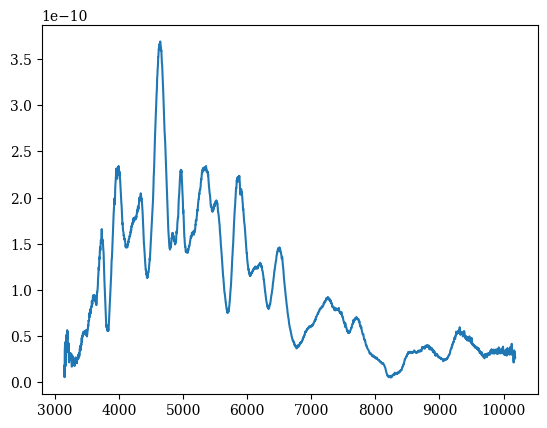

86.83417085427135


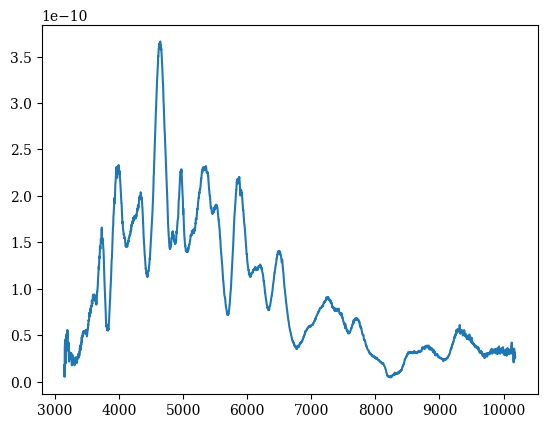

87.36180904522612


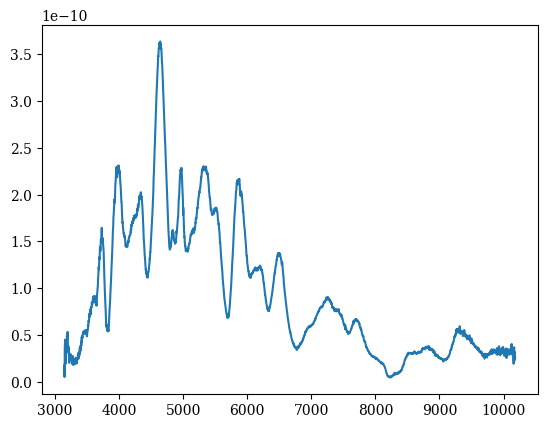

87.8894472361809


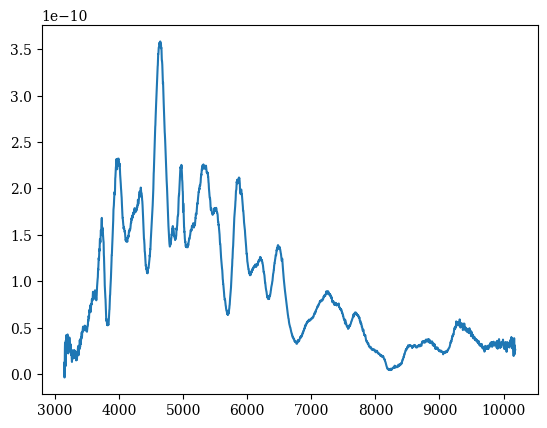

88.41708542713567


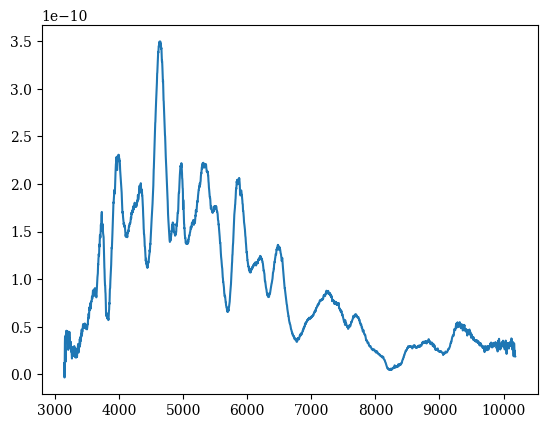

88.94472361809045


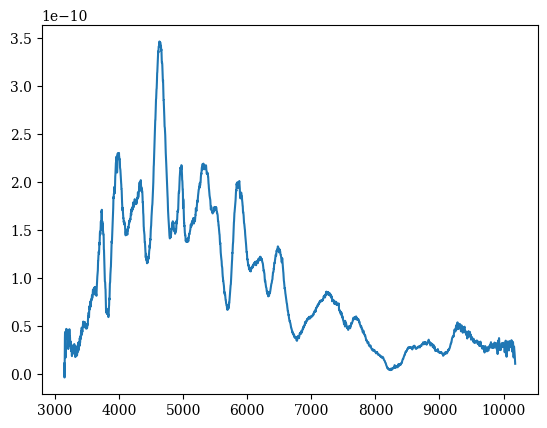

89.47236180904521


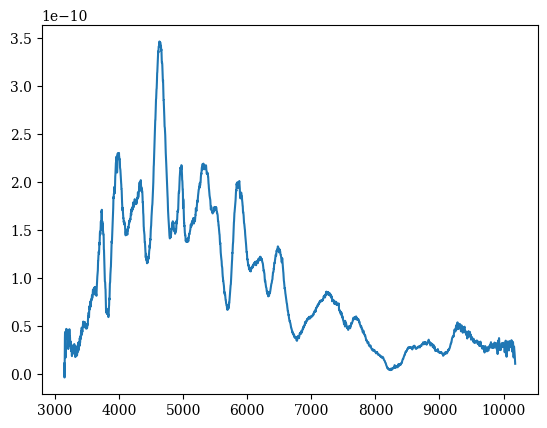

90.0


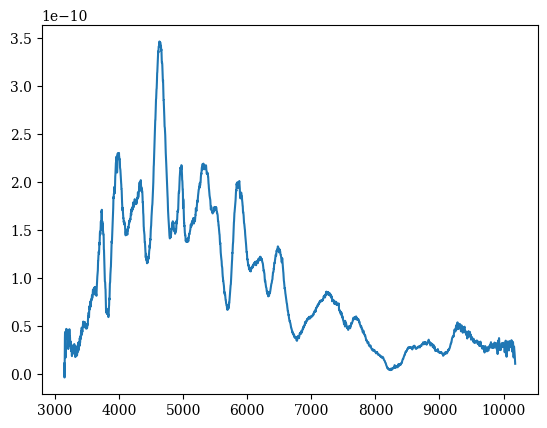

In [56]:
for i,z in enumerate(Z2_lowv):
    print (Y2_lowv[i][0])
    plt.plot(X2_lowv[i], z)
    plt.show()

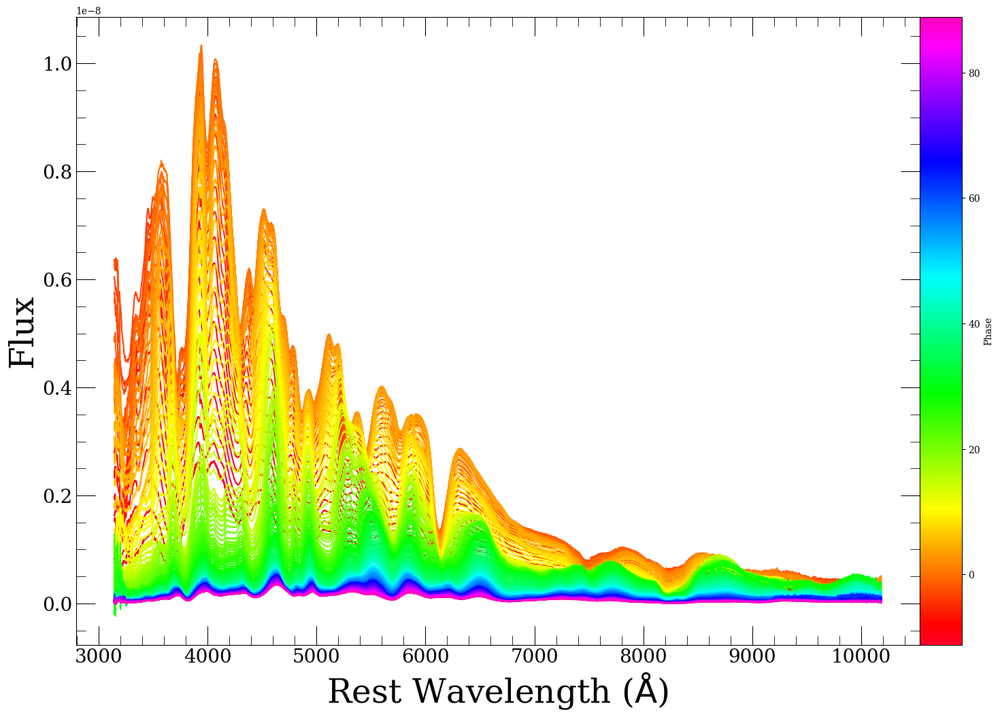

In [57]:
fig, ax, = kplot.basic_format()

s_m = make_colorbar(phases)
for i,z in enumerate(Z2_lowv):
    plt.plot(X2_lowv[i], z, color = s_m.to_rgba(Y2_lowv[i][0]))
plt.xlabel('Rest Wavelength ($\mathrm{\AA}$)', fontsize = 35)
plt.ylabel('Flux', fontsize = 35)
cax=ax.inset_axes([1, 0., 0.05, 1])
plt.colorbar(s_m, cax=cax,label='Phase')
plt.show()

200


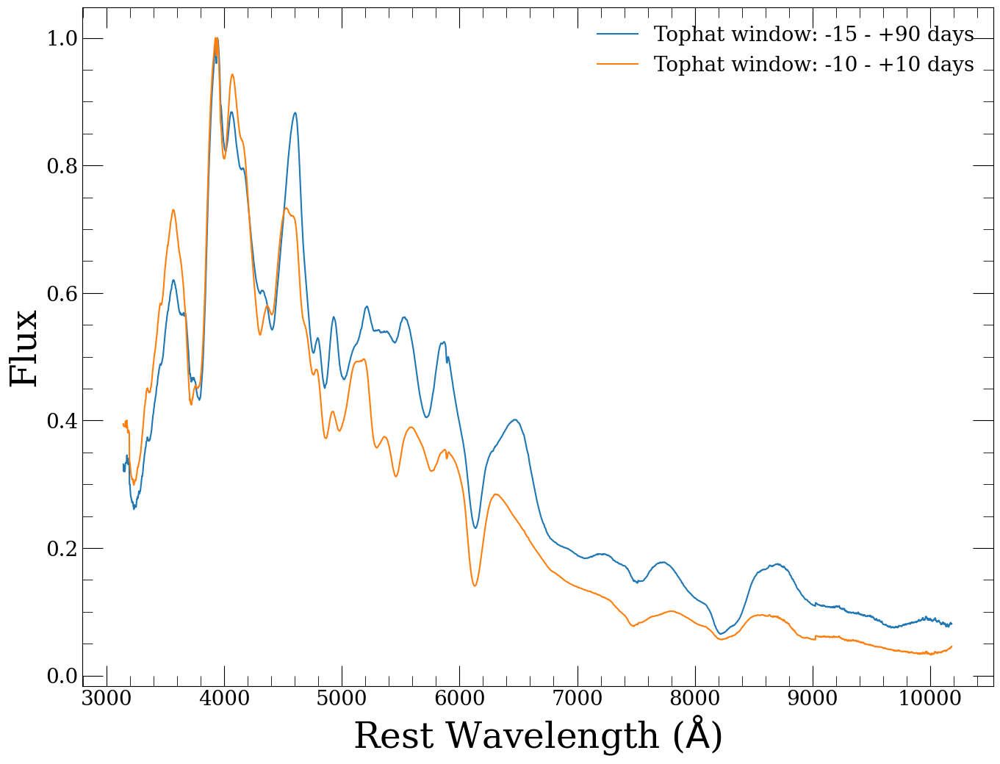

In [77]:
fig, ax, = kplot.basic_format()
print (len(Y2_lowv))
inds = []
plow = -10
phigh = 10
phases_interp = []
for i, y in enumerate(Y2_lowv):
    if y[0] > plow and y[0] < phigh:
        inds.append(i)
    phases_interp.append(y[0])
    
phase_diff = np.diff(phases_interp)[0]

lecho1_lowv = np.sum(Z2_lowv*phase_diff,axis=0)
lecho2_lowv = np.sum(Z2_lowv[inds]*phase_diff,axis=0)
scale1_lowv = 1./np.amax(lecho1_lowv)
scale2_lowv = 1./np.amax(lecho2_lowv)

plt.plot(X2_lowv[0], scale1_lowv*lecho1_lowv, label = 'Tophat window: -15 - +90 days')
plt.plot(X2_lowv[0], scale2_lowv*lecho2_lowv, label = 'Tophat window: -10 - +10 days')
plt.xlabel('Rest Wavelength ($\mathrm{\AA}$)', fontsize = 35)
plt.ylabel('Flux', fontsize = 35)
# plt.xlim(3500, 9000)
plt.legend(fontsize=20, frameon=False)
plt.show()

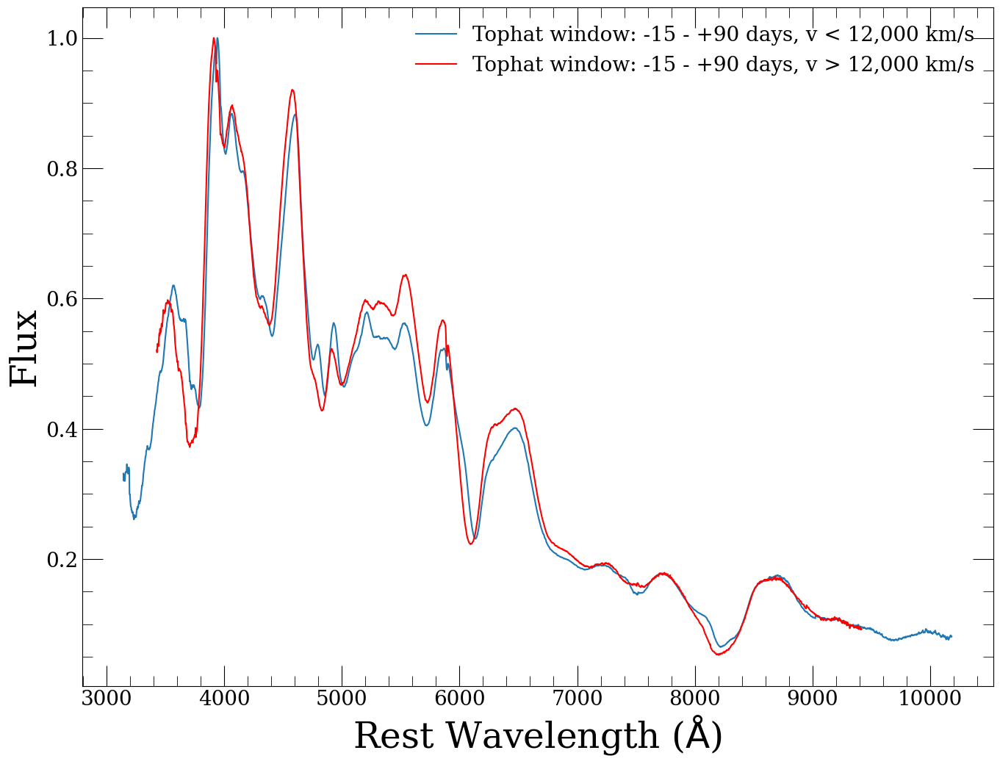

In [76]:
fig, ax, = kplot.basic_format()

plt.plot(X2_lowv[0], scale1_lowv*lecho1_lowv, label = 'Tophat window: -15 - +90 days, v < 12,000 km/s')
plt.plot(X2_highv[0], scale1_highv*lecho1_highv, label = 'Tophat window: -15 - +90 days, v > 12,000 km/s', color='r')
plt.xlabel('Rest Wavelength ($\mathrm{\AA}$)', fontsize = 35)
plt.ylabel('Flux', fontsize = 35)
# plt.xlim(3500, 9000)
plt.legend(fontsize=20, frameon=False)
plt.show()